In [1]:
import os
import numpy as np 
from Bio import SeqIO

'cleaned_topts.fasta'

#Data_sets
global dir_
dir_ = '/mnt/Archive/Data_Sets/OGT'
file = 'ogt.fasta'
global topt_dict
topt_dict = {'id':[], 'ogt':[], 'seq':[]}


for rec in SeqIO.parse(os.path.join(dir_,file), 'fasta'):
    topt_dict['id'].append(rec.id)
    topt_dict['ogt'].append(float(rec.description.split()[-1]))
    topt_dict['seq'].append(rec.seq)

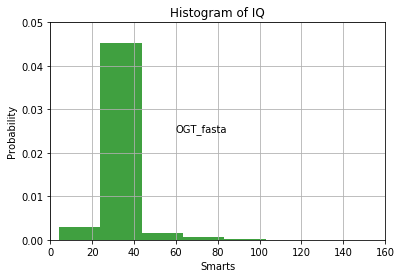

In [3]:
import matplotlib.pyplot as plt

n, bins, patches = plt.hist(topt_dict['ogt'], 5, density=True, facecolor='g', alpha=0.75)


plt.xlabel('Smarts')
plt.ylabel('Probability')
plt.title('Histogram of IQ')
plt.text(60, .025, r'OGT_fasta')
plt.xlim(0, 160)
plt.ylim(0, 0.05)
plt.grid(True)
plt.show()

In [6]:
tot_dif = max(topt_dict['ogt']) - min(topt_dict['ogt'])
print(max(topt_dict['ogt']))
print(min(topt_dict['ogt']))
print(tot_dif)

103.0
4.0
99.0


In [5]:
hist, bins_e = np.histogram(topt_dict['ogt'], bins = 99, density = True, )

In [39]:
print(np.cumsum(hist))

[6.46989476e-04 9.68991927e-04 9.68991927e-04 1.19482475e-03
 1.43027453e-03 2.18470870e-03 3.50488558e-03 3.86038159e-03
 4.25268736e-03 4.64234017e-03 5.20675641e-03 7.13611816e-03
 8.06166795e-03 9.22465723e-03 1.12780446e-02 1.31036095e-02
 2.89596602e-02 3.43119975e-02 4.51018984e-02 5.70428502e-02
 8.69376771e-02 1.42377479e-01 1.75901880e-01 2.45464027e-01
 3.91239942e-01 4.79408590e-01 6.14380013e-01 6.40546774e-01
 6.63113144e-01 6.76788133e-01 6.96179910e-01 7.35605147e-01
 7.58970720e-01 9.35413471e-01 9.39617079e-01 9.41873749e-01
 9.45664491e-01 9.50894792e-01 9.52707755e-01 9.54084971e-01
 9.55432009e-01 9.59125586e-01 9.60114475e-01 9.61237338e-01
 9.61760965e-01 9.62026261e-01 9.65802743e-01 9.66300504e-01
 9.66934892e-01 9.68005359e-01 9.68637094e-01 9.74615529e-01
 9.75120253e-01 9.76575399e-01 9.77424014e-01 9.77563625e-01
 9.82670233e-01 9.82670564e-01 9.83362986e-01 9.83520173e-01
 9.83828911e-01 9.86104152e-01 9.86369116e-01 9.86954424e-01
 9.87997699e-01 9.883830

In [66]:
truth = np.bitwise_and(np.bitwise_not(np.cumsum(hist)>0.95), np.cumsum(hist)>0.5)
print(truth)
print(bins_e[:-1][truth])

[False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False  True  True  True  True  True  True  True  True  True  True
  True False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False]
[30. 31. 32. 33. 34. 35. 36. 37. 38. 39. 40.]


In [45]:
print(bins_e[:-1][np.cumsum(hist)<0.01])

[ 4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17.]


In [77]:
# Split data from OGT
meso_mask = bins_e[:-1][np.cumsum(hist)<0.01]
thermo_mask = bins_e[:-1][np.cumsum(hist)>0.99]
mesophile ={'id':[], 'seq':[]}
thermophile = {'id':[], 'seq':[]}

for prop, seq, _id in zip(topt_dict['ogt'], topt_dict['seq'], topt_dict['id']):

    if prop in meso_mask:
        mesophile['id'].append(_id)
        mesophile['seq'].append(seq)
    elif prop in thermo_mask:
        thermophile['id'].append(_id)
        thermophile['seq'].append(seq)


[ 70.  71.  72.  73.  74.  75.  76.  77.  78.  79.  80.  81.  82.  83.
  84.  85.  86.  87.  88.  89.  90.  91.  92.  93.  94.  95.  96.  97.
  98.  99. 100. 101. 102.]


In [2]:
# write fasta temp
from multiprocessing import Pool

temperatures=[(i,i+11) for i in range(4,103,11)]

def filter_temp(temp):
    global topt_dict
    f = open(os.path.join(dir_,'ogt_{}_{}.fasta'.format(temp[0],temp[1])),'w')
    max_count = 10000
    count= 0
    for id_, seq, ogt in zip(topt_dict['id'], topt_dict['seq'], topt_dict['ogt']):
        if ogt>=temp[0] and ogt<temp[1]:
            f.write('>{} {}\n{}\n'.format(id_,ogt,seq))
            count += 1
        else:
            continue
        if count >= max_count:
            break
            
    f.close()
    return 0

p = Pool(9)
p.map(filter_temp, temperatures)

[0, 0, 0, 0, 0, 0, 0, 0, 0]

In [14]:
print(temperatures)

[(4, 15), (15, 26), (26, 37), (37, 48), (48, 59), (59, 70), (70, 81), (81, 92), (92, 103)]


In [86]:
# write fasta Thermo meso
f1 = open('thermophiles.fasta','w')
f2 = open('mesophiles.fasta','w')

for i, seq in zip(mesophile['id'],mesophile['seq']):
    f2.write('>'+i+'\n'+str(seq)+'\n')
    
for i, seq in zip(thermophile['id'],thermophile['seq']):
    f1.write('>'+i+'\n'+str(seq)+'\n')
    
f1.close()
f2.close()

In [32]:
import os
import numpy as np 
from Bio import SeqIO
from Bio.PDB import PDBParser, PDBList

from utils.dist_matrix import PDB_Features

from multiprocessing import Pool

# Constants

ROOT_DIR = '/mnt/Archive/Data_Sets/MesoThermo'
global df

# Directories
dir_fasta = os.path.join(ROOT_DIR,'FASTA')
dir_blast = os.path.join(ROOT_DIR,'BLAST_record')
pdb_dir = '/mnt/Archive/PDB'
outfolder = os.path.join(ROOT_DIR,'Dist_Mat/Thermophile')

#Files
blast_file = os.path.join(dir_blast,'thermophile_blast.txt')
#dist_mat_file = os.path.join(outfolder, 'blast_thermopile_dist_mat.tsv')

def blast_parser(file_obj):
    blast_dict = {}
    while True:
        line = file_obj.readline().strip('\n')
        if line != '':
            list_line = line.split('\t')
            if float(list_line[-1]) > 1e-4: 
                try:
                    blast_dict[list_line[0]].append((list_line[1].split('|')[1],list_line[1].split('|')[2]))
                except KeyError:
                    blast_dict[list_line[0]] = [(list_line[1].split('|')[1],list_line[1].split('|')[2])]
        else:
            return blast_dict
        
def dis_mat(key): 
    global df
    for j, ent in enumerate(df[key][:2]):
        ent_id    = ent[0]
        ent_chain = ent[1]

        if 'pdb'+ent_id.lower()+'.ent' not in list_PDB:
            pdbl.retrieve_pdb_file(ent_id,  pdir=pdb_dir, file_format='pdb')
        out_name = '{}_{}'.format(ent_id.lower(),ent_chain) 
        if os.path.isfile(os.path.join(outfolder,'{}_dist_mat.tsv'.format(out_name))):
            print('Already calculated {}'.format(out_name))
            continue
        pdb_obj = PDB_Features()
        try:
            pdb_obj.parse_pdb(os.path.join(pdb_dir,'pdb'+ent_id.lower()+'.ent'))
            pdb_obj.pairwise_distance_matrix(outfolder,out_name, ent_chain)
        except:
            print('Could not find file {}'.format('pdb'+ent_id.lower()+'.ent'))
        
        
f = open(blast_file, 'r')
df = blast_parser(f)
f.close()



pdbl = PDBList()
list_PDB = os.listdir(pdb_dir)
data = df.keys()
p = Pool(16)

p.map(dis_mat, data)

Parsing /mnt/Archive/PDB/pdb1j58.ent ...
Parsing /mnt/Archive/PDB/pdb3so2.ent ...
Parsing /mnt/Archive/PDB/pdb5t5s.ent ...
Parsing /mnt/Archive/PDB/pdb1iru.ent ...
Parsing /mnt/Archive/PDB/pdb2jcn.ent ...
Parsing /mnt/Archive/PDB/pdb1wz2.ent ...
Parsing /mnt/Archive/PDB/pdb4kgb.ent ...
Parsing /mnt/Archive/PDB/pdb1bob.ent ...
Parsing /mnt/Archive/PDB/pdb2v8s.ent ...
Parsing /mnt/Archive/PDB/pdb1xvq.ent ...
Parsing /mnt/Archive/PDB/pdb4fz2.ent ...
Parsing /mnt/Archive/PDB/pdb5b46.ent ...
Parsing /mnt/Archive/PDB/pdb2d2x.ent ...
Parsing /mnt/Archive/PDB/pdb4ap2.ent ...
Parsing /mnt/Archive/PDB/pdb1ofh.ent ...
Parsing /mnt/Archive/PDB/pdb3l0o.ent ...
Parsing /mnt/Archive/PDB/pdb2okb.ent ...
Parsing /mnt/Archive/PDB/pdb2m5b.ent ...
Parsing /mnt/Archive/PDB/pdb1nyq.ent ...
Parsing /mnt/Archive/PDB/pdb3i3n.ent ...
Parsing /mnt/Archive/PDB/pdb1mbs.ent ...
Parsing /mnt/Archive/PDB/pdb5eks.ent ...
Parsing /mnt/Archive/PDB/pdb1iru.ent ...
Parsing /mnt/Archive/PDB/pdb2m72.ent ...
Parsing /mnt/Arc

Parsing /mnt/Archive/PDB/pdb2hfu.ent ...
Parsing /mnt/Archive/PDB/pdb6hsf.ent ...
Parsing /mnt/Archive/PDB/pdb3rf1.ent ...
Parsing /mnt/Archive/PDB/pdb5gpg.ent ...
Parsing /mnt/Archive/PDB/pdb3lb8.ent ...
Parsing /mnt/Archive/PDB/pdb1pbk.ent ...
Parsing /mnt/Archive/PDB/pdb2iy9.ent ...
Parsing /mnt/Archive/PDB/pdb3ucp.ent ...
Parsing /mnt/Archive/PDB/pdb6oyy.ent ...
Parsing /mnt/Archive/PDB/pdb2dpp.ent ...
Parsing /mnt/Archive/PDB/pdb4pg4.ent ...
Parsing /mnt/Archive/PDB/pdb2v0h.ent ...
Parsing /mnt/Archive/PDB/pdb2j0f.ent ...
Already calculated 1vc3_A
Parsing /mnt/Archive/PDB/pdb5an9.ent ...
Parsing /mnt/Archive/PDB/pdb1gpj.ent ...
Parsing /mnt/Archive/PDB/pdb4z2a.ent ...
Parsing /mnt/Archive/PDB/pdb6vp0.ent ...
Parsing /mnt/Archive/PDB/pdb1p4s.ent ...
Already calculated 5b48_A
Parsing /mnt/Archive/PDB/pdb5bn3.ent ...
Parsing /mnt/Archive/PDB/pdb4qvu.ent ...
Parsing /mnt/Archive/PDB/pdb3mgk.ent ...
Already calculated 2eq5_A
Parsing /mnt/Archive/PDB/pdb2byz.ent ...
Parsing /mnt/Archive

Parsing /mnt/Archive/PDB/pdb6n4c.ent ...
Parsing /mnt/Archive/PDB/pdb4uhl.ent ...
Parsing /mnt/Archive/PDB/pdb4m1j.ent ...
Parsing /mnt/Archive/PDB/pdb2yri.ent ...
Parsing /mnt/Archive/PDB/pdb1kq3.ent ...
Parsing /mnt/Archive/PDB/pdb6lum.ent ...
Parsing /mnt/Archive/PDB/pdb1vdk.ent ...
Parsing /mnt/Archive/PDB/pdb2ki3.ent ...
Parsing /mnt/Archive/PDB/pdb6pzt.ent ...
Already calculated 2okb_A
Parsing /mnt/Archive/PDB/pdb2okd.ent ...
Parsing /mnt/Archive/PDB/pdb3cpx.ent ...
Parsing /mnt/Archive/PDB/pdb6vju.ent ...
Parsing /mnt/Archive/PDB/pdb5hwb.ent ...
Parsing /mnt/Archive/PDB/pdb5x6b.ent ...
Parsing /mnt/Archive/PDB/pdb1c4z.ent ...
Parsing /mnt/Archive/PDB/pdb2dew.ent ...
Parsing /mnt/Archive/PDB/pdb1gg4.ent ...
Parsing /mnt/Archive/PDB/pdb3w7b.ent ...
Parsing /mnt/Archive/PDB/pdb6rks.ent ...
Parsing /mnt/Archive/PDB/pdb4qjy.ent ...
Parsing /mnt/Archive/PDB/pdb4jej.ent ...
Already calculated 1gax_A
Parsing /mnt/Archive/PDB/pdb2db0.ent ...
Parsing /mnt/Archive/PDB/pdb6cp2.ent ...
Parsi

Parsing /mnt/Archive/PDB/pdb6o60.ent ...
Parsing /mnt/Archive/PDB/pdb3bh6.ent ...
Parsing /mnt/Archive/PDB/pdb2axq.ent ...
Parsing /mnt/Archive/PDB/pdb1uz5.ent ...
Parsing /mnt/Archive/PDB/pdb1a6d.ent ...
Parsing /mnt/Archive/PDB/pdb5egq.ent ...
Parsing /mnt/Archive/PDB/pdb4l7q.ent ...
Already calculated 3b7f_A
Parsing /mnt/Archive/PDB/pdb1ltl.ent ...
Parsing /mnt/Archive/PDB/pdb5v4l.ent ...
Parsing /mnt/Archive/PDB/pdb5urj.ent ...
Parsing /mnt/Archive/PDB/pdb2j9i.ent ...
Parsing /mnt/Archive/PDB/pdb3fij.ent ...
Parsing /mnt/Archive/PDB/pdb1kgz.ent ...
Parsing /mnt/Archive/PDB/pdb2dq0.ent ...
Parsing /mnt/Archive/PDB/pdb3lou.ent ...
Parsing /mnt/Archive/PDB/pdb4wuv.ent ...
Parsing /mnt/Archive/PDB/pdb6r6b.ent ...
Parsing /mnt/Archive/PDB/pdb2kif.ent ...
Parsing /mnt/Archive/PDB/pdb3u0o.ent ...
Parsing /mnt/Archive/PDB/pdb2a33.ent ...
Parsing /mnt/Archive/PDB/pdb2p9j.ent ...
Parsing /mnt/Archive/PDB/pdb5yei.ent ...
Parsing /mnt/Archive/PDB/pdb2a33.ent ...
Parsing /mnt/Archive/PDB/pdb6j7

Parsing /mnt/Archive/PDB/pdb2c00.ent ...
Already calculated 1pii_A
Parsing /mnt/Archive/PDB/pdb2ij9.ent ...
Parsing /mnt/Archive/PDB/pdb5hm5.ent ...
Parsing /mnt/Archive/PDB/pdb3icj.ent ...
Parsing /mnt/Archive/PDB/pdb2wqd.ent ...
Parsing /mnt/Archive/PDB/pdb1vlh.ent ...
Already calculated 1cz3_A
Parsing /mnt/Archive/PDB/pdb6agz.ent ...
Parsing /mnt/Archive/PDB/pdb1u4f.ent ...
Parsing /mnt/Archive/PDB/pdb4qwb.ent ...
Parsing /mnt/Archive/PDB/pdb3pxu.ent ...
Parsing /mnt/Archive/PDB/pdb3g33.ent ...
Parsing /mnt/Archive/PDB/pdb1cz7.ent ...
Parsing /mnt/Archive/PDB/pdb4k9p.ent ...
Parsing /mnt/Archive/PDB/pdb6dfe.ent ...
Parsing /mnt/Archive/PDB/pdb6v44.ent ...
Already calculated 5w25_A
Parsing /mnt/Archive/PDB/pdb4o2d.ent ...
Parsing /mnt/Archive/PDB/pdb3v6k.ent ...
Parsing /mnt/Archive/PDB/pdb2xed.ent ...
Parsing /mnt/Archive/PDB/pdb3fs8.ent ...
Parsing /mnt/Archive/PDB/pdb4qiw.ent ...
Parsing /mnt/Archive/PDB/pdb3u9s.ent ...
Parsing /mnt/Archive/PDB/pdb5woy.ent ...
Parsing /mnt/Archive

Parsing /mnt/Archive/PDB/pdb1ea0.ent ...
Already calculated 5uqi_A
Parsing /mnt/Archive/PDB/pdb2dec.ent ...
Parsing /mnt/Archive/PDB/pdb2nyn.ent ...
Parsing /mnt/Archive/PDB/pdb1iqp.ent ...
Parsing /mnt/Archive/PDB/pdb2g2k.ent ...
Parsing /mnt/Archive/PDB/pdb5vk4.ent ...
Already calculated 2dx7_A
Parsing /mnt/Archive/PDB/pdb3s81.ent ...
Parsing /mnt/Archive/PDB/pdb2yg9.ent ...
Parsing /mnt/Archive/PDB/pdb5e1q.ent ...
Already calculated 6cin_A
Parsing /mnt/Archive/PDB/pdb5xry.ent ...
Already calculated 5odc_C
Parsing /mnt/Archive/PDB/pdb5y6q.ent ...
Parsing /mnt/Archive/PDB/pdb5k1x.ent ...
Parsing /mnt/Archive/PDB/pdb2dpn.ent ...
Parsing /mnt/Archive/PDB/pdb3viu.ent ...
Already calculated 2iwh_A
Parsing /mnt/Archive/PDB/pdb2qf7.ent ...
Parsing /mnt/Archive/PDB/pdb4lim.ent ...
Parsing /mnt/Archive/PDB/pdb6g3x.ent ...
Parsing /mnt/Archive/PDB/pdb6xlp.ent ...
Parsing /mnt/Archive/PDB/pdb5k1p.ent ...
Parsing /mnt/Archive/PDB/pdb4fw9.ent ...
Parsing /mnt/Archive/PDB/pdb3bww.ent ...
Parsing /

Parsing /mnt/Archive/PDB/pdb5ei0.ent ...
Parsing /mnt/Archive/PDB/pdb4a0c.ent ...
Parsing /mnt/Archive/PDB/pdb5i7p.ent ...
Parsing /mnt/Archive/PDB/pdb5fkr.ent ...
Parsing /mnt/Archive/PDB/pdb1okj.ent ...
Parsing /mnt/Archive/PDB/pdb5od4.ent ...
Parsing /mnt/Archive/PDB/pdb5d38.ent ...
Parsing /mnt/Archive/PDB/pdb6wjv.ent ...
Parsing /mnt/Archive/PDB/pdb4dz2.ent ...
Already calculated 4wq4_C
Parsing /mnt/Archive/PDB/pdb2zsj.ent ...
Parsing /mnt/Archive/PDB/pdb5dca.ent ...
Parsing /mnt/Archive/PDB/pdb4n0b.ent ...
Parsing /mnt/Archive/PDB/pdb3jxv.ent ...
Parsing /mnt/Archive/PDB/pdb3zml.ent ...
Parsing /mnt/Archive/PDB/pdb1r30.ent ...
Parsing /mnt/Archive/PDB/pdb6cai.ent ...
Already calculated 5nbs_A
Already calculated 1oi4_A
Parsing /mnt/Archive/PDB/pdb4y0n.ent ...
Parsing /mnt/Archive/PDB/pdb2vpw.ent ...
Parsing /mnt/Archive/PDB/pdb5b1i.ent ...
Parsing /mnt/Archive/PDB/pdb3nwi.ent ...
Parsing /mnt/Archive/PDB/pdb6lnw.ent ...
Parsing /mnt/Archive/PDB/pdb1nf2.ent ...
Already calculated 3

Parsing /mnt/Archive/PDB/pdb3kew.ent ...
Already calculated 5few_A
Already calculated 5fep_A
Parsing /mnt/Archive/PDB/pdb1jsw.ent ...
Parsing /mnt/Archive/PDB/pdb1or7.ent ...
Parsing /mnt/Archive/PDB/pdb6jcm.ent ...
Parsing /mnt/Archive/PDB/pdb4m29.ent ...
Parsing /mnt/Archive/PDB/pdb5xex.ent ...
Parsing /mnt/Archive/PDB/pdb2jj4.ent ...
Parsing /mnt/Archive/PDB/pdb4v06.ent ...
Parsing /mnt/Archive/PDB/pdb3mr1.ent ...
Parsing /mnt/Archive/PDB/pdb5usf.ent ...
Already calculated 5t5s_A
Already calculated 2oz0_A
Parsing /mnt/Archive/PDB/pdb1lco.ent ...
Already calculated 2pvp_A
Parsing /mnt/Archive/PDB/pdb3ufx.ent ...
Already calculated 6b4c_A
Parsing /mnt/Archive/PDB/pdb6ifx.ent ...
Parsing /mnt/Archive/PDB/pdb6jcl.ent ...
Parsing /mnt/Archive/PDB/pdb5u33.ent ...
Parsing /mnt/Archive/PDB/pdb6hnv.ent ...
Parsing /mnt/Archive/PDB/pdb3ziu.ent ...
Parsing /mnt/Archive/PDB/pdb6fn0.ent ...
Parsing /mnt/Archive/PDB/pdb3wj7.ent ...
Parsing /mnt/Archive/PDB/pdb2g9i.ent ...
Already calculated 3oiy_

Parsing /mnt/Archive/PDB/pdb6bu9.ent ...
Already calculated 1r30_A
Already calculated 1tv7_A
Already calculated 5t5i_F
Already calculated 5t5i_F
Parsing /mnt/Archive/PDB/pdb1e5e.ent ...
Parsing /mnt/Archive/PDB/pdb1a9x.ent ...
Parsing /mnt/Archive/PDB/pdb4mzx.ent ...
Parsing /mnt/Archive/PDB/pdb6khi.ent ...
Parsing /mnt/Archive/PDB/pdb3d6n.ent ...
Parsing /mnt/Archive/PDB/pdb7cdv.ent ...
Parsing /mnt/Archive/PDB/pdb4e72.ent ...
Parsing /mnt/Archive/PDB/pdb2bc4.ent ...
Parsing /mnt/Archive/PDB/pdb1u15.ent ...
Parsing /mnt/Archive/PDB/pdb4i0p.ent ...
Parsing /mnt/Archive/PDB/pdb6ohp.ent ...
Parsing /mnt/Archive/PDB/pdb3mwe.ent ...
Parsing /mnt/Archive/PDB/pdb5tde.ent ...
Parsing /mnt/Archive/PDB/pdb4tqt.ent ...
Already calculated 3i6b_A
Already calculated 2r8e_A
Parsing /mnt/Archive/PDB/pdb3mtq.ent ...
Parsing /mnt/Archive/PDB/pdb3ll4.ent ...
Parsing /mnt/Archive/PDB/pdb1lcc.ent ...
Parsing /mnt/Archive/PDB/pdb3bed.ent ...
Parsing /mnt/Archive/PDB/pdb4de9.ent ...
Parsing /mnt/Archive/PDB

Parsing /mnt/Archive/PDB/pdb4diu.ent ...
Parsing /mnt/Archive/PDB/pdb5oln.ent ...
Already calculated 2qfq_A
Parsing /mnt/Archive/PDB/pdb2yet.ent ...
Parsing /mnt/Archive/PDB/pdb3h0k.ent ...
Parsing /mnt/Archive/PDB/pdb5g56.ent ...
Parsing /mnt/Archive/PDB/pdb2axp.ent ...
Parsing /mnt/Archive/PDB/pdb1vmk.ent ...
Parsing /mnt/Archive/PDB/pdb1vgg.ent ...
Already calculated 5ucm_A
Parsing /mnt/Archive/PDB/pdb4cok.ent ...
Parsing /mnt/Archive/PDB/pdb1yaa.ent ...
Parsing /mnt/Archive/PDB/pdb3hsk.ent ...
Parsing /mnt/Archive/PDB/pdb5zq1.ent ...
Parsing /mnt/Archive/PDB/pdb2ix2.ent ...
Parsing /mnt/Archive/PDB/pdb3pdk.ent ...
Parsing /mnt/Archive/PDB/pdb3zxj.ent ...
Parsing /mnt/Archive/PDB/pdb1tqh.ent ...
Parsing /mnt/Archive/PDB/pdb3lw7.ent ...
Parsing /mnt/Archive/PDB/pdb5cef.ent ...
Parsing /mnt/Archive/PDB/pdb2fbh.ent ...
Parsing /mnt/Archive/PDB/pdb6osp.ent ...
Parsing /mnt/Archive/PDB/pdb5ep8.ent ...
Already calculated 3c6k_A
Parsing /mnt/Archive/PDB/pdb2yvl.ent ...
Parsing /mnt/Archive

Parsing /mnt/Archive/PDB/pdb3gkm.ent ...
Parsing /mnt/Archive/PDB/pdb2vbn.ent ...
Parsing /mnt/Archive/PDB/pdb6ocw.ent ...
Parsing /mnt/Archive/PDB/pdb2vbj.ent ...
Parsing /mnt/Archive/PDB/pdb1v03.ent ...
Parsing /mnt/Archive/PDB/pdb4ejy.ent ...
Parsing /mnt/Archive/PDB/pdb4d8t.ent ...
Parsing /mnt/Archive/PDB/pdb1e4o.ent ...
Parsing /mnt/Archive/PDB/pdb4klr.ent ...
Parsing /mnt/Archive/PDB/pdb1gaj.ent ...
Parsing /mnt/Archive/PDB/pdb2ocz.ent ...
Parsing /mnt/Archive/PDB/pdb3hn7.ent ...
Already calculated 1nvm_A
Parsing /mnt/Archive/PDB/pdb4gqc.ent ...
Already calculated 6j38_A
Parsing /mnt/Archive/PDB/pdb2gag.ent ...
Already calculated 6fwk_A
Parsing /mnt/Archive/PDB/pdb2fhg.ent ...
Parsing /mnt/Archive/PDB/pdb3unf.ent ...
Parsing /mnt/Archive/PDB/pdb1gqn.ent ...
Parsing /mnt/Archive/PDB/pdb3u3f.ent ...
Parsing /mnt/Archive/PDB/pdb1t3q.ent ...
Parsing /mnt/Archive/PDB/pdb4fa7.ent ...
Already calculated 4pv4_A
Parsing /mnt/Archive/PDB/pdb3q6d.ent ...
Parsing /mnt/Archive/PDB/pdb1tjr.en

Parsing /mnt/Archive/PDB/pdb3a2q.ent ...
Parsing /mnt/Archive/PDB/pdb3ge9.ent ...
Already calculated 4cvn_A
Parsing /mnt/Archive/PDB/pdb4xrp.ent ...
Parsing /mnt/Archive/PDB/pdb4q0m.ent ...
Already calculated 3fnn_A
Already calculated 3vrh_A
Already calculated 5mko_A
Parsing /mnt/Archive/PDB/pdb1x54.ent ...
Already calculated 6fqb_A
Already calculated 3zm5_A
Parsing /mnt/Archive/PDB/pdb1clf.ent ...
Parsing /mnt/Archive/PDB/pdb3kvo.ent ...
Parsing /mnt/Archive/PDB/pdb7bva.ent ...
Parsing /mnt/Archive/PDB/pdb2eo5.ent ...
Parsing /mnt/Archive/PDB/pdb1obg.ent ...
Parsing /mnt/Archive/PDB/pdb3j94.ent ...
Already calculated 3oiy_A
Already calculated 3p4y_A
Already calculated 5vtp_A
Already calculated 5vtp_A
Parsing /mnt/Archive/PDB/pdb5ub8.ent ...
Already calculated 3pdi_A
Already calculated 3mru_A
Parsing /mnt/Archive/PDB/pdb2iii.ent ...
Parsing /mnt/Archive/PDB/pdb1xdw.ent ...
Parsing /mnt/Archive/PDB/pdb1a48.ent ...
Parsing /mnt/Archive/PDB/pdb2ox6.ent ...
Parsing /mnt/Archive/PDB/pdb6erk

Already calculated 3fs8_A
Parsing /mnt/Archive/PDB/pdb1szf.ent ...
Parsing /mnt/Archive/PDB/pdb6h05.ent ...
Already calculated 6l08_A
Already calculated 2v0c_A
Already calculated 1h3n_A
Parsing /mnt/Archive/PDB/pdb4qoy.ent ...
Parsing /mnt/Archive/PDB/pdb4yle.ent ...
Parsing /mnt/Archive/PDB/pdb5jca.ent ...
Parsing /mnt/Archive/PDB/pdb5n4w.ent ...
Parsing /mnt/Archive/PDB/pdb5lst.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5vfp.ent ...
Could not find file pdb5vfp.ent
Parsing /mnt/Archive/PDB/pdb2iw1.ent ...
Already calculated 1rz3_A
Already calculated 3c8u_A
Parsing /mnt/Archive/PDB/pdb3i12.ent ...
Parsing /mnt/Archive/PDB/pdb5osn.ent ...
Parsing /mnt/Archive/PDB/pdb2zsg.ent ...
Parsing /mnt/Archive/PDB/pdb2pqb.ent ...
Parsing /mnt/Archive/PDB/pdb3itq.ent ...
Parsing /mnt/Archive/PDB/pdb4zxh.ent ...
Parsing /mnt/Archive/PDB/pdb1s8a.ent ...
Parsing /mnt/Archive/PDB/pdb3q1k.ent ...
Parsing /mnt/Archive/PDB/pdb3cu2.ent ...
Parsing /mnt/Archive/PDB/pdb4dt4.ent ...


Parsing /mnt/Archive/PDB/pdb5tth.ent ...
Parsing /mnt/Archive/PDB/pdb4k36.ent ...
Already calculated 1c47_A
Already calculated 6snp_A
Parsing /mnt/Archive/PDB/pdb4ytp.ent ...
Parsing /mnt/Archive/PDB/pdb3o4z.ent ...
Parsing /mnt/Archive/PDB/pdb1uim.ent ...
Parsing /mnt/Archive/PDB/pdb3t3n.ent ...
Parsing /mnt/Archive/PDB/pdb6yvh.ent ...
Parsing /mnt/Archive/PDB/pdb6scy.ent ...
Parsing /mnt/Archive/PDB/pdb4fng.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6lu8.ent ...
Could not find file pdb6lu8.ent
Parsing /mnt/Archive/PDB/pdb4lmb.ent ...
Parsing /mnt/Archive/PDB/pdb3tzt.ent ...
Parsing /mnt/Archive/PDB/pdb1zoy.ent ...
Already calculated 5j5u_A
Already calculated 3b8a_X
Parsing /mnt/Archive/PDB/pdb3wbh.ent ...
Parsing /mnt/Archive/PDB/pdb6oat.ent ...
Already calculated 5zea_A
Already calculated 3vr6_A
Parsing /mnt/Archive/PDB/pdb4wd1.ent ...
Already calculated 4dlp_A
Already calculated 2x1l_A
Already calculated 1oi4_A
Parsing /mnt/Archive/PDB/pdb4ofw.ent ...
Pars

Parsing /mnt/Archive/PDB/pdb2xri.ent ...
Already calculated 1gpj_A
Already calculated 2eez_A
Parsing /mnt/Archive/PDB/pdb2fek.ent ...
Parsing /mnt/Archive/PDB/pdb2llk.ent ...
Parsing /mnt/Archive/PDB/pdb3u7b.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6htq.ent ...
Could not find file pdb6htq.ent
Already calculated 1h4q_A
Already calculated 1nj1_A
Already calculated 1wr2_A
Parsing /mnt/Archive/PDB/pdb1llw.ent ...
Parsing /mnt/Archive/PDB/pdb2gho.ent ...
Parsing /mnt/Archive/PDB/pdb3nh0.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3j20.ent ...
Could not find file pdb3j20.ent
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb6v85.ent ...
Parsing /mnt/Archive/PDB/pdb6ir4.ent ...
Parsing /mnt/Archive/PDB/pdb5x1h.ent ...
Parsing /mnt/Archive/PDB/pdb6g1h.ent ...
Parsing /mnt/Archive/PDB/pdb6owe.ent ...
Parsing /mnt/Archive/PDB/pdb4mfg.ent ...
Already calculated 1i6v_D
Parsing /mnt/Archive/PDB/pdb1s4e.ent ...
Parsing /mnt/Archive/PDB/pdb4rgz

Already calculated 1js1_X
Already calculated 2fg6_C
Already calculated 5zvd_A
Parsing /mnt/Archive/PDB/pdb2j5t.ent ...
Parsing /mnt/Archive/PDB/pdb2wae.ent ...
Parsing /mnt/Archive/PDB/pdb5jpq.ent ...
Already calculated 4od4_A
Already calculated 3gdo_A
Already calculated 3gfg_A
Already calculated 1ka9_H
Parsing /mnt/Archive/PDB/pdb2fex.ent ...
Parsing /mnt/Archive/PDB/pdb6fpy.ent ...
Parsing /mnt/Archive/PDB/pdb6bma.ent ...
Parsing /mnt/Archive/PDB/pdb3kd3.ent ...
Parsing /mnt/Archive/PDB/pdb5nue.ent ...
Already calculated 5umf_A
Parsing /mnt/Archive/PDB/pdb5j60.ent ...
Parsing /mnt/Archive/PDB/pdb6co7.ent ...
Already calculated 1ce8_A
Parsing /mnt/Archive/PDB/pdb1bxr.ent ...
Parsing /mnt/Archive/PDB/pdb3ddu.ent ...
Parsing /mnt/Archive/PDB/pdb2zie.ent ...
Already calculated 4cvn_A
Already calculated 3r8c_A
Parsing /mnt/Archive/PDB/pdb2rl1.ent ...
Parsing /mnt/Archive/PDB/pdb4h2k.ent ...
Parsing /mnt/Archive/PDB/pdb4il2.ent ...
Already calculated 5nue_A
Already calculated 4eg2_A
Parsin

Already calculated 3a2p_A
Already calculated 3a2q_A
Parsing /mnt/Archive/PDB/pdb2bwv.ent ...
Parsing /mnt/Archive/PDB/pdb1gtt.ent ...
Already calculated 1ypx_A
Parsing /mnt/Archive/PDB/pdb1q3a.ent ...
Parsing /mnt/Archive/PDB/pdb1fp8.ent ...
Parsing /mnt/Archive/PDB/pdb1nkq.ent ...
Parsing /mnt/Archive/PDB/pdb6nqd.ent ...
Already calculated 3fij_A
Already calculated 3m3p_A
Already calculated 1uhd_B
Already calculated 6oyy_A
Parsing /mnt/Archive/PDB/pdb1l9u.ent ...
Parsing /mnt/Archive/PDB/pdb5w98.ent ...
Already calculated 3d5n_A
Parsing /mnt/Archive/PDB/pdb1fr9.ent ...
Parsing /mnt/Archive/PDB/pdb3any.ent ...
Parsing /mnt/Archive/PDB/pdb6u08.ent ...
Parsing /mnt/Archive/PDB/pdb5zmf.ent ...
Parsing /mnt/Archive/PDB/pdb2gc5.ent ...
Parsing /mnt/Archive/PDB/pdb4la4.ent ...
Parsing /mnt/Archive/PDB/pdb1gpm.ent ...
Parsing /mnt/Archive/PDB/pdb2rex.ent ...
Parsing /mnt/Archive/PDB/pdb2cgj.ent ...
Parsing /mnt/Archive/PDB/pdb4h5u.ent ...
Parsing /mnt/Archive/PDB/pdb3q3j.ent ...
Already calcu

Parsing /mnt/Archive/PDB/pdb2cig.ent ...
Parsing /mnt/Archive/PDB/pdb6i34.ent ...
Parsing /mnt/Archive/PDB/pdb3urb.ent ...
Parsing /mnt/Archive/PDB/pdb6qsr.ent ...
Parsing /mnt/Archive/PDB/pdb4zah.ent ...
Already calculated 5odc_E
Parsing /mnt/Archive/PDB/pdb3zfs.ent ...
Already calculated 2h92_A
Already calculated 1rkb_A
Already calculated 4m83_A
Parsing /mnt/Archive/PDB/pdb2iyf.ent ...
Parsing /mnt/Archive/PDB/pdb6g6v.ent ...
Parsing /mnt/Archive/PDB/pdb4bh6.ent ...
Parsing /mnt/Archive/PDB/pdb3cse.ent ...
Already calculated 1ami_A
Already calculated 4gj1_A
Already calculated 1pii_A
Already calculated 1vyq_A
Parsing /mnt/Archive/PDB/pdb3t64.ent ...
Already calculated 4od4_A
Parsing /mnt/Archive/PDB/pdb3n0a.ent ...
Parsing /mnt/Archive/PDB/pdb3ig4.ent ...
Already calculated 3oj0_A
Parsing /mnt/Archive/PDB/pdb4fr2.ent ...
Parsing /mnt/Archive/PDB/pdb2ar0.ent ...
Parsing /mnt/Archive/PDB/pdb3lcj.ent ...
Parsing /mnt/Archive/PDB/pdb4l87.ent ...
Parsing /mnt/Archive/PDB/pdb6uz0.ent ...
Pa

Parsing /mnt/Archive/PDB/pdb5cjj.ent ...
Parsing /mnt/Archive/PDB/pdb6u7k.ent ...
Parsing /mnt/Archive/PDB/pdb5i8i.ent ...
Parsing /mnt/Archive/PDB/pdb2q18.ent ...
Parsing /mnt/Archive/PDB/pdb1l1q.ent ...
Parsing /mnt/Archive/PDB/pdb5yhh.ent ...
Parsing /mnt/Archive/PDB/pdb1wp9.ent ...
Parsing /mnt/Archive/PDB/pdb3kz7.ent ...
Parsing /mnt/Archive/PDB/pdb5ocm.ent ...
Already calculated 5vn4_A
Parsing /mnt/Archive/PDB/pdb4wyi.ent ...
Parsing /mnt/Archive/PDB/pdb6aav.ent ...
Parsing /mnt/Archive/PDB/pdb1u79.ent ...
Parsing /mnt/Archive/PDB/pdb1tt4.ent ...
Already calculated 3ozx_A
Parsing /mnt/Archive/PDB/pdb5x3d.ent ...
Already calculated 3ux8_A
Already calculated 3ozx_A
Parsing /mnt/Archive/PDB/pdb6tmf.ent ...
Already calculated 1ox4_A
Already calculated 3l7n_A
Parsing /mnt/Archive/PDB/pdb4dov.ent ...
Parsing /mnt/Archive/PDB/pdb6gja.ent ...
Parsing /mnt/Archive/PDB/pdb1mrz.ent ...
Parsing /mnt/Archive/PDB/pdb4dow.ent ...
Parsing /mnt/Archive/PDB/pdb3qpb.ent ...
Already calculated 1gm5_

Already calculated 1o1y_A
Already calculated 4m0k_A
Already calculated 5zgo_A
Parsing /mnt/Archive/PDB/pdb4m0g.ent ...
Already calculated 2j3l_A
Already calculated 5znj_A
Already calculated 1e1d_A
Already calculated 1gnt_A
Parsing /mnt/Archive/PDB/pdb4q20.ent ...
Parsing /mnt/Archive/PDB/pdb3zfs.ent ...
Already calculated 6qii_G
Parsing /mnt/Archive/PDB/pdb3gdz.ent ...
Parsing /mnt/Archive/PDB/pdb5xd9.ent ...
Parsing /mnt/Archive/PDB/pdb5wan.ent ...
Parsing /mnt/Archive/PDB/pdb3kyj.ent ...
Parsing /mnt/Archive/PDB/pdb3jva.ent ...
Parsing /mnt/Archive/PDB/pdb2qzs.ent ...
Parsing /mnt/Archive/PDB/pdb2d5k.ent ...
Parsing /mnt/Archive/PDB/pdb2r3v.ent ...
Already calculated 4qrd_A
Already calculated 2aml_A
Parsing /mnt/Archive/PDB/pdb4f6t.ent ...
Parsing /mnt/Archive/PDB/pdb5yzh.ent ...
Parsing /mnt/Archive/PDB/pdb4mvj.ent ...
Parsing /mnt/Archive/PDB/pdb1nrj.ent ...
Already calculated 4f6t_B
Parsing /mnt/Archive/PDB/pdb5k5l.ent ...
Parsing /mnt/Archive/PDB/pdb3s3l.ent ...
Parsing /mnt/Arch

Already calculated 6n9l_A
Already calculated 3pih_A
Parsing /mnt/Archive/PDB/pdb6obm.ent ...
Already calculated 1p3y_1
Already calculated 6g1h_A
Parsing /mnt/Archive/PDB/pdb6g1m.ent ...
Parsing /mnt/Archive/PDB/pdb3zpc.ent ...
Parsing /mnt/Archive/PDB/pdb2oqc.ent ...
Parsing /mnt/Archive/PDB/pdb1clz.ent ...
Already calculated 6d97_A
Parsing /mnt/Archive/PDB/pdb5foi.ent ...
Parsing /mnt/Archive/PDB/pdb2v78.ent ...
Parsing /mnt/Archive/PDB/pdb3gg4.ent ...
Parsing /mnt/Archive/PDB/pdb6d5a.ent ...
Already calculated 3h95_A
Parsing /mnt/Archive/PDB/pdb6lpf.ent ...
Parsing /mnt/Archive/PDB/pdb4mwa.ent ...
Parsing /mnt/Archive/PDB/pdb4us5.ent ...
Already calculated 6n9l_A
Already calculated 2iwh_A
Already calculated 4n0b_A
Parsing /mnt/Archive/PDB/pdb3g7q.ent ...
Already calculated 2ywc_A
Already calculated 2ywb_A
Already calculated 1zor_A
Parsing /mnt/Archive/PDB/pdb4hcx.ent ...
Parsing /mnt/Archive/PDB/pdb3b1r.ent ...
Parsing /mnt/Archive/PDB/pdb6pfz.ent ...
Parsing /mnt/Archive/PDB/pdb6ni0

Parsing /mnt/Archive/PDB/pdb2mj3.ent ...
Parsing /mnt/Archive/PDB/pdb5kgh.ent ...
Parsing /mnt/Archive/PDB/pdb2nua.ent ...
Parsing /mnt/Archive/PDB/pdb5crf.ent ...
Parsing /mnt/Archive/PDB/pdb2qhp.ent ...
Parsing /mnt/Archive/PDB/pdb2ohc.ent ...
Already calculated 2vpi_A
Already calculated 1gpm_A
Already calculated 6lpf_A
Parsing /mnt/Archive/PDB/pdb2wfd.ent ...
Parsing /mnt/Archive/PDB/pdb2hvv.ent ...
Parsing /mnt/Archive/PDB/pdb2zai.ent ...
Already calculated 5zxn_A
Parsing /mnt/Archive/PDB/pdb2hh9.ent ...
Already calculated 2bx6_A
Already calculated 3bh6_B
Parsing /mnt/Archive/PDB/pdb5zga.ent ...
Parsing /mnt/Archive/PDB/pdb5tze.ent ...
Parsing /mnt/Archive/PDB/pdb2b3j.ent ...
Already calculated 3fef_A
Parsing /mnt/Archive/PDB/pdb1o5i.ent ...
Already calculated 4od4_A
Parsing /mnt/Archive/PDB/pdb6sxl.ent ...
Parsing /mnt/Archive/PDB/pdb3kd6.ent ...
Parsing /mnt/Archive/PDB/pdb6c04.ent ...
Already calculated 5tw7_A
Parsing /mnt/Archive/PDB/pdb3h38.ent ...
Parsing /mnt/Archive/PDB/pdb

Parsing /mnt/Archive/PDB/pdb2j7p.ent ...
Already calculated 5wgg_A
Already calculated 6y1x_A
Parsing /mnt/Archive/PDB/pdb2yv5.ent ...
Parsing /mnt/Archive/PDB/pdb1g59.ent ...
Already calculated 4mso_A
Parsing /mnt/Archive/PDB/pdb4n0w.ent ...
Parsing /mnt/Archive/PDB/pdb2nsm.ent ...
Parsing /mnt/Archive/PDB/pdb3j16.ent ...
Already calculated 5zgo_A
Parsing /mnt/Archive/PDB/pdb5a9q.ent ...
Parsing /mnt/Archive/PDB/pdb2cnw.ent ...
Already calculated 5l9g_A
Parsing /mnt/Archive/PDB/pdb6bdx.ent ...
Already calculated 2zsj_A
Parsing /mnt/Archive/PDB/pdb5kmq.ent ...
Already calculated 5h81_A
Parsing /mnt/Archive/PDB/pdb1zak.ent ...
Parsing /mnt/Archive/PDB/pdb2oby.ent ...
Parsing /mnt/Archive/PDB/pdb3m16.ent ...
Parsing /mnt/Archive/PDB/pdb6m96.ent ...
Already calculated 2e9y_A
Already calculated 6ir4_A
Parsing /mnt/Archive/PDB/pdb6k38.ent ...
Parsing /mnt/Archive/PDB/pdb1bxd.ent ...
Already calculated 4nzp_A
Already calculated 1j1z_A
Already calculated 3tsq_A
Already calculated 3tsp_A
Parsin

Parsing /mnt/Archive/PDB/pdb5dp1.ent ...
Already calculated 6qsr_A
Already calculated 5hd6_A
Already calculated 6n9l_A
Already calculated 6n9l_A
Parsing /mnt/Archive/PDB/pdb3vba.ent ...
Parsing /mnt/Archive/PDB/pdb6ifd.ent ...
Parsing /mnt/Archive/PDB/pdb2ip1.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb1vw4.ent ...
Could not find file pdb1vw4.ent
Parsing /mnt/Archive/PDB/pdb6ggm.ent ...
Already calculated 1esj_A
Parsing /mnt/Archive/PDB/pdb1ekk.ent ...
Parsing /mnt/Archive/PDB/pdb2hcu.ent ...
Parsing /mnt/Archive/PDB/pdb4iwh.ent ...
Already calculated 1c30_B
Parsing /mnt/Archive/PDB/pdb1a9x.ent ...
Parsing /mnt/Archive/PDB/pdb2hyu.ent ...
Already calculated 5b4e_A
Already calculated 5gha_A
Already calculated 4cht_A
Already calculated 4cgy_A
Already calculated 2j3l_A
Already calculated 5ucm_A
Parsing /mnt/Archive/PDB/pdb4nl4.ent ...
Parsing /mnt/Archive/PDB/pdb1tt7.ent ...
Parsing /mnt/Archive/PDB/pdb3wjd.ent ...
Parsing /mnt/Archive/PDB/pdb6gv6.ent ...
Parsing 

Already calculated 5ucm_A
Parsing /mnt/Archive/PDB/pdb5xio.ent ...
Parsing /mnt/Archive/PDB/pdb5oy0.ent ...
Already calculated 2bdt_A
Parsing /mnt/Archive/PDB/pdb5ljf.ent ...
Already calculated 4d97_A
Already calculated 4d96_A
Already calculated 1rqx_A
Already calculated 5l01_A
Parsing /mnt/Archive/PDB/pdb6hpo.ent ...
Parsing /mnt/Archive/PDB/pdb4fsf.ent ...
Parsing /mnt/Archive/PDB/pdb1noi.ent ...
Parsing /mnt/Archive/PDB/pdb2uy1.ent ...
Already calculated 5jju_A
Already calculated 5cet_A
Already calculated 6aqj_A
Parsing /mnt/Archive/PDB/pdb6vo2.ent ...
Parsing /mnt/Archive/PDB/pdb6c1d.ent ...
Parsing /mnt/Archive/PDB/pdb5y4b.ent ...
Parsing /mnt/Archive/PDB/pdb1b3q.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5wk6.ent ...
Could not find file pdb5wk6.ent
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Already calculated 4win_A
Already calculated 3fij_A
Parsing /mnt/Archive/PDB/pdb3n6r.ent ...
Parsing /mnt/Archive/PDB/pdb1zyn.ent ...
Already calculated 2v0h_A
Parsing 

Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3jco.ent ...
Could not find file pdb3jco.ent
Parsing /mnt/Archive/PDB/pdb5fgi.ent ...
Already calculated 3myr_B
Parsing /mnt/Archive/PDB/pdb5yxy.ent ...
Already calculated 6hqv_A
Parsing /mnt/Archive/PDB/pdb3om8.ent ...
Already calculated 5t5i_F
Already calculated 2cvj_A
Already calculated 1nhq_A
Already calculated 2vxo_A
Already calculated 5tw7_A
Parsing /mnt/Archive/PDB/pdb1ax4.ent ...
Already calculated 1ka9_H
Already calculated 3m3p_A
Already calculated 5ik2_A
Already calculated 2qe7_A
Already calculated 3juj_A
Parsing /mnt/Archive/PDB/pdb1lvw.ent ...
Parsing /mnt/Archive/PDB/pdb6du7.ent ...
Parsing /mnt/Archive/PDB/pdb4ofl.ent ...
Parsing /mnt/Archive/PDB/pdb3tdc.ent ...
Parsing /mnt/Archive/PDB/pdb3a5s.ent ...
Parsing /mnt/Archive/PDB/pdb6mzd.ent ...
Parsing /mnt/Archive/PDB/pdb6ba9.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6r84.ent ...
Could not find file pdb6r84.ent
Desired structure doesn't

Parsing /mnt/Archive/PDB/pdb1dkg.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3j5x.ent ...
Could not find file pdb3j5x.ent
Parsing /mnt/Archive/PDB/pdb6j9e.ent ...
Already calculated 4awe_A
Parsing /mnt/Archive/PDB/pdb6d1p.ent ...
Already calculated 2db0_A
Already calculated 2a7r_A
Already calculated 2bzn_A
Parsing /mnt/Archive/PDB/pdb3mbo.ent ...
Parsing /mnt/Archive/PDB/pdb2h31.ent ...
Parsing /mnt/Archive/PDB/pdb3dsq.ent ...
Parsing /mnt/Archive/PDB/pdb2x7z.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5x8p.ent ...
Could not find file pdb5x8p.ent
Parsing /mnt/Archive/PDB/pdb2cdq.ent ...
Parsing /mnt/Archive/PDB/pdb6p2d.ent ...
Parsing /mnt/Archive/PDB/pdb4y7e.ent ...
Parsing /mnt/Archive/PDB/pdb4amh.ent ...
Already calculated 1ynu_A
Parsing /mnt/Archive/PDB/pdb1yq9.ent ...
Parsing /mnt/Archive/PDB/pdb1c0m.ent ...
Already calculated 2uuu_A
Parsing /mnt/Archive/PDB/pdb1dii.ent ...
Already calculated 1gg4_A
Parsing /mnt/Archive/PDB/pdb1e8c

Parsing /mnt/Archive/PDB/pdb5jgc.ent ...
Already calculated 3vrh_A
Already calculated 5mko_A
Parsing /mnt/Archive/PDB/pdb3gg2.ent ...
Parsing /mnt/Archive/PDB/pdb3n18.ent ...
Parsing /mnt/Archive/PDB/pdb2ixe.ent ...
Parsing /mnt/Archive/PDB/pdb3iuy.ent ...
Parsing /mnt/Archive/PDB/pdb3d6u.ent ...
Already calculated 4q47_A
Already calculated 6hxp_A
Parsing /mnt/Archive/PDB/pdb4z31.ent ...
Already calculated 4bi9_A
Parsing /mnt/Archive/PDB/pdb6hrv.ent ...
Parsing /mnt/Archive/PDB/pdb5fbt.ent ...
Parsing /mnt/Archive/PDB/pdb2mlz.ent ...
Parsing /mnt/Archive/PDB/pdb2ixf.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb2xzm.ent ...
Parsing /mnt/Archive/PDB/pdb1h41.ent ...
Could not find file pdb2xzm.ent
Parsing /mnt/Archive/PDB/pdb2lez.ent ...
Parsing /mnt/Archive/PDB/pdb6p57.ent ...
Already calculated 5dd7_A
Already calculated 5cc8_A
Already calculated 4g3h_A
Parsing /mnt/Archive/PDB/pdb4q3r.ent ...
Parsing /mnt/Archive/PDB/pdb2buf.ent ...
Already calculated 3prh_A
Pars

Parsing /mnt/Archive/PDB/pdb6gcc.ent ...
Parsing /mnt/Archive/PDB/pdb4lgl.ent ...
Parsing /mnt/Archive/PDB/pdb6j9e.ent ...
Parsing /mnt/Archive/PDB/pdb5ac6.ent ...
Parsing /mnt/Archive/PDB/pdb6jbh.ent ...
Parsing /mnt/Archive/PDB/pdb2w4f.ent ...
Parsing /mnt/Archive/PDB/pdb3w4r.ent ...
Parsing /mnt/Archive/PDB/pdb6e36.ent ...
Parsing /mnt/Archive/PDB/pdb5fir.ent ...
Parsing /mnt/Archive/PDB/pdb6hma.ent ...
Already calculated 3k8z_A
Parsing /mnt/Archive/PDB/pdb5y2d.ent ...
Parsing /mnt/Archive/PDB/pdb3ec4.ent ...
Parsing /mnt/Archive/PDB/pdb5l9f.ent ...
Already calculated 4c12_A
Parsing /mnt/Archive/PDB/pdb4qdi.ent ...
Parsing /mnt/Archive/PDB/pdb3bf0.ent ...
Already calculated 5t5i_F
Already calculated 5t5i_F
Already calculated 3d3k_A
Parsing /mnt/Archive/PDB/pdb5ahe.ent ...
Parsing /mnt/Archive/PDB/pdb6ohb.ent ...
Parsing /mnt/Archive/PDB/pdb3l8u.ent ...
Already calculated 4q16_A
Parsing /mnt/Archive/PDB/pdb3dpi.ent ...
Parsing /mnt/Archive/PDB/pdb6epc.ent ...
Parsing /mnt/Archive/PDB

Parsing /mnt/Archive/PDB/pdb4yyc.ent ...
Already calculated 3w01_A
Already calculated 3vk5_A
Parsing /mnt/Archive/PDB/pdb2pjd.ent ...
Already calculated 5cjj_A
Already calculated 6cin_A
Parsing /mnt/Archive/PDB/pdb3wrw.ent ...
Already calculated 2pv7_A
Already calculated 5uyy_A
Parsing /mnt/Archive/PDB/pdb1wxa.ent ...
Already calculated 2a3n_A
Already calculated 3i0z_A
Parsing /mnt/Archive/PDB/pdb1v2d.ent ...
Already calculated 2qf7_A
Already calculated 3tw6_A
Parsing /mnt/Archive/PDB/pdb2rhq.ent ...
Parsing /mnt/Archive/PDB/pdb4h7p.ent ...
Parsing /mnt/Archive/PDB/pdb3h2y.ent ...
Parsing /mnt/Archive/PDB/pdb1dc3.ent ...
Already calculated 2b3t_A
Already calculated 3hbl_A
Already calculated 3hb9_A
Already calculated 1f1o_A
Parsing /mnt/Archive/PDB/pdb3qbp.ent ...
Parsing /mnt/Archive/PDB/pdb1gd9.ent ...
Parsing /mnt/Archive/PDB/pdb6kls.ent ...
Parsing /mnt/Archive/PDB/pdb4af3.ent ...
Already calculated 5tgs_A
Already calculated 6efn_A
Already calculated 5xd9_A
Parsing /mnt/Archive/PDB/

Parsing /mnt/Archive/PDB/pdb1g63.ent ...
Parsing /mnt/Archive/PDB/pdb3qb0.ent ...
Parsing /mnt/Archive/PDB/pdb6f9h.ent ...
Parsing /mnt/Archive/PDB/pdb2gsx.ent ...
Already calculated 2hxd_A
Already calculated 3gf0_A
Already calculated 6qgr_G
Already calculated 6qii_G
Parsing /mnt/Archive/PDB/pdb4bia.ent ...
Already calculated 4lma_A
Already calculated 5b1h_A
Already calculated 2ipi_A
Parsing /mnt/Archive/PDB/pdb2wuq.ent ...
Parsing /mnt/Archive/PDB/pdb6aq7.ent ...
Already calculated 5usf_A
Already calculated 1w2m_A
Parsing /mnt/Archive/PDB/pdb1chm.ent ...
Already calculated 1iuk_A
Parsing /mnt/Archive/PDB/pdb6mgg.ent ...
Parsing /mnt/Archive/PDB/pdb2b94.ent ...
Already calculated 4myc_A
Parsing /mnt/Archive/PDB/pdb3nwj.ent ...
Already calculated 3dlc_A
Parsing /mnt/Archive/PDB/pdb5jwz.ent ...
Parsing /mnt/Archive/PDB/pdb6njo.ent ...
Already calculated 4lit_A
Parsing /mnt/Archive/PDB/pdb3ntd.ent ...
Already calculated 4dqn_A
Parsing /mnt/Archive/PDB/pdb1x2q.ent ...
Parsing /mnt/Archive/

Already calculated 1yq9_A
Parsing /mnt/Archive/PDB/pdb6eic.ent ...
Already calculated 1gpj_A
Already calculated 4n7r_A
Already calculated 5odc_A
Already calculated 4ylf_B
Parsing /mnt/Archive/PDB/pdb3aw8.ent ...
Parsing /mnt/Archive/PDB/pdb3igf.ent ...
Parsing /mnt/Archive/PDB/pdb3gqv.ent ...
Parsing /mnt/Archive/PDB/pdb2wr7.ent ...
Parsing /mnt/Archive/PDB/pdb3lbf.ent ...
Parsing /mnt/Archive/PDB/pdb3a9i.ent ...
Parsing /mnt/Archive/PDB/pdb1e60.ent ...
Parsing /mnt/Archive/PDB/pdb3vov.ent ...
Already calculated 4gxq_A
Already calculated 4gxr_A
Already calculated 4m2j_A
Parsing /mnt/Archive/PDB/pdb2z20.ent ...
Already calculated 3p52_A
Already calculated 4gud_A
Parsing /mnt/Archive/PDB/pdb3u3g.ent ...
Parsing /mnt/Archive/PDB/pdb2xj0.ent ...
Parsing /mnt/Archive/PDB/pdb1axk.ent ...
Parsing /mnt/Archive/PDB/pdb1ulz.ent ...
Parsing /mnt/Archive/PDB/pdb4h8k.ent ...
Parsing /mnt/Archive/PDB/pdb2ztj.ent ...
Parsing /mnt/Archive/PDB/pdb6oi9.ent ...
Parsing /mnt/Archive/PDB/pdb2ivn.ent ...
Pa

Parsing /mnt/Archive/PDB/pdb1e3e.ent ...
Already calculated 4de9_A
Parsing /mnt/Archive/PDB/pdb4cuj.ent ...
Parsing /mnt/Archive/PDB/pdb2ism.ent ...
Parsing /mnt/Archive/PDB/pdb2ma3.ent ...
Parsing /mnt/Archive/PDB/pdb1z82.ent ...
Already calculated 6daq_A
Already calculated 6dan_A
Parsing /mnt/Archive/PDB/pdb3nd9.ent ...
Parsing /mnt/Archive/PDB/pdb3rkp.ent ...
Parsing /mnt/Archive/PDB/pdb4onz.ent ...
Parsing /mnt/Archive/PDB/pdb6bjb.ent ...
Already calculated 3jxv_A
Already calculated 3jxv_A
Already calculated 1ct9_A
Parsing /mnt/Archive/PDB/pdb1kl9.ent ...
Parsing /mnt/Archive/PDB/pdb1yir.ent ...
Parsing /mnt/Archive/PDB/pdb1nk2.ent ...
Parsing /mnt/Archive/PDB/pdb4lb0.ent ...
Already calculated 1mdb_A
Parsing /mnt/Archive/PDB/pdb1wdk.ent ...
Already calculated 3dh0_A
Already calculated 1i9g_A
Parsing /mnt/Archive/PDB/pdb4nhd.ent ...
Parsing /mnt/Archive/PDB/pdb6az1.ent ...
Already calculated 1oms_A
Already calculated 4dlp_A
Already calculated 2d54_A
Already calculated 5dds_A
Parsin

Already calculated 4a7w_A
Parsing /mnt/Archive/PDB/pdb3lkk.ent ...
Parsing /mnt/Archive/PDB/pdb1uym.ent ...
Parsing /mnt/Archive/PDB/pdb2pnz.ent ...
Already calculated 1rkb_A
Already calculated 3iij_A
Parsing /mnt/Archive/PDB/pdb3rhu.ent ...
Already calculated 2jcn_A
Already calculated 2ae6_A
Parsing /mnt/Archive/PDB/pdb3dr6.ent ...
Parsing /mnt/Archive/PDB/pdb3qt4.ent ...
Parsing /mnt/Archive/PDB/pdb6ah7.ent ...
Parsing /mnt/Archive/PDB/pdb2imr.ent ...
Parsing /mnt/Archive/PDB/pdb3edt.ent ...
Parsing /mnt/Archive/PDB/pdb1jzd.ent ...
Parsing /mnt/Archive/PDB/pdb1r6l.ent ...
Parsing /mnt/Archive/PDB/pdb2z8c.ent ...
Parsing /mnt/Archive/PDB/pdb3hdc.ent ...
Parsing /mnt/Archive/PDB/pdb4iil.ent ...
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb5ewn.ent ...
Parsing /mnt/Archive/PDB/pdb1gku.ent ...
Parsing /mnt/Archive/PDB/pdb1j32.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6fvt.ent ...
Could not find file pdb6fvt.ent
Parsing /mnt/Archive/PDB/pdb3jcm.ent ...


Already calculated 2b3t_A
Already calculated 1aw8_A
Already calculated 3tm7_A
Already calculated 5t5i_F
Already calculated 5t5i_F
Parsing /mnt/Archive/PDB/pdb4eml.ent ...
Already calculated 3p0h_A
Already calculated 2j5b_A
Parsing /mnt/Archive/PDB/pdb1xag.ent ...
Already calculated 2dr1_A
Parsing /mnt/Archive/PDB/pdb1obb.ent ...
Parsing /mnt/Archive/PDB/pdb2f7l.ent ...
Already calculated 5im5_A
Already calculated 2b98_A
Parsing /mnt/Archive/PDB/pdb6gbo.ent ...
Parsing /mnt/Archive/PDB/pdb5yr9.ent ...
Already calculated 6iau_A
Already calculated 6g1h_A
Already calculated 2c5s_A
Already calculated 2ywb_A
Already calculated 4im4_A
Already calculated 3uqe_A
Already calculated 3dla_A
Already calculated 6ofc_A
Parsing /mnt/Archive/PDB/pdb6m1j.ent ...
Already calculated 3vn5_A
Already calculated 2d0a_A
Already calculated 1wz2_A
Already calculated 1wkb_A
Already calculated 1cb7_B
Already calculated 6h9e_B
Already calculated 3vn5_A
Parsing /mnt/Archive/PDB/pdb3t9y.ent ...
Parsing /mnt/Archive/P

Already calculated 3d3k_A
Parsing /mnt/Archive/PDB/pdb3uq6.ent ...
Already calculated 6gyy_A
Already calculated 6gyw_A
Already calculated 1hg3_A
Parsing /mnt/Archive/PDB/pdb4yxc.ent ...
Parsing /mnt/Archive/PDB/pdb6q78.ent ...
Parsing /mnt/Archive/PDB/pdb2bie.ent ...
Parsing /mnt/Archive/PDB/pdb3h9r.ent ...
Parsing /mnt/Archive/PDB/pdb6xnq.ent ...
Already calculated 3m6a_A
Already calculated 6n2i_A
Parsing /mnt/Archive/PDB/pdb1non.ent ...
Already calculated 5gpg_A
Already calculated 1pbk_A
Parsing /mnt/Archive/PDB/pdb4cpd.ent ...
Parsing /mnt/Archive/PDB/pdb5bjy.ent ...
Parsing /mnt/Archive/PDB/pdb4pa8.ent ...
Parsing /mnt/Archive/PDB/pdb2puz.ent ...
Already calculated 3cq4_A
Parsing /mnt/Archive/PDB/pdb3ssz.ent ...
Already calculated 3vas_A
Already calculated 4fb8_A
Already calculated 4l6w_A
Parsing /mnt/Archive/PDB/pdb1vrg.ent ...
Parsing /mnt/Archive/PDB/pdb6sri.ent ...
Already calculated 3ll9_A
Already calculated 3lkk_A
Already calculated 5exi_A
Parsing /mnt/Archive/PDB/pdb4dev.ent

Already calculated 3ugq_A
Parsing /mnt/Archive/PDB/pdb6rtw.ent ...
Parsing /mnt/Archive/PDB/pdb5isw.ent ...
Parsing /mnt/Archive/PDB/pdb4pf1.ent ...
Already calculated 2o1b_A
Already calculated 3eia_A
Already calculated 1te5_A
Already calculated 6gq3_A
Already calculated 1rqg_A
Already calculated 5k5l_E
Already calculated 2dka_A
Parsing /mnt/Archive/PDB/pdb5o9x.ent ...
Parsing /mnt/Archive/PDB/pdb3zhq.ent ...
Parsing /mnt/Archive/PDB/pdb5xfl.ent ...
Parsing /mnt/Archive/PDB/pdb6qv3.ent ...
Parsing /mnt/Archive/PDB/pdb3h09.ent ...
Already calculated 4our_A
Already calculated 6cai_A
Parsing /mnt/Archive/PDB/pdb3iiv.ent ...
Parsing /mnt/Archive/PDB/pdb5wj1.ent ...
Parsing /mnt/Archive/PDB/pdb6rtx.ent ...
Already calculated 5cmo_A
Already calculated 5suv_A
Already calculated 2a3n_A
Already calculated 3fxa_A
Already calculated 3kew_A
Already calculated 1nyq_A
Already calculated 4q6g_A
Already calculated 5xil_A
Already calculated 6hxp_A
Parsing /mnt/Archive/PDB/pdb6hxn.ent ...
Already calcul

Already calculated 1a9x_B
Parsing /mnt/Archive/PDB/pdb6sd0.ent ...
Parsing /mnt/Archive/PDB/pdb6r70.ent ...
Already calculated 4cs2_A
Parsing /mnt/Archive/PDB/pdb3naa.ent ...
Already calculated 4qcc_A
Already calculated 1ve2_A
Parsing /mnt/Archive/PDB/pdb2wbt.ent ...
Already calculated 2x1l_A
Parsing /mnt/Archive/PDB/pdb6xi9.ent ...
Parsing /mnt/Archive/PDB/pdb5b7g.ent ...
Already calculated 1psd_A
Already calculated 2p9g_A
Already calculated 4my4_A
Already calculated 6oy6_D
Already calculated 6wox_D
Already calculated 3tqi_A
Already calculated 2ywb_A
Parsing /mnt/Archive/PDB/pdb5kgl.ent ...
Already calculated 3tqi_A
Already calculated 1i7q_B
Already calculated 1ulz_A
Already calculated 2qf7_A
Parsing /mnt/Archive/PDB/pdb1h5w.ent ...
Parsing /mnt/Archive/PDB/pdb4hwb.ent ...
Already calculated 4bc5_A
Already calculated 3h6e_A
Already calculated 1js1_X
Parsing /mnt/Archive/PDB/pdb2g7m.ent ...
Parsing /mnt/Archive/PDB/pdb5f0e.ent ...
Parsing /mnt/Archive/PDB/pdb4xau.ent ...
Already calcul

Parsing /mnt/Archive/PDB/pdb3j7y.ent ...
Parsing /mnt/Archive/PDB/pdb1a3c.ent ...
Already calculated 1i9g_A
Already calculated 5npy_A
Parsing /mnt/Archive/PDB/pdb2aqc.ent ...
Parsing /mnt/Archive/PDB/pdb1tc1.ent ...
Already calculated 1duc_A
Parsing /mnt/Archive/PDB/pdb2d4l.ent ...
Parsing /mnt/Archive/PDB/pdb4fca.ent ...
Parsing /mnt/Archive/PDB/pdb4p82.ent ...
Parsing /mnt/Archive/PDB/pdb5c3u.ent ...
Parsing /mnt/Archive/PDB/pdb3men.ent ...
Parsing /mnt/Archive/PDB/pdb1zx5.ent ...
Already calculated 5z79_A
Parsing /mnt/Archive/PDB/pdb1q85.ent ...
Parsing /mnt/Archive/PDB/pdb3r2t.ent ...
Parsing /mnt/Archive/PDB/pdb4s01.ent ...
Parsing /mnt/Archive/PDB/pdb3kv4.ent ...
Parsing /mnt/Archive/PDB/pdb2apo.ent ...
Parsing /mnt/Archive/PDB/pdb6nz0.ent ...
Parsing /mnt/Archive/PDB/pdb6ihb.ent ...
Already calculated 2cw7_A
Already calculated 2cw8_A
Already calculated 3u44_A
Parsing /mnt/Archive/PDB/pdb6wo1.ent ...
Parsing /mnt/Archive/PDB/pdb6ppj.ent ...
Parsing /mnt/Archive/PDB/pdb6o12.ent ..

Parsing /mnt/Archive/PDB/pdb6sem.ent ...
Already calculated 3dh0_A
Parsing /mnt/Archive/PDB/pdb2xsx.ent ...
Parsing /mnt/Archive/PDB/pdb1xfa.ent ...
Parsing /mnt/Archive/PDB/pdb5o74.ent ...
Parsing /mnt/Archive/PDB/pdb5kzm.ent ...
Parsing /mnt/Archive/PDB/pdb1kn9.ent ...
Parsing /mnt/Archive/PDB/pdb1lwd.ent ...
Parsing /mnt/Archive/PDB/pdb4ida.ent ...
Already calculated 2rgk_A
Parsing /mnt/Archive/PDB/pdb1fp3.ent ...
Parsing /mnt/Archive/PDB/pdb4xlg.ent ...
Parsing /mnt/Archive/PDB/pdb1eym.ent ...
Parsing /mnt/Archive/PDB/pdb1tdj.ent ...
Already calculated 1fap_A
Parsing /mnt/Archive/PDB/pdb1r1n.ent ...
Already calculated 1ypx_A
Already calculated 2cnm_A
Parsing /mnt/Archive/PDB/pdb2ltq.ent ...
Parsing /mnt/Archive/PDB/pdb2lri.ent ...
Parsing /mnt/Archive/PDB/pdb1t7d.ent ...
Parsing /mnt/Archive/PDB/pdb3ld2.ent ...
Parsing /mnt/Archive/PDB/pdb3wid.ent ...
Parsing /mnt/Archive/PDB/pdb4n0k.ent ...
Parsing /mnt/Archive/PDB/pdb5xa0.ent ...
Parsing /mnt/Archive/PDB/pdb3jza.ent ...
Already c

Parsing /mnt/Archive/PDB/pdb3fju.ent ...
Already calculated 4zic_A
Parsing /mnt/Archive/PDB/pdb4zhs.ent ...
Already calculated 3uyc_A
Already calculated 2xpy_A
Already calculated 2xq0_A
Parsing /mnt/Archive/PDB/pdb2gwn.ent ...
Already calculated 1tyg_A
Parsing /mnt/Archive/PDB/pdb1or7.ent ...
Parsing /mnt/Archive/PDB/pdb5u4q.ent ...
Parsing /mnt/Archive/PDB/pdb2dgy.ent ...
Already calculated 1ox4_A
Already calculated 1jvn_A
Parsing /mnt/Archive/PDB/pdb2go7.ent ...
Parsing /mnt/Archive/PDB/pdb3rjl.ent ...
Already calculated 1gpm_A
Already calculated 2a9v_A
Parsing /mnt/Archive/PDB/pdb4fgw.ent ...
Already calculated 5c4i_A
Already calculated 3on3_A
Parsing /mnt/Archive/PDB/pdb2akw.ent ...
Parsing /mnt/Archive/PDB/pdb3jzz.ent ...
Parsing /mnt/Archive/PDB/pdb2v77.ent ...
Parsing /mnt/Archive/PDB/pdb2msn.ent ...
Parsing /mnt/Archive/PDB/pdb6pwj.ent ...
Parsing /mnt/Archive/PDB/pdb3sno.ent ...
Parsing /mnt/Archive/PDB/pdb2iss.ent ...
Already calculated 1jde_A
Parsing /mnt/Archive/PDB/pdb2p4a

Already calculated 2hvv_A
Parsing /mnt/Archive/PDB/pdb6j61.ent ...
Already calculated 6b9v_A
Parsing /mnt/Archive/PDB/pdb3zq4.ent ...
Parsing /mnt/Archive/PDB/pdb3gmi.ent ...
Parsing /mnt/Archive/PDB/pdb1jhd.ent ...
Parsing /mnt/Archive/PDB/pdb1i6m.ent ...
Parsing /mnt/Archive/PDB/pdb3t66.ent ...
Parsing /mnt/Archive/PDB/pdb5u2k.ent ...
Already calculated 4mb7_A
Parsing /mnt/Archive/PDB/pdb2a9f.ent ...
Parsing /mnt/Archive/PDB/pdb1r2r.ent ...
Already calculated 6mde_A
Already calculated 4hac_B
Parsing /mnt/Archive/PDB/pdb5y7i.ent ...
Parsing /mnt/Archive/PDB/pdb5e58.ent ...
Already calculated 6j61_A
Already calculated 1duc_A
Parsing /mnt/Archive/PDB/pdb4gk6.ent ...
Already calculated 3ozx_A
Already calculated 2iwh_A
Parsing /mnt/Archive/PDB/pdb5koh.ent ...
Already calculated 2wnr_A
Parsing /mnt/Archive/PDB/pdb2pnz.ent ...
Already calculated 5n2h_A
Already calculated 5n2g_A
Desired structure doesn't exists
Already calculated 6ncs_A
Parsing /mnt/Archive/PDB/pdb5oql.ent ...
Could not find

Already calculated 2yvu_A
Parsing /mnt/Archive/PDB/pdb5cb6.ent ...
Already calculated 1wz2_A
Already calculated 2pd8_A
Already calculated 5l3v_A
Parsing /mnt/Archive/PDB/pdb5l3s.ent ...
Parsing /mnt/Archive/PDB/pdb2ip4.ent ...
Already calculated 2aus_A
Already calculated 2apo_A
Already calculated 2e7i_A
Parsing /mnt/Archive/PDB/pdb3cai.ent ...
Parsing /mnt/Archive/PDB/pdb3knz.ent ...
Parsing /mnt/Archive/PDB/pdb5fbm.ent ...
Parsing /mnt/Archive/PDB/pdb3j7y.ent ...
Parsing /mnt/Archive/PDB/pdb3zf4.ent ...
Parsing /mnt/Archive/PDB/pdb1ik6.ent ...
Already calculated 6fah_A
Already calculated 6qii_G
Parsing /mnt/Archive/PDB/pdb5k4q.ent ...
Parsing /mnt/Archive/PDB/pdb1qrl.ent ...
Parsing /mnt/Archive/PDB/pdb3hsq.ent ...
Already calculated 4lrs_A
Already calculated 1u0m_A
Already calculated 6l08_A
Parsing /mnt/Archive/PDB/pdb3jcm.ent ...
Parsing /mnt/Archive/PDB/pdb3dc8.ent ...
Parsing /mnt/Archive/PDB/pdb5a31.ent ...
Parsing /mnt/Archive/PDB/pdb1fuu.ent ...
Parsing /mnt/Archive/PDB/pdb1uzr

Parsing /mnt/Archive/PDB/pdb4rjy.ent ...
Parsing /mnt/Archive/PDB/pdb6gmb.ent ...
Already calculated 5tgt_A
Already calculated 4dpg_A
Parsing /mnt/Archive/PDB/pdb3bju.ent ...
Parsing /mnt/Archive/PDB/pdb5uth.ent ...
Parsing /mnt/Archive/PDB/pdb6u8y.ent ...
Parsing /mnt/Archive/PDB/pdb2pid.ent ...
Parsing /mnt/Archive/PDB/pdb6u8y.ent ...
Parsing /mnt/Archive/PDB/pdb2r9u.ent ...
Parsing /mnt/Archive/PDB/pdb1ygy.ent ...
Parsing /mnt/Archive/PDB/pdb1aia.ent ...
Parsing /mnt/Archive/PDB/pdb5xpy.ent ...
Already calculated 6huw_A
Already calculated 4rv7_A
Parsing /mnt/Archive/PDB/pdb5zvq.ent ...
Parsing /mnt/Archive/PDB/pdb4fpv.ent ...
Parsing /mnt/Archive/PDB/pdb6fu9.ent ...
Already calculated 6qur_A
Already calculated 2fex_A
Already calculated 4bjh_A
Already calculated 1xrf_A
Already calculated 1coz_A
Parsing /mnt/Archive/PDB/pdb4rfx.ent ...
Already calculated 3kv4_A
Already calculated 2zzn_A
Parsing /mnt/Archive/PDB/pdb6os7.ent ...
Parsing /mnt/Archive/PDB/pdb2w0c.ent ...
Parsing /mnt/Arch

Parsing /mnt/Archive/PDB/pdb2pok.ent ...
Parsing /mnt/Archive/PDB/pdb1t0j.ent ...
Already calculated 3w01_A
Already calculated 1h5y_A
Already calculated 6qgr_A
Already calculated 6qgt_A
Already calculated 3vgo_A
Already calculated 2y1m_A
Already calculated 1tph_1
Parsing /mnt/Archive/PDB/pdb1sq7.ent ...
Parsing /mnt/Archive/PDB/pdb5ie0.ent ...
Parsing /mnt/Archive/PDB/pdb3vnp.ent ...
Already calculated 6h2v_A
Parsing /mnt/Archive/PDB/pdb5xgx.ent ...
Parsing /mnt/Archive/PDB/pdb4bze.ent ...
Parsing /mnt/Archive/PDB/pdb3ege.ent ...
Parsing /mnt/Archive/PDB/pdb4bqe.ent ...
Already calculated 6qgr_G
Already calculated 6qii_G
Parsing /mnt/Archive/PDB/pdb6gcs.ent ...
Already calculated 1sqf_A
Parsing /mnt/Archive/PDB/pdb4l28.ent ...
Parsing /mnt/Archive/PDB/pdb3k1j.ent ...
Already calculated 6wox_D
Already calculated 6oy6_D
Parsing /mnt/Archive/PDB/pdb5zx2.ent ...
Already calculated 1dus_A
Parsing /mnt/Archive/PDB/pdb5lph.ent ...
Parsing /mnt/Archive/PDB/pdb1ti3.ent ...
Parsing /mnt/Archive/

Parsing /mnt/Archive/PDB/pdb4urs.ent ...
Parsing /mnt/Archive/PDB/pdb1nd7.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5x8p.ent ...
Could not find file pdb5x8p.ent
Already calculated 1vrd_A
Already calculated 6r9v_A
Already calculated 1wyt_A
Parsing /mnt/Archive/PDB/pdb6wci.ent ...
Parsing /mnt/Archive/PDB/pdb6j1i.ent ...
Parsing /mnt/Archive/PDB/pdb4gin.ent ...
Parsing /mnt/Archive/PDB/pdb2zze.ent ...
Parsing /mnt/Archive/PDB/pdb5zl1.ent ...
Already calculated 4uat_A
Parsing /mnt/Archive/PDB/pdb6oxm.ent ...
Parsing /mnt/Archive/PDB/pdb3ewd.ent ...
Already calculated 1wv2_A
Parsing /mnt/Archive/PDB/pdb6knb.ent ...
Parsing /mnt/Archive/PDB/pdb1c3q.ent ...
Already calculated 3vnn_A
Already calculated 6imj_A
Parsing /mnt/Archive/PDB/pdb5jj5.ent ...
Already calculated 1qwj_A
Parsing /mnt/Archive/PDB/pdb5e1w.ent ...
Already calculated 2axq_A
Already calculated 4omu_A
Parsing /mnt/Archive/PDB/pdb5t0g.ent ...
Parsing /mnt/Archive/PDB/pdb3ewc.ent ...
Already calculated 

Already calculated 4xiv_A
Parsing /mnt/Archive/PDB/pdb1clq.ent ...
Parsing /mnt/Archive/PDB/pdb4mjz.ent ...
Already calculated 1iq8_A
Already calculated 6gng_A
Already calculated 6gnf_A
Already calculated 1k1x_A
Already calculated 1k1w_A
Already calculated 2v0c_A
Already calculated 6q89_A
Already calculated 5c9s_B
Already calculated 4nng_A
Already calculated 5k50_A
Already calculated 5k4q_A
Parsing /mnt/Archive/PDB/pdb5x6j.ent ...
Parsing /mnt/Archive/PDB/pdb1j27.ent ...
Already calculated 2z87_A
Already calculated 2z87_A
Already calculated 3zgz_A
Already calculated 5omw_A
Already calculated 5yzh_A
Already calculated 6ajc_A
Parsing /mnt/Archive/PDB/pdb3q5i.ent ...
Already calculated 4kgb_A
Already calculated 2waw_A
Parsing /mnt/Archive/PDB/pdb3v7n.ent ...
Already calculated 5m3k_C
Parsing /mnt/Archive/PDB/pdb1ctm.ent ...
Parsing /mnt/Archive/PDB/pdb3se7.ent ...
Parsing /mnt/Archive/PDB/pdb2z0m.ent ...
Parsing /mnt/Archive/PDB/pdb5nx8.ent ...
Parsing /mnt/Archive/PDB/pdb3zbk.ent ...
Par

Already calculated 5t5i_F
Already calculated 5t5i_F
Already calculated 3ocr_A
Parsing /mnt/Archive/PDB/pdb1dzw.ent ...
Parsing /mnt/Archive/PDB/pdb2hoq.ent ...
Already calculated 3aaw_A
Already calculated 5b04_G
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Already calculated 6huw_A
Already calculated 6gyw_A
Already calculated 1mvl_A
Already calculated 1e20_A
Already calculated 5b04_I
Parsing /mnt/Archive/PDB/pdb6o81.ent ...
Already calculated 5ekd_A
Already calculated 6fwk_A
Already calculated 4ptf_A
Already calculated 1xhd_A
Parsing /mnt/Archive/PDB/pdb5hwc.ent ...
Already calculated 3vnp_A
Parsing /mnt/Archive/PDB/pdb1irx.ent ...
Parsing /mnt/Archive/PDB/pdb1vp4.ent ...
Parsing /mnt/Archive/PDB/pdb3zs7.ent ...
Already calculated 4dlp_A
Parsing /mnt/Archive/PDB/pdb4j72.ent ...
Already calculated 2d54_A
Parsing /mnt/Archive/PDB/pdb1w07.ent ...
Already calculated 5n5d_A
Parsing /mnt/Archive/PDB/pdb1f38.ent ...
Already calculated 2yvl_A
Parsing /mnt/Archive/PDB/pdb3lga.ent ...
Parsing /mnt/A

Parsing /mnt/Archive/PDB/pdb2ycp.ent ...
Parsing /mnt/Archive/PDB/pdb1uwi.ent ...
Parsing /mnt/Archive/PDB/pdb1aor.ent ...
Parsing /mnt/Archive/PDB/pdb3f6g.ent ...
Already calculated 5vjv_A
Parsing /mnt/Archive/PDB/pdb1su1.ent ...
Parsing /mnt/Archive/PDB/pdb6msw.ent ...
Already calculated 3a32_A
Already calculated 3a31_A
Already calculated 6i33_A
Already calculated 6i34_A
Parsing /mnt/Archive/PDB/pdb4yan.ent ...
Parsing /mnt/Archive/PDB/pdb6ahc.ent ...
Parsing /mnt/Archive/PDB/pdb4uum.ent ...
Parsing /mnt/Archive/PDB/pdb5e7p.ent ...
Parsing /mnt/Archive/PDB/pdb2ljk.ent ...
Parsing /mnt/Archive/PDB/pdb6r7h.ent ...
Already calculated 1llw_A
Parsing /mnt/Archive/PDB/pdb6s6s.ent ...
Already calculated 3hbl_A
Parsing /mnt/Archive/PDB/pdb2m9n.ent ...
Already calculated 1t36_B
Already calculated 4y0n_A
Already calculated 3ufx_B
Already calculated 2czg_A
Parsing /mnt/Archive/PDB/pdb2xzo.ent ...
Already calculated 5yei_A
Already calculated 3aaw_A
Parsing /mnt/Archive/PDB/pdb2e18.ent ...
Parsin

Parsing /mnt/Archive/PDB/pdb2l9b.ent ...
Already calculated 2qe7_D
Already calculated 1sky_E
Parsing /mnt/Archive/PDB/pdb3pn9.ent ...
Already calculated 2fqz_A
Parsing /mnt/Archive/PDB/pdb4xpk.ent ...
Parsing /mnt/Archive/PDB/pdb2du5.ent ...
Parsing /mnt/Archive/PDB/pdb1tj7.ent ...
Already calculated 2ify_A
Already calculated 5vpu_A
Already calculated 2bp7_B
Already calculated 4c7v_A
Parsing /mnt/Archive/PDB/pdb5jvj.ent ...
Already calculated 3rva_A
Parsing /mnt/Archive/PDB/pdb6n7f.ent ...
Already calculated 3syj_A
Parsing /mnt/Archive/PDB/pdb5x09.ent ...
Parsing /mnt/Archive/PDB/pdb3ene.ent ...
Already calculated 4yak_A
Already calculated 4xyl_A
Already calculated 3mwd_A
Already calculated 2csu_A
Already calculated 1bg6_A
Already calculated 3x2e_A
Already calculated 5ygr_A
Parsing /mnt/Archive/PDB/pdb1pwe.ent ...
Already calculated 3err_A
Already calculated 1ser_A
Parsing /mnt/Archive/PDB/pdb6nke.ent ...
Already calculated 4zlh_A
Already calculated 4fn5_A
Parsing /mnt/Archive/PDB/pdb5

Parsing /mnt/Archive/PDB/pdb6fwd.ent ...
Parsing /mnt/Archive/PDB/pdb3prb.ent ...
Parsing /mnt/Archive/PDB/pdb1kj8.ent ...
Already calculated 2hfu_A
Parsing /mnt/Archive/PDB/pdb5xjy.ent ...
Parsing /mnt/Archive/PDB/pdb1gt8.ent ...
Parsing /mnt/Archive/PDB/pdb3m5w.ent ...
Already calculated 3ozx_A
Parsing /mnt/Archive/PDB/pdb3m7n.ent ...
Parsing /mnt/Archive/PDB/pdb5wat.ent ...
Parsing /mnt/Archive/PDB/pdb5kx6.ent ...
Already calculated 1i6m_A
Already calculated 2ogj_A
Parsing /mnt/Archive/PDB/pdb5nnl.ent ...
Parsing /mnt/Archive/PDB/pdb2gwd.ent ...
Parsing /mnt/Archive/PDB/pdb2ba0.ent ...
Already calculated 1dq3_A
Already calculated 6cbo_A
Already calculated 5z83_A
Parsing /mnt/Archive/PDB/pdb2f2h.ent ...
Parsing /mnt/Archive/PDB/pdb4efc.ent ...
Already calculated 1kkh_A
Already calculated 3ayt_A
Parsing /mnt/Archive/PDB/pdb6gw6.ent ...
Parsing /mnt/Archive/PDB/pdb3na5.ent ...
Parsing /mnt/Archive/PDB/pdb1eyz.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb4cxc.ent

Already calculated 2v0h_A
Already calculated 5x09_A
Parsing /mnt/Archive/PDB/pdb6mrh.ent ...
Already calculated 3se0_A
Already calculated 5cjm_A
Parsing /mnt/Archive/PDB/pdb1qox.ent ...
Already calculated 4hnl_A
Already calculated 3dfh_A
Parsing /mnt/Archive/PDB/pdb3j15.ent ...
Parsing /mnt/Archive/PDB/pdb2fh5.ent ...
Already calculated 6ncs_A
Already calculated 3bk7_A
Already calculated 4e0v_A
Parsing /mnt/Archive/PDB/pdb4xs4.ent ...
Already calculated 5ts5_A
Already calculated 3cqd_A
Already calculated 3uqe_A
Already calculated 1z6l_A
Already calculated 2ejw_A
Parsing /mnt/Archive/PDB/pdb6aee.ent ...
Already calculated 3ffs_A
Parsing /mnt/Archive/PDB/pdb2q5t.ent ...
Parsing /mnt/Archive/PDB/pdb6co7.ent ...
Parsing /mnt/Archive/PDB/pdb2cph.ent ...
Parsing /mnt/Archive/PDB/pdb1dbi.ent ...
Parsing /mnt/Archive/PDB/pdb3c71.ent ...
Already calculated 6bs3_A
Parsing /mnt/Archive/PDB/pdb6riq.ent ...
Parsing /mnt/Archive/PDB/pdb2c26.ent ...
Parsing /mnt/Archive/PDB/pdb6q03.ent ...
Already ca

Already calculated 4dim_A
Already calculated 2uuu_A
Parsing /mnt/Archive/PDB/pdb6if9.ent ...
Already calculated 3piu_A
Parsing /mnt/Archive/PDB/pdb5w0k.ent ...
Parsing /mnt/Archive/PDB/pdb1xi9.ent ...
Parsing /mnt/Archive/PDB/pdb1gaq.ent ...
Already calculated 3fww_A
Already calculated 4fce_A
Already calculated 3ejk_A
Already calculated 4e2q_A
Already calculated 2a7r_A
Already calculated 2bzn_A
Already calculated 2xhz_A
Already calculated 4lzj_A
Already calculated 3q5f_A
Already calculated 3qpt_A
Already calculated 4zgs_A
Already calculated 1xdw_A
Already calculated 4lny_A
Already calculated 4a2s_A
Already calculated 4rv8_A
Parsing /mnt/Archive/PDB/pdb3khj.ent ...
Parsing /mnt/Archive/PDB/pdb5l75.ent ...
Parsing /mnt/Archive/PDB/pdb1fo4.ent ...
Parsing /mnt/Archive/PDB/pdb5y4d.ent ...
Already calculated 2ywb_A
Already calculated 2ywc_A
Already calculated 3ws7_A
Already calculated 3w6z_A
Parsing /mnt/Archive/PDB/pdb3ke3.ent ...
Already calculated 2e0k_A
Already calculated 2zvb_A
Already

Parsing /mnt/Archive/PDB/pdb2y78.ent ...
Parsing /mnt/Archive/PDB/pdb6shy.ent ...
Parsing /mnt/Archive/PDB/pdb1jcm.ent ...
Already calculated 4l7q_A
Already calculated 4l8w_B
Parsing /mnt/Archive/PDB/pdb6j8e.ent ...
Parsing /mnt/Archive/PDB/pdb1uun.ent ...
Already calculated 5d03_A
Parsing /mnt/Archive/PDB/pdb4k0g.ent ...
Parsing /mnt/Archive/PDB/pdb1nq5.ent ...
Already calculated 2ze5_A
Already calculated 3m6a_A
Parsing /mnt/Archive/PDB/pdb3c75.ent ...
Parsing /mnt/Archive/PDB/pdb6j8g.ent ...
Already calculated 5k1p_A
Already calculated 5k1x_A
Parsing /mnt/Archive/PDB/pdb4y9j.ent ...
Already calculated 2yx0_A
Already calculated 3c8f_A
Already calculated 4ttv_A
Already calculated 2o1o_A
Already calculated 4p3n_A
Parsing /mnt/Archive/PDB/pdb3kra.ent ...
Already calculated 4h0p_A
Parsing /mnt/Archive/PDB/pdb4k15.ent ...
Parsing /mnt/Archive/PDB/pdb6v1q.ent ...
Parsing /mnt/Archive/PDB/pdb6jpq.ent ...
Parsing /mnt/Archive/PDB/pdb5n6y.ent ...
Parsing /mnt/Archive/PDB/pdb5z09.ent ...
Parsin

Already calculated 1gax_A
Already calculated 1ile_A
Already calculated 3d5n_A
Parsing /mnt/Archive/PDB/pdb2px7.ent ...
Already calculated 5iz1_A
Parsing /mnt/Archive/PDB/pdb6yuf.ent ...
Already calculated 1hqk_A
Already calculated 6gs2_A
Already calculated 5n9m_A
Already calculated 3on3_A
Already calculated 3g2e_A
Parsing /mnt/Archive/PDB/pdb4p71.ent ...
Parsing /mnt/Archive/PDB/pdb6yw7.ent ...
Parsing /mnt/Archive/PDB/pdb1gz0.ent ...
Already calculated 5jou_A
Parsing /mnt/Archive/PDB/pdb5ur2.ent ...
Parsing /mnt/Archive/PDB/pdb1pma.ent ...
Already calculated 3e1s_A
Parsing /mnt/Archive/PDB/pdb3hb7.ent ...
Parsing /mnt/Archive/PDB/pdb5k3i.ent ...
Already calculated 4p71_C
Parsing /mnt/Archive/PDB/pdb1x7i.ent ...
Already calculated 2p4z_A
Already calculated 5b04_E
Parsing /mnt/Archive/PDB/pdb4zcf.ent ...
Parsing /mnt/Archive/PDB/pdb3gka.ent ...
Already calculated 2vd6_A
Already calculated 1sq7_A
Parsing /mnt/Archive/PDB/pdb6w4u.ent ...
Parsing /mnt/Archive/PDB/pdb3nev.ent ...
Parsing /m

Already calculated 3qdk_A
Already calculated 4wd1_A
Already calculated 2yzj_A
Already calculated 3mbq_A
Already calculated 2yck_X
Already calculated 6sjo_A
Parsing /mnt/Archive/PDB/pdb6oqr.ent ...
Parsing /mnt/Archive/PDB/pdb3wx4.ent ...
Already calculated 6paj_A
Parsing /mnt/Archive/PDB/pdb4q3l.ent ...
Parsing /mnt/Archive/PDB/pdb4it9.ent ...
Parsing /mnt/Archive/PDB/pdb3tvt.ent ...
Parsing /mnt/Archive/PDB/pdb3vr2.ent ...
Already calculated 6op5_A
Already calculated 2qf7_A
Already calculated 3tw6_A
Already calculated 1j2w_A
Parsing /mnt/Archive/PDB/pdb5zbm.ent ...
Parsing /mnt/Archive/PDB/pdb4im9.ent ...
Parsing /mnt/Archive/PDB/pdb6c75.ent ...
Parsing /mnt/Archive/PDB/pdb5mfa.ent ...
Parsing /mnt/Archive/PDB/pdb6ct0.ent ...
Already calculated 4qoy_E
Parsing /mnt/Archive/PDB/pdb3rfw.ent ...
Parsing /mnt/Archive/PDB/pdb4jsb.ent ...
Parsing /mnt/Archive/PDB/pdb2dlq.ent ...
Already calculated 5dot_A
Parsing /mnt/Archive/PDB/pdb6xwt.ent ...
Already calculated 5odc_C
Already calculated 1r

Already calculated 1hg3_A
Parsing /mnt/Archive/PDB/pdb3zbh.ent ...
Parsing /mnt/Archive/PDB/pdb4lfk.ent ...
Parsing /mnt/Archive/PDB/pdb1lns.ent ...
Parsing /mnt/Archive/PDB/pdb1w5f.ent ...
Parsing /mnt/Archive/PDB/pdb4oic.ent ...
Already calculated 4q3r_A
Parsing /mnt/Archive/PDB/pdb4mj7.ent ...
Parsing /mnt/Archive/PDB/pdb5cwk.ent ...
Already calculated 1nis_A
Already calculated 2b3x_A
Parsing /mnt/Archive/PDB/pdb3fto.ent ...
Already calculated 4jky_A
Already calculated 4jlo_A
Parsing /mnt/Archive/PDB/pdb5ie8.ent ...
Already calculated 3n0u_A
Already calculated 4nnh_A
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb2uva.ent ...
Could not find file pdb2uva.ent
Already calculated 3ogd_A
Parsing /mnt/Archive/PDB/pdb6edt.ent ...
Already calculated 5w25_A
Already calculated 4rmf_A
Parsing /mnt/Archive/PDB/pdb2lvw.ent ...
Already calculated 3iwb_B
Already calculated 6pnt_A
Already calculated 1p31_A
Parsing /mnt/Archive/PDB/pdb3ecy.ent ...
Parsing /mnt/Archive/PDB/pdb4f3l.ent .

Already calculated 3l7n_A
Already calculated 3fij_A
Already calculated 1xxu_A
Already calculated 4x0x_A
Already calculated 4ywo_A
Parsing /mnt/Archive/PDB/pdb3uo8.ent ...
Parsing /mnt/Archive/PDB/pdb5tgh.ent ...
Already calculated 2bdt_A
Already calculated 3ctp_A
Already calculated 1ymq_A
Parsing /mnt/Archive/PDB/pdb4um5.ent ...
Already calculated 1ws6_A
Already calculated 3tlj_A
Parsing /mnt/Archive/PDB/pdb4pl6.ent ...
Parsing /mnt/Archive/PDB/pdb2zg6.ent ...
Parsing /mnt/Archive/PDB/pdb4hn8.ent ...
Parsing /mnt/Archive/PDB/pdb3jsv.ent ...
Parsing /mnt/Archive/PDB/pdb5b6a.ent ...
Already calculated 2hmc_A
Parsing /mnt/Archive/PDB/pdb4oe1.ent ...
Parsing /mnt/Archive/PDB/pdb3x0v.ent ...
Parsing /mnt/Archive/PDB/pdb2yqf.ent ...
Parsing /mnt/Archive/PDB/pdb2vnu.ent ...
Parsing /mnt/Archive/PDB/pdb2hjs.ent ...
Already calculated 2qh9_A
Parsing /mnt/Archive/PDB/pdb4ksa.ent ...
Already calculated 3cgc_A
Already calculated 3cgb_A
Parsing /mnt/Archive/PDB/pdb5erx.ent ...
Parsing /mnt/Archive/

Parsing /mnt/Archive/PDB/pdb1jg8.ent ...
Already calculated 5xem_A
Already calculated 4air_A
Already calculated 5n2p_A
Already calculated 2cz5_A
Already calculated 3g2e_A
Already calculated 5c4i_B
Parsing /mnt/Archive/PDB/pdb6ktq.ent ...
Parsing /mnt/Archive/PDB/pdb6cxt.ent ...
Parsing /mnt/Archive/PDB/pdb3ek2.ent ...
Already calculated 5adu_L
Already calculated 5a4f_L
Already calculated 5t5i_F
Already calculated 2b7n_A
Already calculated 3pfn_A
Parsing /mnt/Archive/PDB/pdb1xxm.ent ...
Already calculated 5t5i_F
Already calculated 7bqw_A
Parsing /mnt/Archive/PDB/pdb1vzo.ent ...
Parsing /mnt/Archive/PDB/pdb5x4z.ent ...
Already calculated 1vis_A
Already calculated 1kkh_A
Parsing /mnt/Archive/PDB/pdb3d8b.ent ...
Parsing /mnt/Archive/PDB/pdb3ivt.ent ...
Parsing /mnt/Archive/PDB/pdb5dqr.ent ...
Parsing /mnt/Archive/PDB/pdb2v62.ent ...
Parsing /mnt/Archive/PDB/pdb4ohq.ent ...
Parsing /mnt/Archive/PDB/pdb6jtz.ent ...
Parsing /mnt/Archive/PDB/pdb4tkl.ent ...
Parsing /mnt/Archive/PDB/pdb3mlq.ent

Already calculated 5z2u_A
Parsing /mnt/Archive/PDB/pdb2jla.ent ...
Already calculated 4rgq_A
Parsing /mnt/Archive/PDB/pdb2jcx.ent ...
Parsing /mnt/Archive/PDB/pdb3htz.ent ...
Parsing /mnt/Archive/PDB/pdb5tch.ent ...
Parsing /mnt/Archive/PDB/pdb2pfm.ent ...
Parsing /mnt/Archive/PDB/pdb6emk.ent ...
Already calculated 1ve2_A
Already calculated 4d80_A
Parsing /mnt/Archive/PDB/pdb6qm7.ent ...
Parsing /mnt/Archive/PDB/pdb5fmg.ent ...
Parsing /mnt/Archive/PDB/pdb1ufa.ent ...
Already calculated 4a0g_A
Already calculated 6cbo_A
Already calculated 3o8q_A
Already calculated 3o8q_B
Already calculated 6pnt_A
Already calculated 4wyi_A
Already calculated 3ttg_A
Parsing /mnt/Archive/PDB/pdb4xn0.ent ...
Parsing /mnt/Archive/PDB/pdb2jxm.ent ...
Already calculated 6iad_A
Parsing /mnt/Archive/PDB/pdb6ia8.ent ...
Parsing /mnt/Archive/PDB/pdb5fdn.ent ...
Already calculated 2iwh_A
Parsing /mnt/Archive/PDB/pdb5k3x.ent ...
Parsing /mnt/Archive/PDB/pdb6ofb.ent ...
Already calculated 2egy_A
Desired structure doe

Parsing /mnt/Archive/PDB/pdb3nu7.ent ...
Parsing /mnt/Archive/PDB/pdb6kz6.ent ...
Already calculated 1c0a_A
Already calculated 1eqr_A
Parsing /mnt/Archive/PDB/pdb1pm2.ent ...
Parsing /mnt/Archive/PDB/pdb1fuy.ent ...
Parsing /mnt/Archive/PDB/pdb5d8d.ent ...
Already calculated 5n2e_A
Already calculated 5n2g_A
Already calculated 6mvr_A
Already calculated 6mvu_A
Already calculated 4u0o_B
Parsing /mnt/Archive/PDB/pdb3zqj.ent ...
Parsing /mnt/Archive/PDB/pdb4mo2.ent ...
Already calculated 6r76_A
Already calculated 4ptf_A
Already calculated 6fwk_A
Already calculated 3a2p_A
Parsing /mnt/Archive/PDB/pdb5ktm.ent ...
Already calculated 3a2q_A
Parsing /mnt/Archive/PDB/pdb3ctk.ent ...
Already calculated 1y7r_A
Parsing /mnt/Archive/PDB/pdb6snr.ent ...
Already calculated 1efw_A
Already calculated 6hhv_A
Already calculated 5hv2_A
Already calculated 5fbs_A
Already calculated 2d0i_A
Already calculated 4oqy_A
Already calculated 6kns_A
Already calculated 5mtz_A
Parsing /mnt/Archive/PDB/pdb6nw9.ent ...
Alr

Already calculated 2i14_A
Parsing /mnt/Archive/PDB/pdb4pla.ent ...
Parsing /mnt/Archive/PDB/pdb4a4z.ent ...
Parsing /mnt/Archive/PDB/pdb4msp.ent ...
Already calculated 3mav_A
Parsing /mnt/Archive/PDB/pdb6caj.ent ...
Already calculated 1g60_A
Parsing /mnt/Archive/PDB/pdb1zy2.ent ...
Already calculated 5b04_I
Already calculated 5bjy_A
Already calculated 5k50_A
Parsing /mnt/Archive/PDB/pdb2d0w.ent ...
Already calculated 2aeu_A
Parsing /mnt/Archive/PDB/pdb6uld.ent ...
Parsing /mnt/Archive/PDB/pdb4evm.ent ...
Parsing /mnt/Archive/PDB/pdb4wgv.ent ...
Already calculated 1gpj_A
Parsing /mnt/Archive/PDB/pdb4w9n.ent ...
Parsing /mnt/Archive/PDB/pdb1p2f.ent ...
Parsing /mnt/Archive/PDB/pdb1v9p.ent ...
Parsing /mnt/Archive/PDB/pdb5a2a.ent ...
Parsing /mnt/Archive/PDB/pdb1mg2.ent ...
Parsing /mnt/Archive/PDB/pdb5nb9.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6rqc.ent ...
Could not find file pdb6rqc.ent
Parsing /mnt/Archive/PDB/pdb2aqk.ent ...
Parsing /mnt/Archive/PDB/pdb5a

Parsing /mnt/Archive/PDB/pdb2v4j.ent ...
Already calculated 7c2o_A
Already calculated 1yqt_A
Already calculated 5yv5_A
Already calculated 5zxd_A
Parsing /mnt/Archive/PDB/pdb6yal.ent ...
Already calculated 4my4_A
Already calculated 3nvl_A
Already calculated 3gip_A
Already calculated 2ogj_A
Already calculated 6kqc_A
Already calculated 5xtk_A
Parsing /mnt/Archive/PDB/pdb4cns.ent ...
Parsing /mnt/Archive/PDB/pdb1usy.ent ...
Already calculated 1m65_A
Parsing /mnt/Archive/PDB/pdb3b0x.ent ...
Already calculated 4ida_A
Parsing /mnt/Archive/PDB/pdb4ew4.ent ...
Already calculated 2yw2_A
Already calculated 5rg8_A
Already calculated 1i1w_A
Parsing /mnt/Archive/PDB/pdb2kc2.ent ...
Parsing /mnt/Archive/PDB/pdb4wm7.ent ...
Already calculated 5l57_A
Already calculated 5yzh_A
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb1gff.ent ...
Already calculated 3ssz_A
Already calculated 3stp_A
Already calculated 3ocf_A
Already calculated 3oce_A
Parsing /mnt/Archive/PDB/pdb5mdx.ent ...
Already calculated

Parsing /mnt/Archive/PDB/pdb6aw4.ent ...
Parsing /mnt/Archive/PDB/pdb1rp3.ent ...
Already calculated 3p0h_A
Parsing /mnt/Archive/PDB/pdb5zak.ent ...
Already calculated 2zai_A
Already calculated 5g5r_A
Parsing /mnt/Archive/PDB/pdb2cu0.ent ...
Parsing /mnt/Archive/PDB/pdb6bu9.ent ...
Already calculated 6h2u_A
Already calculated 3cjt_A
Already calculated 1evy_A
Parsing /mnt/Archive/PDB/pdb3p7m.ent ...
Already calculated 4mb7_A
Parsing /mnt/Archive/PDB/pdb2zbk.ent ...
Parsing /mnt/Archive/PDB/pdb1ds9.ent ...
Parsing /mnt/Archive/PDB/pdb1ow1.ent ...
Parsing /mnt/Archive/PDB/pdb6k7z.ent ...
Parsing /mnt/Archive/PDB/pdb4ket.ent ...
Already calculated 2j3l_A
Already calculated 1qe0_A
Already calculated 5b8h_A
Parsing /mnt/Archive/PDB/pdb1sq2.ent ...
Parsing /mnt/Archive/PDB/pdb1nbw.ent ...
Parsing /mnt/Archive/PDB/pdb2ogx.ent ...
Parsing /mnt/Archive/PDB/pdb1pey.ent ...
Already calculated 3ab4_A
Parsing /mnt/Archive/PDB/pdb4x8f.ent ...
Already calculated 3mdu_A
Already calculated 6nbo_A
Alread

Parsing /mnt/Archive/PDB/pdb3enn.ent ...
Parsing /mnt/Archive/PDB/pdb2r6g.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5nrl.ent ...
Could not find file pdb5nrl.ent
Parsing /mnt/Archive/PDB/pdb2oc6.ent ...
Already calculated 5acn_A
Already calculated 1ami_A
Parsing /mnt/Archive/PDB/pdb6uen.ent ...
Parsing /mnt/Archive/PDB/pdb6e0k.ent ...
Already calculated 1m2b_A
Parsing /mnt/Archive/PDB/pdb1rp5.ent ...
Parsing /mnt/Archive/PDB/pdb5zya.ent ...
Parsing /mnt/Archive/PDB/pdb3emk.ent ...
Already calculated 6b9v_A
Already calculated 3g1p_A
Already calculated 2aee_A
Already calculated 4paw_A
Parsing /mnt/Archive/PDB/pdb1ion.ent ...
Parsing /mnt/Archive/PDB/pdb1ebd.ent ...
Parsing /mnt/Archive/PDB/pdb6pzk.ent ...
Parsing /mnt/Archive/PDB/pdb1zl6.ent ...
Parsing /mnt/Archive/PDB/pdb4na2.ent ...
Already calculated 4lvc_A
Already calculated 6gbn_A
Parsing /mnt/Archive/PDB/pdb5gl6.ent ...
Parsing /mnt/Archive/PDB/pdb5tde.ent ...
Already calculated 2csx_A
Already calculated 

Parsing /mnt/Archive/PDB/pdb5fsa.ent ...
Already calculated 4jlv_A
Already calculated 5cyg_A
Parsing /mnt/Archive/PDB/pdb4txh.ent ...
Parsing /mnt/Archive/PDB/pdb3vzc.ent ...
Already calculated 7bqw_A
Parsing /mnt/Archive/PDB/pdb1hn0.ent ...
Already calculated 5l3s_A
Already calculated 5l3v_A
Parsing /mnt/Archive/PDB/pdb6s2f.ent ...
Already calculated 2x6q_A
Parsing /mnt/Archive/PDB/pdb6ez8.ent ...
Already calculated 5fb3_A
Already calculated 1ka9_H
Parsing /mnt/Archive/PDB/pdb3esw.ent ...
Already calculated 3h83_A
Already calculated 6d9q_A
Parsing /mnt/Archive/PDB/pdb6bkd.ent ...
Already calculated 4rbn_A
Already calculated 3k6j_A
Already calculated 4kc3_B
Already calculated 3r23_A
Already calculated 3aw8_A
Already calculated 6i33_A
Already calculated 6i34_A
Parsing /mnt/Archive/PDB/pdb6hzq.ent ...
Parsing /mnt/Archive/PDB/pdb6iet.ent ...
Parsing /mnt/Archive/PDB/pdb4nk4.ent ...
Parsing /mnt/Archive/PDB/pdb6rmh.ent ...
Parsing /mnt/Archive/PDB/pdb6s2e.ent ...
Already calculated 3ig2_A

Already calculated 6qgr_G
Already calculated 6n1x_A
Parsing /mnt/Archive/PDB/pdb6d9t.ent ...
Parsing /mnt/Archive/PDB/pdb4idy.ent ...
Parsing /mnt/Archive/PDB/pdb3j7a.ent ...
Parsing /mnt/Archive/PDB/pdb5gn2.ent ...
Parsing /mnt/Archive/PDB/pdb6wya.ent ...
Parsing /mnt/Archive/PDB/pdb3kgw.ent ...
Parsing /mnt/Archive/PDB/pdb5xf7.ent ...
Parsing /mnt/Archive/PDB/pdb13pk.ent ...
Parsing /mnt/Archive/PDB/pdb6gbd.ent ...
Parsing /mnt/Archive/PDB/pdb4ook.ent ...
Already calculated 2pce_A
Already calculated 1wuf_A
Already calculated 1yrl_A
Already calculated 3ulk_A
Parsing /mnt/Archive/PDB/pdb1pqv.ent ...
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Already calculated 5fm7_B
Parsing /mnt/Archive/PDB/pdb4wvy.ent ...
Parsing /mnt/Archive/PDB/pdb6dre.ent ...
Already calculated 1mum_A
Parsing /mnt/Archive/PDB/pdb5twb.ent ...
Parsing /mnt/Archive/PDB/pdb5gn3.ent ...
Parsing /mnt/Archive/PDB/pdb3j31.ent ...
Already calculated 5xhw_A
Already calculated 3juj_A
Already calculated 1fw8_A
Parsing /mnt/Arch

Parsing /mnt/Archive/PDB/pdb3a8w.ent ...
Already calculated 4rtb_A
Parsing /mnt/Archive/PDB/pdb6w9r.ent ...
Parsing /mnt/Archive/PDB/pdb2qen.ent ...
Parsing /mnt/Archive/PDB/pdb5f9s.ent ...
Parsing /mnt/Archive/PDB/pdb5b63.ent ...
Parsing /mnt/Archive/PDB/pdb5t4o.ent ...
Already calculated 3bb0_A
Parsing /mnt/Archive/PDB/pdb1hdg.ent ...
Already calculated 3tr2_A
Already calculated 4mjz_A
Already calculated 3ikm_B
Already calculated 3ikl_A
Parsing /mnt/Archive/PDB/pdb2mun.ent ...
Parsing /mnt/Archive/PDB/pdb3bf5.ent ...
Already calculated 3dla_A
Parsing /mnt/Archive/PDB/pdb3wuy.ent ...
Already calculated 4x9e_A
Already calculated 6ai8_A
Parsing /mnt/Archive/PDB/pdb4hk4.ent ...
Already calculated 5wcj_A
Parsing /mnt/Archive/PDB/pdb3wxm.ent ...
Already calculated 2pv7_A
Parsing /mnt/Archive/PDB/pdb3smd.ent ...
Already calculated 2cwq_A
Parsing /mnt/Archive/PDB/pdb1gu9.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3f1e.ent ...
Could not find file pdb3f1e.ent
Parsing 

Already calculated 4ga5_A
Already calculated 6pqb_A
Parsing /mnt/Archive/PDB/pdb3gve.ent ...
Parsing /mnt/Archive/PDB/pdb5v7q.ent ...
Parsing /mnt/Archive/PDB/pdb3ivz.ent ...
Already calculated 3lp8_A
Already calculated 2qk4_A
Parsing /mnt/Archive/PDB/pdb3j7a.ent ...
Already calculated 5jcl_A
Already calculated 5vj7_A
Already calculated 6ifh_A
Parsing /mnt/Archive/PDB/pdb2rgq.ent ...
Parsing /mnt/Archive/PDB/pdb5ws2.ent ...
Parsing /mnt/Archive/PDB/pdb1um8.ent ...
Parsing /mnt/Archive/PDB/pdb6zmk.ent ...
Parsing /mnt/Archive/PDB/pdb3dde.ent ...
Parsing /mnt/Archive/PDB/pdb1d9k.ent ...
Already calculated 3ju1_A
Parsing /mnt/Archive/PDB/pdb2q35.ent ...
Parsing /mnt/Archive/PDB/pdb3oss.ent ...
Already calculated 3mqk_A
Parsing /mnt/Archive/PDB/pdb2j42.ent ...
Parsing /mnt/Archive/PDB/pdb2cqz.ent ...
Parsing /mnt/Archive/PDB/pdb6bng.ent ...
Already calculated 4c23_A
Parsing /mnt/Archive/PDB/pdb5hu2.ent ...
Parsing /mnt/Archive/PDB/pdb2a6b.ent ...
Parsing /mnt/Archive/PDB/pdb6ypa.ent ...
Pa

Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5l3p.ent ...
Could not find file pdb5l3p.ent
Parsing /mnt/Archive/PDB/pdb2be3.ent ...
Already calculated 6eoa_A
Already calculated 6jls_A
Parsing /mnt/Archive/PDB/pdb1bp1.ent ...
Already calculated 3ig2_A
Parsing /mnt/Archive/PDB/pdb2x3m.ent ...
Parsing /mnt/Archive/PDB/pdb6acc.ent ...
Already calculated 4eo3_A
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb5t95.ent ...
Parsing /mnt/Archive/PDB/pdb6ric.ent ...
Already calculated 3rj5_A
Parsing /mnt/Archive/PDB/pdb1a4u.ent ...
Already calculated 5o30_A
Already calculated 1e20_A
Already calculated 1mvl_A
Parsing /mnt/Archive/PDB/pdb3q15.ent ...
Parsing /mnt/Archive/PDB/pdb3adr.ent ...
Already calculated 3hpd_A
Already calculated 4trb_A
Already calculated 1vdm_A
Parsing /mnt/Archive/PDB/pdb1r58.ent ...
Already calculated 1o58_A
Already calculated 3fca_A
Already calculated 5ahe_A
Parsing /mnt/Archive/PDB/pdb5g2h.ent ...
Already calculated 1jqk_A
Already calculated 2yiv_X
A

Already calculated 3c90_A
Already calculated 1y6x_A
Parsing /mnt/Archive/PDB/pdb1q13.ent ...
Parsing /mnt/Archive/PDB/pdb6k15.ent ...
Already calculated 2j6x_A
Already calculated 6j3a_A
Parsing /mnt/Archive/PDB/pdb6j3i.ent ...
Already calculated 1jde_A
Already calculated 1kbl_A
Parsing /mnt/Archive/PDB/pdb2uu7.ent ...
Parsing /mnt/Archive/PDB/pdb5c21.ent ...
Parsing /mnt/Archive/PDB/pdb1wik.ent ...
Already calculated 4mzx_A
Already calculated 4zn0_A
Already calculated 2q7v_A
Parsing /mnt/Archive/PDB/pdb2xr7.ent ...
Already calculated 4my4_A
Already calculated 2v9y_A
Already calculated 5vk4_A
Parsing /mnt/Archive/PDB/pdb6d3r.ent ...
Already calculated 4met_A
Already calculated 5h81_A
Already calculated 5tov_A
Parsing /mnt/Archive/PDB/pdb4a7p.ent ...
Already calculated 3bkx_A
Already calculated 6jcl_A
Parsing /mnt/Archive/PDB/pdb6p58.ent ...
Parsing /mnt/Archive/PDB/pdb6ag0.ent ...
Parsing /mnt/Archive/PDB/pdb2max.ent ...
Parsing /mnt/Archive/PDB/pdb2c59.ent ...
Parsing /mnt/Archive/PDB/

Parsing /mnt/Archive/PDB/pdb2vdc.ent ...
Parsing /mnt/Archive/PDB/pdb4ccp.ent ...
Already calculated 4dlp_A
Already calculated 6ax8_A
Parsing /mnt/Archive/PDB/pdb2o62.ent ...
Already calculated 5kbl_A
Parsing /mnt/Archive/PDB/pdb6p6i.ent ...
Already calculated 2iuc_B
Parsing /mnt/Archive/PDB/pdb1qf9.ent ...
Already calculated 6vtv_A
Already calculated 3fij_A
Already calculated 3k8l_A
Parsing /mnt/Archive/PDB/pdb6bs6.ent ...
Already calculated 1llw_A
Already calculated 4mmp_A
Parsing /mnt/Archive/PDB/pdb4fnt.ent ...
Parsing /mnt/Archive/PDB/pdb1nmy.ent ...
Parsing /mnt/Archive/PDB/pdb1x5s.ent ...
Already calculated 1evy_A
Already calculated 4h2k_A
Parsing /mnt/Archive/PDB/pdb7bu2.ent ...
Parsing /mnt/Archive/PDB/pdb1pqu.ent ...
Parsing /mnt/Archive/PDB/pdb4po1.ent ...
Already calculated 2fb2_A
Parsing /mnt/Archive/PDB/pdb3hzz.ent ...
Already calculated 5e7p_A
Parsing /mnt/Archive/PDB/pdb3j94.ent ...
Parsing /mnt/Archive/PDB/pdb6e0m.ent ...
Parsing /mnt/Archive/PDB/pdb1q3t.ent ...
Alread

Already calculated 3p4x_A
Already calculated 3oiy_A
Parsing /mnt/Archive/PDB/pdb6joa.ent ...
Parsing /mnt/Archive/PDB/pdb2yof.ent ...
Already calculated 3juj_A
Already calculated 6riw_A
Parsing /mnt/Archive/PDB/pdb3cr8.ent ...
Parsing /mnt/Archive/PDB/pdb6vu0.ent ...
Parsing /mnt/Archive/PDB/pdb6tmf.ent ...
Already calculated 1ypx_A
Parsing /mnt/Archive/PDB/pdb4mhc.ent ...
Parsing /mnt/Archive/PDB/pdb5d17.ent ...
Parsing /mnt/Archive/PDB/pdb4dyw.ent ...
Parsing /mnt/Archive/PDB/pdb2x36.ent ...
Already calculated 5fbt_A
Already calculated 1d06_A
Already calculated 6h2u_A
Parsing /mnt/Archive/PDB/pdb4h4j.ent ...
Parsing /mnt/Archive/PDB/pdb5zak.ent ...
Parsing /mnt/Archive/PDB/pdb5zak.ent ...
Parsing /mnt/Archive/PDB/pdb6wjv.ent ...
Parsing /mnt/Archive/PDB/pdb3c97.ent ...
Parsing /mnt/Archive/PDB/pdb4b5z.ent ...
Parsing /mnt/Archive/PDB/pdb3a0r.ent ...
Parsing /mnt/Archive/PDB/pdb6gpe.ent ...
Already calculated 6e07_B
Parsing /mnt/Archive/PDB/pdb1qki.ent ...
Parsing /mnt/Archive/PDB/pdb

Parsing /mnt/Archive/PDB/pdb2j9i.ent ...
Parsing /mnt/Archive/PDB/pdb1c3c.ent ...
Already calculated 3c6k_A
Parsing /mnt/Archive/PDB/pdb4kwc.ent ...
Parsing /mnt/Archive/PDB/pdb1r6r.ent ...
Already calculated 1gqt_A
Already calculated 3kzh_A
Already calculated 2v81_A
Already calculated 4dim_A
Already calculated 3lp8_A
Already calculated 3zm5_A
Already calculated 4qcc_A
Parsing /mnt/Archive/PDB/pdb5lkm.ent ...
Already calculated 2am1_A
Already calculated 3na5_A
Already calculated 4c12_A
Already calculated 2fuv_A
Already calculated 3lk7_A
Already calculated 2d4l_A
Parsing /mnt/Archive/PDB/pdb2d4n.ent ...
Already calculated 3m3p_A
Already calculated 4gud_A
Already calculated 5n2i_A
Already calculated 2yjz_A
Parsing /mnt/Archive/PDB/pdb4v26.ent ...
Parsing /mnt/Archive/PDB/pdb5if9.ent ...
Already calculated 2q8f_A
Parsing /mnt/Archive/PDB/pdb4v25.ent ...
Already calculated 1efw_A
Already calculated 6hhv_A
Already calculated 3f4w_A
Already calculated 3l76_A
Already calculated 1xi3_A
Already

Parsing /mnt/Archive/PDB/pdb1mow.ent ...
Parsing /mnt/Archive/PDB/pdb1g2w.ent ...
Already calculated 3l6r_A
Already calculated 2zsj_A
Parsing /mnt/Archive/PDB/pdb4h65.ent ...
Already calculated 4mig_A
Parsing /mnt/Archive/PDB/pdb4mif.ent ...
Parsing /mnt/Archive/PDB/pdb3om9.ent ...
Parsing /mnt/Archive/PDB/pdb6uy4.ent ...
Already calculated 3q3w_A
Already calculated 3h5e_A
Already calculated 5b87_A
Already calculated 3qgu_A
Already calculated 3pyd_A
Already calculated 2v2q_A
Parsing /mnt/Archive/PDB/pdb2qqc.ent ...
Parsing /mnt/Archive/PDB/pdb6f2p.ent ...
Parsing /mnt/Archive/PDB/pdb2pjy.ent ...
Parsing /mnt/Archive/PDB/pdb4bpl.ent ...
Already calculated 5x4i_A
Already calculated 3op1_A
Already calculated 1n13_A
Parsing /mnt/Archive/PDB/pdb4p58.ent ...
Already calculated 5mko_A
Already calculated 5zea_A
Already calculated 3vr6_A
Already calculated 3vrh_A
Already calculated 5vj7_A
Parsing /mnt/Archive/PDB/pdb7cgn.ent ...
Parsing /mnt/Archive/PDB/pdb2gqf.ent ...
Already calculated 1e8c_A

Already calculated 4d3s_A
Already calculated 1wp4_A
Parsing /mnt/Archive/PDB/pdb1oc3.ent ...
Already calculated 4lzj_A
Already calculated 1nri_A
Already calculated 6j4n_A
Already calculated 6jkw_A
Already calculated 3h9u_A
Already calculated 3x2e_A
Already calculated 3nyb_A
Parsing /mnt/Archive/PDB/pdb1yd4.ent ...
Parsing /mnt/Archive/PDB/pdb4l5a.ent ...
Parsing /mnt/Archive/PDB/pdb2d6f.ent ...
Already calculated 2db3_A
Parsing /mnt/Archive/PDB/pdb6rpa.ent ...
Parsing /mnt/Archive/PDB/pdb5ldw.ent ...
Parsing /mnt/Archive/PDB/pdb4jl9.ent ...
Parsing /mnt/Archive/PDB/pdb3mng.ent ...
Parsing /mnt/Archive/PDB/pdb3rha.ent ...
Parsing /mnt/Archive/PDB/pdb6hum.ent ...
Already calculated 3oj7_A
Already calculated 4egu_A
Already calculated 1rkb_A
Already calculated 3iij_A
Parsing /mnt/Archive/PDB/pdb4kzj.ent ...
Parsing /mnt/Archive/PDB/pdb4k10.ent ...
Already calculated 1s6y_A
Already calculated 5c3m_A
Already calculated 3i6b_A
Already calculated 2r8e_A
Parsing /mnt/Archive/PDB/pdb1zm7.ent ...

Parsing /mnt/Archive/PDB/pdb6g2i.ent ...
Could not find file pdb6g2i.ent
Parsing /mnt/Archive/PDB/pdb6g2d.ent ...
Already calculated 1d1t_A
Already calculated 1agn_A
Parsing /mnt/Archive/PDB/pdb6gym.ent ...
Parsing /mnt/Archive/PDB/pdb5pzo.ent ...
Parsing /mnt/Archive/PDB/pdb2i3a.ent ...
Parsing /mnt/Archive/PDB/pdb4meb.ent ...
Already calculated 5mp7_A
Parsing /mnt/Archive/PDB/pdb2h08.ent ...
Already calculated 1tzf_A
Already calculated 1g95_A
Already calculated 6aon_A
Parsing /mnt/Archive/PDB/pdb5tr3.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6q1f.ent ...
Could not find file pdb6q1f.ent
Already calculated 2qf7_A
Already calculated 3tw6_A
Already calculated 3nua_A
Already calculated 2gqs_A
Parsing /mnt/Archive/PDB/pdb2fwb.ent ...
Already calculated 3rfn_A
Already calculated 1v4p_A
Already calculated 3ig2_A
Already calculated 2x3m_A
Parsing /mnt/Archive/PDB/pdb5n81.ent ...
Parsing /mnt/Archive/PDB/pdb5i4q.ent ...
Desired structure doesn't exists
Parsing /mnt/A

Parsing /mnt/Archive/PDB/pdb2zfd.ent ...
Parsing /mnt/Archive/PDB/pdb1jch.ent ...
Parsing /mnt/Archive/PDB/pdb6a5k.ent ...
Already calculated 2btu_A
Already calculated 2i6r_A
Already calculated 3vrh_A
Already calculated 5mko_A
Already calculated 2b78_A
Already calculated 3vse_A
Already calculated 2o5r_A
Parsing /mnt/Archive/PDB/pdb5m89.ent ...
Parsing /mnt/Archive/PDB/pdb5oyj.ent ...
Parsing /mnt/Archive/PDB/pdb5u8q.ent ...
Parsing /mnt/Archive/PDB/pdb4nd7.ent ...
Already calculated 6xep_A
Already calculated 5noe_A
Already calculated 1gxb_A
Already calculated 1rlm_A
Already calculated 1rlo_A
Already calculated 3fxa_A
Already calculated 4lzj_A
Parsing /mnt/Archive/PDB/pdb1nw8.ent ...
Parsing /mnt/Archive/PDB/pdb1rov.ent ...
Parsing /mnt/Archive/PDB/pdb6jwt.ent ...
Already calculated 6cau_A
Already calculated 1gqq_A
Already calculated 5im3_A
Already calculated 3hnc_A
Already calculated 4cs2_A
Already calculated 6aac_A
Parsing /mnt/Archive/PDB/pdb4omt.ent ...
Already calculated 3unb_G
Par

Already calculated 1b0p_A
Parsing /mnt/Archive/PDB/pdb1hqm.ent ...
Already calculated 3p4x_A
Already calculated 3oiy_A
Parsing /mnt/Archive/PDB/pdb5ma6.ent ...
Parsing /mnt/Archive/PDB/pdb1i6v.ent ...
Parsing /mnt/Archive/PDB/pdb3h1t.ent ...
Parsing /mnt/Archive/PDB/pdb6qm7.ent ...
Already calculated 1si7_A
Parsing /mnt/Archive/PDB/pdb1sb7.ent ...
Already calculated 3l7r_A
Already calculated 2nq5_A
Already calculated 6jls_A
Already calculated 3mcu_A
Parsing /mnt/Archive/PDB/pdb6ijj.ent ...
Parsing /mnt/Archive/PDB/pdb5ma5.ent ...
Parsing /mnt/Archive/PDB/pdb1vkn.ent ...
Already calculated 4gud_A
Already calculated 3r74_A
Already calculated 1wzc_A
Parsing /mnt/Archive/PDB/pdb2zos.ent ...
Already calculated 6nps_A
Parsing /mnt/Archive/PDB/pdb6epc.ent ...
Already calculated 1b62_A
Already calculated 1bkn_A
Parsing /mnt/Archive/PDB/pdb5l5b.ent ...
Parsing /mnt/Archive/PDB/pdb2pjr.ent ...
Parsing /mnt/Archive/PDB/pdb4ftw.ent ...
Parsing /mnt/Archive/PDB/pdb4d3u.ent ...
Parsing /mnt/Archive/

Parsing /mnt/Archive/PDB/pdb6oxc.ent ...
Already calculated 1b3b_A
Already calculated 1b26_A
Already calculated 5c5h_A
Already calculated 6nj0_A
Already calculated 6mxv_A
Parsing /mnt/Archive/PDB/pdb2lt8.ent ...
Already calculated 6mxv_A
Already calculated 2vxo_A
Already calculated 3r75_A
Already calculated 1ox4_A
Already calculated 4ofw_A
Already calculated 1tyg_A
Already calculated 1wv2_A
Already calculated 2cmg_A
Already calculated 5x0z_A
Parsing /mnt/Archive/PDB/pdb6wjv.ent ...
Already calculated 5tgt_A
Parsing /mnt/Archive/PDB/pdb4lg8.ent ...
Parsing /mnt/Archive/PDB/pdb6hv8.ent ...
Already calculated 3roi_A
Already calculated 4gfp_A
Parsing /mnt/Archive/PDB/pdb3i4p.ent ...
Already calculated 2vxo_A
Already calculated 3p52_A
Already calculated 5wcj_A
Parsing /mnt/Archive/PDB/pdb3jwi.ent ...
Already calculated 3ko2_A
Parsing /mnt/Archive/PDB/pdb6njo.ent ...
Parsing /mnt/Archive/PDB/pdb6h2y.ent ...
Already calculated 3err_A
Already calculated 3ugq_A
Already calculated 3d36_A
Already

Already calculated 5xaq_A
Already calculated 3mru_A
Already calculated 5nmw_A
Parsing /mnt/Archive/PDB/pdb4zcc.ent ...
Parsing /mnt/Archive/PDB/pdb5bx9.ent ...
Parsing /mnt/Archive/PDB/pdb5nj6.ent ...
Parsing /mnt/Archive/PDB/pdb4oko.ent ...
Parsing /mnt/Archive/PDB/pdb4jhd.ent ...
Parsing /mnt/Archive/PDB/pdb2jk6.ent ...
Already calculated 5exi_A
Already calculated 4rtb_A
Parsing /mnt/Archive/PDB/pdb6d7r.ent ...
Already calculated 2no4_A
Already calculated 2iwh_A
Already calculated 2iwh_A
Parsing /mnt/Archive/PDB/pdb3fao.ent ...
Parsing /mnt/Archive/PDB/pdb4f91.ent ...
Already calculated 1vhl_A
Already calculated 6ari_A
Already calculated 1szf_A
Already calculated 1sze_A
Already calculated 5nt7_B
Parsing /mnt/Archive/PDB/pdb3c4q.ent ...
Already calculated 2db3_A
Parsing /mnt/Archive/PDB/pdb5v12.ent ...
Parsing /mnt/Archive/PDB/pdb4a0s.ent ...
Parsing /mnt/Archive/PDB/pdb1kno.ent ...
Parsing /mnt/Archive/PDB/pdb1ac0.ent ...
Already calculated 5t5s_A
Already calculated 1nyq_A
Parsing /m

Already calculated 4rhl_A
Parsing /mnt/Archive/PDB/pdb5h8k.ent ...
Parsing /mnt/Archive/PDB/pdb6qe4.ent ...
Parsing /mnt/Archive/PDB/pdb2hvy.ent ...
Already calculated 1vis_A
Already calculated 4q1g_A
Already calculated 4q1j_A
Already calculated 5cuv_A
Already calculated 5wru_A
Already calculated 3b6z_A
Already calculated 3gqv_A
Already calculated 2nx9_A
Already calculated 5ks8_C
Parsing /mnt/Archive/PDB/pdb5i95.ent ...
Parsing /mnt/Archive/PDB/pdb2d8a.ent ...
Already calculated 2v0c_A
Already calculated 1h3n_A
Already calculated 5ah5_A
Already calculated 1h3n_A
Already calculated 3on3_A
Already calculated 6n2n_A
Already calculated 5b48_B
Parsing /mnt/Archive/PDB/pdb6vab.ent ...
Already calculated 6i8a_A
Already calculated 6g0a_A
Already calculated 2e0k_A
Already calculated 2zvb_A
Already calculated 1dl5_A
Already calculated 1ws6_A
Parsing /mnt/Archive/PDB/pdb2hl6.ent ...
Already calculated 3a2p_A
Already calculated 3a2q_A
Already calculated 4mwz_A
Already calculated 4iv0_A
Already cal

Parsing /mnt/Archive/PDB/pdb2qlc.ent ...
Parsing /mnt/Archive/PDB/pdb3o0w.ent ...
Parsing /mnt/Archive/PDB/pdb2yk7.ent ...
Parsing /mnt/Archive/PDB/pdb2yk6.ent ...
Already calculated 4gdx_B
Already calculated 3cp8_A
Already calculated 3cp2_A
Already calculated 4tnt_A
Already calculated 5va7_A
Parsing /mnt/Archive/PDB/pdb6znl.ent ...
Parsing /mnt/Archive/PDB/pdb4hhl.ent ...
Parsing /mnt/Archive/PDB/pdb1xfb.ent ...
Already calculated 2v5j_A
Already calculated 1pv9_A
Already calculated 4zng_A
Parsing /mnt/Archive/PDB/pdb1urr.ent ...
Already calculated 3vth_A
Parsing /mnt/Archive/PDB/pdb5m05.ent ...
Already calculated 4xrb_A
Already calculated 1cz3_A
Parsing /mnt/Archive/PDB/pdb6dx2.ent ...
Already calculated 1rlm_A
Already calculated 1rlo_A
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb3jr1.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6ftg.ent ...
Could not find file pdb6ftg.ent
Already calculated 6qv3_A
Parsing /mnt/Archive/PDB/pdb4x92.ent ...
Already calc

Already calculated 5htn_A
Already calculated 5hty_A
Parsing /mnt/Archive/PDB/pdb6tay.ent ...
Already calculated 1f9a_A
Already calculated 5llt_A
Parsing /mnt/Archive/PDB/pdb1ort.ent ...
Parsing /mnt/Archive/PDB/pdb3c4a.ent ...
Already calculated 2c5s_A
Already calculated 6scy_B
Parsing /mnt/Archive/PDB/pdb3hht.ent ...
Already calculated 1w19_A
Already calculated 4j07_A
Already calculated 2vpq_A
Already calculated 2dzd_A
Already calculated 3tqi_A
Already calculated 2vpi_A
Already calculated 3l6r_A
Parsing /mnt/Archive/PDB/pdb4z11.ent ...
Already calculated 4lma_A
Already calculated 1uim_A
Already calculated 1kbl_A
Already calculated 1jde_A
Already calculated 3ugq_A
Parsing /mnt/Archive/PDB/pdb4dik.ent ...
Parsing /mnt/Archive/PDB/pdb6or4.ent ...
Parsing /mnt/Archive/PDB/pdb3nrk.ent ...
Parsing /mnt/Archive/PDB/pdb2dpp.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb1we3.ent ...
Could not find file pdb1we3.ent
Already calculated 1gpj_A
Already calculated 4d3s_A
Parsi

Already calculated 2wtz_A
Parsing /mnt/Archive/PDB/pdb4b8j.ent ...
Parsing /mnt/Archive/PDB/pdb6nd4.ent ...
Parsing /mnt/Archive/PDB/pdb3rrl.ent ...
Parsing /mnt/Archive/PDB/pdb5uar.ent ...
Already calculated 2qv6_A
Parsing /mnt/Archive/PDB/pdb3n40.ent ...
Parsing /mnt/Archive/PDB/pdb2q8z.ent ...
Parsing /mnt/Archive/PDB/pdb3lfu.ent ...
Parsing /mnt/Archive/PDB/pdb5mzw.ent ...
Already calculated 2d1f_A
Already calculated 2zsj_A
Parsing /mnt/Archive/PDB/pdb5wqv.ent ...
Parsing /mnt/Archive/PDB/pdb1nf4.ent ...
Already calculated 1lc5_A
Parsing /mnt/Archive/PDB/pdb5nxq.ent ...
Parsing /mnt/Archive/PDB/pdb1woc.ent ...
Already calculated 2yvw_A
Already calculated 3swg_A
Parsing /mnt/Archive/PDB/pdb1qxw.ent ...
Parsing /mnt/Archive/PDB/pdb3pu9.ent ...
Already calculated 6ll9_A
Already calculated 6dgi_A
Parsing /mnt/Archive/PDB/pdb2jgv.ent ...
Already calculated 2bzn_A
Already calculated 2a7r_A
Already calculated 1v2d_A
Already calculated 1vjo_A
Already calculated 1rkb_A
Already calculated 3i

Parsing /mnt/Archive/PDB/pdb4dqu.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6fvt.ent ...
Could not find file pdb6fvt.ent
Parsing /mnt/Archive/PDB/pdb1g0u.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5x8p.ent ...
Could not find file pdb5x8p.ent
Parsing /mnt/Archive/PDB/pdb2k4k.ent ...
Already calculated 2pjr_A
Already calculated 3ooq_A
Parsing /mnt/Archive/PDB/pdb1fwa.ent ...
Parsing /mnt/Archive/PDB/pdb2hrb.ent ...
Already calculated 5h12_A
Already calculated 2p1r_A
Already calculated 2xci_A
Already calculated 7bov_A
Already calculated 1u9y_A
Already calculated 5mp7_A
Already calculated 4dim_A
Parsing /mnt/Archive/PDB/pdb4ehi.ent ...
Already calculated 3a2p_A
Already calculated 3a2q_A
Already calculated 3rao_A
Already calculated 3sdo_A
Parsing /mnt/Archive/PDB/pdb1d6n.ent ...
Parsing /mnt/Archive/PDB/pdb4ffr.ent ...
Parsing /mnt/Archive/PDB/pdb3o6a.ent ...
Already calculated 4cnj_A
Already calculated 5bul_A
Parsing /mnt/Archive/PDB/pdb5

Parsing /mnt/Archive/PDB/pdb6j9e.ent ...
Already calculated 6oor_L
Parsing /mnt/Archive/PDB/pdb6mvi.ent ...
Already calculated 1l9u_A
Already calculated 3d79_A
Already calculated 1q7h_A
Already calculated 3c1y_A
Already calculated 4yxm_A
Already calculated 5h45_A
Parsing /mnt/Archive/PDB/pdb5lkq.ent ...
Already calculated 1q85_A
Already calculated 1h78_A
Parsing /mnt/Archive/PDB/pdb4wce.ent ...
Parsing /mnt/Archive/PDB/pdb6oa9.ent ...
Parsing /mnt/Archive/PDB/pdb4i41.ent ...
Parsing /mnt/Archive/PDB/pdb5gly.ent ...
Parsing /mnt/Archive/PDB/pdb5dj4.ent ...
Already calculated 5u33_A
Already calculated 1wzc_A
Parsing /mnt/Archive/PDB/pdb1xvi.ent ...
Parsing /mnt/Archive/PDB/pdb4d25.ent ...
Parsing /mnt/Archive/PDB/pdb1fm2.ent ...
Already calculated 6ncr_A
Already calculated 3m5w_A
Parsing /mnt/Archive/PDB/pdb4m71.ent ...
Already calculated 3d54_A
Already calculated 2hs0_A
Parsing /mnt/Archive/PDB/pdb1yd6.ent ...
Parsing /mnt/Archive/PDB/pdb6b03.ent ...
Already calculated 4e4j_A
Already ca

Already calculated 3oiy_A
Already calculated 2b98_A
Already calculated 5im5_A
Already calculated 4p52_A
Already calculated 4usm_A
Parsing /mnt/Archive/PDB/pdb3vay.ent ...
Parsing /mnt/Archive/PDB/pdb5bxy.ent ...
Parsing /mnt/Archive/PDB/pdb3tr9.ent ...
Parsing /mnt/Archive/PDB/pdb3n2l.ent ...
Already calculated 5k5z_A
Already calculated 5u1j_A
Already calculated 4u0q_B
Already calculated 3b5h_A
Already calculated 1szn_A
Parsing /mnt/Archive/PDB/pdb4cf3.ent ...
Already calculated 3lrm_A
Already calculated 4lhc_A
Already calculated 4lgl_A
Already calculated 6i33_A
Already calculated 6i34_A
Already calculated 6dt1_A
Already calculated 6iml_A
Parsing /mnt/Archive/PDB/pdb1ned.ent ...
Already calculated 1y7e_A
Already calculated 4q1t_A
Parsing /mnt/Archive/PDB/pdb6bqc.ent ...
Already calculated 3ll9_A
Already calculated 2qk4_A
Parsing /mnt/Archive/PDB/pdb6lvr.ent ...
Already calculated 5ndx_A
Parsing /mnt/Archive/PDB/pdb5i8l.ent ...
Already calculated 4rqa_A
Parsing /mnt/Archive/PDB/pdb2yy7.

Parsing /mnt/Archive/PDB/pdb1i0a.ent ...
Already calculated 1dxy_A
Already calculated 6bii_A
Parsing /mnt/Archive/PDB/pdb5z5c.ent ...
Already calculated 2p4s_A
Parsing /mnt/Archive/PDB/pdb4m1e.ent ...
Parsing /mnt/Archive/PDB/pdb3amu.ent ...
Already calculated 4u8f_A
Already calculated 4wio_A
Parsing /mnt/Archive/PDB/pdb6flm.ent ...
Already calculated 6uel_A
Parsing /mnt/Archive/PDB/pdb3vsc.ent ...
Already calculated 3uau_A
Parsing /mnt/Archive/PDB/pdb3afc.ent ...
Parsing /mnt/Archive/PDB/pdb6nud.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6ftg.ent ...
Could not find file pdb6ftg.ent
Already calculated 3bu2_A
Already calculated 3cmq_A
Already calculated 6i3g_A
Parsing /mnt/Archive/PDB/pdb4zpm.ent ...
Parsing /mnt/Archive/PDB/pdb2y4n.ent ...
Already calculated 6riw_A
Parsing /mnt/Archive/PDB/pdb6u5w.ent ...
Parsing /mnt/Archive/PDB/pdb3k3w.ent ...
Parsing /mnt/Archive/PDB/pdb1nph.ent ...
Already calculated 3ln7_A
Already calculated 3r23_A
Already calculated 6wt9

Parsing /mnt/Archive/PDB/pdb1z22.ent ...
Already calculated 6sz6_A
Parsing /mnt/Archive/PDB/pdb5ju6.ent ...
Already calculated 3m34_A
Already calculated 3l84_A
Parsing /mnt/Archive/PDB/pdb2y05.ent ...
Already calculated 3ouu_A
Already calculated 3g8d_A
Already calculated 4wyr_A
Parsing /mnt/Archive/PDB/pdb4n45.ent ...
Already calculated 1wr2_A
Already calculated 2yw2_A
Already calculated 1b0p_A
Already calculated 5c4i_B
Already calculated 2o7r_A
Parsing /mnt/Archive/PDB/pdb4yff.ent ...
Parsing /mnt/Archive/PDB/pdb6jda.ent ...
Already calculated 2dfv_A
Parsing /mnt/Archive/PDB/pdb4zbo.ent ...
Parsing /mnt/Archive/PDB/pdb3wiu.ent ...
Already calculated 3k3p_A
Parsing /mnt/Archive/PDB/pdb5mrj.ent ...
Already calculated 6wom_A
Parsing /mnt/Archive/PDB/pdb4ah6.ent ...
Parsing /mnt/Archive/PDB/pdb2ix6.ent ...
Already calculated 3dz1_A
Already calculated 3l5a_A
Already calculated 5dds_A
Already calculated 6cbk_A
Already calculated 3ig2_A
Already calculated 5k1x_A
Already calculated 1cb7_A
Par

Parsing /mnt/Archive/PDB/pdb2ifs.ent ...
Already calculated 4lfk_A
Already calculated 4u8f_A
Already calculated 6gne_A
Already calculated 3s28_A
Already calculated 2zg6_A
Parsing /mnt/Archive/PDB/pdb2pl5.ent ...
Parsing /mnt/Archive/PDB/pdb4dpp.ent ...
Already calculated 2xdq_B
Already calculated 6k0r_A
Already calculated 2c9o_A
Parsing /mnt/Archive/PDB/pdb1b73.ent ...
Already calculated 3eua_A
Already calculated 1vim_A
Parsing /mnt/Archive/PDB/pdb1t5e.ent ...
Already calculated 3vn5_A
Already calculated 4c88_A
Already calculated 3lpn_A
Already calculated 3mbi_A
Parsing /mnt/Archive/PDB/pdb1twy.ent ...
Already calculated 1c41_A
Already calculated 1t13_A
Parsing /mnt/Archive/PDB/pdb5iu4.ent ...
Already calculated 2jjm_A
Already calculated 4tqt_A
Already calculated 3e74_A
Already calculated 1gkp_A
Already calculated 3ooq_A
Already calculated 2aml_A
Already calculated 3fkj_A
Parsing /mnt/Archive/PDB/pdb6aj5.ent ...
Already calculated 2eq5_A
Already calculated 5t5i_F
Already calculated 5t5

Could not find file pdb1vx7.ent
Parsing /mnt/Archive/PDB/pdb6otu.ent ...
Already calculated 3h6e_A
Already calculated 5htn_A
Parsing /mnt/Archive/PDB/pdb2rhk.ent ...
Parsing /mnt/Archive/PDB/pdb5ebu.ent ...
Parsing /mnt/Archive/PDB/pdb3ee8.ent ...
Parsing /mnt/Archive/PDB/pdb1a6q.ent ...
Parsing /mnt/Archive/PDB/pdb6q0k.ent ...
Already calculated 3p4y_A
Already calculated 3p4x_A
Already calculated 2a9v_A
Parsing /mnt/Archive/PDB/pdb3uow.ent ...
Parsing /mnt/Archive/PDB/pdb4qob.ent ...
Parsing /mnt/Archive/PDB/pdb1ydm.ent ...
Already calculated 2pnz_A
Parsing /mnt/Archive/PDB/pdb3l7z.ent ...
Already calculated 4mb7_A
Parsing /mnt/Archive/PDB/pdb6vw7.ent ...
Already calculated 5itq_A
Already calculated 6ohm_A
Already calculated 6ohp_A
Parsing /mnt/Archive/PDB/pdb3jpz.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb1vvm.ent ...
Could not find file pdb1vvm.ent
Already calculated 5odc_C
Already calculated 1rm6_C
Parsing /mnt/Archive/PDB/pdb6lum.ent ...
Already calculate

Parsing /mnt/Archive/PDB/pdb6k7g.ent ...
Already calculated 1hfe_L
Already calculated 6lkn_A
Parsing /mnt/Archive/PDB/pdb5kev.ent ...
Parsing /mnt/Archive/PDB/pdb2rgx.ent ...
Already calculated 3epw_A
Parsing /mnt/Archive/PDB/pdb1ox7.ent ...
Parsing /mnt/Archive/PDB/pdb5gq1.ent ...
Already calculated 4rw0_A
Parsing /mnt/Archive/PDB/pdb2l0s.ent ...
Parsing /mnt/Archive/PDB/pdb1fx0.ent ...
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Parsing /mnt/Archive/PDB/pdb1qhb.ent ...
Parsing /mnt/Archive/PDB/pdb1b22.ent ...
Already calculated 2gv9_A
Already calculated 3cfo_A
Parsing /mnt/Archive/PDB/pdb1dv2.ent ...
Already calculated 4jky_A
Already calculated 6nrz_A
Already calculated 6o3f_A
Already calculated 5wdh_A
Already calculated 1xdw_A
Already calculated 3zet_A
Already calculated 2gel_A
Parsing /mnt/Archive/PDB/pdb6vpc.ent ...
Parsing /mnt/Archive/PDB/pdb5jfy.ent ...
Already calculated 4gud_A
Already calculated 3m3p_A
Parsing /mnt/Archive/PDB/pdb2d9m.ent ...
Already calculated 2a8n_A
Already ca

Already calculated 3ttg_A
Parsing /mnt/Archive/PDB/pdb4xhj.ent ...
Already calculated 5hh9_A
Already calculated 2e7i_A
Parsing /mnt/Archive/PDB/pdb4gwp.ent ...
Parsing /mnt/Archive/PDB/pdb4jkm.ent ...
Parsing /mnt/Archive/PDB/pdb4oa5.ent ...
Parsing /mnt/Archive/PDB/pdb3kvw.ent ...
Parsing /mnt/Archive/PDB/pdb3ipo.ent ...
Already calculated 1rf4_A
Parsing /mnt/Archive/PDB/pdb4n3p.ent ...
Parsing /mnt/Archive/PDB/pdb1rjt.ent ...
Parsing /mnt/Archive/PDB/pdb1dct.ent ...
Already calculated 4h1z_A
Parsing /mnt/Archive/PDB/pdb4wog.ent ...
Parsing /mnt/Archive/PDB/pdb2j9i.ent ...
Already calculated 1gpm_A
Already calculated 6b2o_A
Already calculated 4k37_A
Already calculated 3sn2_A
Already calculated 4k36_A
Parsing /mnt/Archive/PDB/pdb4n8j.ent ...
Already calculated 6cr0_A
Already calculated 2vvl_G
Already calculated 4ivk_A
Parsing /mnt/Archive/PDB/pdb4ivi.ent ...
Parsing /mnt/Archive/PDB/pdb3ubt.ent ...
Already calculated 2a9v_A
Parsing /mnt/Archive/PDB/pdb3ctz.ent ...
Parsing /mnt/Archive/

Parsing /mnt/Archive/PDB/pdb2ybo.ent ...
Parsing /mnt/Archive/PDB/pdb5yzj.ent ...
Parsing /mnt/Archive/PDB/pdb3bvs.ent ...
Parsing /mnt/Archive/PDB/pdb3j0c.ent ...
Parsing /mnt/Archive/PDB/pdb1e7p.ent ...
Already calculated 6ly3_A
Already calculated 4cs2_A
Parsing /mnt/Archive/PDB/pdb1gdi.ent ...
Already calculated 6haw_A
Already calculated 6gbn_A
Parsing /mnt/Archive/PDB/pdb6aph.ent ...
Already calculated 4pl9_A
Already calculated 5x9y_A
Already calculated 2yvu_A
Parsing /mnt/Archive/PDB/pdb1j85.ent ...
Already calculated 4rlf_A
Already calculated 3iho_A
Already calculated 4ea4_A
Already calculated 1m6y_A
Already calculated 2h1r_A
Already calculated 1q7h_A
Parsing /mnt/Archive/PDB/pdb5vj7.ent ...
Already calculated 4n6o_A
Already calculated 3m7n_D
Already calculated 2ba0_D
Already calculated 6ecd_A
Parsing /mnt/Archive/PDB/pdb6gcs.ent ...
Already calculated 6ecb_A
Parsing /mnt/Archive/PDB/pdb3eu8.ent ...
Parsing /mnt/Archive/PDB/pdb2a0i.ent ...
Already calculated 3of5_A
Already calcul

Already calculated 1f59_A
Parsing /mnt/Archive/PDB/pdb2gah.ent ...
Parsing /mnt/Archive/PDB/pdb2ac7.ent ...
Parsing /mnt/Archive/PDB/pdb2fpg.ent ...
Already calculated 1gz6_A
Parsing /mnt/Archive/PDB/pdb1f9c.ent ...
Parsing /mnt/Archive/PDB/pdb5y2z.ent ...
Already calculated 4x46_A
Already calculated 5jjy_A
Already calculated 4fmu_A
Parsing /mnt/Archive/PDB/pdb3jrn.ent ...
Already calculated 2rb7_A
Already calculated 4h2k_A
Already calculated 1z7m_A
Already calculated 6aac_A
Parsing /mnt/Archive/PDB/pdb3ciw.ent ...
Parsing /mnt/Archive/PDB/pdb6ey5.ent ...
Already calculated 1cdo_A
Already calculated 6ie0_A
Parsing /mnt/Archive/PDB/pdb5gqs.ent ...
Parsing /mnt/Archive/PDB/pdb3n0f.ent ...
Parsing /mnt/Archive/PDB/pdb4b0i.ent ...
Already calculated 3c8f_A
Already calculated 4k36_A
Parsing /mnt/Archive/PDB/pdb3d64.ent ...
Already calculated 5hd6_A
Already calculated 1e19_A
Already calculated 3lkk_A
Already calculated 6dvi_A
Already calculated 6dvh_A
Already calculated 3iji_A
Already calcul

Already calculated 1o20_A
Already calculated 4ghk_A
Parsing /mnt/Archive/PDB/pdb1wzo.ent ...
Already calculated 4lmb_A
Parsing /mnt/Archive/PDB/pdb1z7y.ent ...
Already calculated 3fkj_A
Already calculated 1vim_A
Parsing /mnt/Archive/PDB/pdb2xgj.ent ...
Parsing /mnt/Archive/PDB/pdb1gxf.ent ...
Parsing /mnt/Archive/PDB/pdb6dll.ent ...
Already calculated 1llw_A
Already calculated 6r9v_A
Parsing /mnt/Archive/PDB/pdb4s03.ent ...
Already calculated 5c04_A
Parsing /mnt/Archive/PDB/pdb4f82.ent ...
Already calculated 4bby_A
Already calculated 4bc7_A
Already calculated 5cef_A
Already calculated 1ys4_A
Already calculated 2j4j_A
Parsing /mnt/Archive/PDB/pdb4s0l.ent ...
Already calculated 5yei_A
Parsing /mnt/Archive/PDB/pdb1j3b.ent ...
Already calculated 4gud_A
Already calculated 5zzp_A
Parsing /mnt/Archive/PDB/pdb6a3t.ent ...
Already calculated 3apg_A
Parsing /mnt/Archive/PDB/pdb6k9z.ent ...
Parsing /mnt/Archive/PDB/pdb6v77.ent ...
Parsing /mnt/Archive/PDB/pdb4l6a.ent ...
Already calculated 4kp2_A

Already calculated 2qbu_A
Already calculated 2zvb_A
Already calculated 5tde_A
Already calculated 3mwe_A
Parsing /mnt/Archive/PDB/pdb1fue.ent ...
Already calculated 1g69_A
Parsing /mnt/Archive/PDB/pdb1g4e.ent ...
Parsing /mnt/Archive/PDB/pdb1tif.ent ...
Already calculated 2iwh_A
Parsing /mnt/Archive/PDB/pdb6c3o.ent ...
Parsing /mnt/Archive/PDB/pdb1g3i.ent ...
Parsing /mnt/Archive/PDB/pdb3hrd.ent ...
Parsing /mnt/Archive/PDB/pdb5me0.ent ...
Already calculated 5an4_A
Already calculated 1zxi_C
Parsing /mnt/Archive/PDB/pdb1n5w.ent ...
Already calculated 1ffy_A
Already calculated 1ile_A
Already calculated 4fym_A
Already calculated 4lza_A
Already calculated 2as0_A
Already calculated 2bh2_A
Already calculated 4nae_B
Already calculated 4naf_B
Parsing /mnt/Archive/PDB/pdb4xz8.ent ...
Parsing /mnt/Archive/PDB/pdb3ljk.ent ...
Already calculated 5jgw_A
Already calculated 6dan_A
Parsing /mnt/Archive/PDB/pdb3e96.ent ...
Already calculated 2vun_A
Already calculated 6fsp_A
Already calculated 5zgo_A
Par

Parsing /mnt/Archive/PDB/pdb5zr0.ent ...
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Already calculated 2aus_A
Already calculated 2yfk_A
Already calculated 3q98_A
Already calculated 1o5z_A
Already calculated 1uag_A
Already calculated 3mbo_A
Already calculated 2jjm_A
Already calculated 1ka9_H
Parsing /mnt/Archive/PDB/pdb3bhf.ent ...
Already calculated 4wio_A
Already calculated 2vpi_A
Already calculated 1jvn_A
Already calculated 2e9y_A
Already calculated 6bwt_A
Already calculated 1b7b_A
Already calculated 3l76_A
Already calculated 4f6t_B
Parsing /mnt/Archive/PDB/pdb1vdc.ent ...
Already calculated 1ve1_A
Already calculated 3zei_A
Already calculated 5evj_A
Already calculated 3bus_A
Parsing /mnt/Archive/PDB/pdb3myo.ent ...
Already calculated 6cin_A
Already calculated 5b46_B
Already calculated 5b48_A
Parsing /mnt/Archive/PDB/pdb2br2.ent ...
Already calculated 1j7k_A
Parsing /mnt/Archive/PDB/pdb5z67.ent ...
Already calculated 6ezd_A
Already calculated 2d1f_A
Already calculated 5zjp_A
Parsing /mn

Parsing /mnt/Archive/PDB/pdb1clf.ent ...
Already calculated 2h6r_A
Already calculated 5csr_A
Parsing /mnt/Archive/PDB/pdb2zqy.ent ...
Parsing /mnt/Archive/PDB/pdb6cfw.ent ...
Already calculated 2bek_A
Already calculated 1g3q_A
Already calculated 6mye_A
Already calculated 2w4f_A
Already calculated 2i6r_A
Already calculated 5vk4_A
Already calculated 4kl6_A
Already calculated 2ywb_A
Already calculated 3hj7_A
Already calculated 5gha_A
Already calculated 4p81_A
Parsing /mnt/Archive/PDB/pdb4p84.ent ...
Parsing /mnt/Archive/PDB/pdb5a42.ent ...
Parsing /mnt/Archive/PDB/pdb2kcn.ent ...
Already calculated 1nf4_A
Already calculated 1zhh_A
Already calculated 4z1o_A
Already calculated 4trb_A
Already calculated 5xf9_C
Already calculated 5odc_E
Already calculated 6hdz_A
Already calculated 2dq3_A
Already calculated 1vdm_A
Already calculated 6lbp_A
Already calculated 3gg4_A
Already calculated 5htr_A
Parsing /mnt/Archive/PDB/pdb4xc9.ent ...
Parsing /mnt/Archive/PDB/pdb5vh6.ent ...
Parsing /mnt/Archive/P

Parsing /mnt/Archive/PDB/pdb3ii4.ent ...
Already calculated 2aj4_A
Already calculated 2aj4_A
Already calculated 2yvw_A
Already calculated 3swg_A
Parsing /mnt/Archive/PDB/pdb4h04.ent ...
Parsing /mnt/Archive/PDB/pdb3ee4.ent ...
Parsing /mnt/Archive/PDB/pdb4j33.ent ...
Already calculated 1j5y_A
Already calculated 6ck0_A
Already calculated 3os4_A
Already calculated 1vlp_A
Already calculated 1lxn_A
Parsing /mnt/Archive/PDB/pdb4j2c.ent ...
Already calculated 2vxo_A
Already calculated 4xfd_A
Already calculated 4ov4_A
Parsing /mnt/Archive/PDB/pdb4zhx.ent ...
Parsing /mnt/Archive/PDB/pdb6vcd.ent ...
Already calculated 5ypv_A
Parsing /mnt/Archive/PDB/pdb6iwq.ent ...
Already calculated 6ris_B
Already calculated 6h74_B
Already calculated 6iml_A
Already calculated 6imk_A
Already calculated 3mt1_A
Parsing /mnt/Archive/PDB/pdb3hi7.ent ...
Already calculated 4mif_A
Parsing /mnt/Archive/PDB/pdb4dll.ent ...
Already calculated 5kkp_A
Parsing /mnt/Archive/PDB/pdb2x8t.ent ...
Already calculated 1si7_A
Alr

Already calculated 1ka9_H
Already calculated 3m3p_A
Parsing /mnt/Archive/PDB/pdb5c5v.ent ...
Already calculated 3wb9_A
Parsing /mnt/Archive/PDB/pdb1yy3.ent ...
Already calculated 4i1y_A
Already calculated 3rr2_A
Parsing /mnt/Archive/PDB/pdb4g4n.ent ...
Already calculated 4omt_A
Parsing /mnt/Archive/PDB/pdb5w5g.ent ...
Already calculated 5xex_A
Parsing /mnt/Archive/PDB/pdb5g06.ent ...
Already calculated 4bjh_A
Already calculated 1xrf_A
Parsing /mnt/Archive/PDB/pdb6rw9.ent ...
Parsing /mnt/Archive/PDB/pdb6cfw.ent ...
Already calculated 5t5i_F
Parsing /mnt/Archive/PDB/pdb1f48.ent ...
Parsing /mnt/Archive/PDB/pdb5xam.ent ...
Parsing /mnt/Archive/PDB/pdb5aem.ent ...
Parsing /mnt/Archive/PDB/pdb4ifb.ent ...
Already calculated 5cux_A
Parsing /mnt/Archive/PDB/pdb4g4o.ent ...
Parsing /mnt/Archive/PDB/pdb5kwy.ent ...
Parsing /mnt/Archive/PDB/pdb2okk.ent ...
Already calculated 5mtz_A
Already calculated 5mtz_A
Already calculated 1djq_A
Already calculated 1djn_A
Already calculated 2csx_A
Already ca

Already calculated 5zgo_A
Parsing /mnt/Archive/PDB/pdb1s72.ent ...
Already calculated 4obu_A
Parsing /mnt/Archive/PDB/pdb1gc3.ent ...
Already calculated 1rm6_C
Already calculated 5odc_C
Parsing /mnt/Archive/PDB/pdb5jpn.ent ...
Parsing /mnt/Archive/PDB/pdb3obi.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6r84.ent ...
Could not find file pdb6r84.ent
Parsing /mnt/Archive/PDB/pdb6a2v.ent ...
Already calculated 3vay_A
Parsing /mnt/Archive/PDB/pdb3d6j.ent ...
Parsing /mnt/Archive/PDB/pdb5b0p.ent ...
Parsing /mnt/Archive/PDB/pdb5t5f.ent ...
Already calculated 3eyw_A
Parsing /mnt/Archive/PDB/pdb5fp2.ent ...
Parsing /mnt/Archive/PDB/pdb4mkv.ent ...
Already calculated 1p16_A
Already calculated 6w6n_A
Parsing /mnt/Archive/PDB/pdb4hnw.ent ...
Parsing /mnt/Archive/PDB/pdb5lq5.ent ...
Parsing /mnt/Archive/PDB/pdb6qd8.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6ql9.ent ...
Could not find file pdb6ql9.ent
Already calculated 6jcn_A
Already calculated 6w

Parsing /mnt/Archive/PDB/pdb6p1j.ent ...
Already calculated 1onf_A
Already calculated 1olt_A
Already calculated 6efn_A
Parsing /mnt/Archive/PDB/pdb5j77.ent ...
Already calculated 2jbr_A
Already calculated 6aj6_A
Already calculated 2qfv_A
Parsing /mnt/Archive/PDB/pdb1g9m.ent ...
Already calculated 6mde_A
Already calculated 4hac_B
Already calculated 2zsj_A
Already calculated 3vsc_A
Already calculated 6mde_A
Already calculated 4hac_A
Already calculated 2pq0_A
Parsing /mnt/Archive/PDB/pdb5it4.ent ...
Already calculated 2b7l_A
Already calculated 4zcp_A
Parsing /mnt/Archive/PDB/pdb6msm.ent ...
Already calculated 4lrs_A
Already calculated 3dxi_A
Already calculated 2b3x_A
Already calculated 3sn2_A
Parsing /mnt/Archive/PDB/pdb6g2j.ent ...
Parsing /mnt/Archive/PDB/pdb1p5w.ent ...
Parsing /mnt/Archive/PDB/pdb2fm4.ent ...
Already calculated 6b7j_A
Already calculated 4fq9_A
Already calculated 3dmy_A
Already calculated 3moi_A
Already calculated 5xgu_A
Parsing /mnt/Archive/PDB/pdb2b8k.ent ...
Parsing

Parsing /mnt/Archive/PDB/pdb2e1q.ent ...
Already calculated 6i33_A
Already calculated 6i34_A
Already calculated 6jq8_A
Already calculated 5xhw_A
Already calculated 5t5i_F
Already calculated 5t5i_F
Parsing /mnt/Archive/PDB/pdb5im6.ent ...
Already calculated 2ble_A
Already calculated 1o58_A
Already calculated 3fca_A
Already calculated 2bzn_A
Already calculated 4kkv_A
Already calculated 3fwk_A
Already calculated 1ile_A
Already calculated 2x1l_A
Already calculated 5epf_A
Already calculated 2v0h_A
Already calculated 5vmk_A
Already calculated 4xih_A
Parsing /mnt/Archive/PDB/pdb3gyp.ent ...
Already calculated 4pzk_A
Parsing /mnt/Archive/PDB/pdb5co4.ent ...
Parsing /mnt/Archive/PDB/pdb5lc5.ent ...
Parsing /mnt/Archive/PDB/pdb5fs5.ent ...
Already calculated 1y7r_A
Already calculated 1yvk_A
Already calculated 4l5a_A
Parsing /mnt/Archive/PDB/pdb5f7o.ent ...
Already calculated 4bub_A
Already calculated 6fqb_A
Already calculated 1pjr_A
Already calculated 1w36_C
Already calculated 2x4h_A
Parsing /mn

Already calculated 1h3n_A
Parsing /mnt/Archive/PDB/pdb5w6d.ent ...
Parsing /mnt/Archive/PDB/pdb5oy0.ent ...
Parsing /mnt/Archive/PDB/pdb4d10.ent ...
Already calculated 2hk7_A
Parsing /mnt/Archive/PDB/pdb1n3l.ent ...
Parsing /mnt/Archive/PDB/pdb4etp.ent ...
Parsing /mnt/Archive/PDB/pdb4kt0.ent ...
Already calculated 4r1n_A
Already calculated 3sc6_A
Already calculated 5bjw_A
Parsing /mnt/Archive/PDB/pdb2x1d.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5oql.ent ...
Could not find file pdb5oql.ent
Already calculated 5xwb_A
Already calculated 2j4j_A
Already calculated 3ll9_A
Already calculated 6ezd_A
Already calculated 6jp2_A
Already calculated 5wrt_A
Already calculated 5wru_A
Parsing /mnt/Archive/PDB/pdb5lnk.ent ...
Parsing /mnt/Archive/PDB/pdb3mp2.ent ...
Parsing /mnt/Archive/PDB/pdb5z6b.ent ...
Already calculated 2cyc_A
Already calculated 5dds_A
Parsing /mnt/Archive/PDB/pdb2jje.ent ...
Parsing /mnt/Archive/PDB/pdb3b73.ent ...
Parsing /mnt/Archive/PDB/pdb5ldw.ent .

Parsing /mnt/Archive/PDB/pdb6mat.ent ...
Parsing /mnt/Archive/PDB/pdb4k8z.ent ...
Parsing /mnt/Archive/PDB/pdb3map.ent ...
Parsing /mnt/Archive/PDB/pdb4aub.ent ...
Parsing /mnt/Archive/PDB/pdb1o4s.ent ...
Parsing /mnt/Archive/PDB/pdb2ra1.ent ...
Already calculated 2hqq_A
Already calculated 4eg0_A
Already calculated 4egj_A
Already calculated 3ig2_A
Parsing /mnt/Archive/PDB/pdb6tz8.ent ...
Parsing /mnt/Archive/PDB/pdb3w5i.ent ...
Already calculated 5c4i_B
Already calculated 1b0p_A
Already calculated 2pjd_A
Already calculated 2vhl_A
Parsing /mnt/Archive/PDB/pdb4ztc.ent ...
Parsing /mnt/Archive/PDB/pdb6hum.ent ...
Parsing /mnt/Archive/PDB/pdb6k15.ent ...
Parsing /mnt/Archive/PDB/pdb5lht.ent ...
Parsing /mnt/Archive/PDB/pdb1wu7.ent ...
Parsing /mnt/Archive/PDB/pdb3ieb.ent ...
Already calculated 5k9h_A
Parsing /mnt/Archive/PDB/pdb5wu6.ent ...
Parsing /mnt/Archive/PDB/pdb6adq.ent ...
Parsing /mnt/Archive/PDB/pdb5u04.ent ...
Already calculated 6ni0_A
Already calculated 5bn3_A
Parsing /mnt/Arch

Already calculated 6gas_A
Parsing /mnt/Archive/PDB/pdb3sky.ent ...
Already calculated 4ga4_A
Already calculated 4ga5_A
Parsing /mnt/Archive/PDB/pdb5l7v.ent ...
Parsing /mnt/Archive/PDB/pdb3ftn.ent ...
Already calculated 4dlp_A
Already calculated 6ax8_A
Parsing /mnt/Archive/PDB/pdb1rfz.ent ...
Already calculated 2x6t_A
Already calculated 2yy7_A
Already calculated 2gpy_A
Already calculated 3dh0_A
Parsing /mnt/Archive/PDB/pdb3zf3.ent ...
Already calculated 3can_A
Already calculated 4cgs_A
Already calculated 2et6_A
Parsing /mnt/Archive/PDB/pdb3lls.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6fvt.ent ...
Could not find file pdb6fvt.ent
Already calculated 1fnt_N
Parsing /mnt/Archive/PDB/pdb1oj7.ent ...
Already calculated 2zvb_A
Parsing /mnt/Archive/PDB/pdb6pr1.ent ...
Already calculated 3m3h_A
Already calculated 6lbp_A
Already calculated 1kag_A
Already calculated 3aky_A
Already calculated 5mgv_A
Already calculated 3ovp_A
Already calculated 3qc3_A
Already calculated 2

Already calculated 1gku_B
Already calculated 1gl9_B
Already calculated 2z86_A
Already calculated 2z87_A
Parsing /mnt/Archive/PDB/pdb5fmg.ent ...
Already calculated 1hg3_A
Parsing /mnt/Archive/PDB/pdb4qol.ent ...
Already calculated 3vsc_A
Already calculated 6v33_A
Already calculated 5vyq_A
Already calculated 1u9y_A
Already calculated 6zmj_A
Already calculated 3kiz_A
Already calculated 6xep_A
Already calculated 5y77_A
Already calculated 6fox_A
Already calculated 2npn_A
Parsing /mnt/Archive/PDB/pdb3ndc.ent ...
Parsing /mnt/Archive/PDB/pdb5fmg.ent ...
Already calculated 1ka9_H
Already calculated 5my0_A
Parsing /mnt/Archive/PDB/pdb6az1.ent ...
Parsing /mnt/Archive/PDB/pdb2zl0.ent ...
Already calculated 5z5e_A
Already calculated 1nj8_A
Already calculated 1xdw_A
Already calculated 2ekl_A
Parsing /mnt/Archive/PDB/pdb3aq4.ent ...
Parsing /mnt/Archive/PDB/pdb3nme.ent ...
Parsing /mnt/Archive/PDB/pdb6mzc.ent ...
Parsing /mnt/Archive/PDB/pdb1bqx.ent ...
Parsing /mnt/Archive/PDB/pdb1bc6.ent ...
Par

Already calculated 5uaq_C
Already calculated 1uim_A
Already calculated 1j0a_A
Already calculated 4a2r_A
Already calculated 5mp7_A
Parsing /mnt/Archive/PDB/pdb1rt3.ent ...
Already calculated 1pv9_A
Parsing /mnt/Archive/PDB/pdb1dc4.ent ...
Already calculated 3tsp_A
Already calculated 3tsq_A
Already calculated 3dz1_A
Parsing /mnt/Archive/PDB/pdb4o8q.ent ...
Parsing /mnt/Archive/PDB/pdb6o75.ent ...
Parsing /mnt/Archive/PDB/pdb1wpx.ent ...
Parsing /mnt/Archive/PDB/pdb1nm3.ent ...
Already calculated 5zt6_A
Already calculated 5zt5_A
Parsing /mnt/Archive/PDB/pdb1e3a.ent ...
Already calculated 4qrd_A
Already calculated 2v0c_A
Parsing /mnt/Archive/PDB/pdb3cq6.ent ...
Parsing /mnt/Archive/PDB/pdb1gd1.ent ...
Already calculated 1h3n_A
Already calculated 2v0c_A
Parsing /mnt/Archive/PDB/pdb2baa.ent ...
Already calculated 5epf_A
Parsing /mnt/Archive/PDB/pdb6i1x.ent ...
Parsing /mnt/Archive/PDB/pdb6are.ent ...
Already calculated 4cns_A
Already calculated 5x1c_A
Already calculated 6tep_A
Already calcul

Already calculated 4qg5_A
Already calculated 1kfi_A
Already calculated 3i7f_A
Already calculated 4wj3_M
Already calculated 6vwy_A
Already calculated 6dc2_A
Already calculated 1e4o_A
Already calculated 1l5v_A
Already calculated 2e8g_A
Already calculated 6h2v_A
Already calculated 3ig2_A
Already calculated 6h2u_A
Already calculated 2hgz_A
Parsing /mnt/Archive/PDB/pdb3iyl.ent ...
Already calculated 3qe4_A
Already calculated 6ote_A
Parsing /mnt/Archive/PDB/pdb2sas.ent ...
Parsing /mnt/Archive/PDB/pdb6pxk.ent ...
Already calculated 4isy_A
Already calculated 3qjg_A
Parsing /mnt/Archive/PDB/pdb5lp7.ent ...
Parsing /mnt/Archive/PDB/pdb5flm.ent ...
Already calculated 1kfi_A
Already calculated 4qg5_A
Already calculated 6ai8_A
Already calculated 6m8v_A
Already calculated 2q2e_A
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Parsing /mnt/Archive/PDB/pdb4dn7.ent ...
Parsing /mnt/Archive/PDB/pdb4otp.ent ...
Parsing /mnt/Archive/PDB/pdb3hmq.ent ...
Parsing /mnt/Archive/PDB/pdb1zvd.ent ...
Already calculated

Already calculated 6y1x_A
Parsing /mnt/Archive/PDB/pdb4u3v.ent ...
Already calculated 4dt0_A
Already calculated 5vsl_A
Already calculated 6q2p_A
Already calculated 3a35_A
Parsing /mnt/Archive/PDB/pdb6od8.ent ...
Parsing /mnt/Archive/PDB/pdb1nm8.ent ...
Parsing /mnt/Archive/PDB/pdb5w5r.ent ...
Already calculated 1j0a_A
Already calculated 1rqx_A
Parsing /mnt/Archive/PDB/pdb1h1l.ent ...
Parsing /mnt/Archive/PDB/pdb4lba.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5xjc.ent ...
Could not find file pdb5xjc.ent
Parsing /mnt/Archive/PDB/pdb3jav.ent ...
Parsing /mnt/Archive/PDB/pdb3fpk.ent ...
Already calculated 3d79_A
Parsing /mnt/Archive/PDB/pdb1jbg.ent ...
Already calculated 6deg_A
Already calculated 1j5w_A
Already calculated 4xyl_B
Already calculated 4xz3_B
Already calculated 6uel_A
Already calculated 4xyl_A
Already calculated 4yak_A
Already calculated 3tqi_A
Already calculated 3r75_A
Parsing /mnt/Archive/PDB/pdb5cph.ent ...
Already calculated 3r74_A
Already calculat

Already calculated 6n5b_L
Parsing /mnt/Archive/PDB/pdb6n5e.ent ...
Parsing /mnt/Archive/PDB/pdb3j5s.ent ...
Already calculated 4fin_A
Already calculated 5tw7_A
Already calculated 2ywb_A
Parsing /mnt/Archive/PDB/pdb2bxx.ent ...
Parsing /mnt/Archive/PDB/pdb4kzx.ent ...
Parsing /mnt/Archive/PDB/pdb3e3x.ent ...
Parsing /mnt/Archive/PDB/pdb2btl.ent ...
Parsing /mnt/Archive/PDB/pdb5z62.ent ...
Already calculated 3fkj_A
Already calculated 2a3n_A
Already calculated 4dlp_A
Already calculated 6lpf_A
Parsing /mnt/Archive/PDB/pdb4ihk.ent ...
Parsing /mnt/Archive/PDB/pdb3j80.ent ...
Already calculated 5vjy_A
Already calculated 3so2_A
Already calculated 6eqo_A
Parsing /mnt/Archive/PDB/pdb2y4o.ent ...
Parsing /mnt/Archive/PDB/pdb5g09.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3zf7.ent ...
Could not find file pdb3zf7.ent
Parsing /mnt/Archive/PDB/pdb6rfl.ent ...
Already calculated 6h9x_A
Parsing /mnt/Archive/PDB/pdb3b98.ent ...
Parsing /mnt/Archive/PDB/pdb5oup.ent ...
Parsing 

Already calculated 3tlj_A
Parsing /mnt/Archive/PDB/pdb2ns6.ent ...
Parsing /mnt/Archive/PDB/pdb5gjm.ent ...
Parsing /mnt/Archive/PDB/pdb3fvb.ent ...
Parsing /mnt/Archive/PDB/pdb4ikp.ent ...
Parsing /mnt/Archive/PDB/pdb5bo6.ent ...
Parsing /mnt/Archive/PDB/pdb6lrr.ent ...
Parsing /mnt/Archive/PDB/pdb6u8y.ent ...
Already calculated 1yd7_A
Already calculated 4wbx_C
Already calculated 3f5n_A
Already calculated 2f9f_A
Already calculated 4hto_A
Parsing /mnt/Archive/PDB/pdb6sw9.ent ...
Already calculated 5wkp_A
Already calculated 1sky_E
Already calculated 4q4l_A
Parsing /mnt/Archive/PDB/pdb2y46.ent ...
Parsing /mnt/Archive/PDB/pdb2iir.ent ...
Parsing /mnt/Archive/PDB/pdb5bv0.ent ...
Parsing /mnt/Archive/PDB/pdb4tma.ent ...
Parsing /mnt/Archive/PDB/pdb6u8y.ent ...
Parsing /mnt/Archive/PDB/pdb3wo1.ent ...
Already calculated 1a9x_A
Already calculated 3rr2_A
Already calculated 4i1y_A
Already calculated 2cvj_A
Already calculated 1gn9_A
Already calculated 2eq6_A
Already calculated 3cf4_A
Already ca

Parsing /mnt/Archive/PDB/pdb3t6k.ent ...
Parsing /mnt/Archive/PDB/pdb5ghg.ent ...
Already calculated 2bty_A
Already calculated 4tq5_A
Already calculated 4tq3_A
Already calculated 4yak_A
Already calculated 4xyl_A
Already calculated 4p84_A
Parsing /mnt/Archive/PDB/pdb6una.ent ...
Parsing /mnt/Archive/PDB/pdb5gsm.ent ...
Parsing /mnt/Archive/PDB/pdb3efo.ent ...
Already calculated 6fv5_A
Already calculated 2pq0_A
Already calculated 2d4e_A
Already calculated 1ymq_A
Parsing /mnt/Archive/PDB/pdb6giq.ent ...
Parsing /mnt/Archive/PDB/pdb5mjs.ent ...
Parsing /mnt/Archive/PDB/pdb2aqc.ent ...
Parsing /mnt/Archive/PDB/pdb2ly1.ent ...
Parsing /mnt/Archive/PDB/pdb3mcz.ent ...
Already calculated 1h3n_A
Already calculated 2v0c_A
Already calculated 2p4h_X
Already calculated 6vo6_A
Already calculated 1vis_A
Already calculated 1kkh_A
Already calculated 3vti_C
Already calculated 3u0o_A
Already calculated 1xa0_A
Parsing /mnt/Archive/PDB/pdb4w99.ent ...
Already calculated 4jis_A
Already calculated 1lvw_A
Alr

Parsing /mnt/Archive/PDB/pdb6gx3.ent ...
Parsing /mnt/Archive/PDB/pdb3oh8.ent ...
Already calculated 6hxk_A
Already calculated 4ejy_A
Parsing /mnt/Archive/PDB/pdb6pr3.ent ...
Parsing /mnt/Archive/PDB/pdb3ts3.ent ...
Already calculated 5o5c_A
Parsing /mnt/Archive/PDB/pdb4zn2.ent ...
Parsing /mnt/Archive/PDB/pdb3v2a.ent ...
Already calculated 4q6r_A
Already calculated 4obu_A
Already calculated 2vs1_A
Already calculated 2jjq_A
Already calculated 5zvd_A
Parsing /mnt/Archive/PDB/pdb5t4o.ent ...
Parsing /mnt/Archive/PDB/pdb2jvc.ent ...
Parsing /mnt/Archive/PDB/pdb6r8f.ent ...
Already calculated 1i1q_B
Already calculated 3fij_A
Already calculated 1esj_A
Already calculated 1ekk_A
Already calculated 4af0_A
Already calculated 4af0_B
Already calculated 1h3n_A
Already calculated 5omw_A
Already calculated 2ynm_C
Already calculated 5n6y_A
Already calculated 2fty_A
Already calculated 5ykd_A
Already calculated 4fym_A
Already calculated 5zgo_A
Already calculated 3qw4_B
Parsing /mnt/Archive/PDB/pdb3gdr.

Already calculated 4mca_A
Parsing /mnt/Archive/PDB/pdb3vsg.ent ...
Already calculated 4isy_A
Parsing /mnt/Archive/PDB/pdb2fw6.ent ...
Parsing /mnt/Archive/PDB/pdb1cqd.ent ...
Parsing /mnt/Archive/PDB/pdb3ozf.ent ...
Parsing /mnt/Archive/PDB/pdb5kc8.ent ...
Already calculated 2o1x_A
Already calculated 2o1x_A
Already calculated 5jw6_A
Already calculated 2gyy_A
Already calculated 4m9c_A
Parsing /mnt/Archive/PDB/pdb1xat.ent ...
Parsing /mnt/Archive/PDB/pdb3eub.ent ...
Already calculated 6s82_A
Already calculated 5ann_A
Already calculated 5acn_A
Already calculated 1nis_A
Parsing /mnt/Archive/PDB/pdb3czp.ent ...
Parsing /mnt/Archive/PDB/pdb2egv.ent ...
Already calculated 1z7a_A
Parsing /mnt/Archive/PDB/pdb1yn9.ent ...
Already calculated 5llt_A
Parsing /mnt/Archive/PDB/pdb4io2.ent ...
Parsing /mnt/Archive/PDB/pdb4wce.ent ...
Parsing /mnt/Archive/PDB/pdb2fw8.ent ...
Parsing /mnt/Archive/PDB/pdb3b13.ent ...
Parsing /mnt/Archive/PDB/pdb2ixg.ent ...
Already calculated 6ncs_A
Parsing /mnt/Archive/

Parsing /mnt/Archive/PDB/pdb3zf7.ent ...
Could not find file pdb3zf7.ent
Already calculated 1gqt_A
Parsing /mnt/Archive/PDB/pdb3l9s.ent ...
Already calculated 1o99_A
Already calculated 1gxb_A
Already calculated 4gtn_A
Parsing /mnt/Archive/PDB/pdb2e8b.ent ...
Already calculated 2iyo_A
Already calculated 2iyp_A
Parsing /mnt/Archive/PDB/pdb4i5l.ent ...
Parsing /mnt/Archive/PDB/pdb4wqk.ent ...
Already calculated 2gbc_A
Parsing /mnt/Archive/PDB/pdb5vta.ent ...
Parsing /mnt/Archive/PDB/pdb1clf.ent ...
Already calculated 2qk4_A
Already calculated 2yw2_A
Parsing /mnt/Archive/PDB/pdb3ixq.ent ...
Already calculated 3fs8_A
Parsing /mnt/Archive/PDB/pdb4cso.ent ...
Already calculated 1hjj_A
Parsing /mnt/Archive/PDB/pdb4u9h.ent ...
Already calculated 3rmt_A
Already calculated 1rf4_A
Already calculated 5zea_A
Already calculated 3vr6_A
Already calculated 3s81_A
Parsing /mnt/Archive/PDB/pdb3s7z.ent ...
Parsing /mnt/Archive/PDB/pdb6c62.ent ...
Parsing /mnt/Archive/PDB/pdb4qbu.ent ...
Already calculated 

Already calculated 2apo_A
Already calculated 2aus_A
Parsing /mnt/Archive/PDB/pdb2ly7.ent ...
Parsing /mnt/Archive/PDB/pdb3e5l.ent ...
Already calculated 3woe_A
Parsing /mnt/Archive/PDB/pdb6qpm.ent ...
Parsing /mnt/Archive/PDB/pdb5vak.ent ...
Already calculated 3tsq_A
Already calculated 3tsp_A
Already calculated 6nvy_B
Already calculated 6vu9_A
Already calculated 6foc_D
Parsing /mnt/Archive/PDB/pdb6njo.ent ...
Parsing /mnt/Archive/PDB/pdb6hum.ent ...
Already calculated 6ifd_A
Already calculated 3fww_A
Already calculated 1ecx_A
Parsing /mnt/Archive/PDB/pdb1eg5.ent ...
Parsing /mnt/Archive/PDB/pdb6n9q.ent ...
Parsing /mnt/Archive/PDB/pdb1uxb.ent ...
Already calculated 3uqa_A
Parsing /mnt/Archive/PDB/pdb6b4p.ent ...
Parsing /mnt/Archive/PDB/pdb4u5f.ent ...
Parsing /mnt/Archive/PDB/pdb5zln.ent ...
Already calculated 4e1l_A
Parsing /mnt/Archive/PDB/pdb2xqo.ent ...
Parsing /mnt/Archive/PDB/pdb6q3w.ent ...
Parsing /mnt/Archive/PDB/pdb1jju.ent ...
Parsing /mnt/Archive/PDB/pdb6ccj.ent ...
Alread

Parsing /mnt/Archive/PDB/pdb6egx.ent ...
Parsing /mnt/Archive/PDB/pdb4wsb.ent ...
Already calculated 6scg_A
Already calculated 4yxm_A
Parsing /mnt/Archive/PDB/pdb4m3k.ent ...
Parsing /mnt/Archive/PDB/pdb6dde.ent ...
Already calculated 3dty_A
Parsing /mnt/Archive/PDB/pdb1w27.ent ...
Parsing /mnt/Archive/PDB/pdb6dkq.ent ...
Already calculated 4d05_A
Already calculated 4hto_A
Already calculated 1v93_A
Already calculated 3apt_A
Already calculated 5vjv_A
Parsing /mnt/Archive/PDB/pdb2zbm.ent ...
Already calculated 5b04_I
Already calculated 4y1g_A
Already calculated 4y1f_A
Already calculated 3dc8_A
Already calculated 2z00_A
Parsing /mnt/Archive/PDB/pdb3vvx.ent ...
Already calculated 4xt0_A
Already calculated 6a4t_A
Parsing /mnt/Archive/PDB/pdb6agf.ent ...
Parsing /mnt/Archive/PDB/pdb5mza.ent ...
Parsing /mnt/Archive/PDB/pdb3o8y.ent ...
Parsing /mnt/Archive/PDB/pdb5oow.ent ...
Parsing /mnt/Archive/PDB/pdb4aut.ent ...
Already calculated 2uzz_A
Parsing /mnt/Archive/PDB/pdb3vqr.ent ...
Already ca

Already calculated 5exi_A
Parsing /mnt/Archive/PDB/pdb6um1.ent ...
Already calculated 3vot_A
Already calculated 3ax6_A
Already calculated 1fdn_A
Already calculated 1dur_A
Already calculated 4bia_A
Already calculated 4bi9_A
Already calculated 4pev_A
Parsing /mnt/Archive/PDB/pdb4ojk.ent ...
Already calculated 2guw_A
Parsing /mnt/Archive/PDB/pdb6cfw.ent ...
Already calculated 3iwb_B
Already calculated 1f1s_A
Already calculated 1c96_A
Already calculated 1b0k_A
Already calculated 4qr8_A
Parsing /mnt/Archive/PDB/pdb1kp0.ent ...
Already calculated 2yv3_A
Already calculated 5cef_A
Already calculated 2axq_A
Already calculated 2i99_A
Already calculated 5huv_A
Already calculated 5hut_A
Parsing /mnt/Archive/PDB/pdb6avo.ent ...
Already calculated 2fug_4
Already calculated 3rj4_A
Parsing /mnt/Archive/PDB/pdb3s19.ent ...
Parsing /mnt/Archive/PDB/pdb5hay.ent ...
Already calculated 6cca_A
Already calculated 6qgr_G
Already calculated 6qii_G
Already calculated 1o20_A
Already calculated 3my7_A
Parsing /mn

Already calculated 1ve2_A
Already calculated 6p1j_A
Already calculated 2vxo_A
Already calculated 3rjz_A
Parsing /mnt/Archive/PDB/pdb1zca.ent ...
Parsing /mnt/Archive/PDB/pdb5zqz.ent ...
Already calculated 6dv2_G
Parsing /mnt/Archive/PDB/pdb1wkm.ent ...
Already calculated 4dz3_A
Parsing /mnt/Archive/PDB/pdb2ke0.ent ...
Parsing /mnt/Archive/PDB/pdb3dja.ent ...
Already calculated 3oaa_D
Parsing /mnt/Archive/PDB/pdb5t4o.ent ...
Parsing /mnt/Archive/PDB/pdb2i1l.ent ...
Already calculated 6rvz_A
Parsing /mnt/Archive/PDB/pdb5k0l.ent ...
Parsing /mnt/Archive/PDB/pdb4fva.ent ...
Parsing /mnt/Archive/PDB/pdb3m9v.ent ...
Already calculated 2yvw_A
Already calculated 3swg_A
Parsing /mnt/Archive/PDB/pdb5j9s.ent ...
Parsing /mnt/Archive/PDB/pdb6peu.ent ...
Parsing /mnt/Archive/PDB/pdb3now.ent ...
Already calculated 3ir9_A
Already calculated 5dot_A
Already calculated 6uel_A
Parsing /mnt/Archive/PDB/pdb5gvj.ent ...
Already calculated 1mrz_A
Parsing /mnt/Archive/PDB/pdb4i36.ent ...
Parsing /mnt/Archive/

Already calculated 3a9i_A
Parsing /mnt/Archive/PDB/pdb3j7y.ent ...
Already calculated 1los_A
Already calculated 1vqt_A
Already calculated 4l69_A
Parsing /mnt/Archive/PDB/pdb4ar0.ent ...
Already calculated 3h6x_A
Already calculated 3ibb_A
Parsing /mnt/Archive/PDB/pdb3iav.ent ...
Parsing /mnt/Archive/PDB/pdb4p3k.ent ...
Already calculated 3bl5_A
Parsing /mnt/Archive/PDB/pdb6emw.ent ...
Parsing /mnt/Archive/PDB/pdb2gvl.ent ...
Already calculated 4p80_A
Parsing /mnt/Archive/PDB/pdb5was.ent ...
Parsing /mnt/Archive/PDB/pdb3js3.ent ...
Parsing /mnt/Archive/PDB/pdb4nvr.ent ...
Parsing /mnt/Archive/PDB/pdb3ceb.ent ...
Already calculated 2v2q_A
Already calculated 4cvn_A
Already calculated 1rkb_A
Already calculated 4bia_A
Already calculated 5hfj_A
Already calculated 5hek_A
Already calculated 6nj0_A
Parsing /mnt/Archive/PDB/pdb5icr.ent ...
Parsing /mnt/Archive/PDB/pdb5x1u.ent ...
Already calculated 3g98_A
Already calculated 3rfn_A
Parsing /mnt/Archive/PDB/pdb6zio.ent ...
Parsing /mnt/Archive/PDB/

Parsing /mnt/Archive/PDB/pdb4feu.ent ...
Already calculated 6bt4_A
Already calculated 1t5h_X
Already calculated 6bt4_A
Already calculated 3pbk_A
Parsing /mnt/Archive/PDB/pdb6cwm.ent ...
Already calculated 2ebd_A
Already calculated 5xz5_A
Parsing /mnt/Archive/PDB/pdb3idv.ent ...
Already calculated 4ol9_A
Already calculated 4s3m_A
Already calculated 1vdm_A
Already calculated 2e55_A
Already calculated 4p52_A
Parsing /mnt/Archive/PDB/pdb5axh.ent ...
Already calculated 4rpf_A
Parsing /mnt/Archive/PDB/pdb6vr6.ent ...
Parsing /mnt/Archive/PDB/pdb6fy0.ent ...
Already calculated 2pqb_A
Already calculated 2gg4_A
Already calculated 1fca_A
Already calculated 1fdn_A
Already calculated 2i99_A
Already calculated 3c24_A
Parsing /mnt/Archive/PDB/pdb1usc.ent ...
Already calculated 5ua0_A
Already calculated 5u5i_A
Already calculated 3r9r_A
Already calculated 2vf7_A
Already calculated 4xyl_A
Already calculated 4yak_A
Already calculated 3mwe_A
Already calculated 5tde_A
Already calculated 1zcz_A
Parsing /mn

Parsing /mnt/Archive/PDB/pdb2p1m.ent ...
Already calculated 1cz3_A
Parsing /mnt/Archive/PDB/pdb2f4l.ent ...
Parsing /mnt/Archive/PDB/pdb1rc7.ent ...
Parsing /mnt/Archive/PDB/pdb3k9g.ent ...
Already calculated 3ozm_A
Already calculated 1ulz_A
Already calculated 3u9s_A
Already calculated 1tyg_A
Already calculated 3f4w_A
Already calculated 3en0_A
Already calculated 4l8w_B
Already calculated 5jw6_A
Already calculated 4zic_A
Already calculated 3k4o_A
Already calculated 5dds_A
Already calculated 4q1t_A
Already calculated 2ax3_A
Already calculated 4a0g_A
Parsing /mnt/Archive/PDB/pdb6d89.ent ...
Parsing /mnt/Archive/PDB/pdb1g20.ent ...
Parsing /mnt/Archive/PDB/pdb6lje.ent ...
Already calculated 4lr7_A
Parsing /mnt/Archive/PDB/pdb4lra.ent ...
Parsing /mnt/Archive/PDB/pdb1f8h.ent ...
Already calculated 3oce_A
Already calculated 3ocf_A
Already calculated 1x54_A
Already calculated 4up7_A
Parsing /mnt/Archive/PDB/pdb1uae.ent ...
Already calculated 1rkb_A
Already calculated 3iij_A
Parsing /mnt/Archi

Parsing /mnt/Archive/PDB/pdb6k7g.ent ...
Already calculated 3kd3_A
Already calculated 4zhj_A
Already calculated 1xmp_A
Parsing /mnt/Archive/PDB/pdb6qm7.ent ...
Already calculated 1fnt_M
Already calculated 5x0z_A
Parsing /mnt/Archive/PDB/pdb3f4c.ent ...
Already calculated 2cmg_A
Already calculated 2ivf_B
Parsing /mnt/Archive/PDB/pdb2a14.ent ...
Already calculated 1brw_A
Already calculated 4ga4_A
Already calculated 6dy3_B
Already calculated 2vsq_A
Already calculated 2bhs_A
Already calculated 2v03_A
Parsing /mnt/Archive/PDB/pdb1krs.ent ...
Already calculated 2zni_A
Already calculated 4a0f_A
Already calculated 6cbk_A
Already calculated 6d6j_A
Already calculated 4qvu_A
Already calculated 3iwb_B
Parsing /mnt/Archive/PDB/pdb4khr.ent ...
Already calculated 3k32_A
Already calculated 1xng_A
Already calculated 5jcl_A
Parsing /mnt/Archive/PDB/pdb5jcm.ent ...
Parsing /mnt/Archive/PDB/pdb3nn8.ent ...
Parsing /mnt/Archive/PDB/pdb1nlr.ent ...
Already calculated 4nhd_A
Already calculated 4nzp_A
Already

Already calculated 6tep_A
Parsing /mnt/Archive/PDB/pdb4z7c.ent ...
Already calculated 5fii_A
Already calculated 6n1k_A
Already calculated 2qv6_A
Parsing /mnt/Archive/PDB/pdb1lam.ent ...
Already calculated 6i34_A
Already calculated 6i33_A
Already calculated 5vjy_A
Already calculated 3lqw_A
Parsing /mnt/Archive/PDB/pdb6wop.ent ...
Already calculated 4z3w_A
Parsing /mnt/Archive/PDB/pdb6xlu.ent ...
Already calculated 1fdn_A
Already calculated 6fah_A
Parsing /mnt/Archive/PDB/pdb2rml.ent ...
Already calculated 3n8t_A
Already calculated 1k1x_A
Parsing /mnt/Archive/PDB/pdb2gfi.ent ...
Parsing /mnt/Archive/PDB/pdb4b5e.ent ...
Already calculated 3wre_A
Parsing /mnt/Archive/PDB/pdb3wkw.ent ...
Already calculated 5cyg_A
Already calculated 1t8r_A
Already calculated 4q6g_A
Already calculated 4up8_A
Already calculated 1fca_A
Already calculated 1fdn_A
Parsing /mnt/Archive/PDB/pdb6c6n.ent ...
Parsing /mnt/Archive/PDB/pdb3vgs.ent ...
Parsing /mnt/Archive/PDB/pdb4epp.ent ...
Already calculated 5omw_A
Alr

Parsing /mnt/Archive/PDB/pdb5xm3.ent ...
Already calculated 5w0t_A
Parsing /mnt/Archive/PDB/pdb5vc7.ent ...
Already calculated 5w1e_A
Parsing /mnt/Archive/PDB/pdb5aaq.ent ...
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Already calculated 2e8g_A
Already calculated 4p71_A
Already calculated 6dt1_A
Already calculated 4hto_A
Parsing /mnt/Archive/PDB/pdb4cy6.ent ...
Already calculated 3rfn_A
Already calculated 3kew_A
Already calculated 2hfs_A
Already calculated 6mde_A
Already calculated 1d06_A
Already calculated 6h2u_A
Already calculated 3sn2_A
Already calculated 5acn_A
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Already calculated 2hfu_A
Already calculated 2v2q_A
Already calculated 6d8k_A
Already calculated 5ijl_A
Already calculated 3ugq_A
Already calculated 5o06_A
Already calculated 2cja_A
Parsing /mnt/Archive/PDB/pdb5k1h.ent ...
Already calculated 1k4k_A
Parsing /mnt/Archive/PDB/pdb5icc.ent ...
Already calculated 3h0g_A
Parsing /mnt/Archive/PDB/pdb3j0k.ent ...
Already calculated 3lq1_A
Already

Already calculated 5zea_A
Already calculated 1gz0_A
Already calculated 2v81_A
Already calculated 5kzk_A
Already calculated 3ckk_A
Parsing /mnt/Archive/PDB/pdb3tb2.ent ...
Already calculated 1p91_A
Parsing /mnt/Archive/PDB/pdb3g17.ent ...
Already calculated 2qqc_A
Parsing /mnt/Archive/PDB/pdb2y35.ent ...
Already calculated 1n13_A
Already calculated 1q7h_A
Already calculated 2q07_A
Already calculated 4qfh_A
Already calculated 5xem_A
Already calculated 6hul_B
Already calculated 2yqz_A
Already calculated 3dlc_A
Parsing /mnt/Archive/PDB/pdb3gtz.ent ...
Already calculated 4qjb_A
Parsing /mnt/Archive/PDB/pdb4qjb.ent ...
Parsing /mnt/Archive/PDB/pdb1bno.ent ...
Parsing /mnt/Archive/PDB/pdb5iz3.ent ...
Already calculated 1te5_A
Already calculated 1vdm_A
Parsing /mnt/Archive/PDB/pdb1v4v.ent ...
Parsing /mnt/Archive/PDB/pdb6az1.ent ...
Already calculated 5h45_A
Parsing /mnt/Archive/PDB/pdb5m32.ent ...
Already calculated 2b7l_A
Already calculated 3moi_A
Parsing /mnt/Archive/PDB/pdb6flw.ent ...
Par

Already calculated 1tyg_A
Already calculated 1xm3_A
Already calculated 4lza_A
Already calculated 4m0k_A
Already calculated 2okd_A
Already calculated 3c2t_A
Already calculated 1rkq_A
Parsing /mnt/Archive/PDB/pdb3m1y.ent ...
Already calculated 5b04_G
Already calculated 5b04_C
Parsing /mnt/Archive/PDB/pdb4k9r.ent ...
Parsing /mnt/Archive/PDB/pdb2cdh.ent ...
Already calculated 5eax_A
Already calculated 1jsw_A
Parsing /mnt/Archive/PDB/pdb3wzd.ent ...
Already calculated 1bxr_A
Already calculated 1ce8_A
Parsing /mnt/Archive/PDB/pdb4a0k.ent ...
Parsing /mnt/Archive/PDB/pdb1afw.ent ...
Already calculated 1c41_A
Already calculated 5cje_A
Already calculated 2cwq_A
Parsing /mnt/Archive/PDB/pdb3amt.ent ...
Already calculated 5x40_A
Parsing /mnt/Archive/PDB/pdb5x3x.ent ...
Parsing /mnt/Archive/PDB/pdb4gx5.ent ...
Already calculated 5vbn_A
Already calculated 5ccf_A
Parsing /mnt/Archive/PDB/pdb1q7e.ent ...
Already calculated 3beg_A
Already calculated 4gsn_A
Parsing /mnt/Archive/PDB/pdb5bym.ent ...
Alr

Already calculated 1jqk_A
Already calculated 2yiv_X
Already calculated 5vpu_A
Already calculated 3nvl_A
Already calculated 2bx6_A
Already calculated 3bh6_B
Already calculated 1zh8_A
Already calculated 3nwl_A
Already calculated 5esw_A
Already calculated 5esx_A
Already calculated 1tyg_A
Already calculated 3gkf_A
Parsing /mnt/Archive/PDB/pdb6epc.ent ...
Parsing /mnt/Archive/PDB/pdb3l15.ent ...
Already calculated 2h6j_H
Already calculated 6q89_A
Already calculated 2csx_A
Parsing /mnt/Archive/PDB/pdb2dph.ent ...
Already calculated 2fqw_A
Already calculated 3ig2_A
Parsing /mnt/Archive/PDB/pdb1w53.ent ...
Parsing /mnt/Archive/PDB/pdb1q1b.ent ...
Already calculated 6b7j_A
Already calculated 3esi_A
Parsing /mnt/Archive/PDB/pdb3u1h.ent ...
Parsing /mnt/Archive/PDB/pdb5zak.ent ...
Parsing /mnt/Archive/PDB/pdb1nuc.ent ...
Parsing /mnt/Archive/PDB/pdb6bu9.ent ...
Already calculated 5ygj_A
Already calculated 5guk_A
Parsing /mnt/Archive/PDB/pdb1en5.ent ...
Parsing /mnt/Archive/PDB/pdb2yv1.ent ...
Par

Already calculated 4r8d_A
Already calculated 3bzc_A
Parsing /mnt/Archive/PDB/pdb4am3.ent ...
Parsing /mnt/Archive/PDB/pdb1obl.ent ...
Parsing /mnt/Archive/PDB/pdb1vhn.ent ...
Parsing /mnt/Archive/PDB/pdb1ccl.ent ...
Already calculated 5odc_C
Already calculated 5hbg_A
Already calculated 2d1f_A
Parsing /mnt/Archive/PDB/pdb5hup.ent ...
Already calculated 4wyi_A
Parsing /mnt/Archive/PDB/pdb4m60.ent ...
Already calculated 2pmr_A
Already calculated 3elb_A
Already calculated 4fr4_A
Parsing /mnt/Archive/PDB/pdb2e7b.ent ...
Parsing /mnt/Archive/PDB/pdb3tla.ent ...
Parsing /mnt/Archive/PDB/pdb5kp8.ent ...
Parsing /mnt/Archive/PDB/pdb6gsh.ent ...
Parsing /mnt/Archive/PDB/pdb2hgc.ent ...
Already calculated 6k8z_A
Already calculated 3mbh_A
Parsing /mnt/Archive/PDB/pdb1dx4.ent ...
Already calculated 3vr6_A
Already calculated 5zea_A
Already calculated 4u0o_B
Parsing /mnt/Archive/PDB/pdb4u04.ent ...
Parsing /mnt/Archive/PDB/pdb1o9o.ent ...
Already calculated 1vpe_A
Already calculated 2db3_A
Parsing /m

Already calculated 3qjg_A
Parsing /mnt/Archive/PDB/pdb6rjr.ent ...
Parsing /mnt/Archive/PDB/pdb2v0s.ent ...
Already calculated 3ocr_A
Already calculated 2v29_A
Parsing /mnt/Archive/PDB/pdb5yvr.ent ...
Parsing /mnt/Archive/PDB/pdb3sqf.ent ...
Parsing /mnt/Archive/PDB/pdb3mh5.ent ...
Already calculated 3dty_A
Already calculated 1m6v_B
Already calculated 1bxr_B
Already calculated 6b9p_A
Parsing /mnt/Archive/PDB/pdb6b9o.ent ...
Already calculated 1ohv_A
Already calculated 4y0i_A
Parsing /mnt/Archive/PDB/pdb1ugw.ent ...
Already calculated 1lxj_A
Parsing /mnt/Archive/PDB/pdb5fmg.ent ...
Parsing /mnt/Archive/PDB/pdb1vyb.ent ...
Already calculated 5fep_A
Already calculated 5few_A
Already calculated 4f4c_A
Already calculated 3bk7_A
Parsing /mnt/Archive/PDB/pdb4g37.ent ...
Already calculated 6jow_A
Already calculated 4d1i_A
Parsing /mnt/Archive/PDB/pdb1z0j.ent ...
Already calculated 2dka_A
Already calculated 5o9x_A
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3j65.ent ...
Could n

Parsing /mnt/Archive/PDB/pdb6iva.ent ...
Already calculated 3wdz_A
Parsing /mnt/Archive/PDB/pdb1odh.ent ...
Parsing /mnt/Archive/PDB/pdb5dl7.ent ...
Already calculated 1bvu_A
Already calculated 1boo_A
Already calculated 3egi_A
Already calculated 5jub_A
Already calculated 3uz5_A
Parsing /mnt/Archive/PDB/pdb5zqz.ent ...
Parsing /mnt/Archive/PDB/pdb2lw7.ent ...
Parsing /mnt/Archive/PDB/pdb5f2l.ent ...
Already calculated 2w3p_A
Already calculated 4nnq_A
Already calculated 1fca_A
Already calculated 5c4i_C
Already calculated 5xhw_A
Already calculated 2qkx_A
Already calculated 4lw8_A
Parsing /mnt/Archive/PDB/pdb4id9.ent ...
Already calculated 4p3x_A
Already calculated 5f33_A
Parsing /mnt/Archive/PDB/pdb3tah.ent ...
Already calculated 3mgg_A
Already calculated 3tma_A
Parsing /mnt/Archive/PDB/pdb2wl4.ent ...
Parsing /mnt/Archive/PDB/pdb4zq3.ent ...
Already calculated 1g2w_A
Already calculated 4f6t_A
Already calculated 2ogx_A
Already calculated 2hvv_A
Already calculated 5daa_A
Already calculated

Already calculated 4c12_A
Already calculated 2f8l_A
Already calculated 3tlj_A
Parsing /mnt/Archive/PDB/pdb2ly7.ent ...
Already calculated 4qiw_B
Already calculated 4qiw_A
Already calculated 2waq_A
Parsing /mnt/Archive/PDB/pdb3il0.ent ...
Already calculated 3h0g_A
Already calculated 3glv_A
Already calculated 3s6i_A
Parsing /mnt/Archive/PDB/pdb1nd1.ent ...
Parsing /mnt/Archive/PDB/pdb5a1u.ent ...
Already calculated 1oi4_A
Already calculated 6fqb_E
Already calculated 5cm0_A
Already calculated 5e25_A
Already calculated 2wl9_A
Parsing /mnt/Archive/PDB/pdb2wl3.ent ...
Already calculated 4oaq_A
Parsing /mnt/Archive/PDB/pdb6nqc.ent ...
Parsing /mnt/Archive/PDB/pdb5gje.ent ...
Parsing /mnt/Archive/PDB/pdb2w12.ent ...
Already calculated 4rpf_A
Already calculated 4p52_A
Parsing /mnt/Archive/PDB/pdb2p9q.ent ...
Already calculated 5gro_A
Parsing /mnt/Archive/PDB/pdb2j9a.ent ...
Already calculated 1f9a_A
Parsing /mnt/Archive/PDB/pdb4s1o.ent ...
Parsing /mnt/Archive/PDB/pdb3oz6.ent ...
Already calcul

Parsing /mnt/Archive/PDB/pdb5mkt.ent ...
Parsing /mnt/Archive/PDB/pdb1eza.ent ...
Parsing /mnt/Archive/PDB/pdb6esq.ent ...
Parsing /mnt/Archive/PDB/pdb3ozq.ent ...
Already calculated 1js4_A
Already calculated 1js4_A
Already calculated 5ecu_A
Already calculated 3pzt_A
Already calculated 5yzh_A
Already calculated 6aj6_A
Already calculated 3lov_A
Parsing /mnt/Archive/PDB/pdb1yxy.ent ...
Already calculated 2nyv_A
Already calculated 3otg_A
Parsing /mnt/Archive/PDB/pdb5a1u.ent ...
Parsing /mnt/Archive/PDB/pdb1fyz.ent ...
Already calculated 1boo_A
Already calculated 2zzn_A
Parsing /mnt/Archive/PDB/pdb5x4s.ent ...
Already calculated 1odi_A
Already calculated 6jwq_A
Already calculated 6jwq_A
Parsing /mnt/Archive/PDB/pdb6ppu.ent ...
Already calculated 5c4i_C
Already calculated 1zej_A
Already calculated 3pjt_A
Already calculated 4iqd_A
Parsing /mnt/Archive/PDB/pdb2ph7.ent ...
Already calculated 3cr8_A
Parsing /mnt/Archive/PDB/pdb3pm0.ent ...
Parsing /mnt/Archive/PDB/pdb6ppr.ent ...
Already calcul

Already calculated 4s0l_A
Already calculated 6pfz_A
Already calculated 2eq7_A
Parsing /mnt/Archive/PDB/pdb4n02.ent ...
Already calculated 2dpl_A
Already calculated 1re5_A
Parsing /mnt/Archive/PDB/pdb5zik.ent ...
Parsing /mnt/Archive/PDB/pdb2xsw.ent ...
Parsing /mnt/Archive/PDB/pdb6fdj.ent ...
Parsing /mnt/Archive/PDB/pdb6njo.ent ...
Already calculated 3sr7_A
Already calculated 5zxd_A
Already calculated 6n9l_A
Already calculated 1wy7_A
Already calculated 2as0_A
Parsing /mnt/Archive/PDB/pdb3eaa.ent ...
Already calculated 3f4w_A
Already calculated 1so5_A
Parsing /mnt/Archive/PDB/pdb5kk5.ent ...
Parsing /mnt/Archive/PDB/pdb6vq6.ent ...
Already calculated 3hmk_A
Parsing /mnt/Archive/PDB/pdb1uty.ent ...
Already calculated 5cdl_A
Already calculated 1wy2_A
Already calculated 3c3j_A
Already calculated 3odp_A
Parsing /mnt/Archive/PDB/pdb6mu1.ent ...
Parsing /mnt/Archive/PDB/pdb4lu0.ent ...
Parsing /mnt/Archive/PDB/pdb2nwb.ent ...
Parsing /mnt/Archive/PDB/pdb4qwn.ent ...
Already calculated 2nsb_A

Parsing /mnt/Archive/PDB/pdb1fvs.ent ...
Already calculated 3dmd_A
Already calculated 3dm9_B
Parsing /mnt/Archive/PDB/pdb1d6t.ent ...
Already calculated 3d8n_A
Parsing /mnt/Archive/PDB/pdb5z3a.ent ...
Already calculated 1wcw_A
Already calculated 3gg9_A
Parsing /mnt/Archive/PDB/pdb2y6r.ent ...
Parsing /mnt/Archive/PDB/pdb5m2j.ent ...
Parsing /mnt/Archive/PDB/pdb2zxu.ent ...
Parsing /mnt/Archive/PDB/pdb3lu0.ent ...
Parsing /mnt/Archive/PDB/pdb4w1y.ent ...
Already calculated 1jyk_A
Parsing /mnt/Archive/PDB/pdb6k7q.ent ...
Parsing /mnt/Archive/PDB/pdb2x6a.ent ...
Already calculated 5uaq_C
Parsing /mnt/Archive/PDB/pdb6hd3.ent ...
Parsing /mnt/Archive/PDB/pdb1vpw.ent ...
Parsing /mnt/Archive/PDB/pdb5ijo.ent ...
Parsing /mnt/Archive/PDB/pdb5e2j.ent ...
Parsing /mnt/Archive/PDB/pdb5hp4.ent ...
Parsing /mnt/Archive/PDB/pdb4ma3.ent ...
Parsing /mnt/Archive/PDB/pdb5zak.ent ...
Parsing /mnt/Archive/PDB/pdb6bu9.ent ...
Parsing /mnt/Archive/PDB/pdb1wjb.ent ...
Already calculated 2abq_A
Parsing /mnt/

Already calculated 1pii_A
Parsing /mnt/Archive/PDB/pdb4aaj.ent ...
Already calculated 4evz_A
Already calculated 1ka9_F
Already calculated 6ih2_A
Parsing /mnt/Archive/PDB/pdb7jp2.ent ...
Parsing /mnt/Archive/PDB/pdb2a0q.ent ...
Already calculated 4j9u_E
Parsing /mnt/Archive/PDB/pdb3ugk.ent ...
Parsing /mnt/Archive/PDB/pdb3afl.ent ...
Parsing /mnt/Archive/PDB/pdb4yvq.ent ...
Already calculated 2uy8_A
Parsing /mnt/Archive/PDB/pdb2uy9.ent ...
Already calculated 5igi_A
Already calculated 5igh_A
Already calculated 4xyl_A
Already calculated 4yak_A
Parsing /mnt/Archive/PDB/pdb1yco.ent ...
Already calculated 5gg5_A
Already calculated 1x54_A
Parsing /mnt/Archive/PDB/pdb5zg8.ent ...
Already calculated 3swg_A
Already calculated 1olt_A
Already calculated 3o8l_A
Parsing /mnt/Archive/PDB/pdb6jox.ent ...
Parsing /mnt/Archive/PDB/pdb6h25.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5wdt.ent ...
Could not find file pdb5wdt.ent
Already calculated 5ypd_A
Already calculated 3ror_A
A

Already calculated 5u5i_A
Parsing /mnt/Archive/PDB/pdb1b7g.ent ...
Already calculated 2oge_A
Already calculated 5jcm_A
Parsing /mnt/Archive/PDB/pdb4h4z.ent ...
Parsing /mnt/Archive/PDB/pdb6k32.ent ...
Parsing /mnt/Archive/PDB/pdb3wx5.ent ...
Parsing /mnt/Archive/PDB/pdb3pvr.ent ...
Parsing /mnt/Archive/PDB/pdb4k1x.ent ...
Already calculated 2ekl_A
Already calculated 1dxy_A
Already calculated 4tqd_A
Already calculated 4bw9_A
Already calculated 4cgy_A
Already calculated 4cgy_A
Already calculated 1qcn_A
Already calculated 4qku_A
Already calculated 4e3a_A
Already calculated 3go6_A
Parsing /mnt/Archive/PDB/pdb4pir.ent ...
Parsing /mnt/Archive/PDB/pdb5b4n.ent ...
Already calculated 4wjz_A
Parsing /mnt/Archive/PDB/pdb5u3h.ent ...
Already calculated 1pwe_A
Parsing /mnt/Archive/PDB/pdb5f9m.ent ...
Already calculated 4e4f_A
Parsing /mnt/Archive/PDB/pdb4k1w.ent ...
Parsing /mnt/Archive/PDB/pdb6o56.ent ...
Already calculated 1b70_B
Already calculated 2q3b_A
Parsing /mnt/Archive/PDB/pdb6ksf.ent ...

Already calculated 6ouv_A
Already calculated 2o1x_A
Parsing /mnt/Archive/PDB/pdb5ohy.ent ...
Already calculated 4od4_A
Parsing /mnt/Archive/PDB/pdb6sf4.ent ...
Already calculated 4tq3_A
Already calculated 2d3o_1
Already calculated 2aar_7
Parsing /mnt/Archive/PDB/pdb1nig.ent ...
Parsing /mnt/Archive/PDB/pdb6ar6.ent ...
Already calculated 4v1x_A
Parsing /mnt/Archive/PDB/pdb4dzh.ent ...
Already calculated 2bx6_A
Already calculated 3bh6_B
Already calculated 2zl0_A
Already calculated 2zl3_A
Already calculated 2wns_A
Already calculated 1vch_A
Parsing /mnt/Archive/PDB/pdb4fr8.ent ...
Parsing /mnt/Archive/PDB/pdb1u0o.ent ...
Already calculated 4ruh_A
Already calculated 3khz_A
Already calculated 6ffz_A
Parsing /mnt/Archive/PDB/pdb6ffx.ent ...
Parsing /mnt/Archive/PDB/pdb5olk.ent ...
Parsing /mnt/Archive/PDB/pdb1ems.ent ...
Already calculated 2ggj_A
Parsing /mnt/Archive/PDB/pdb1r0m.ent ...
Parsing /mnt/Archive/PDB/pdb6dke.ent ...
Already calculated 3npl_A
Already calculated 3ugv_A
Already calcul

Parsing /mnt/Archive/PDB/pdb3t05.ent ...
Parsing /mnt/Archive/PDB/pdb5j8e.ent ...
Already calculated 1yfk_A
Already calculated 1qs0_B
Already calculated 4wbx_C
Already calculated 4c7v_A
Parsing /mnt/Archive/PDB/pdb5mso.ent ...
Already calculated 1gpu_A
Already calculated 3w8r_A
Already calculated 3asy_A
Already calculated 5vrb_A
Already calculated 3kom_A
Already calculated 3pu9_A
Already calculated 3i7f_A
Already calculated 3tma_A
Already calculated 5mko_A
Already calculated 1zi0_A
Already calculated 4g3n_A
Already calculated 2csx_A
Already calculated 2d54_A
Already calculated 1rkb_A
Already calculated 3iij_A
Already calculated 4naf_B
Already calculated 2zif_A
Already calculated 4nae_A
Already calculated 4lgl_A
Already calculated 3wgo_A
Already calculated 2yv3_A
Already calculated 4lhc_A
Already calculated 3e9y_A
Already calculated 2du2_A
Already calculated 2nli_A
Already calculated 1a5z_A
Already calculated 1sov_A
Already calculated 2raa_A
Already calculated 3pb4_X
Already calculated 

Already calculated 5d86_A
Already calculated 6c2h_A
Already calculated 2h1r_A
Already calculated 5n5d_A
Parsing /mnt/Archive/PDB/pdb2cfa.ent ...
Parsing /mnt/Archive/PDB/pdb4zv8.ent ...
Already calculated 5l46_A
Already calculated 4pab_A
Already calculated 1ixs_B
Already calculated 1hqc_A
Parsing /mnt/Archive/PDB/pdb3bpv.ent ...
Parsing /mnt/Archive/PDB/pdb5yh5.ent ...
Already calculated 1usy_A
Already calculated 6ly3_A
Already calculated 5mtz_A
Already calculated 6jkw_A
Already calculated 1pu6_A
Parsing /mnt/Archive/PDB/pdb5kn9.ent ...
Parsing /mnt/Archive/PDB/pdb3bpx.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6ql5.ent ...
Could not find file pdb6ql5.ent
Parsing /mnt/Archive/PDB/pdb5hkf.ent ...
Already calculated 3ksu_A
Parsing /mnt/Archive/PDB/pdb6p66.ent ...
Parsing /mnt/Archive/PDB/pdb2q88.ent ...
Parsing /mnt/Archive/PDB/pdb3glg.ent ...
Parsing /mnt/Archive/PDB/pdb3si7.ent ...
Parsing /mnt/Archive/PDB/pdb4fzb.ent ...
Parsing /mnt/Archive/PDB/pdb5hkl.ent .

Already calculated 6bja_A
Already calculated 1gpj_A
Parsing /mnt/Archive/PDB/pdb6v6y.ent ...
Already calculated 6cxt_B
Already calculated 6d97_A
Already calculated 4ghk_A
Already calculated 1dus_A
Already calculated 2zul_A
Parsing /mnt/Archive/PDB/pdb6vvo.ent ...
Parsing /mnt/Archive/PDB/pdb2fzv.ent ...
Parsing /mnt/Archive/PDB/pdb5kkg.ent ...
Parsing /mnt/Archive/PDB/pdb1ye8.ent ...
Already calculated 4aut_A
Already calculated 5fxd_A
Already calculated 2h6r_A
Already calculated 5csr_A
Already calculated 3dxi_A
Already calculated 6nds_A
Already calculated 3k3p_A
Already calculated 2xcl_A
Parsing /mnt/Archive/PDB/pdb5dec.ent ...
Already calculated 4eo2_A
Already calculated 4g0o_A
Parsing /mnt/Archive/PDB/pdb6kn9.ent ...
Already calculated 3kiz_A
Already calculated 5dd7_A
Already calculated 3ilv_A
Already calculated 2dpl_A
Parsing /mnt/Archive/PDB/pdb3ng0.ent ...
Already calculated 6hxp_A
Already calculated 6hxi_B
Already calculated 1fiy_A
Parsing /mnt/Archive/PDB/pdb1u6g.ent ...
Desired

Already calculated 6awe_A
Already calculated 6rpq_A
Parsing /mnt/Archive/PDB/pdb6wjv.ent ...
Already calculated 1e7p_B
Already calculated 6hxp_A
Already calculated 6hxk_A
Parsing /mnt/Archive/PDB/pdb4ci0.ent ...
Already calculated 6dcd_A
Parsing /mnt/Archive/PDB/pdb5mr0.ent ...
Already calculated 1rfz_A
Already calculated 1y9i_A
Parsing /mnt/Archive/PDB/pdb3zfs.ent ...
Already calculated 1tqj_A
Already calculated 3mpo_A
Already calculated 5zbm_A
Parsing /mnt/Archive/PDB/pdb4q6k.ent ...
Already calculated 3mgg_A
Already calculated 3c0k_A
Parsing /mnt/Archive/PDB/pdb1c4o.ent ...
Already calculated 6foc_D
Already calculated 2aaa_A
Already calculated 4u7n_A
Parsing /mnt/Archive/PDB/pdb2e0i.ent ...
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Parsing /mnt/Archive/PDB/pdb5u9p.ent ...
Parsing /mnt/Archive/PDB/pdb1qmp.ent ...
Parsing /mnt/Archive/PDB/pdb6gmh.ent ...
Parsing /mnt/Archive/PDB/pdb6fof.ent ...
Parsing /mnt/Archive/PDB/pdb5eix.ent ...
Parsing /mnt/Archive/PDB/pdb3pz9.ent ...
Parsing /m

Already calculated 3q98_A
Parsing /mnt/Archive/PDB/pdb3fk4.ent ...
Parsing /mnt/Archive/PDB/pdb2uw2.ent ...
Already calculated 4bub_A
Already calculated 4hv4_A
Already calculated 3vk5_A
Parsing /mnt/Archive/PDB/pdb4i7v.ent ...
Parsing /mnt/Archive/PDB/pdb3n9k.ent ...
Already calculated 1oij_C
Already calculated 5hm8_A
Parsing /mnt/Archive/PDB/pdb5t8k.ent ...
Already calculated 4irn_A
Parsing /mnt/Archive/PDB/pdb4if5.ent ...
Parsing /mnt/Archive/PDB/pdb6g4q.ent ...
Already calculated 6qid_A
Already calculated 1wp9_A
Already calculated 4c8e_A
Already calculated 1sez_A
Already calculated 4asi_A
Parsing /mnt/Archive/PDB/pdb6g2d.ent ...
Parsing /mnt/Archive/PDB/pdb5kqo.ent ...
Already calculated 5l43_A
Already calculated 5ot0_A
Already calculated 4q4l_A
Parsing /mnt/Archive/PDB/pdb6rd4.ent ...
Parsing /mnt/Archive/PDB/pdb2o1z.ent ...
Parsing /mnt/Archive/PDB/pdb6wcv.ent ...
Parsing /mnt/Archive/PDB/pdb2pc8.ent ...
Already calculated 6xdk_A
Already calculated 1t3i_A
Already calculated 3lkk_A

Already calculated 3go6_A
Already calculated 3lhx_A
Already calculated 5nue_C
Already calculated 5nue_A
Parsing /mnt/Archive/PDB/pdb3zih.ent ...
Already calculated 3x2s_A
Parsing /mnt/Archive/PDB/pdb3ets.ent ...
Already calculated 6gp5_A
Already calculated 5gu9_A
Already calculated 5gu8_A
Already calculated 6if8_A
Already calculated 6po4_A
Already calculated 3ciw_A
Already calculated 4wcx_A
Already calculated 4q7e_A
Already calculated 3cu5_A
Already calculated 4pev_A
Already calculated 4tmu_A
Already calculated 2vz8_A
Already calculated 5dp2_A
Already calculated 2r84_A
Parsing /mnt/Archive/PDB/pdb6azp.ent ...
Already calculated 4zqi_A
Parsing /mnt/Archive/PDB/pdb1o8u.ent ...
Parsing /mnt/Archive/PDB/pdb1n6o.ent ...
Parsing /mnt/Archive/PDB/pdb4iya.ent ...
Parsing /mnt/Archive/PDB/pdb6u8y.ent ...
Already calculated 3swa_A
Already calculated 3stj_A
Already calculated 5b6l_A
Already calculated 6cz7_B
Parsing /mnt/Archive/PDB/pdb6f0k.ent ...
Already calculated 3hdq_A
Already calculated 1gp

Already calculated 2rhq_A
Already calculated 3c6k_A
Parsing /mnt/Archive/PDB/pdb1ywf.ent ...
Already calculated 3gjy_A
Already calculated 6paj_A
Already calculated 3kyi_A
Parsing /mnt/Archive/PDB/pdb1q9s.ent ...
Already calculated 5l6s_A
Already calculated 5mni_A
Already calculated 1q7h_A
Already calculated 4qhu_A
Already calculated 5zvd_A
Already calculated 1rkb_A
Parsing /mnt/Archive/PDB/pdb1q3t.ent ...
Already calculated 4hbp_A
Parsing /mnt/Archive/PDB/pdb4do3.ent ...
Already calculated 4z1o_A
Already calculated 4p3k_A
Already calculated 1tu5_A
Already calculated 6scy_A
Already calculated 6scy_B
Already calculated 3t57_A
Already calculated 3vnp_A
Already calculated 5b04_I
Already calculated 5b04_I
Already calculated 6et0_B
Already calculated 5dwz_A
Already calculated 2jgv_A
Already calculated 3hpd_A
Already calculated 3lq1_A
Already calculated 6wct_A
Already calculated 3lq1_A
Already calculated 1gpj_A
Already calculated 4n7r_A
Already calculated 4yxx_A
Already calculated 4yxx_A
Alre

Already calculated 1h3n_A
Already calculated 2v0c_A
Already calculated 4m0g_A
Already calculated 5dm3_A
Already calculated 3c71_A
Already calculated 1h4o_A
Already calculated 6hxp_A
Already calculated 6hxi_B
Parsing /mnt/Archive/PDB/pdb3kol.ent ...
Parsing /mnt/Archive/PDB/pdb3f0c.ent ...
Already calculated 6m4f_A
Already calculated 3v5r_A
Already calculated 3v2u_C
Parsing /mnt/Archive/PDB/pdb5dmb.ent ...
Already calculated 6l8q_A
Parsing /mnt/Archive/PDB/pdb2k0l.ent ...
Parsing /mnt/Archive/PDB/pdb6epc.ent ...
Already calculated 6ksg_A
Already calculated 3vnn_A
Parsing /mnt/Archive/PDB/pdb3wd0.ent ...
Parsing /mnt/Archive/PDB/pdb6spb.ent ...
Already calculated 1vqt_A
Already calculated 3a4l_A
Already calculated 3adb_A
Parsing /mnt/Archive/PDB/pdb4rlj.ent ...
Parsing /mnt/Archive/PDB/pdb4bhw.ent ...
Parsing /mnt/Archive/PDB/pdb1cwv.ent ...
Parsing /mnt/Archive/PDB/pdb3vup.ent ...
Parsing /mnt/Archive/PDB/pdb4ror.ent ...
Already calculated 2fbh_A
Already calculated 6o5c_A
Already calcul

Parsing /mnt/Archive/PDB/pdb6li9.ent ...
Parsing /mnt/Archive/PDB/pdb6i7h.ent ...
Already calculated 3m5w_A
Already calculated 2yy5_A
Parsing /mnt/Archive/PDB/pdb6r5k.ent ...
Parsing /mnt/Archive/PDB/pdb3wcb.ent ...
Parsing /mnt/Archive/PDB/pdb3zx0.ent ...
Already calculated 6gbs_A
Already calculated 4lhc_A
Already calculated 4lgl_A
Already calculated 2vxo_A
Already calculated 2ycp_A
Parsing /mnt/Archive/PDB/pdb2ez2.ent ...
Already calculated 3r74_A
Parsing /mnt/Archive/PDB/pdb2qmc.ent ...
Parsing /mnt/Archive/PDB/pdb6azn.ent ...
Already calculated 5xpy_A
Parsing /mnt/Archive/PDB/pdb2qs8.ent ...
Already calculated 2ble_A
Already calculated 2a7r_A
Parsing /mnt/Archive/PDB/pdb6kxd.ent ...
Parsing /mnt/Archive/PDB/pdb4wen.ent ...
Already calculated 3ayx_A
Parsing /mnt/Archive/PDB/pdb2dbu.ent ...
Already calculated 6j0p_A
Already calculated 6j1f_B
Already calculated 3oj0_A
Already calculated 6c6n_A
Already calculated 6u1q_A
Parsing /mnt/Archive/PDB/pdb3jcr.ent ...
Already calculated 2r00_C

Already calculated 2yvl_A
Parsing /mnt/Archive/PDB/pdb3grr.ent ...
Already calculated 1ypf_A
Already calculated 4xyl_B
Already calculated 4xz3_B
Already calculated 4rw0_A
Already calculated 4riz_A
Already calculated 6d6k_A
Already calculated 5zf6_A
Already calculated 2fb2_A
Already calculated 1tv7_A
Already calculated 3prh_A
Already calculated 1i6m_A
Already calculated 6b9v_A
Already calculated 2no4_A
Already calculated 2no5_A
Parsing /mnt/Archive/PDB/pdb2i7t.ent ...
Already calculated 5tw7_A
Already calculated 3ilv_A
Already calculated 3rhu_A
Already calculated 1nyq_A
Already calculated 4cvn_A
Already calculated 1rkb_A
Already calculated 4axk_A
Already calculated 3tdn_A
Parsing /mnt/Archive/PDB/pdb3sph.ent ...
Parsing /mnt/Archive/PDB/pdb6cfw.ent ...
Parsing /mnt/Archive/PDB/pdb5ocq.ent ...
Already calculated 1fdn_A
Already calculated 4o29_A
Already calculated 5lhm_A
Already calculated 4qrd_A
Already calculated 1wz2_A
Parsing /mnt/Archive/PDB/pdb1qd1.ent ...
Parsing /mnt/Archive/PDB/p

Parsing /mnt/Archive/PDB/pdb1uyv.ent ...
Already calculated 6t8f_A
Already calculated 1wz2_A
Already calculated 1wkb_A
Parsing /mnt/Archive/PDB/pdb5hiw.ent ...
Already calculated 5djf_A
Already calculated 2wef_A
Parsing /mnt/Archive/PDB/pdb3dkt.ent ...
Already calculated 1a0i_A
Already calculated 4d05_A
Already calculated 3ziu_A
Already calculated 2d54_A
Parsing /mnt/Archive/PDB/pdb3w15.ent ...
Parsing /mnt/Archive/PDB/pdb6qwj.ent ...
Parsing /mnt/Archive/PDB/pdb5sym.ent ...
Parsing /mnt/Archive/PDB/pdb5guf.ent ...
Already calculated 6ajc_A
Already calculated 6io0_A
Already calculated 2yv3_A
Already calculated 3tz6_A
Already calculated 1eyy_A
Already calculated 1o20_A
Parsing /mnt/Archive/PDB/pdb2jzx.ent ...
Already calculated 6qii_G
Already calculated 6qgr_G
Parsing /mnt/Archive/PDB/pdb1u8f.ent ...
Already calculated 3hv0_A
Parsing /mnt/Archive/PDB/pdb2quj.ent ...
Parsing /mnt/Archive/PDB/pdb5fjj.ent ...
Already calculated 6uak_A
Already calculated 3aov_A
Already calculated 3tma_A
Alr

Parsing /mnt/Archive/PDB/pdb3w2e.ent ...
Already calculated 5yvm_A
Already calculated 5yvr_A
Parsing /mnt/Archive/PDB/pdb3kd9.ent ...
Parsing /mnt/Archive/PDB/pdb1mk4.ent ...
Parsing /mnt/Archive/PDB/pdb1sg7.ent ...
Already calculated 2yvu_A
Already calculated 3dm5_A
Parsing /mnt/Archive/PDB/pdb5uy7.ent ...
Parsing /mnt/Archive/PDB/pdb1idk.ent ...
Already calculated 1al7_A
Parsing /mnt/Archive/PDB/pdb4agt.ent ...
Already calculated 4r04_A
Parsing /mnt/Archive/PDB/pdb5h8v.ent ...
Already calculated 6qkg_A
Already calculated 6ruz_A
Parsing /mnt/Archive/PDB/pdb6pex.ent ...
Parsing /mnt/Archive/PDB/pdb6o3v.ent ...
Parsing /mnt/Archive/PDB/pdb3p3b.ent ...
Already calculated 4fx9_A
Already calculated 5tro_A
Already calculated 5gua_A
Already calculated 2pce_A
Already calculated 2d5d_A
Already calculated 1wuf_A
Parsing /mnt/Archive/PDB/pdb6gnd.ent ...
Already calculated 5odc_F
Already calculated 6qgr_A
Already calculated 1ws6_A
Already calculated 5e71_A
Already calculated 1okj_A
Already calcul

Parsing /mnt/Archive/PDB/pdb5yo2.ent ...
Already calculated 3v71_A
Parsing /mnt/Archive/PDB/pdb4rs4.ent ...
Parsing /mnt/Archive/PDB/pdb3s2s.ent ...
Already calculated 2qe7_D
Already calculated 1sky_E
Parsing /mnt/Archive/PDB/pdb1kwb.ent ...
Already calculated 1wdk_C
Already calculated 1ebl_A
Already calculated 3cp8_A
Already calculated 2zxh_A
Already calculated 3k17_A
Already calculated 1s4e_A
Already calculated 3og3_A
Already calculated 3og3_A
Already calculated 5ja1_A
Already calculated 5ja1_A
Parsing /mnt/Archive/PDB/pdb5zhz.ent ...
Parsing /mnt/Archive/PDB/pdb6dr9.ent ...
Already calculated 4y0a_A
Parsing /mnt/Archive/PDB/pdb3lxt.ent ...
Parsing /mnt/Archive/PDB/pdb5ide.ent ...
Already calculated 2qjg_A
Already calculated 3hhj_A
Parsing /mnt/Archive/PDB/pdb6dby.ent ...
Parsing /mnt/Archive/PDB/pdb5hb3.ent ...
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Parsing /mnt/Archive/PDB/pdb2ei2.ent ...
Parsing /mnt/Archive/PDB/pdb1b4j.ent ...
Parsing /mnt/Archive/PDB/pdb3u44.ent ...
Parsing /m

Already calculated 1rkb_A
Already calculated 3iij_A
Already calculated 2ako_A
Already calculated 3ll5_A
Already calculated 6j1h_A
Already calculated 6j1g_A
Already calculated 1l1l_A
Already calculated 3axd_A
Parsing /mnt/Archive/PDB/pdb3vv1.ent ...
Parsing /mnt/Archive/PDB/pdb1avk.ent ...
Already calculated 4cyb_A
Parsing /mnt/Archive/PDB/pdb1c8u.ent ...
Already calculated 1g5q_A
Parsing /mnt/Archive/PDB/pdb6pfn.ent ...
Parsing /mnt/Archive/PDB/pdb4i14.ent ...
Parsing /mnt/Archive/PDB/pdb3d63.ent ...
Already calculated 1nfg_A
Already calculated 3ooq_A
Already calculated 4g3h_A
Already calculated 3h0k_A
Already calculated 4g3h_A
Parsing /mnt/Archive/PDB/pdb1kll.ent ...
Already calculated 6ofu_A
Parsing /mnt/Archive/PDB/pdb6i7d.ent ...
Already calculated 6hxq_A
Already calculated 4xih_A
Already calculated 1urm_A
Already calculated 5y1d_A
Already calculated 6vo6_A
Parsing /mnt/Archive/PDB/pdb2qh5.ent ...
Already calculated 2fqw_A
Parsing /mnt/Archive/PDB/pdb6fkf.ent ...
Parsing /mnt/Archi

Parsing /mnt/Archive/PDB/pdb1aos.ent ...
Parsing /mnt/Archive/PDB/pdb3gaz.ent ...
Already calculated 4q7a_A
Parsing /mnt/Archive/PDB/pdb5xoy.ent ...
Parsing /mnt/Archive/PDB/pdb1up4.ent ...
Parsing /mnt/Archive/PDB/pdb6jwz.ent ...
Already calculated 5b63_A
Already calculated 1h1c_A
Parsing /mnt/Archive/PDB/pdb3p1t.ent ...
Already calculated 2aus_A
Already calculated 3mqk_A
Already calculated 3cgc_A
Already calculated 1lpf_A
Parsing /mnt/Archive/PDB/pdb1s6i.ent ...
Parsing /mnt/Archive/PDB/pdb3r2u.ent ...
Already calculated 4c12_A
Already calculated 1gg4_A
Already calculated 6b4g_A
Already calculated 2e9q_A
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb6v85.ent ...
Already calculated 5h81_A
Parsing /mnt/Archive/PDB/pdb5uuu.ent ...
Parsing /mnt/Archive/PDB/pdb1mka.ent ...
Already calculated 1eu8_A
Parsing /mnt/Archive/PDB/pdb1xi6.ent ...
Parsing /mnt/Archive/PDB/pdb6sw9.ent ...
Parsing /mnt/Archive/PDB/pdb1k62.ent ...
Parsing /mnt/Archive/PDB/pdb3jyl.ent ...
Already calculated 5d

Already calculated 6mxv_A
Parsing /mnt/Archive/PDB/pdb1cgj.ent ...
Parsing /mnt/Archive/PDB/pdb4qv6.ent ...
Already calculated 4ov4_A
Already calculated 1sqf_A
Parsing /mnt/Archive/PDB/pdb3jbb.ent ...
Already calculated 5ua0_A
Already calculated 5u5n_A
Parsing /mnt/Archive/PDB/pdb3dtn.ent ...
Already calculated 6m76_A
Parsing /mnt/Archive/PDB/pdb6sup.ent ...
Parsing /mnt/Archive/PDB/pdb5n4p.ent ...
Parsing /mnt/Archive/PDB/pdb3o5g.ent ...
Already calculated 4qiw_D
Parsing /mnt/Archive/PDB/pdb1doq.ent ...
Already calculated 4f7w_A
Parsing /mnt/Archive/PDB/pdb1ny1.ent ...
Parsing /mnt/Archive/PDB/pdb6i6m.ent ...
Already calculated 2obd_A
Already calculated 6d1p_A
Already calculated 5vyq_A
Already calculated 4pzu_A
Parsing /mnt/Archive/PDB/pdb1vlu.ent ...
Parsing /mnt/Archive/PDB/pdb1w2l.ent ...
Already calculated 6bwt_A
Already calculated 3fca_A
Already calculated 5xem_A
Already calculated 1pii_A
Parsing /mnt/Archive/PDB/pdb2kzh.ent ...
Already calculated 3g8q_A
Already calculated 5x09_A

Already calculated 3cp2_A
Already calculated 3ces_A
Parsing /mnt/Archive/PDB/pdb4xn7.ent ...
Parsing /mnt/Archive/PDB/pdb3lme.ent ...
Already calculated 6uak_A
Already calculated 3mgg_A
Already calculated 1g3q_A
Parsing /mnt/Archive/PDB/pdb4wop.ent ...
Already calculated 6ao8_A
Parsing /mnt/Archive/PDB/pdb3oec.ent ...
Already calculated 5zvd_A
Parsing /mnt/Archive/PDB/pdb4dza.ent ...
Already calculated 2gyy_A
Already calculated 2qz9_A
Already calculated 2qta_A
Already calculated 1l8a_A
Already calculated 1qgd_A
Already calculated 2r5n_A
Parsing /mnt/Archive/PDB/pdb3b5y.ent ...
Already calculated 6scy_B
Already calculated 6scy_A
Already calculated 2dr1_A
Already calculated 2yri_A
Already calculated 4rw0_A
Parsing /mnt/Archive/PDB/pdb4q71.ent ...
Already calculated 4hpf_A
Parsing /mnt/Archive/PDB/pdb2k14.ent ...
Parsing /mnt/Archive/PDB/pdb2ly7.ent ...
Already calculated 4jbu_A
Already calculated 1r6f_A
Already calculated 1rkb_A
Already calculated 3iij_A
Parsing /mnt/Archive/PDB/pdb1qm6.

Already calculated 1c47_A
Already calculated 1dju_A
Already calculated 1gd9_A
Already calculated 3rmt_A
Already calculated 1gtm_A
Parsing /mnt/Archive/PDB/pdb2yfq.ent ...
Already calculated 1rf4_A
Already calculated 5j9f_A
Already calculated 5exi_A
Parsing /mnt/Archive/PDB/pdb5jci.ent ...
Already calculated 2apo_B
Already calculated 1rkb_A
Already calculated 3iij_A
Already calculated 4r1s_A
Already calculated 2vc9_A
Parsing /mnt/Archive/PDB/pdb4yrb.ent ...
Parsing /mnt/Archive/PDB/pdb4oge.ent ...
Parsing /mnt/Archive/PDB/pdb2rm8.ent ...
Already calculated 1a5a_A
Already calculated 1kfb_A
Already calculated 3uow_A
Already calculated 4wim_A
Already calculated 2iwh_A
Already calculated 2iwh_A
Already calculated 1d2f_A
Already calculated 3mbb_A
Already calculated 5dd7_A
Already calculated 5cc8_A
Already calculated 1xjk_A
Already calculated 1xje_A
Already calculated 2cvo_A
Already calculated 5ld5_A
Already calculated 5ndy_A
Already calculated 4wce_K
Parsing /mnt/Archive/PDB/pdb3ppf.ent ...


Already calculated 3dlj_A
Parsing /mnt/Archive/PDB/pdb5wua.ent ...
Already calculated 3rza_A
Already calculated 5l43_A
Parsing /mnt/Archive/PDB/pdb5iwe.ent ...
Parsing /mnt/Archive/PDB/pdb5l22.ent ...
Already calculated 4zaj_A
Already calculated 4q2t_A
Already calculated 4p52_A
Parsing /mnt/Archive/PDB/pdb6ogm.ent ...
Already calculated 2p5i_A
Already calculated 2dxu_A
Already calculated 4pon_A
Already calculated 3cai_A
Parsing /mnt/Archive/PDB/pdb3k2w.ent ...
Already calculated 2ggj_A
Already calculated 1wue_A
Already calculated 4n0w_A
Already calculated 4mso_A
Already calculated 6bfi_A
Parsing /mnt/Archive/PDB/pdb6seb.ent ...
Already calculated 1bkj_A
Parsing /mnt/Archive/PDB/pdb1icv.ent ...
Already calculated 4zng_A
Already calculated 6gbn_A
Already calculated 3h9u_A
Already calculated 2ywb_A
Already calculated 2ywc_A
Parsing /mnt/Archive/PDB/pdb2cfx.ent ...
Already calculated 1sv6_A
Already calculated 2wqt_A
Already calculated 6cin_A
Parsing /mnt/Archive/PDB/pdb6tg9.ent ...
Parsing

Already calculated 1nme_A
Already calculated 4dcp_A
Already calculated 6k78_B
Already calculated 2zf5_O
Parsing /mnt/Archive/PDB/pdb6bu9.ent ...
Parsing /mnt/Archive/PDB/pdb6j9e.ent ...
Parsing /mnt/Archive/PDB/pdb2xov.ent ...
Already calculated 3o6x_A
Parsing /mnt/Archive/PDB/pdb6h6w.ent ...
Already calculated 4d3s_A
Already calculated 2d2x_A
Already calculated 3zok_A
Parsing /mnt/Archive/PDB/pdb5ipw.ent ...
Parsing /mnt/Archive/PDB/pdb5t3y.ent ...
Parsing /mnt/Archive/PDB/pdb6j9e.ent ...
Already calculated 4utt_A
Already calculated 4utu_A
Already calculated 2no5_A
Already calculated 2no4_A
Parsing /mnt/Archive/PDB/pdb6dq3.ent ...
Already calculated 6eoq_A
Parsing /mnt/Archive/PDB/pdb6q45.ent ...
Already calculated 5t5i_F
Already calculated 2vxo_A
Already calculated 3tqi_A
Already calculated 3m6m_D
Parsing /mnt/Archive/PDB/pdb5ve3.ent ...
Already calculated 5lr8_A
Parsing /mnt/Archive/PDB/pdb2lw7.ent ...
Already calculated 4f6t_A
Already calculated 1xi3_A
Already calculated 4pa8_A
Par

Already calculated 1ecx_A
Already calculated 5d2e_A
Already calculated 1c14_A
Already calculated 5bn3_A
Already calculated 3vr6_A
Parsing /mnt/Archive/PDB/pdb6ny9.ent ...
Parsing /mnt/Archive/PDB/pdb6gcs.ent ...
Parsing /mnt/Archive/PDB/pdb3l01.ent ...
Parsing /mnt/Archive/PDB/pdb6x8n.ent ...
Parsing /mnt/Archive/PDB/pdb6yj4.ent ...
Already calculated 3pff_A
Parsing /mnt/Archive/PDB/pdb3tsm.ent ...
Already calculated 4dlp_A
Already calculated 2x1l_A
Parsing /mnt/Archive/PDB/pdb6a6v.ent ...
Parsing /mnt/Archive/PDB/pdb6ic0.ent ...
Already calculated 4z3w_A
Parsing /mnt/Archive/PDB/pdb3wz4.ent ...
Already calculated 1nfg_A
Already calculated 3gip_A
Parsing /mnt/Archive/PDB/pdb4jde.ent ...
Parsing /mnt/Archive/PDB/pdb6hqa.ent ...
Already calculated 3c1m_A
Already calculated 2hmf_A
Already calculated 6qgr_G
Already calculated 6qii_G
Parsing /mnt/Archive/PDB/pdb5lvu.ent ...
Already calculated 4qvu_A
Already calculated 4egu_A
Already calculated 3fst_A
Already calculated 3fsu_A
Already calcul

Parsing /mnt/Archive/PDB/pdb2p5z.ent ...
Parsing /mnt/Archive/PDB/pdb5xyi.ent ...
Already calculated 3if2_A
Parsing /mnt/Archive/PDB/pdb5lae.ent ...
Already calculated 6ewi_A
Already calculated 5zwy_A
Parsing /mnt/Archive/PDB/pdb3nvm.ent ...
Already calculated 6r4i_A
Already calculated 6r4j_A
Already calculated 1ufr_A
Already calculated 1vdm_A
Parsing /mnt/Archive/PDB/pdb6jzq.ent ...
Already calculated 6a9t_A
Already calculated 3lw7_A
Already calculated 3h0k_A
Already calculated 1ut5_A
Parsing /mnt/Archive/PDB/pdb5hmm.ent ...
Already calculated 6edi_A
Parsing /mnt/Archive/PDB/pdb4wnr.ent ...
Parsing /mnt/Archive/PDB/pdb5k4g.ent ...
Already calculated 5k1x_A
Already calculated 6ly3_A
Already calculated 4fz2_A
Parsing /mnt/Archive/PDB/pdb2ysi.ent ...
Parsing /mnt/Archive/PDB/pdb4qux.ent ...
Already calculated 1fps_A
Parsing /mnt/Archive/PDB/pdb5ern.ent ...
Parsing /mnt/Archive/PDB/pdb3vtf.ent ...
Parsing /mnt/Archive/PDB/pdb5ep2.ent ...
Parsing /mnt/Archive/PDB/pdb5tp4.ent ...
Parsing /m

Already calculated 1xi3_A
Already calculated 1q45_A
Parsing /mnt/Archive/PDB/pdb5cpq.ent ...
Parsing /mnt/Archive/PDB/pdb1t8b.ent ...
Parsing /mnt/Archive/PDB/pdb3lpw.ent ...
Already calculated 2qta_A
Already calculated 2qta_A
Parsing /mnt/Archive/PDB/pdb3f1x.ent ...
Already calculated 1tyg_A
Already calculated 3gkf_A
Already calculated 3abi_A
Parsing /mnt/Archive/PDB/pdb6nzk.ent ...
Parsing /mnt/Archive/PDB/pdb2cp6.ent ...
Already calculated 6g3x_A
Already calculated 4k10_A
Already calculated 1kg6_A
Already calculated 4jzb_A
Already calculated 3ugv_A
Already calculated 2j3l_A
Already calculated 5fjp_A
Already calculated 5znj_A
Parsing /mnt/Archive/PDB/pdb6djs.ent ...
Already calculated 6riw_A
Parsing /mnt/Archive/PDB/pdb6u5w.ent ...
Already calculated 2xhz_A
Already calculated 4lzj_A
Already calculated 3q3w_A
Parsing /mnt/Archive/PDB/pdb5icn.ent ...
Parsing /mnt/Archive/PDB/pdb5yjz.ent ...
Already calculated 4a3s_A
Already calculated 1pfk_A
Already calculated 3zet_A
Already calculated

Already calculated 2b7l_A
Parsing /mnt/Archive/PDB/pdb4f5z.ent ...
Parsing /mnt/Archive/PDB/pdb1ulq.ent ...
Already calculated 5djf_A
Already calculated 4qxd_A
Already calculated 3o1f_B
Parsing /mnt/Archive/PDB/pdb3o2o.ent ...
Already calculated 2fyf_A
Already calculated 5b87_A
Already calculated 4xcv_A
Already calculated 5bqf_A
Already calculated 2zsj_A
Parsing /mnt/Archive/PDB/pdb3wst.ent ...
Parsing /mnt/Archive/PDB/pdb6eji.ent ...
Parsing /mnt/Archive/PDB/pdb3agk.ent ...
Already calculated 2gcb_A
Already calculated 2gc5_A
Already calculated 3b8a_X
Already calculated 5xhu_A
Already calculated 3h0k_A
Already calculated 3lw7_A
Already calculated 3f1c_A
Already calculated 4jis_A
Parsing /mnt/Archive/PDB/pdb2fse.ent ...
Already calculated 1vdm_A
Already calculated 4lza_A
Parsing /mnt/Archive/PDB/pdb2vwk.ent ...
Already calculated 1t13_A
Already calculated 1di0_A
Already calculated 6g74_A
Already calculated 4p3x_A
Already calculated 1qor_A
Parsing /mnt/Archive/PDB/pdb2b5v.ent ...
Parsing

Already calculated 4tmu_A
Parsing /mnt/Archive/PDB/pdb6l5m.ent ...
Parsing /mnt/Archive/PDB/pdb5ogs.ent ...
Parsing /mnt/Archive/PDB/pdb2iy3.ent ...
Already calculated 4zqi_A
Already calculated 6fwk_A
Already calculated 4ptf_A
Parsing /mnt/Archive/PDB/pdb4hc8.ent ...
Already calculated 5y6q_A
Already calculated 4c7y_A
Parsing /mnt/Archive/PDB/pdb4y4l.ent ...
Already calculated 5hm3_A
Already calculated 6ulw_A
Already calculated 3kwl_A
Already calculated 4ote_A
Already calculated 4zn0_A
Already calculated 1hyu_A
Already calculated 3gyx_A
Parsing /mnt/Archive/PDB/pdb1rp0.ent ...
Parsing /mnt/Archive/PDB/pdb1t09.ent ...
Parsing /mnt/Archive/PDB/pdb4c0a.ent ...
Already calculated 4kr6_A
Already calculated 3i4t_A
Already calculated 3tb2_A
Already calculated 6i33_A
Already calculated 6i34_A
Already calculated 4ofw_A
Already calculated 4ofw_A
Already calculated 4nic_A
Parsing /mnt/Archive/PDB/pdb3b2n.ent ...
Parsing /mnt/Archive/PDB/pdb1ei3.ent ...
Desired structure doesn't exists
Parsing /mn

Already calculated 5dd7_A
Already calculated 5cc8_A
Already calculated 5mp7_A
Parsing /mnt/Archive/PDB/pdb5ze6.ent ...
Parsing /mnt/Archive/PDB/pdb1zh6.ent ...
Already calculated 3bey_A
Already calculated 1p8c_A
Already calculated 5thl_A
Already calculated 3m5w_A
Already calculated 2yw2_A
Already calculated 4xyl_B
Already calculated 2yxe_A
Already calculated 3lbf_A
Already calculated 2qs8_A
Already calculated 5xpy_A
Already calculated 4xih_A
Already calculated 5k2i_A
Already calculated 3l0o_A
Parsing /mnt/Archive/PDB/pdb4ozg.ent ...
Already calculated 3r4c_A
Already calculated 1rkq_A
Already calculated 3kio_A
Already calculated 4py5_A
Parsing /mnt/Archive/PDB/pdb6agb.ent ...
Already calculated 3pr9_A
Already calculated 3prb_A
Already calculated 3nut_A
Already calculated 3i4t_A
Parsing /mnt/Archive/PDB/pdb3ikv.ent ...
Already calculated 4hfq_A
Already calculated 3h95_A
Already calculated 3fxa_A
Already calculated 2oce_A
Already calculated 1y89_A
Parsing /mnt/Archive/PDB/pdb3e7f.ent ...


Already calculated 5svb_A
Already calculated 5svb_A
Already calculated 6ggy_A
Already calculated 5g6r_A
Parsing /mnt/Archive/PDB/pdb3aqu.ent ...
Already calculated 6ha3_A
Already calculated 6rjb_A
Already calculated 4gud_A
Already calculated 1ox4_A
Already calculated 4otp_A
Parsing /mnt/Archive/PDB/pdb5aoo.ent ...
Already calculated 4cti_A
Parsing /mnt/Archive/PDB/pdb6blk.ent ...
Already calculated 3qt4_A
Parsing /mnt/Archive/PDB/pdb3j3v.ent ...
Already calculated 2v78_A
Already calculated 1t3b_A
Parsing /mnt/Archive/PDB/pdb6w8r.ent ...
Already calculated 4g9i_A
Parsing /mnt/Archive/PDB/pdb2gv1.ent ...
Parsing /mnt/Archive/PDB/pdb4n69.ent ...
Parsing /mnt/Archive/PDB/pdb4n57.ent ...
Parsing /mnt/Archive/PDB/pdb1jsy.ent ...
Parsing /mnt/Archive/PDB/pdb1bee.ent ...
Already calculated 3uz5_A
Already calculated 3upd_A
Parsing /mnt/Archive/PDB/pdb6l1l.ent ...
Already calculated 2qbu_A
Already calculated 3kwp_A
Already calculated 3fca_A
Already calculated 1o58_A
Already calculated 1tyg_A
Alr

Parsing /mnt/Archive/PDB/pdb5xvc.ent ...
Already calculated 3qqw_A
Parsing /mnt/Archive/PDB/pdb4mf4.ent ...
Already calculated 3tqi_A
Already calculated 3ilv_A
Already calculated 3ufb_A
Parsing /mnt/Archive/PDB/pdb1ng0.ent ...
Parsing /mnt/Archive/PDB/pdb3ldg.ent ...
Already calculated 4lza_A
Already calculated 4z1o_A
Already calculated 3vu8_A
Already calculated 2d54_A
Already calculated 2hnh_A
Parsing /mnt/Archive/PDB/pdb5m1s.ent ...
Parsing /mnt/Archive/PDB/pdb6kzp.ent ...
Already calculated 5tr3_A
Already calculated 4ylf_B
Parsing /mnt/Archive/PDB/pdb6dz7.ent ...
Already calculated 5i9g_C
Already calculated 5i9g_C
Already calculated 3cf4_A
Already calculated 3ivt_A
Parsing /mnt/Archive/PDB/pdb4kbf.ent ...
Parsing /mnt/Archive/PDB/pdb5ui0.ent ...
Parsing /mnt/Archive/PDB/pdb6u5v.ent ...
Parsing /mnt/Archive/PDB/pdb5wg6.ent ...
Parsing /mnt/Archive/PDB/pdb6jsh.ent ...
Parsing /mnt/Archive/PDB/pdb6kzo.ent ...
Already calculated 2z01_A
Already calculated 3p52_A
Already calculated 4xfd_A

Already calculated 4rtb_A
Already calculated 3knz_A
Already calculated 4xiv_A
Already calculated 5jeq_A
Already calculated 3kwl_A
Already calculated 1yis_A
Already calculated 1y07_A
Parsing /mnt/Archive/PDB/pdb2l10.ent ...
Already calculated 2jc3_A
Already calculated 4p52_A
Parsing /mnt/Archive/PDB/pdb2lrh.ent ...
Parsing /mnt/Archive/PDB/pdb5wua.ent ...
Already calculated 1on3_A
Already calculated 1on3_A
Parsing /mnt/Archive/PDB/pdb3wpu.ent ...
Already calculated 4rcn_A
Parsing /mnt/Archive/PDB/pdb2p67.ent ...
Parsing /mnt/Archive/PDB/pdb1xrq.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb2v49.ent ...
Could not find file pdb2v49.ent
Already calculated 6p61_A
Already calculated 3e25_A
Parsing /mnt/Archive/PDB/pdb1ybh.ent ...
Already calculated 5z79_A
Parsing /mnt/Archive/PDB/pdb3mbr.ent ...
Already calculated 4iib_A
Parsing /mnt/Archive/PDB/pdb5fji.ent ...
Already calculated 6mq4_A
Already calculated 5h4r_A
Already calculated 3pl2_A
Already calculated 2abq_A
Alrea

Parsing /mnt/Archive/PDB/pdb3x0u.ent ...
Parsing /mnt/Archive/PDB/pdb5w2f.ent ...
Parsing /mnt/Archive/PDB/pdb5ewr.ent ...
Already calculated 3jxv_A
Already calculated 3jxv_A
Parsing /mnt/Archive/PDB/pdb4z8s.ent ...
Already calculated 3qyq_A
Already calculated 6aj5_A
Parsing /mnt/Archive/PDB/pdb4gsk.ent ...
Parsing /mnt/Archive/PDB/pdb6d34.ent ...
Already calculated 2qbu_A
Already calculated 2e0k_A
Already calculated 3dmd_A
Already calculated 3dm9_B
Already calculated 5va4_A
Already calculated 6l2p_A
Already calculated 3ttg_A
Already calculated 2yxx_A
Already calculated 3zbl_A
Already calculated 3zbg_A
Already calculated 1a2n_A
Already calculated 1naw_A
Already calculated 1q7h_A
Already calculated 2q07_A
Already calculated 5hh9_A
Already calculated 5i90_A
Parsing /mnt/Archive/PDB/pdb2ix8.ent ...
Parsing /mnt/Archive/PDB/pdb5khw.ent ...
Parsing /mnt/Archive/PDB/pdb2cg6.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5l3p.ent ...
Could not find file pdb5l3p.ent
Parsi

Parsing /mnt/Archive/PDB/pdb2kdc.ent ...
Parsing /mnt/Archive/PDB/pdb6edt.ent ...
Already calculated 1cyw_A
Already calculated 5fga_K
Already calculated 2rir_A
Already calculated 6rkz_A
Already calculated 3abi_A
Parsing /mnt/Archive/PDB/pdb3h6f.ent ...
Parsing /mnt/Archive/PDB/pdb2zrc.ent ...
Parsing /mnt/Archive/PDB/pdb2jzx.ent ...
Already calculated 3f1c_A
Already calculated 4jis_A
Parsing /mnt/Archive/PDB/pdb6edt.ent ...
Already calculated 5z5e_A
Already calculated 4e1l_A
Already calculated 1ulq_A
Already calculated 2vxo_A
Already calculated 2dq0_A
Already calculated 2nv0_A
Parsing /mnt/Archive/PDB/pdb2nn2.ent ...
Already calculated 1i5e_A
Already calculated 1ore_A
Parsing /mnt/Archive/PDB/pdb1m9l.ent ...
Parsing /mnt/Archive/PDB/pdb6k8x.ent ...
Already calculated 4ww5_A
Parsing /mnt/Archive/PDB/pdb6fv6.ent ...
Already calculated 5uh5_D
Parsing /mnt/Archive/PDB/pdb2pfy.ent ...
Already calculated 5cux_A
Already calculated 5cuu_A
Already calculated 3zxo_A
Already calculated 3d36_A
Alr

Already calculated 3s4w_A
Already calculated 1qq5_A
Already calculated 2no5_A
Already calculated 3g1u_A
Already calculated 1cdo_A
Already calculated 2b4y_A
Already calculated 6u7i_A
Parsing /mnt/Archive/PDB/pdb6ts2.ent ...
Already calculated 3ayx_A
Already calculated 3pyd_A
Already calculated 1b0p_A
Already calculated 6mde_A
Parsing /mnt/Archive/PDB/pdb6gcs.ent ...
Already calculated 5c4i_C
Parsing /mnt/Archive/PDB/pdb5u8s.ent ...
Parsing /mnt/Archive/PDB/pdb6gcs.ent ...
Already calculated 3oce_A
Already calculated 5vkw_A
Already calculated 6k8z_A
Already calculated 5zwy_A
Parsing /mnt/Archive/PDB/pdb6vvo.ent ...
Parsing /mnt/Archive/PDB/pdb3j3t.ent ...
Already calculated 6itk_A
Parsing /mnt/Archive/PDB/pdb2x6f.ent ...
Already calculated 1vrd_A
Parsing /mnt/Archive/PDB/pdb1x79.ent ...
Already calculated 6b6g_A
Already calculated 4y0i_A
Already calculated 2axq_A
Already calculated 6kpb_C
Already calculated 3fbt_A
Parsing /mnt/Archive/PDB/pdb4k8f.ent ...
Already calculated 6kpd_C
Already

Already calculated 1w0m_A
Already calculated 1p4e_A
Already calculated 1p4e_C
Parsing /mnt/Archive/PDB/pdb3kb3.ent ...
Already calculated 3if2_A
Already calculated 1iax_A
Already calculated 2iuc_A
Already calculated 2iuc_B
Already calculated 2cyc_A
Already calculated 3n9i_A
Already calculated 6ncr_A
Parsing /mnt/Archive/PDB/pdb5v0i.ent ...
Parsing /mnt/Archive/PDB/pdb6ya7.ent ...
Parsing /mnt/Archive/PDB/pdb4jg8.ent ...
Already calculated 1i7q_B
Already calculated 3r3s_A
Parsing /mnt/Archive/PDB/pdb2b1x.ent ...
Parsing /mnt/Archive/PDB/pdb5xjy.ent ...
Parsing /mnt/Archive/PDB/pdb3roj.ent ...
Already calculated 5k3q_A
Already calculated 2hye_C
Already calculated 4bia_A
Already calculated 6hsj_B
Already calculated 4fez_A
Already calculated 4fxs_A
Parsing /mnt/Archive/PDB/pdb4uie.ent ...
Already calculated 2qjt_A
Already calculated 5o06_A
Already calculated 3zgz_A
Already calculated 5omw_A
Parsing /mnt/Archive/PDB/pdb6vat.ent ...
Parsing /mnt/Archive/PDB/pdb3rt0.ent ...
Parsing /mnt/Archi

Parsing /mnt/Archive/PDB/pdb3mop.ent ...
Already calculated 2v0c_A
Already calculated 1h3n_A
Already calculated 4bub_A
Parsing /mnt/Archive/PDB/pdb3ti9.ent ...
Already calculated 5tov_A
Already calculated 3x2e_A
Parsing /mnt/Archive/PDB/pdb5w48.ent ...
Already calculated 2e8g_A
Already calculated 5h34_A
Parsing /mnt/Archive/PDB/pdb3qyh.ent ...
Already calculated 5ghk_A
Parsing /mnt/Archive/PDB/pdb1e7u.ent ...
Parsing /mnt/Archive/PDB/pdb2ado.ent ...
Already calculated 3hxz_A
Already calculated 3hxu_A
Parsing /mnt/Archive/PDB/pdb1wa3.ent ...
Already calculated 1mio_B
Parsing /mnt/Archive/PDB/pdb1h1l.ent ...
Already calculated 4cvn_A
Parsing /mnt/Archive/PDB/pdb5e0q.ent ...
Already calculated 4wrt_B
Already calculated 6d9q_A
Already calculated 3h83_A
Already calculated 2zru_A
Parsing /mnt/Archive/PDB/pdb3l2c.ent ...
Parsing /mnt/Archive/PDB/pdb3vgg.ent ...
Parsing /mnt/Archive/PDB/pdb2v3z.ent ...
Parsing /mnt/Archive/PDB/pdb2b3b.ent ...
Already calculated 5n6u_A
Already calculated 2vzo_A

Parsing /mnt/Archive/PDB/pdb4a8t.ent ...
Parsing /mnt/Archive/PDB/pdb6s6s.ent ...
Parsing /mnt/Archive/PDB/pdb5g4f.ent ...
Parsing /mnt/Archive/PDB/pdb5vfo.ent ...
Parsing /mnt/Archive/PDB/pdb5xq5.ent ...
Already calculated 4f0l_A
Already calculated 1j2w_A
Parsing /mnt/Archive/PDB/pdb3dy5.ent ...
Already calculated 5upy_A
Parsing /mnt/Archive/PDB/pdb6u5o.ent ...
Parsing /mnt/Archive/PDB/pdb6nie.ent ...
Parsing /mnt/Archive/PDB/pdb3pse.ent ...
Parsing /mnt/Archive/PDB/pdb5g4g.ent ...
Already calculated 6org_A
Already calculated 6orf_A
Already calculated 2zru_A
Parsing /mnt/Archive/PDB/pdb3cv2.ent ...
Already calculated 2art_A
Already calculated 5h81_A
Already calculated 3r07_A
Already calculated 3aoe_C
Already calculated 4zrm_A
Already calculated 6cin_A
Already calculated 4mpp_A
Already calculated 3las_A
Already calculated 3q98_A
Already calculated 1cbf_A
Already calculated 6pr3_A
Already calculated 1js1_X
Parsing /mnt/Archive/PDB/pdb2vpn.ent ...
Already calculated 3ccf_A
Already calcul

Parsing /mnt/Archive/PDB/pdb2fts.ent ...
Already calculated 1rlo_A
Already calculated 4dw8_A
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Already calculated 1mc3_A
Already calculated 6jq8_A
Already calculated 6i33_A
Already calculated 6i34_A
Already calculated 5exi_A
Parsing /mnt/Archive/PDB/pdb4g4p.ent ...
Already calculated 4f92_B
Parsing /mnt/Archive/PDB/pdb4lb5.ent ...
Already calculated 5b04_I
Parsing /mnt/Archive/PDB/pdb3ipw.ent ...
Parsing /mnt/Archive/PDB/pdb1bpo.ent ...
Parsing /mnt/Archive/PDB/pdb5hrh.ent ...
Parsing /mnt/Archive/PDB/pdb6qjy.ent ...
Parsing /mnt/Archive/PDB/pdb5o9g.ent ...
Already calculated 5h3f_A
Already calculated 5svn_A
Already calculated 1q1r_A
Already calculated 3lb8_A
Already calculated 6jyg_A
Already calculated 5k4q_A
Already calculated 6ku2_A
Parsing /mnt/Archive/PDB/pdb6ktw.ent ...
Already calculated 3k32_A
Already calculated 6jp9_A
Already calculated 4jzb_A
Already calculated 3qtc_A
Already calculated 4k10_A
Already calculated 2du7_A
Already calculated

Already calculated 6f65_A
Already calculated 2ywc_A
Already calculated 2ywb_A
Already calculated 4zht_A
Already calculated 6m8v_A
Already calculated 5eq9_A
Already calculated 4tqg_A
Already calculated 5m4x_A
Already calculated 3nd5_A
Already calculated 6jdd_A
Already calculated 4r1s_A
Already calculated 4jn6_A
Parsing /mnt/Archive/PDB/pdb5xtc.ent ...
Already calculated 3bju_A
Already calculated 6nds_A
Already calculated 3bnw_A
Already calculated 4dpg_A
Already calculated 6zl6_A
Parsing /mnt/Archive/PDB/pdb4ce4.ent ...
Already calculated 3ajx_A
Already calculated 3tr2_A
Already calculated 5x3d_A
Already calculated 1b0p_A
Already calculated 5bjy_A
Parsing /mnt/Archive/PDB/pdb3o4o.ent ...
Already calculated 3kqh_A
Already calculated 1uim_A
Already calculated 1a9x_A
Already calculated 1o58_A
Parsing /mnt/Archive/PDB/pdb3erh.ent ...
Already calculated 3hba_A
Parsing /mnt/Archive/PDB/pdb1u7l.ent ...
Already calculated 6cin_A
Already calculated 4as5_A
Already calculated 5eq7_A
Already calcula

Already calculated 2czh_A
Already calculated 2fvz_A
Already calculated 5mtz_A
Already calculated 6kns_A
Already calculated 5tl4_A
Already calculated 5x1i_A
Parsing /mnt/Archive/PDB/pdb6htk.ent ...
Already calculated 4lgl_A
Already calculated 4lhc_A
Already calculated 3c6k_A
Already calculated 3dli_A
Already calculated 5c6m_A
Already calculated 3nq8_A
Already calculated 4rtb_A
Already calculated 3t7v_A
Already calculated 3fca_A
Already calculated 1o58_A
Already calculated 2ivf_B
Already calculated 6h74_B
Already calculated 4dim_A
Already calculated 6gu5_B
Already calculated 3ax6_A
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb3br0.ent ...
Parsing /mnt/Archive/PDB/pdb5ckw.ent ...
Already calculated 2rar_A
Already calculated 1ymq_A
Parsing /mnt/Archive/PDB/pdb5lpa.ent ...
Already calculated 3r69_A
Already calculated 4ohv_A
Already calculated 4ohw_A
Parsing /mnt/Archive/PDB/pdb2hz8.ent ...
Already calculated 5n2i_A
Already calculated 6gbn_A
Already calculated 5uiv_A
Already calcula

Parsing /mnt/Archive/PDB/pdb6ppj.ent ...
Already calculated 4fez_A
Already calculated 3ica_A
Already calculated 3ig2_A
Already calculated 5b46_A
Already calculated 5w5t_A
Already calculated 3ju3_A
Already calculated 6ebn_A
Already calculated 4isy_A
Already calculated 6cin_A
Already calculated 1mq7_A
Already calculated 4wxz_A
Already calculated 3b1n_A
Already calculated 4wxy_A
Parsing /mnt/Archive/PDB/pdb2kif.ent ...
Already calculated 3b1r_A
Already calculated 4wp0_A
Already calculated 4my5_A
Already calculated 1w7l_A
Parsing /mnt/Archive/PDB/pdb4uv4.ent ...
Already calculated 2r3b_A
Already calculated 1esj_A
Parsing /mnt/Archive/PDB/pdb6a6m.ent ...
Already calculated 3on3_A
Already calculated 3g2e_A
Already calculated 6uel_A
Already calculated 5dot_A
Already calculated 3ivt_A
Already calculated 6ktq_A
Parsing /mnt/Archive/PDB/pdb6yj4.ent ...
Parsing /mnt/Archive/PDB/pdb5lfn.ent ...
Already calculated 6q7p_A
Already calculated 2zkt_A
Parsing /mnt/Archive/PDB/pdb1v86.ent ...
Parsing /mn

Already calculated 3tsp_A
Already calculated 4im7_A
Already calculated 2p6r_A
Already calculated 4tqg_A
Already calculated 4yrb_A
Already calculated 1tv7_A
Already calculated 2fb2_A
Parsing /mnt/Archive/PDB/pdb5mq6.ent ...
Parsing /mnt/Archive/PDB/pdb2f9z.ent ...
Parsing /mnt/Archive/PDB/pdb2kxc.ent ...
Parsing /mnt/Archive/PDB/pdb4iv5.ent ...
Already calculated 2eez_A
Already calculated 2eq7_A
Already calculated 3e1t_A
Already calculated 5tr3_A
Already calculated 3cty_A
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Parsing /mnt/Archive/PDB/pdb4zem.ent ...
Already calculated 2o0t_A
Already calculated 3ju3_A
Parsing /mnt/Archive/PDB/pdb4nam.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6j0n.ent ...
Could not find file pdb6j0n.ent
Parsing /mnt/Archive/PDB/pdb5gqc.ent ...
Parsing /mnt/Archive/PDB/pdb6s7t.ent ...
Already calculated 4zib_A
Already calculated 6ly3_A
Already calculated 4pv4_A
Parsing /mnt/Archive/PDB/pdb5h9d.ent ...
Parsing /mnt/Archive/PDB/pdb4oai.ent ...
A

Already calculated 3zgz_A
Already calculated 6c85_A
Already calculated 1b0p_A
Parsing /mnt/Archive/PDB/pdb3my9.ent ...
Parsing /mnt/Archive/PDB/pdb4pt2.ent ...
Parsing /mnt/Archive/PDB/pdb5bz0.ent ...
Already calculated 6qii_G
Already calculated 3cf4_A
Parsing /mnt/Archive/PDB/pdb3rpf.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3j8h.ent ...
Could not find file pdb3j8h.ent
Parsing /mnt/Archive/PDB/pdb6m7l.ent ...
Already calculated 2qyt_A
Already calculated 4bc7_A
Parsing /mnt/Archive/PDB/pdb2wp8.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb1vsy.ent ...
Could not find file pdb1vsy.ent
Parsing /mnt/Archive/PDB/pdb3lmz.ent ...
Parsing /mnt/Archive/PDB/pdb5m32.ent ...
Already calculated 3up6_A
Already calculated 3d79_A
Already calculated 1q7h_A
Already calculated 5kkp_A
Already calculated 1si7_A
Already calculated 6fah_A
Already calculated 2ivf_B
Already calculated 1ox4_A
Already calculated 4l8w_B
Already calculated 3d3k_A
Already calculated

Parsing /mnt/Archive/PDB/pdb5l3p.ent ...
Could not find file pdb5l3p.ent
Already calculated 3l9d_A
Already calculated 1t4b_A
Already calculated 1brm_A
Already calculated 4m54_A
Already calculated 4mp3_A
Already calculated 3w7s_A
Already calculated 3w7w_A
Already calculated 2wk5_A
Already calculated 2j0f_A
Already calculated 3r75_A
Already calculated 6uel_A
Already calculated 5bn3_A
Already calculated 5zea_A
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Parsing /mnt/Archive/PDB/pdb5ty0.ent ...
Already calculated 2yrw_A
Already calculated 1uc8_A
Already calculated 5yht_A
Already calculated 1bk4_A
Already calculated 2ywb_A
Already calculated 2ywc_A
Already calculated 4eiv_A
Already calculated 3bfv_A
Already calculated 3qyq_A
Parsing /mnt/Archive/PDB/pdb5y3t.ent ...
Parsing /mnt/Archive/PDB/pdb3d0o.ent ...
Parsing /mnt/Archive/PDB/pdb4lvi.ent ...
Already calculated 1djg_A
Parsing /mnt/Archive/PDB/pdb4ori.ent ...
Already calculated 2i76_A
Parsing /mnt/Archive/PDB/pdb1gw1.ent ...
Already calculat

Parsing /mnt/Archive/PDB/pdb3qyy.ent ...
Already calculated 6dt1_A
Already calculated 3vnn_A
Already calculated 1vpa_A
Already calculated 3f1c_A
Already calculated 6mgg_B
Parsing /mnt/Archive/PDB/pdb2cqy.ent ...
Already calculated 5bn3_A
Already calculated 5bw9_A
Already calculated 2aqv_A
Already calculated 1ybq_B
Parsing /mnt/Archive/PDB/pdb6jbh.ent ...
Already calculated 2fug_9
Already calculated 5t5i_F
Already calculated 5b48_A
Already calculated 3ju3_A
Parsing /mnt/Archive/PDB/pdb4pxl.ent ...
Parsing /mnt/Archive/PDB/pdb2wvm.ent ...
Already calculated 4up7_A
Already calculated 4up8_A
Parsing /mnt/Archive/PDB/pdb6w9o.ent ...
Already calculated 6mn8_A
Already calculated 3ugq_A
Already calculated 4w91_A
Already calculated 2po3_A
Parsing /mnt/Archive/PDB/pdb2jn0.ent ...
Parsing /mnt/Archive/PDB/pdb5ey6.ent ...
Already calculated 5k04_B
Already calculated 4yl2_A
Already calculated 2du2_A
Already calculated 6spp_A
Already calculated 1ffy_A
Already calculated 1mvl_A
Already calculated 1e2

Already calculated 2a3n_A
Parsing /mnt/Archive/PDB/pdb5wpw.ent ...
Already calculated 1uwv_A
Already calculated 2bh2_A
Already calculated 5o9x_A
Already calculated 4bju_A
Already calculated 5mac_A
Already calculated 2j5c_A
Parsing /mnt/Archive/PDB/pdb4kh3.ent ...
Parsing /mnt/Archive/PDB/pdb1wke.ent ...
Already calculated 1zp6_A
Already calculated 3a4l_A
Already calculated 1kkh_A
Already calculated 1vis_A
Already calculated 1brt_A
Parsing /mnt/Archive/PDB/pdb4ke6.ent ...
Parsing /mnt/Archive/PDB/pdb2j9i.ent ...
Already calculated 1zm7_A
Already calculated 1j90_A
Already calculated 3mcp_A
Already calculated 3htv_A
Already calculated 2d4n_A
Already calculated 2d4l_A
Already calculated 3oka_A
Already calculated 3okc_A
Already calculated 4kl6_A
Parsing /mnt/Archive/PDB/pdb3e8x.ent ...
Already calculated 3spw_A
Already calculated 4bub_A
Parsing /mnt/Archive/PDB/pdb5vp8.ent ...
Parsing /mnt/Archive/PDB/pdb2j9i.ent ...
Already calculated 5thk_A
Parsing /mnt/Archive/PDB/pdb6ux3.ent ...
Already

Already calculated 6ky8_A
Already calculated 6kz6_A
Already calculated 1h3n_A
Already calculated 2v0c_A
Already calculated 3b8b_A
Already calculated 1frp_A
Already calculated 2r60_A
Parsing /mnt/Archive/PDB/pdb4wac.ent ...
Already calculated 4tq3_A
Already calculated 4tq5_A
Already calculated 2ywb_A
Already calculated 1gpm_A
Already calculated 1hyq_A
Already calculated 3pg5_A
Already calculated 6riw_A
Already calculated 2pff_A
Parsing /mnt/Archive/PDB/pdb3qpi.ent ...
Already calculated 1sxj_B
Already calculated 3a4l_A
Already calculated 4z3w_A
Parsing /mnt/Archive/PDB/pdb4oo1.ent ...
Parsing /mnt/Archive/PDB/pdb3cqc.ent ...
Already calculated 3fkj_A
Parsing /mnt/Archive/PDB/pdb5nd6.ent ...
Already calculated 6d6j_A
Already calculated 4qvu_A
Already calculated 3mpo_A
Already calculated 2p9j_A
Parsing /mnt/Archive/PDB/pdb6vvo.ent ...
Parsing /mnt/Archive/PDB/pdb6hts.ent ...
Already calculated 3ct9_A
Already calculated 2v0c_A
Already calculated 1h3n_A
Parsing /mnt/Archive/PDB/pdb6uwz.ent 

Parsing /mnt/Archive/PDB/pdb5mlc.ent ...
Already calculated 4gmn_A
Parsing /mnt/Archive/PDB/pdb4gmo.ent ...
Already calculated 5bn3_A
Already calculated 3l0o_A
Parsing /mnt/Archive/PDB/pdb1c9u.ent ...
Already calculated 6hj2_A
Already calculated 3qtc_A
Already calculated 6huw_A
Already calculated 6gyw_A
Already calculated 1wzc_A
Already calculated 2zos_A
Parsing /mnt/Archive/PDB/pdb6bck.ent ...
Parsing /mnt/Archive/PDB/pdb3wnl.ent ...
Already calculated 2c5w_B
Already calculated 3c71_A
Already calculated 1urm_A
Parsing /mnt/Archive/PDB/pdb1p9m.ent ...
Already calculated 3e5u_A
Already calculated 2h6b_A
Already calculated 1h3n_A
Already calculated 2v0c_A
Already calculated 2nv2_A
Already calculated 2nv1_A
Already calculated 2bh2_A
Already calculated 1uwv_A
Parsing /mnt/Archive/PDB/pdb4ddt.ent ...
Already calculated 2iss_A
Parsing /mnt/Archive/PDB/pdb6u5l.ent ...
Already calculated 4umv_A
Parsing /mnt/Archive/PDB/pdb2o55.ent ...
Already calculated 3qml_C
Already calculated 4xiv_A
Already

Parsing /mnt/Archive/PDB/pdb1s1h.ent ...
Could not find file pdb1s1h.ent
Parsing /mnt/Archive/PDB/pdb4uer.ent ...
Already calculated 4q6g_A
Already calculated 4up8_A
Parsing /mnt/Archive/PDB/pdb4y7i.ent ...
Already calculated 3r7w_B
Parsing /mnt/Archive/PDB/pdb5vhf.ent ...
Parsing /mnt/Archive/PDB/pdb6f32.ent ...
Parsing /mnt/Archive/PDB/pdb6c44.ent ...
Already calculated 4k37_A
Parsing /mnt/Archive/PDB/pdb1ub0.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb2uv9.ent ...
Could not find file pdb2uv9.ent
Already calculated 2was_B
Already calculated 2z2u_A
Already calculated 2qgq_A
Already calculated 1d1t_A
Already calculated 1agn_A
Already calculated 4p71_A
Already calculated 2rhq_B
Already calculated 4plc_A
Already calculated 6ct6_A
Already calculated 5ja1_A
Already calculated 3tej_A
Already calculated 3l12_A
Already calculated 2o55_A
Already calculated 3o6x_A
Already calculated 3fky_A
Already calculated 5i39_A
Already calculated 5hxw_A
Parsing /mnt/Archive/PDB/pdb5

Already calculated 5znj_A
Already calculated 2x0s_A
Already calculated 3nd5_A
Already calculated 2x3f_A
Already calculated 5b7u_A
Already calculated 1od6_A
Already calculated 5b87_A
Already calculated 5wp4_A
Parsing /mnt/Archive/PDB/pdb6ndx.ent ...
Already calculated 5ccb_A
Already calculated 1vlp_A
Already calculated 2ols_A
Already calculated 6j7h_A
Already calculated 5fbt_A
Already calculated 3ndp_A
Parsing /mnt/Archive/PDB/pdb5ycf.ent ...
Already calculated 4m9c_A
Already calculated 1xhd_A
Parsing /mnt/Archive/PDB/pdb3qlb.ent ...
Already calculated 3dty_A
Already calculated 4kkv_A
Already calculated 3fwk_A
Already calculated 5dzs_A
Already calculated 3e2d_A
Parsing /mnt/Archive/PDB/pdb3hnr.ent ...
Parsing /mnt/Archive/PDB/pdb2oy5.ent ...
Parsing /mnt/Archive/PDB/pdb1b0z.ent ...
Already calculated 3wnz_A
Already calculated 3vmm_A
Already calculated 3bnw_A
Already calculated 3glv_A
Parsing /mnt/Archive/PDB/pdb1v4j.ent ...
Already calculated 3dki_A
Already calculated 3iau_A
Already cal

Parsing /mnt/Archive/PDB/pdb6uy9.ent ...
Already calculated 6p40_A
Already calculated 4a0f_A
Already calculated 6cbk_A
Parsing /mnt/Archive/PDB/pdb6p3x.ent ...
Already calculated 4pkc_A
Already calculated 3rko_B
Already calculated 5odc_F
Already calculated 1rm6_A
Already calculated 6g7m_L
Already calculated 6mfh_A
Already calculated 4yt3_A
Parsing /mnt/Archive/PDB/pdb6vfs.ent ...
Already calculated 5t5i_F
Already calculated 5t5i_F
Parsing /mnt/Archive/PDB/pdb3zfs.ent ...
Already calculated 1cc1_S
Parsing /mnt/Archive/PDB/pdb5xtc.ent ...
Already calculated 1irx_A
Already calculated 1iw7_D
Already calculated 4gzy_D
Already calculated 3dty_A
Already calculated 6t2b_A
Already calculated 1k1d_A
Already calculated 3gip_A
Already calculated 3d30_A
Already calculated 2bh0_A
Already calculated 3h1t_A
Already calculated 6jde_A
Already calculated 1cyw_A
Already calculated 6rkz_A
Already calculated 3bk1_A
Already calculated 3t3n_A
Already calculated 5wru_A
Already calculated 5cux_A
Already calcula

Already calculated 4lix_A
Already calculated 5d3m_A
Already calculated 5jsz_A
Already calculated 1iw7_D
Already calculated 4gzy_D
Already calculated 5b19_A
Already calculated 3s81_A
Already calculated 3lkk_A
Already calculated 3ll5_A
Parsing /mnt/Archive/PDB/pdb1ur6.ent ...
Already calculated 2x5f_A
Already calculated 2cxx_A
Already calculated 3a3u_A
Already calculated 4rtb_A
Already calculated 4wcx_A
Already calculated 3ial_A
Already calculated 1nj8_A
Already calculated 4ay8_A
Already calculated 4ay7_A
Parsing /mnt/Archive/PDB/pdb5brn.ent ...
Parsing /mnt/Archive/PDB/pdb1sxr.ent ...
Parsing /mnt/Archive/PDB/pdb2ehc.ent ...
Already calculated 2yv1_A
Already calculated 3i8b_A
Already calculated 4c23_A
Already calculated 1h3n_A
Already calculated 2v0c_A
Parsing /mnt/Archive/PDB/pdb5nch.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3zen.ent ...
Could not find file pdb3zen.ent
Parsing /mnt/Archive/PDB/pdb4xgh.ent ...
Already calculated 1hm0_A
Already calculated 1g95_

Already calculated 4u5q_A
Already calculated 4ga4_A
Already calculated 4ga5_A
Already calculated 2jc3_A
Already calculated 2bhs_A
Already calculated 4qcc_A
Already calculated 4ads_A
Already calculated 1nks_A
Already calculated 5l3s_A
Already calculated 3g8d_A
Parsing /mnt/Archive/PDB/pdb3g8c.ent ...
Parsing /mnt/Archive/PDB/pdb1izl.ent ...
Already calculated 1mvl_A
Already calculated 1e20_A
Already calculated 1ffy_A
Already calculated 1f4l_A
Parsing /mnt/Archive/PDB/pdb2qfl.ent ...
Already calculated 3lw5_2
Parsing /mnt/Archive/PDB/pdb1doq.ent ...
Already calculated 5ngk_A
Already calculated 3rfx_A
Already calculated 4j2o_A
Parsing /mnt/Archive/PDB/pdb6s0k.ent ...
Already calculated 3kll_A
Parsing /mnt/Archive/PDB/pdb5lc5.ent ...
Already calculated 4amc_A
Already calculated 1tzt_A
Already calculated 4mmw_A
Already calculated 4hch_A
Already calculated 6scy_A
Parsing /mnt/Archive/PDB/pdb6epc.ent ...
Already calculated 6n7l_A
Parsing /mnt/Archive/PDB/pdb3t6c.ent ...
Already calculated 2pz

Parsing /mnt/Archive/PDB/pdb4afk.ent ...
Already calculated 2fb2_A
Already calculated 1tv7_A
Already calculated 1vjk_A
Already calculated 2e8b_A
Already calculated 3hpd_A
Already calculated 4e8w_A
Already calculated 3tze_A
Already calculated 3sz3_A
Already calculated 5o9j_A
Parsing /mnt/Archive/PDB/pdb5o9i.ent ...
Parsing /mnt/Archive/PDB/pdb4w7i.ent ...
Already calculated 6imj_A
Already calculated 4hto_A
Parsing /mnt/Archive/PDB/pdb5wj5.ent ...
Already calculated 3ite_A
Parsing /mnt/Archive/PDB/pdb4fzy.ent ...
Already calculated 6gbn_A
Already calculated 5l5w_K
Parsing /mnt/Archive/PDB/pdb1svd.ent ...
Already calculated 4qxd_A
Parsing /mnt/Archive/PDB/pdb5y6i.ent ...
Already calculated 6fsp_A
Already calculated 5zgo_A
Already calculated 3hl3_A
Parsing /mnt/Archive/PDB/pdb3pkq.ent ...
Already calculated 6sno_A
Already calculated 2ohc_A
Already calculated 2ohe_A
Already calculated 5xif_A
Already calculated 2j3l_A
Already calculated 5o06_A
Already calculated 1vlh_A
Already calculated 5ek

Parsing /mnt/Archive/PDB/pdb6ppr.ent ...
Parsing /mnt/Archive/PDB/pdb5ija.ent ...
Parsing /mnt/Archive/PDB/pdb2wlp.ent ...
Parsing /mnt/Archive/PDB/pdb2hne.ent ...
Parsing /mnt/Archive/PDB/pdb3td9.ent ...
Parsing /mnt/Archive/PDB/pdb6qq6.ent ...
Already calculated 2qfv_A
Already calculated 1jg1_A
Parsing /mnt/Archive/PDB/pdb6j6l.ent ...
Parsing /mnt/Archive/PDB/pdb1lvg.ent ...
Already calculated 3roi_A
Already calculated 4gfp_A
Parsing /mnt/Archive/PDB/pdb2ydy.ent ...
Parsing /mnt/Archive/PDB/pdb1rgv.ent ...
Parsing /mnt/Archive/PDB/pdb6rks.ent ...
Parsing /mnt/Archive/PDB/pdb3szu.ent ...
Parsing /mnt/Archive/PDB/pdb6ppj.ent ...
Parsing /mnt/Archive/PDB/pdb1vak.ent ...
Already calculated 1zvu_A
Already calculated 6aav_A
Already calculated 2qw5_A
Already calculated 2vxo_A
Already calculated 3ilv_A
Already calculated 5mu3_B
Already calculated 4yn8_A
Already calculated 6gbn_A
Already calculated 4lvc_A
Already calculated 2r9q_A
Already calculated 1nyq_A
Already calculated 3zf5_A
Already ca

Already calculated 4egu_A
Already calculated 3v5r_A
Already calculated 3v2u_C
Already calculated 2i5h_A
Already calculated 3e0f_A
Already calculated 1wuf_A
Already calculated 3err_A
Already calculated 4e4f_A
Already calculated 1nj1_A
Already calculated 2j0f_A
Already calculated 1ug9_A
Already calculated 2iwh_A
Already calculated 5jvk_A
Already calculated 2iw3_A
Already calculated 2wk5_A
Already calculated 3aov_A
Already calculated 1x0m_A
Parsing /mnt/Archive/PDB/pdb4csv.ent ...
Already calculated 5zq0_A
Parsing /mnt/Archive/PDB/pdb2vyn.ent ...
Already calculated 5zq1_A
Already calculated 2csu_A
Already calculated 1wr2_A
Parsing /mnt/Archive/PDB/pdb2a20.ent ...
Parsing /mnt/Archive/PDB/pdb6cfw.ent ...
Parsing /mnt/Archive/PDB/pdb6jcv.ent ...
Already calculated 5odc_A
Already calculated 3lul_A
Parsing /mnt/Archive/PDB/pdb4cmd.ent ...
Already calculated 5h81_A
Already calculated 1ve2_A
Already calculated 3i4t_A
Already calculated 1te5_A
Already calculated 5mp7_A
Parsing /mnt/Archive/PDB/p

Already calculated 6cyz_A
Parsing /mnt/Archive/PDB/pdb5wrj.ent ...
Parsing /mnt/Archive/PDB/pdb4o9u.ent ...
Already calculated 1ofh_A
Already calculated 1g3i_A
Already calculated 5vmk_A
Already calculated 2v0h_A
Parsing /mnt/Archive/PDB/pdb6nwz.ent ...
Already calculated 3smv_A
Parsing /mnt/Archive/PDB/pdb5tnu.ent ...
Already calculated 1r8w_A
Parsing /mnt/Archive/PDB/pdb2lpv.ent ...
Already calculated 2zvb_A
Already calculated 3nut_A
Parsing /mnt/Archive/PDB/pdb6r72.ent ...
Parsing /mnt/Archive/PDB/pdb1cp9.ent ...
Already calculated 2pbc_A
Already calculated 5w1e_A
Already calculated 5m7f_A
Parsing /mnt/Archive/PDB/pdb3muc.ent ...
Parsing /mnt/Archive/PDB/pdb3bfd.ent ...
Already calculated 2ywb_A
Already calculated 1i7q_B
Parsing /mnt/Archive/PDB/pdb4pel.ent ...
Already calculated 5eqt_A
Already calculated 5jfn_A
Parsing /mnt/Archive/PDB/pdb3o0k.ent ...
Parsing /mnt/Archive/PDB/pdb1urp.ent ...
Parsing /mnt/Archive/PDB/pdb2ztm.ent ...
Already calculated 5b04_C
Parsing /mnt/Archive/PDB/

Already calculated 5epc_A
Already calculated 3q98_A
Already calculated 1js1_X
Parsing /mnt/Archive/PDB/pdb4lm6.ent ...
Already calculated 2xsz_A
Already calculated 6k0r_A
Already calculated 6riw_A
Parsing /mnt/Archive/PDB/pdb6u5w.ent ...
Already calculated 4hnl_A
Already calculated 4hch_A
Parsing /mnt/Archive/PDB/pdb5ll2.ent ...
Already calculated 4i4i_A
Parsing /mnt/Archive/PDB/pdb3u39.ent ...
Already calculated 5zvd_A
Already calculated 2v9k_A
Already calculated 5ejm_A
Already calculated 5z2u_A
Already calculated 3qjg_A
Parsing /mnt/Archive/PDB/pdb5f9o.ent ...
Already calculated 1i82_A
Parsing /mnt/Archive/PDB/pdb1dyo.ent ...
Already calculated 1s3h_A
Already calculated 5hgq_A
Already calculated 4ycw_A
Already calculated 4z3w_A
Parsing /mnt/Archive/PDB/pdb1mqs.ent ...
Already calculated 4e22_A
Already calculated 1kdo_A
Already calculated 1u9y_A
Already calculated 5mp7_A
Parsing /mnt/Archive/PDB/pdb5d08.ent ...
Already calculated 2cz5_A
Parsing /mnt/Archive/PDB/pdb6p6f.ent ...
Parsing

Parsing /mnt/Archive/PDB/pdb3eza.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6r84.ent ...
Could not find file pdb6r84.ent
Already calculated 2iwh_A
Parsing /mnt/Archive/PDB/pdb2jjr.ent ...
Already calculated 1u7l_A
Already calculated 5i6i_A
Parsing /mnt/Archive/PDB/pdb4z92.ent ...
Already calculated 3a04_A
Parsing /mnt/Archive/PDB/pdb2fm4.ent ...
Already calculated 3jxe_A
Already calculated 4hto_A
Already calculated 6imk_A
Already calculated 3i3l_A
Already calculated 5x6p_A
Parsing /mnt/Archive/PDB/pdb3jb6.ent ...
Parsing /mnt/Archive/PDB/pdb1y4h.ent ...
Already calculated 5ja1_A
Parsing /mnt/Archive/PDB/pdb2roq.ent ...
Parsing /mnt/Archive/PDB/pdb2qy1.ent ...
Parsing /mnt/Archive/PDB/pdb1pvm.ent ...
Parsing /mnt/Archive/PDB/pdb3j32.ent ...
Already calculated 3qkx_A
Parsing /mnt/Archive/PDB/pdb6y6k.ent ...
Already calculated 2chq_A
Already calculated 3sdb_A
Already calculated 4wcx_A
Already calculated 4rtb_A
Parsing /mnt/Archive/PDB/pdb1eq3.ent ...
Already calc

Already calculated 2j1o_A
Already calculated 3nd5_A
Already calculated 3nv7_A
Parsing /mnt/Archive/PDB/pdb4a8a.ent ...
Parsing /mnt/Archive/PDB/pdb2zle.ent ...
Already calculated 3tqi_A
Already calculated 6jp9_A
Parsing /mnt/Archive/PDB/pdb2j9i.ent ...
Already calculated 1iw7_C
Already calculated 1l9u_C
Already calculated 2o5r_A
Already calculated 3i05_A
Already calculated 3ohp_A
Already calculated 1cjb_A
Parsing /mnt/Archive/PDB/pdb6snu.ent ...
Already calculated 3hdq_A
Already calculated 2qyt_A
Already calculated 1lxj_A
Already calculated 5jbr_A
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb1lup.ent ...
Already calculated 3fky_A
Parsing /mnt/Archive/PDB/pdb2yvq.ent ...
Already calculated 1gz6_A
Parsing /mnt/Archive/PDB/pdb5w5h.ent ...
Already calculated 4fez_A
Already calculated 4p52_A
Already calculated 6lvr_A
Already calculated 6tjr_A
Parsing /mnt/Archive/PDB/pdb4bay.ent ...
Already calculated 1ve2_A
Already calculated 2qbu_A
Parsing /mnt/Archive/PDB/pdb5idl.ent ...
Parsing

Already calculated 5mko_A
Already calculated 3vrh_A
Already calculated 3cf4_A
Already calculated 3cf4_A
Parsing /mnt/Archive/PDB/pdb1i3d.ent ...
Already calculated 3iij_A
Already calculated 1s3g_A
Parsing /mnt/Archive/PDB/pdb6lz1.ent ...
Parsing /mnt/Archive/PDB/pdb7jg5.ent ...
Parsing /mnt/Archive/PDB/pdb1ujn.ent ...
Parsing /mnt/Archive/PDB/pdb6o6a.ent ...
Parsing /mnt/Archive/PDB/pdb2ipa.ent ...
Parsing /mnt/Archive/PDB/pdb5mq0.ent ...
Already calculated 6efn_A
Parsing /mnt/Archive/PDB/pdb3sy8.ent ...
Parsing /mnt/Archive/PDB/pdb1fdh.ent ...
Already calculated 5fg1_A
Already calculated 4ol9_A
Already calculated 3piu_A
Already calculated 3kzf_A
Already calculated 2w21_A
Already calculated 2wuq_A
Already calculated 2z0m_A
Already calculated 1dus_A
Already calculated 5zq0_A
Parsing /mnt/Archive/PDB/pdb4q5v.ent ...
Already calculated 1f0x_A
Parsing /mnt/Archive/PDB/pdb6tmf.ent ...
Parsing /mnt/Archive/PDB/pdb2qsj.ent ...
Parsing /mnt/Archive/PDB/pdb1owq.ent ...
Parsing /mnt/Archive/PDB/

Already calculated 5loa_A
Already calculated 6scy_B
Already calculated 6scy_A
Parsing /mnt/Archive/PDB/pdb6hma.ent ...
Already calculated 1qwj_A
Already calculated 1p9o_A
Already calculated 6jls_A
Already calculated 3lho_A
Parsing /mnt/Archive/PDB/pdb6d9h.ent ...
Already calculated 6okg_A
Already calculated 5zvd_A
Already calculated 4o29_A
Already calculated 1mt5_A
Already calculated 4hbp_A
Already calculated 3zgz_A
Already calculated 5omw_A
Parsing /mnt/Archive/PDB/pdb6dnt.ent ...
Parsing /mnt/Archive/PDB/pdb4hzd.ent ...
Already calculated 5l5b_L
Parsing /mnt/Archive/PDB/pdb1t2f.ent ...
Desired structure doesn't exists
Already calculated 1uim_A
Parsing /mnt/Archive/PDB/pdb1vw4.ent ...
Could not find file pdb1vw4.ent
Already calculated 6cgq_A
Already calculated 4i1y_A
Parsing /mnt/Archive/PDB/pdb5o0j.ent ...
Already calculated 3rr2_A
Parsing /mnt/Archive/PDB/pdb6z16.ent ...
Already calculated 2chq_A
Parsing /mnt/Archive/PDB/pdb5ys6.ent ...
Already calculated 5xf9_C
Already calculated 5

Already calculated 3w40_A
Already calculated 6jwt_A
Already calculated 6uo6_A
Already calculated 6snp_A
Already calculated 6jwt_A
Already calculated 5icw_A
Already calculated 5icv_A
Parsing /mnt/Archive/PDB/pdb5lnk.ent ...
Already calculated 1js1_X
Already calculated 2fg6_C
Already calculated 4x28_C
Already calculated 3mkh_A
Already calculated 4hxv_A
Already calculated 1k9y_A
Parsing /mnt/Archive/PDB/pdb6oa9.ent ...
Already calculated 4ypl_A
Parsing /mnt/Archive/PDB/pdb4ypn.ent ...
Already calculated 4unn_A
Already calculated 3r8c_A
Parsing /mnt/Archive/PDB/pdb1d8b.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3j39.ent ...
Desired structure doesn't exists
Could not find file pdb3j39.ent
Already calculated 3zl8_A
Already calculated 2wtz_A
Parsing /mnt/Archive/PDB/pdb6msm.ent ...
Parsing /mnt/Archive/PDB/pdb3jcs.ent ...
Could not find file pdb3jcs.ent
Already calculated 5omn_C
Already calculated 1v5e_A
Already calculated 3spw_A
Already calculated 1zht_A
Parsing /mn

Already calculated 1j32_A
Already calculated 3zeu_A
Already calculated 3tsp_A
Already calculated 6jbx_A
Already calculated 4ham_A
Already calculated 1ka9_H
Already calculated 3m3p_A
Already calculated 1tyg_A
Already calculated 1xm3_A
Parsing /mnt/Archive/PDB/pdb1m1t.ent ...
Already calculated 3vkg_A
Already calculated 1llw_A
Already calculated 2cu0_A
Already calculated 1rjq_A
Already calculated 1m7j_A
Already calculated 2cb1_A
Already calculated 2po3_A
Already calculated 4ea4_A
Parsing /mnt/Archive/PDB/pdb4ea5.ent ...
Already calculated 1r9g_A
Already calculated 1q7r_A
Parsing /mnt/Archive/PDB/pdb1uf2.ent ...
Parsing /mnt/Archive/PDB/pdb3nc3.ent ...
Already calculated 5u5g_A
Already calculated 2du5_A
Already calculated 2bmu_A
Already calculated 2bri_A
Already calculated 2du3_A
Already calculated 6kcl_A
Already calculated 1t7d_A
Parsing /mnt/Archive/PDB/pdb5hgv.ent ...
Already calculated 6jws_A
Already calculated 1kn9_A
Already calculated 4bw9_A
Already calculated 4q6g_A
Already calcula

Already calculated 1rf4_A
Already calculated 4n3p_A
Parsing /mnt/Archive/PDB/pdb1z2i.ent ...
Parsing /mnt/Archive/PDB/pdb4mvd.ent ...
Parsing /mnt/Archive/PDB/pdb4h0x.ent ...
Already calculated 5ean_A
Already calculated 4rw0_A
Parsing /mnt/Archive/PDB/pdb2v4j.ent ...
Parsing /mnt/Archive/PDB/pdb6xbw.ent ...
Parsing /mnt/Archive/PDB/pdb1pzx.ent ...
Parsing /mnt/Archive/PDB/pdb5z9t.ent ...
Already calculated 6hqv_A
Already calculated 3mgg_A
Already calculated 5fad_A
Already calculated 1typ_A
Already calculated 1rp0_A
Already calculated 3kwl_A
Parsing /mnt/Archive/PDB/pdb5ufl.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6q9a.ent ...
Could not find file pdb6q9a.ent
Already calculated 5xip_A
Already calculated 5z5e_A
Already calculated 6fwk_A
Already calculated 4ptf_A
Already calculated 5x3d_A
Parsing /mnt/Archive/PDB/pdb1r22.ent ...
Parsing /mnt/Archive/PDB/pdb6djy.ent ...
Parsing /mnt/Archive/PDB/pdb5k1y.ent ...
Already calculated 2yye_A
Already calculated 2zau_A
A

Parsing /mnt/Archive/PDB/pdb6ha8.ent ...
Could not find file pdb6ha8.ent
Parsing /mnt/Archive/PDB/pdb6tqe.ent ...
Already calculated 4i5s_A
Already calculated 3a0r_A
Already calculated 5h81_A
Already calculated 3d4o_A
Parsing /mnt/Archive/PDB/pdb3st1.ent ...
Parsing /mnt/Archive/PDB/pdb5jwy.ent ...
Parsing /mnt/Archive/PDB/pdb3dnf.ent ...
Already calculated 2i14_A
Already calculated 1xi3_A
Already calculated 6q2p_A
Already calculated 5vsl_A
Already calculated 4at0_A
Already calculated 2jae_A
Already calculated 2ffl_A
Parsing /mnt/Archive/PDB/pdb6bu9.ent ...
Already calculated 3pvs_A
Parsing /mnt/Archive/PDB/pdb3j3s.ent ...
Parsing /mnt/Archive/PDB/pdb1io1.ent ...
Parsing /mnt/Archive/PDB/pdb6dj9.ent ...
Already calculated 1xje_A
Already calculated 1xjk_A
Already calculated 3dmd_A
Already calculated 4jlo_A
Already calculated 1l1q_A
Already calculated 5yw2_A
Already calculated 3gkn_A
Already calculated 5io2_A
Already calculated 3zwf_A
Already calculated 3zwf_A
Already calculated 5bok_A
P

Already calculated 4u0o_B
Parsing /mnt/Archive/PDB/pdb4ppk.ent ...
Already calculated 4e1j_A
Parsing /mnt/Archive/PDB/pdb3pge.ent ...
Parsing /mnt/Archive/PDB/pdb2lyh.ent ...
Parsing /mnt/Archive/PDB/pdb5twv.ent ...
Already calculated 5dte_A
Already calculated 4jh1_A
Parsing /mnt/Archive/PDB/pdb5gz8.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5oql.ent ...
Could not find file pdb5oql.ent
Already calculated 1imv_A
Already calculated 2p4q_A
Already calculated 2iz0_A
Already calculated 6qsr_A
Parsing /mnt/Archive/PDB/pdb4i5l.ent ...
Already calculated 3esi_A
Already calculated 1xa0_A
Parsing /mnt/Archive/PDB/pdb6agb.ent ...
Already calculated 4ea7_A
Parsing /mnt/Archive/PDB/pdb4eaa.ent ...
Parsing /mnt/Archive/PDB/pdb5jjq.ent ...
Parsing /mnt/Archive/PDB/pdb5lrt.ent ...
Parsing /mnt/Archive/PDB/pdb6n3q.ent ...
Parsing /mnt/Archive/PDB/pdb5xvm.ent ...
Already calculated 1dju_A
Already calculated 1gd9_A
Already calculated 6nab_A
Already calculated 1nj8_A
Already calc

Already calculated 4k8z_A
Parsing /mnt/Archive/PDB/pdb1kg7.ent ...
Parsing /mnt/Archive/PDB/pdb6xtx.ent ...
Already calculated 5um2_A
Already calculated 3hs3_A
Parsing /mnt/Archive/PDB/pdb6pns.ent ...
Already calculated 5kn9_A
Already calculated 3dzz_A
Already calculated 4dgt_A
Already calculated 4dw8_A
Already calculated 3niw_A
Parsing /mnt/Archive/PDB/pdb3f4k.ent ...
Already calculated 4rgq_A
Already calculated 4rfl_A
Already calculated 3cr8_A
Already calculated 4k51_A
Already calculated 3p0j_A
Already calculated 5usf_A
Parsing /mnt/Archive/PDB/pdb2wan.ent ...
Parsing /mnt/Archive/PDB/pdb1ae1.ent ...
Already calculated 6yvh_H
Parsing /mnt/Archive/PDB/pdb6k15.ent ...
Parsing /mnt/Archive/PDB/pdb3kxd.ent ...
Parsing /mnt/Archive/PDB/pdb2ljp.ent ...
Parsing /mnt/Archive/PDB/pdb2nqo.ent ...
Parsing /mnt/Archive/PDB/pdb1pg6.ent ...
Already calculated 3orq_A
Parsing /mnt/Archive/PDB/pdb6ln5.ent ...
Already calculated 1kqf_B
Already calculated 6cz7_B
Already calculated 2vpw_A
Already calcul

Already calculated 3q3w_A
Already calculated 1hxu_A
Parsing /mnt/Archive/PDB/pdb4gcp.ent ...
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb2b64.ent ...
Could not find file pdb2b64.ent
Already calculated 2a3n_A
Already calculated 1vim_A
Parsing /mnt/Archive/PDB/pdb2oxo.ent ...
Parsing /mnt/Archive/PDB/pdb6igm.ent ...
Already calculated 3kyi_A
Parsing /mnt/Archive/PDB/pdb6cfw.ent ...
Parsing /mnt/Archive/PDB/pdb6hum.ent ...
Already calculated 4b1l_A
Already calculated 4azz_A
Already calculated 3tma_A
Parsing /mnt/Archive/PDB/pdb4mri.ent ...
Already calculated 4iud_L
Parsing /mnt/Archive/PDB/pdb6ehs.ent ...
Already calculated 5tze_C
Already calculated 5hea_A
Already calculated 3d36_A
Parsing /mnt/Archive/PDB/pdb2r10.ent ...
Parsing /mnt/Archive/PDB/pdb1k8w.ent ...
Already calculated 1tyg_A
Already calculated 1xm3_A
Already calculated 4q6r_A
Parsing /mnt/Archive/PDB/pdb6nzu.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive

Already calculated 6g1h_A
Already calculated 6g1m_A
Parsing /mnt/Archive/PDB/pdb2wb4.ent ...
Already calculated 5h81_A
Parsing /mnt/Archive/PDB/pdb6jcv.ent ...
Parsing /mnt/Archive/PDB/pdb4we6.ent ...
Already calculated 3h05_A
Already calculated 1vlh_A
Already calculated 3p4x_A
Already calculated 3oiy_A
Already calculated 6q89_A
Already calculated 4qrd_A
Parsing /mnt/Archive/PDB/pdb2oqh.ent ...
Parsing /mnt/Archive/PDB/pdb4hre.ent ...
Already calculated 3wz0_A
Already calculated 4qyi_B
Already calculated 3ziu_A
Already calculated 3o7m_A
Already calculated 6c6n_A
Already calculated 3ziu_A
Already calculated 5cuv_A
Already calculated 6bmb_A
Parsing /mnt/Archive/PDB/pdb6w1g.ent ...
Already calculated 2o7q_A
Already calculated 5by3_A
Already calculated 6oy6_D
Already calculated 1iw7_D
Already calculated 6hj2_A
Already calculated 3fbs_A
Already calculated 4ylf_B
Already calculated 4m0k_A
Parsing /mnt/Archive/PDB/pdb3ahx.ent ...
Already calculated 5zgo_A
Already calculated 1coz_A
Already cal

Could not find file pdb6ftg.ent
Parsing /mnt/Archive/PDB/pdb2h0i.ent ...
Already calculated 4a2c_A
Already calculated 3d4o_A
Already calculated 3bnw_A
Already calculated 1z90_A
Already calculated 3tqi_A
Already calculated 6jp9_A
Parsing /mnt/Archive/PDB/pdb3jcm.ent ...
Already calculated 2z8r_A
Parsing /mnt/Archive/PDB/pdb6du8.ent ...
Already calculated 5d00_A
Already calculated 4p52_A
Already calculated 4dxl_A
Already calculated 2ywb_A
Parsing /mnt/Archive/PDB/pdb3ne5.ent ...
Already calculated 2ywc_A
Already calculated 3h3j_A
Already calculated 3om9_A
Parsing /mnt/Archive/PDB/pdb5yo9.ent ...
Parsing /mnt/Archive/PDB/pdb2au7.ent ...
Parsing /mnt/Archive/PDB/pdb3izi.ent ...
Already calculated 3mwe_A
Already calculated 5tde_A
Already calculated 3m3p_A
Already calculated 5n17_A
Already calculated 2ywj_A
Parsing /mnt/Archive/PDB/pdb1g3s.ent ...
Already calculated 4fqd_A
Already calculated 2yvw_A
Already calculated 1pjr_A
Parsing /mnt/Archive/PDB/pdb1uaa.ent ...
Already calculated 4zeo_A
A

Already calculated 3p0j_A
Already calculated 1gpj_A
Already calculated 2uvd_A
Already calculated 5hr5_A
Already calculated 5htk_A
Already calculated 3fij_A
Already calculated 3uhj_A
Parsing /mnt/Archive/PDB/pdb5uar.ent ...
Already calculated 3zdu_A
Already calculated 3l7r_A
Already calculated 2nq5_A
Already calculated 6yhr_A
Parsing /mnt/Archive/PDB/pdb4lk2.ent ...
Already calculated 3d1l_A
Parsing /mnt/Archive/PDB/pdb6hyd.ent ...
Parsing /mnt/Archive/PDB/pdb5w81.ent ...
Parsing /mnt/Archive/PDB/pdb4u6r.ent ...
Parsing /mnt/Archive/PDB/pdb6e2p.ent ...
Already calculated 6eqo_A
Already calculated 6eqo_A
Already calculated 6gbn_A
Already calculated 4hrr_B
Already calculated 4wbt_A
Already calculated 3spx_A
Already calculated 6c3c_A
Already calculated 3d64_A
Already calculated 4lmb_A
Already calculated 5hm8_A
Parsing /mnt/Archive/PDB/pdb4u9w.ent ...
Parsing /mnt/Archive/PDB/pdb5ft5.ent ...
Parsing /mnt/Archive/PDB/pdb2qck.ent ...
Parsing /mnt/Archive/PDB/pdb3qz7.ent ...
Already calculated

Already calculated 1te5_A
Already calculated 5mp7_A
Already calculated 1i2b_A
Already calculated 3se7_A
Already calculated 1kj8_A
Parsing /mnt/Archive/PDB/pdb2n5a.ent ...
Parsing /mnt/Archive/PDB/pdb3cyj.ent ...
Parsing /mnt/Archive/PDB/pdb3aek.ent ...
Already calculated 5b48_A
Parsing /mnt/Archive/PDB/pdb1clf.ent ...
Already calculated 5ifk_A
Already calculated 1vrd_A
Already calculated 5wan_A
Already calculated 4uwm_A
Already calculated 3lkk_A
Already calculated 3ll5_A
Parsing /mnt/Archive/PDB/pdb2i4t.ent ...
Parsing /mnt/Archive/PDB/pdb5yat.ent ...
Already calculated 5eq7_A
Already calculated 2pcr_A
Already calculated 2jeo_A
Parsing /mnt/Archive/PDB/pdb1zfn.ent ...
Already calculated 2vqa_A
Already calculated 2vqa_A
Already calculated 3o6x_A
Parsing /mnt/Archive/PDB/pdb2j9i.ent ...
Parsing /mnt/Archive/PDB/pdb5fw1.ent ...
Already calculated 2rad_A
Parsing /mnt/Archive/PDB/pdb5mqf.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6r84.ent ...
Could not find file pd

Parsing /mnt/Archive/PDB/pdb4dox.ent ...
Parsing /mnt/Archive/PDB/pdb6b46.ent ...
Already calculated 4isy_A
Already calculated 3crn_A
Parsing /mnt/Archive/PDB/pdb2mut.ent ...
Already calculated 1kkh_A
Already calculated 1vis_A
Already calculated 4wcx_A
Parsing /mnt/Archive/PDB/pdb6g1y.ent ...
Parsing /mnt/Archive/PDB/pdb5hx2.ent ...
Already calculated 6b2o_A
Already calculated 5udq_A
Parsing /mnt/Archive/PDB/pdb4gbj.ent ...
Already calculated 2e18_A
Already calculated 1q15_A
Parsing /mnt/Archive/PDB/pdb2zcu.ent ...
Already calculated 3k32_A
Parsing /mnt/Archive/PDB/pdb3klr.ent ...
Parsing /mnt/Archive/PDB/pdb6qm7.ent ...
Already calculated 2a1j_B
Already calculated 3lq1_A
Already calculated 3lq1_A
Already calculated 1r8w_A
Already calculated 2eyq_A
Already calculated 6l5m_A
Parsing /mnt/Archive/PDB/pdb6xeo.ent ...
Parsing /mnt/Archive/PDB/pdb5z3g.ent ...
Parsing /mnt/Archive/PDB/pdb3u4g.ent ...
Parsing /mnt/Archive/PDB/pdb6s1m.ent ...
Parsing /mnt/Archive/PDB/pdb3zyx.ent ...
Already ca

Already calculated 4yi7_A
Already calculated 6hxp_A
Already calculated 6hxj_B
Already calculated 1uu0_A
Already calculated 2f8j_A
Parsing /mnt/Archive/PDB/pdb4m1v.ent ...
Parsing /mnt/Archive/PDB/pdb1sbx.ent ...
Already calculated 3dez_A
Parsing /mnt/Archive/PDB/pdb3lwt.ent ...
Already calculated 4q20_A
Already calculated 1ys3_A
Already calculated 3kow_A
Already calculated 6kdr_A
Already calculated 4zev_A
Already calculated 3r4c_A
Already calculated 4g3n_A
Already calculated 4g3n_A
Already calculated 2xsj_C
Already calculated 1mkm_A
Already calculated 3ig2_A
Already calculated 2ew2_A
Already calculated 2x3m_A
Already calculated 3tkn_A
Already calculated 4n81_A
Already calculated 2q74_A
Already calculated 2x8u_A
Parsing /mnt/Archive/PDB/pdb6n57.ent ...
Already calculated 5t13_A
Already calculated 2w21_A
Already calculated 3lkk_A
Already calculated 2jbh_A
Already calculated 4trb_A
Already calculated 2bh2_A
Already calculated 1uwv_A
Already calculated 4naf_A
Already calculated 4naf_B
Alre

Parsing /mnt/Archive/PDB/pdb4dxa.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb1vtz.ent ...
Could not find file pdb1vtz.ent
Already calculated 4ccc_A
Already calculated 3zr5_A
Parsing /mnt/Archive/PDB/pdb5cdv.ent ...
Already calculated 2eq6_A
Already calculated 5u25_A
Already calculated 5e4s_A
Already calculated 6pr1_A
Already calculated 1dli_A
Already calculated 1dlj_A
Parsing /mnt/Archive/PDB/pdb4ow8.ent ...
Parsing /mnt/Archive/PDB/pdb6tmf.ent ...
Parsing /mnt/Archive/PDB/pdb6axf.ent ...
Already calculated 5odc_A
Parsing /mnt/Archive/PDB/pdb2yxg.ent ...
Parsing /mnt/Archive/PDB/pdb6baa.ent ...
Parsing /mnt/Archive/PDB/pdb1a66.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3j20.ent ...
Could not find file pdb3j20.ent
Already calculated 6q2p_A
Already calculated 5vsl_A
Already calculated 6cin_A
Already calculated 3mos_A
Already calculated 3erp_A
Already calculated 5t79_A
Already calculated 3vsk_A
Already calculated 3zg7_B
Already calculated

Already calculated 6khy_A
Already calculated 3ayt_A
Already calculated 2zsj_A
Already calculated 1uim_A
Already calculated 5zw3_A
Already calculated 2zzn_A
Already calculated 4dlp_A
Already calculated 2x1l_A
Already calculated 2b3z_A
Already calculated 3zpc_A
Already calculated 4eab_A
Parsing /mnt/Archive/PDB/pdb3ftt.ent ...
Already calculated 1aos_A
Already calculated 1k62_A
Already calculated 3o3g_A
Parsing /mnt/Archive/PDB/pdb4hht.ent ...
Already calculated 3on3_A
Already calculated 3g2e_A
Parsing /mnt/Archive/PDB/pdb1udo.ent ...
Parsing /mnt/Archive/PDB/pdb6dg5.ent ...
Already calculated 5x1u_A
Already calculated 4eiv_A
Already calculated 3qyq_A
Already calculated 3dli_A
Already calculated 3c6k_A
Already calculated 1ypx_A
Parsing /mnt/Archive/PDB/pdb5twv.ent ...
Parsing /mnt/Archive/PDB/pdb6nhs.ent ...
Already calculated 1ypx_A
Already calculated 1lwd_A
Already calculated 5h3e_A
Parsing /mnt/Archive/PDB/pdb1clf.ent ...
Parsing /mnt/Archive/PDB/pdb5lc5.ent ...
Parsing /mnt/Archive/P

Parsing /mnt/Archive/PDB/pdb2mj3.ent ...
Already calculated 3gq7_A
Already calculated 3k9g_A
Parsing /mnt/Archive/PDB/pdb6noo.ent ...
Parsing /mnt/Archive/PDB/pdb2rnn.ent ...
Already calculated 2cyc_A
Already calculated 5thl_A
Parsing /mnt/Archive/PDB/pdb6qex.ent ...
Already calculated 2yxh_A
Already calculated 5uiv_A
Already calculated 2yvu_A
Parsing /mnt/Archive/PDB/pdb5gy0.ent ...
Already calculated 6n56_A
Already calculated 1e7p_A
Parsing /mnt/Archive/PDB/pdb6jim.ent ...
Parsing /mnt/Archive/PDB/pdb5zak.ent ...
Parsing /mnt/Archive/PDB/pdb1hty.ent ...
Parsing /mnt/Archive/PDB/pdb6bu9.ent ...
Already calculated 5uij_A
Already calculated 3q0i_A
Already calculated 5bwr_A
Parsing /mnt/Archive/PDB/pdb5mpr.ent ...
Already calculated 6hf6_A
Already calculated 6f2f_A
Already calculated 2zru_A
Parsing /mnt/Archive/PDB/pdb6j6w.ent ...
Parsing /mnt/Archive/PDB/pdb5twv.ent ...
Already calculated 3ocf_A
Already calculated 3tv2_A
Parsing /mnt/Archive/PDB/pdb4euf.ent ...
Already calculated 1gt7_A

Already calculated 3kt0_A
Already calculated 2o1s_A
Already calculated 2o1x_A
Already calculated 4dzr_A
Parsing /mnt/Archive/PDB/pdb3h1o.ent ...
Already calculated 3nd1_A
Already calculated 2ybo_A
Already calculated 2zvb_A
Already calculated 3kwp_A
Already calculated 3hpd_A
Already calculated 5cga_A
Already calculated 4mca_A
Already calculated 4rl5_A
Already calculated 2x36_A
Already calculated 5koi_A
Already calculated 4zeo_A
Already calculated 2o5r_A
Parsing /mnt/Archive/PDB/pdb5aqb.ent ...
Already calculated 3i05_A
Already calculated 1ogh_A
Already calculated 4gk6_A
Already calculated 6hf6_A
Parsing /mnt/Archive/PDB/pdb1tbj.ent ...
Already calculated 1oi4_A
Already calculated 5cuv_A
Already calculated 5wru_A
Already calculated 1qxw_A
Already calculated 5gu8_A
Already calculated 2dfi_A
Already calculated 2d5d_A
Already calculated 3tv5_A
Already calculated 3cgc_A
Already calculated 1w2x_A
Parsing /mnt/Archive/PDB/pdb2fhm.ent ...
Already calculated 1lpf_A
Parsing /mnt/Archive/PDB/pdb3a

Parsing /mnt/Archive/PDB/pdb5np0.ent ...
Parsing /mnt/Archive/PDB/pdb2h9a.ent ...
Parsing /mnt/Archive/PDB/pdb5n86.ent ...
Already calculated 4kw5_A
Already calculated 4bgd_A
Already calculated 1oyy_A
Already calculated 3so2_A
Already calculated 3lqw_A
Already calculated 5few_A
Already calculated 4jy8_A
Parsing /mnt/Archive/PDB/pdb6r70.ent ...
Already calculated 5yz8_A
Parsing /mnt/Archive/PDB/pdb4tl6.ent ...
Already calculated 5z79_A
Already calculated 5kmy_A
Already calculated 1j5y_A
Already calculated 2dbb_A
Parsing /mnt/Archive/PDB/pdb4bem.ent ...
Already calculated 1dju_A
Parsing /mnt/Archive/PDB/pdb6d5f.ent ...
Parsing /mnt/Archive/PDB/pdb1n3a.ent ...
Already calculated 3skx_A
Already calculated 3sky_A
Already calculated 6wox_D
Already calculated 1iw7_D
Already calculated 4q4l_A
Parsing /mnt/Archive/PDB/pdb6rd4.ent ...
Parsing /mnt/Archive/PDB/pdb3iib.ent ...
Parsing /mnt/Archive/PDB/pdb3zk1.ent ...
Parsing /mnt/Archive/PDB/pdb6j9e.ent ...
Already calculated 2jio_A
Already calcul

Already calculated 4p52_A
Already calculated 3k85_A
Already calculated 3vth_A
Already calculated 3l7v_A
Parsing /mnt/Archive/PDB/pdb1ks4.ent ...
Already calculated 4d25_A
Already calculated 6gvs_A
Already calculated 5jfl_A
Parsing /mnt/Archive/PDB/pdb1cgt.ent ...
Parsing /mnt/Archive/PDB/pdb2hnk.ent ...
Parsing /mnt/Archive/PDB/pdb1oa4.ent ...
Already calculated 6n2n_A
Parsing /mnt/Archive/PDB/pdb3lwd.ent ...
Already calculated 3g7s_A
Already calculated 3l8c_A
Already calculated 3l8c_A
Already calculated 2zvb_A
Already calculated 4gs5_A
Already calculated 6pr3_A
Already calculated 6p8v_H
Already calculated 6cin_A
Already calculated 5mx4_A
Already calculated 6u7b_B
Already calculated 2vpi_A
Already calculated 6a50_A
Already calculated 4gm0_A
Already calculated 3m3p_A
Already calculated 4mtq_A
Already calculated 1ulz_A
Already calculated 2dzd_A
Already calculated 2r5v_A
Already calculated 1i14_A
Parsing /mnt/Archive/PDB/pdb5irl.ent ...
Already calculated 1i0l_A
Already calculated 4aaw_A


Already calculated 5ikn_D
Already calculated 1e0j_A
Already calculated 6xys_A
Already calculated 3l4g_B
Already calculated 1dx4_A
Already calculated 3ica_A
Parsing /mnt/Archive/PDB/pdb6bq2.ent ...
Already calculated 2bdt_A
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6ha8.ent ...
Already calculated 5ftf_A
Could not find file pdb6ha8.ent
Parsing /mnt/Archive/PDB/pdb5uak.ent ...
Already calculated 3c1y_A
Parsing /mnt/Archive/PDB/pdb6vvo.ent ...
Already calculated 4o1r_A
Already calculated 5h4v_A
Parsing /mnt/Archive/PDB/pdb6oft.ent ...
Already calculated 3sp1_A
Already calculated 1guz_A
Already calculated 6vu9_A
Already calculated 1gv0_A
Already calculated 3khx_A
Already calculated 4ncx_A
Already calculated 3khz_A
Already calculated 3g05_A
Already calculated 4mvj_I
Already calculated 1gae_O
Parsing /mnt/Archive/PDB/pdb6sbs.ent ...
Already calculated 2pfz_A
Already calculated 3cp2_A
Already calculated 1vrd_A
Already calculated 3fhm_A
Parsing /mnt/Archive/PDB/pdb4epz.ent ..

Already calculated 3r6m_A
Already calculated 3zet_A
Parsing /mnt/Archive/PDB/pdb2zah.ent ...
Already calculated 5c32_A
Already calculated 3tqi_A
Already calculated 5udq_A
Already calculated 2was_B
Parsing /mnt/Archive/PDB/pdb2was.ent ...
Already calculated 3jxv_A
Already calculated 3jxv_A
Already calculated 5j8q_A
Already calculated 5xt6_A
Parsing /mnt/Archive/PDB/pdb5m43.ent ...
Already calculated 4aou_A
Already calculated 6aj6_A
Parsing /mnt/Archive/PDB/pdb3gkh.ent ...
Parsing /mnt/Archive/PDB/pdb5hwp.ent ...
Already calculated 3ht4_A
Parsing /mnt/Archive/PDB/pdb2q9k.ent ...
Parsing /mnt/Archive/PDB/pdb4hkq.ent ...
Parsing /mnt/Archive/PDB/pdb3ott.ent ...
Already calculated 2hqa_A
Already calculated 4qoz_B
Already calculated 3kow_A
Parsing /mnt/Archive/PDB/pdb4uck.ent ...
Already calculated 3d3k_A
Parsing /mnt/Archive/PDB/pdb6fyo.ent ...
Already calculated 6orf_A
Already calculated 6or4_A
Already calculated 1duc_A
Already calculated 5nmw_A
Already calculated 4gk6_A
Parsing /mnt/Archi

Already calculated 3etc_A
Parsing /mnt/Archive/PDB/pdb3mfr.ent ...
Already calculated 3zwf_A
Already calculated 5mtz_A
Already calculated 5w6f_A
Already calculated 6lbp_A
Already calculated 6nw9_A
Already calculated 5zyo_A
Already calculated 1gph_1
Already calculated 2ip4_A
Already calculated 3vpd_A
Parsing /mnt/Archive/PDB/pdb1r5s.ent ...
Parsing /mnt/Archive/PDB/pdb5bk7.ent ...
Parsing /mnt/Archive/PDB/pdb5oqj.ent ...
Already calculated 4j34_A
Already calculated 5x6r_A
Already calculated 2a9v_A
Already calculated 1ka9_H
Already calculated 1aos_A
Already calculated 1u15_A
Already calculated 3h05_A
Already calculated 1kqn_A
Already calculated 3mm5_A
Parsing /mnt/Archive/PDB/pdb2i0k.ent ...
Parsing /mnt/Archive/PDB/pdb5dh9.ent ...
Already calculated 3p0h_A
Already calculated 3n9i_A
Already calculated 5lfj_A
Parsing /mnt/Archive/PDB/pdb6c7c.ent ...
Already calculated 2w3p_A
Already calculated 6j1g_A
Already calculated 1kqf_A
Already calculated 4ydd_A
Already calculated 1ve3_A
Already cal

Already calculated 5z83_A
Already calculated 6kqc_A
Already calculated 5xtk_A
Parsing /mnt/Archive/PDB/pdb6p1h.ent ...
Parsing /mnt/Archive/PDB/pdb5k95.ent ...
Parsing /mnt/Archive/PDB/pdb6qj6.ent ...
Parsing /mnt/Archive/PDB/pdb2ecp.ent ...
Already calculated 4q6g_A
Already calculated 4up8_A
Already calculated 1xi6_A
Parsing /mnt/Archive/PDB/pdb1vdw.ent ...
Parsing /mnt/Archive/PDB/pdb5ccu.ent ...
Parsing /mnt/Archive/PDB/pdb5oay.ent ...
Parsing /mnt/Archive/PDB/pdb3bbp.ent ...
Already calculated 1i6m_A
Parsing /mnt/Archive/PDB/pdb6bqy.ent ...
Already calculated 1kyh_A
Already calculated 2r3b_A
Parsing /mnt/Archive/PDB/pdb5ofa.ent ...
Already calculated 1xi6_A
Already calculated 5z4m_A
Parsing /mnt/Archive/PDB/pdb6c26.ent ...
Already calculated 5e7o_A
Already calculated 5e7o_A
Already calculated 5v12_A
Already calculated 5b48_A
Parsing /mnt/Archive/PDB/pdb3jcm.ent ...
Parsing /mnt/Archive/PDB/pdb2mgz.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6u5b.ent ...
Cou

Parsing /mnt/Archive/PDB/pdb1x3e.ent ...
Parsing /mnt/Archive/PDB/pdb2wml.ent ...
Already calculated 1req_A
Parsing /mnt/Archive/PDB/pdb5b51.ent ...
Already calculated 1q7r_A
Already calculated 4wxy_B
Already calculated 6pd1_A
Already calculated 3mqg_A
Already calculated 6qp1_A
Already calculated 3fdd_A
Parsing /mnt/Archive/PDB/pdb6etb.ent ...
Already calculated 3zl8_A
Parsing /mnt/Archive/PDB/pdb1okg.ent ...
Already calculated 1c30_B
Already calculated 1cs0_B
Already calculated 4ggh_A
Already calculated 5tgs_A
Already calculated 6b4c_A
Already calculated 4q16_A
Already calculated 1vch_A
Parsing /mnt/Archive/PDB/pdb1p4s.ent ...
Already calculated 1y0b_A
Already calculated 5uwy_A
Already calculated 3dpi_A
Already calculated 2zkj_A
Already calculated 2cvj_A
Already calculated 6qkg_A
Parsing /mnt/Archive/PDB/pdb2e0a.ent ...
Parsing /mnt/Archive/PDB/pdb1dpf.ent ...
Already calculated 2wc7_A
Already calculated 2px7_A
Parsing /mnt/Archive/PDB/pdb2xme.ent ...
Already calculated 2cdn_A
Already

Already calculated 1rm6_C
Already calculated 1t3q_A
Parsing /mnt/Archive/PDB/pdb5w78.ent ...
Already calculated 2v9m_A
Parsing /mnt/Archive/PDB/pdb6wey.ent ...
Already calculated 6f65_A
Already calculated 3f4w_A
Already calculated 2i14_A
Parsing /mnt/Archive/PDB/pdb3l77.ent ...
Already calculated 2raa_A
Already calculated 6n2n_A
Already calculated 5c4i_C
Parsing /mnt/Archive/PDB/pdb3j15.ent ...
Already calculated 3u44_A
Parsing /mnt/Archive/PDB/pdb6ppj.ent ...
Already calculated 6nfj_A
Already calculated 5van_A
Already calculated 4c3o_A
Already calculated 6qgt_A
Parsing /mnt/Archive/PDB/pdb2voa.ent ...
Parsing /mnt/Archive/PDB/pdb6nly.ent ...
Already calculated 2ywb_A
Already calculated 2ywc_A
Already calculated 2qz9_A
Already calculated 2yv3_A
Already calculated 6u4o_A
Already calculated 3tv2_A
Already calculated 5dds_A
Already calculated 6cbk_A
Already calculated 4win_A
Already calculated 3uow_A
Already calculated 2qf7_A
Already calculated 3tw6_A
Already calculated 1ygy_A
Already cal

Already calculated 3a2q_A
Parsing /mnt/Archive/PDB/pdb2ww4.ent ...
Parsing /mnt/Archive/PDB/pdb3ja8.ent ...
Already calculated 1wz8_A
Parsing /mnt/Archive/PDB/pdb4jyj.ent ...
Already calculated 4ay8_A
Parsing /mnt/Archive/PDB/pdb6qrz.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb4bjd.ent ...
Could not find file pdb4bjd.ent
Parsing /mnt/Archive/PDB/pdb4knp.ent ...
Already calculated 4m36_A
Parsing /mnt/Archive/PDB/pdb3tkb.ent ...
Already calculated 5eku_A
Parsing /mnt/Archive/PDB/pdb3esx.ent ...
Parsing /mnt/Archive/PDB/pdb6u0m.ent ...
Already calculated 2fb2_A
Already calculated 1tv7_A
Already calculated 3iji_A
Already calculated 4mg4_A
Already calculated 2vxo_A
Already calculated 3p52_A
Parsing /mnt/Archive/PDB/pdb6agb.ent ...
Parsing /mnt/Archive/PDB/pdb4iip.ent ...
Parsing /mnt/Archive/PDB/pdb3f6p.ent ...
Parsing /mnt/Archive/PDB/pdb3rau.ent ...
Already calculated 1dx9_A
Already calculated 6r36_A
Already calculated 5ael_A
Already calculated 3r2h_A
Parsing /mnt

Already calculated 1m6v_B
Parsing /mnt/Archive/PDB/pdb6nq6.ent ...
Already calculated 1bxr_B
Already calculated 3iho_A
Already calculated 4ea4_A
Already calculated 1gkp_A
Already calculated 3sfw_A
Already calculated 1ohv_A
Already calculated 4y0d_A
Parsing /mnt/Archive/PDB/pdb2k7j.ent ...
Already calculated 1h5y_A
Already calculated 4evz_A
Already calculated 6c8z_A
Parsing /mnt/Archive/PDB/pdb6xy9.ent ...
Parsing /mnt/Archive/PDB/pdb3edd.ent ...
Already calculated 2v3a_A
Parsing /mnt/Archive/PDB/pdb3c41.ent ...
Parsing /mnt/Archive/PDB/pdb2yj3.ent ...
Already calculated 2jjq_A
Already calculated 2vs1_A
Already calculated 1aoz_A
Already calculated 2qv3_A
Parsing /mnt/Archive/PDB/pdb6ody.ent ...
Already calculated 3mgg_A
Already calculated 4o29_A
Already calculated 1q5h_A
Already calculated 2hqu_A
Parsing /mnt/Archive/PDB/pdb4pv6.ent ...
Already calculated 2bv1_A
Parsing /mnt/Archive/PDB/pdb1pba.ent ...
Already calculated 3g05_A
Already calculated 3cp2_A
Already calculated 5wp4_A
Already

Already calculated 6jdd_A
Already calculated 6m8v_A
Already calculated 3a5z_A
Already calculated 3a5y_A
Already calculated 2jio_A
Already calculated 2jim_A
Already calculated 3og3_A
Already calculated 3cwo_X
Parsing /mnt/Archive/PDB/pdb2opi.ent ...
Parsing /mnt/Archive/PDB/pdb3j5s.ent ...
Already calculated 2fge_A
Already calculated 3s3l_A
Parsing /mnt/Archive/PDB/pdb6dxc.ent ...
Already calculated 4fin_A
Already calculated 2hms_A
Parsing /mnt/Archive/PDB/pdb1lsu.ent ...
Already calculated 5fif_A
Already calculated 4rcn_A
Already calculated 3jxe_A
Already calculated 2cyb_A
Already calculated 6em0_A
Already calculated 4z2t_A
Already calculated 3sp1_A
Already calculated 5omw_A
Already calculated 1nda_A
Already calculated 5kvi_A
Already calculated 1h97_A
Parsing /mnt/Archive/PDB/pdb6los.ent ...
Already calculated 1kz4_A
Parsing /mnt/Archive/PDB/pdb1wvb.ent ...
Already calculated 2wku_A
Parsing /mnt/Archive/PDB/pdb3j15.ent ...
Already calculated 3ocr_A
Already calculated 3bk7_A
Already cal

Parsing /mnt/Archive/PDB/pdb2ipc.ent ...
Parsing /mnt/Archive/PDB/pdb1f8h.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5xxb.ent ...
Could not find file pdb5xxb.ent
Parsing /mnt/Archive/PDB/pdb5dcz.ent ...
Parsing /mnt/Archive/PDB/pdb5fih.ent ...
Already calculated 5xf9_C
Already calculated 5odc_E
Already calculated 2va1_A
Already calculated 1iow_A
Parsing /mnt/Archive/PDB/pdb2v7i.ent ...
Parsing /mnt/Archive/PDB/pdb5awo.ent ...
Parsing /mnt/Archive/PDB/pdb6pmi.ent ...
Already calculated 1wn7_A
Already calculated 1wns_A
Already calculated 3cgx_A
Already calculated 1ujm_A
Already calculated 4xdy_A
Already calculated 1xdw_A
Parsing /mnt/Archive/PDB/pdb5fmf.ent ...
Already calculated 4tq3_A
Parsing /mnt/Archive/PDB/pdb2qfi.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6u5b.ent ...
Could not find file pdb6u5b.ent
Already calculated 4om8_A
Already calculated 3tqi_A
Already calculated 2vxo_A
Already calculated 5acn_A
Already calculated 1aco_A
Alr

Already calculated 2i9p_A
Already calculated 2gf2_A
Already calculated 6ky8_A
Already calculated 6rau_I
Already calculated 6kz6_A
Parsing /mnt/Archive/PDB/pdb2j5i.ent ...
Already calculated 6ras_I
Already calculated 3lq1_A
Parsing /mnt/Archive/PDB/pdb6vcd.ent ...
Already calculated 5ejm_A
Already calculated 3ksn_A
Already calculated 6fhm_A
Parsing /mnt/Archive/PDB/pdb1i8t.ent ...
Already calculated 3sn2_A
Parsing /mnt/Archive/PDB/pdb6p8u.ent ...
Already calculated 6g7m_L
Already calculated 6en9_L
Parsing /mnt/Archive/PDB/pdb1r5b.ent ...
Parsing /mnt/Archive/PDB/pdb6ius.ent ...
Already calculated 4b45_A
Parsing /mnt/Archive/PDB/pdb3j15.ent ...
Already calculated 3bk7_A
Already calculated 4fz2_A
Already calculated 1r0v_A
Already calculated 5noe_A
Already calculated 1kgz_A
Parsing /mnt/Archive/PDB/pdb3j5s.ent ...
Already calculated 5yv5_A
Parsing /mnt/Archive/PDB/pdb4aa7.ent ...
Parsing /mnt/Archive/PDB/pdb1j9e.ent ...
Already calculated 3twd_A
Already calculated 3hm7_A
Already calculated

Already calculated 3fxa_A
Already calculated 2ejb_A
Parsing /mnt/Archive/PDB/pdb1d0n.ent ...
Parsing /mnt/Archive/PDB/pdb6may.ent ...
Already calculated 3cdk_B
Already calculated 4f0l_A
Parsing /mnt/Archive/PDB/pdb3cf6.ent ...
Already calculated 4cnd_A
Already calculated 4xbo_A
Already calculated 5ovu_A
Parsing /mnt/Archive/PDB/pdb4ya1.ent ...
Parsing /mnt/Archive/PDB/pdb1bqa.ent ...
Parsing /mnt/Archive/PDB/pdb3t7l.ent ...
Already calculated 1pii_A
Already calculated 1jcm_P
Already calculated 5b46_A
Parsing /mnt/Archive/PDB/pdb6f1t.ent ...
Already calculated 2o5r_A
Already calculated 3ck7_A
Parsing /mnt/Archive/PDB/pdb3ckc.ent ...
Parsing /mnt/Archive/PDB/pdb1o1w.ent ...
Already calculated 3suq_A
Parsing /mnt/Archive/PDB/pdb4fqu.ent ...
Parsing /mnt/Archive/PDB/pdb3qnn.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6gsn.ent ...
Could not find file pdb6gsn.ent
Parsing /mnt/Archive/PDB/pdb2ek8.ent ...
Parsing /mnt/Archive/PDB/pdb1v3y.ent ...
Parsing /mnt/Archive/PD

Parsing /mnt/Archive/PDB/pdb3v7a.ent ...
Parsing /mnt/Archive/PDB/pdb6lrh.ent ...
Already calculated 1bg6_A
Already calculated 6skx_A
Already calculated 3vzx_A
Already calculated 1viz_A
Already calculated 4xwt_A
Already calculated 5i6i_A
Already calculated 5dca_A
Parsing /mnt/Archive/PDB/pdb3b6e.ent ...
Parsing /mnt/Archive/PDB/pdb6ol7.ent ...
Already calculated 1kzl_A
Already calculated 2zts_A
Already calculated 2cvf_A
Already calculated 5mko_A
Already calculated 3vrh_A
Parsing /mnt/Archive/PDB/pdb6qm7.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5x8p.ent ...
Could not find file pdb5x8p.ent
Already calculated 4aim_A
Already calculated 3p1y_A
Already calculated 1r0v_A
Already calculated 6or4_A
Already calculated 6org_A
Already calculated 6vo6_A
Already calculated 6bwl_A
Already calculated 5ybw_A
Already calculated 3hmk_A
Already calculated 2jc3_A
Parsing /mnt/Archive/PDB/pdb2wmy.ent ...
Already calculated 6j4n_A
Already calculated 6b9v_A
Already calculated 5mp7_

Already calculated 4dun_A
Already calculated 3kxw_A
Already calculated 5c5h_A
Already calculated 1cy9_A
Parsing /mnt/Archive/PDB/pdb2lqm.ent ...
Parsing /mnt/Archive/PDB/pdb3ixx.ent ...
Already calculated 6cbk_A
Already calculated 6cbm_A
Already calculated 6khr_A
Already calculated 3bg5_A
Already calculated 1tpc_1
Parsing /mnt/Archive/PDB/pdb1tpw.ent ...
Already calculated 6dtm_A
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5t5h.ent ...
Could not find file pdb5t5h.ent
Already calculated 5wp5_A
Already calculated 1i9g_A
Already calculated 5jbw_A
Already calculated 3fs8_A
Already calculated 4dw8_A
Already calculated 3niw_A
Already calculated 2v0h_A
Already calculated 6qfo_A
Already calculated 2cf2_C
Already calculated 2cf2_C
Parsing /mnt/Archive/PDB/pdb2zxq.ent ...
Parsing /mnt/Archive/PDB/pdb2bj0.ent ...
Already calculated 5aov_A
Already calculated 4lvc_A
Already calculated 5xoq_A
Parsing /mnt/Archive/PDB/pdb5xa2.ent ...
Desired structure doesn't exists
Already calculate

Parsing /mnt/Archive/PDB/pdb3unb.ent ...
Parsing /mnt/Archive/PDB/pdb6yj4.ent ...
Parsing /mnt/Archive/PDB/pdb1h75.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5njt.ent ...
Could not find file pdb5njt.ent
Already calculated 2p0y_A
Already calculated 2ppv_A
Already calculated 3lkk_A
Already calculated 3ll5_A
Parsing /mnt/Archive/PDB/pdb2m97.ent ...
Parsing /mnt/Archive/PDB/pdb6fwh.ent ...
Already calculated 3bey_A
Already calculated 2af7_A
Already calculated 5t5i_F
Already calculated 5t5i_F
Parsing /mnt/Archive/PDB/pdb2woy.ent ...
Already calculated 1cz3_A
Parsing /mnt/Archive/PDB/pdb1wl1.ent ...
Already calculated 2rgx_A
Already calculated 4jky_A
Already calculated 3r23_A
Already calculated 1ce8_A
Already calculated 1wx0_A
Parsing /mnt/Archive/PDB/pdb4fup.ent ...
Already calculated 1vhd_A
Already calculated 1o2d_A
Already calculated 2yy7_A
Parsing /mnt/Archive/PDB/pdb1e7r.ent ...
Parsing /mnt/Archive/PDB/pdb2wza.ent ...
Already calculated 3hi7_A
Parsing /mnt/Arc

Parsing /mnt/Archive/PDB/pdb6wge.ent ...
Parsing /mnt/Archive/PDB/pdb4i44.ent ...
Parsing /mnt/Archive/PDB/pdb4ici.ent ...
Parsing /mnt/Archive/PDB/pdb2f59.ent ...
Parsing /mnt/Archive/PDB/pdb6qka.ent ...
Already calculated 3id7_A
Parsing /mnt/Archive/PDB/pdb1rcq.ent ...
Parsing /mnt/Archive/PDB/pdb1stz.ent ...
Parsing /mnt/Archive/PDB/pdb6v69.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6qik.ent ...
Could not find file pdb6qik.ent
Already calculated 5dca_A
Already calculated 4bgd_A
Already calculated 6gde_A
Already calculated 3d6n_A
Already calculated 5wrt_A
Already calculated 5by3_A
Already calculated 5trw_A
Already calculated 1lhp_A
Already calculated 1wp4_A
Parsing /mnt/Archive/PDB/pdb6era.ent ...
Parsing /mnt/Archive/PDB/pdb6f0b.ent ...
Parsing /mnt/Archive/PDB/pdb5c4r.ent ...
Parsing /mnt/Archive/PDB/pdb5c3c.ent ...
Already calculated 2j9o_A
Parsing /mnt/Archive/PDB/pdb3p6z.ent ...
Already calculated 5g5g_A
Already calculated 4c7y_A
Already calculated 4rgj

Already calculated 5ws4_A
Parsing /mnt/Archive/PDB/pdb1z00.ent ...
Parsing /mnt/Archive/PDB/pdb4f9d.ent ...
Already calculated 2a1j_B
Already calculated 4ccw_A
Already calculated 2og1_A
Already calculated 2vxo_A
Already calculated 1ox4_A
Already calculated 6c8v_A
Already calculated 5v1q_A
Already calculated 2vxo_A
Already calculated 4nzp_A
Already calculated 1irx_A
Already calculated 5ah5_A
Already calculated 3umf_A
Parsing /mnt/Archive/PDB/pdb5ujm.ent ...
Parsing /mnt/Archive/PDB/pdb4gx0.ent ...
Already calculated 2r3v_A
Already calculated 1s4e_A
Already calculated 5h0i_A
Parsing /mnt/Archive/PDB/pdb6azt.ent ...
Already calculated 3e57_A
Parsing /mnt/Archive/PDB/pdb4cmn.ent ...
Already calculated 1kqf_B
Already calculated 4ol9_A
Already calculated 4j2h_A
Already calculated 2ekl_A
Already calculated 6bii_A
Already calculated 2csx_A
Already calculated 3zgz_A
Already calculated 3htx_A
Parsing /mnt/Archive/PDB/pdb5ifm.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5f

Already calculated 2dy4_A
Already calculated 2nzl_A
Already calculated 2rdt_A
Already calculated 6mq4_A
Already calculated 3tha_A
Parsing /mnt/Archive/PDB/pdb2jn8.ent ...
Already calculated 2es9_A
Parsing /mnt/Archive/PDB/pdb5yj3.ent ...
Already calculated 2p9b_A
Parsing /mnt/Archive/PDB/pdb4gbd.ent ...
Already calculated 3rf6_A
Already calculated 3rf6_A
Already calculated 3k1j_A
Already calculated 2r44_A
Already calculated 3vsk_A
Parsing /mnt/Archive/PDB/pdb1pyy.ent ...
Already calculated 3lq1_A
Already calculated 3flm_A
Already calculated 4dxl_A
Already calculated 6mde_A
Already calculated 5xoq_A
Already calculated 4ofx_A
Already calculated 3viu_A
Already calculated 2hru_A
Already calculated 4hnw_B
Already calculated 4xnh_B
Already calculated 3aov_A
Already calculated 1x0m_A
Already calculated 3kd3_A
Already calculated 1rku_A
Parsing /mnt/Archive/PDB/pdb1tqi.ent ...
Already calculated 4g9i_A
Parsing /mnt/Archive/PDB/pdb5tj5.ent ...
Already calculated 5ywl_A
Already calculated 4adt_A


Parsing /mnt/Archive/PDB/pdb3g4e.ent ...
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb5j5t.ent ...
Parsing /mnt/Archive/PDB/pdb4is2.ent ...
Parsing /mnt/Archive/PDB/pdb4g78.ent ...
Already calculated 1u9y_A
Already calculated 3mbi_A
Already calculated 2a8n_A
Already calculated 2o7p_A
Already calculated 3epr_A
Already calculated 1jg1_A
Already calculated 1olt_A
Already calculated 3u0o_A
Already calculated 3d54_A
Already calculated 6b4c_A
Already calculated 6yqq_A
Parsing /mnt/Archive/PDB/pdb5e2h.ent ...
Parsing /mnt/Archive/PDB/pdb1imh.ent ...
Already calculated 4k2i_A
Already calculated 4k2b_A
Already calculated 4dlp_A
Already calculated 2d54_A
Already calculated 1vq2_A
Already calculated 3zpc_A
Already calculated 3q98_A
Parsing /mnt/Archive/PDB/pdb6mju.ent ...
Already calculated 2r3b_A
Already calculated 1esj_A
Already calculated 3f1c_A
Already calculated 5ddt_A
Parsing /mnt/Archive/PDB/pdb3i3w.ent ...
Parsing /mnt/Archive/PDB/pdb1jsc.ent ...
Already calculated 1kbj_A
Already

Parsing /mnt/Archive/PDB/pdb2rop.ent ...
Parsing /mnt/Archive/PDB/pdb5wua.ent ...
Already calculated 6f9q_A
Parsing /mnt/Archive/PDB/pdb1wgw.ent ...
Already calculated 1f1w_A
Parsing /mnt/Archive/PDB/pdb1o41.ent ...
Parsing /mnt/Archive/PDB/pdb1doq.ent ...
Already calculated 4qiw_D
Already calculated 2no4_A
Already calculated 2no5_A
Already calculated 3wjp_A
Already calculated 2z1e_A
Already calculated 1gy8_A
Parsing /mnt/Archive/PDB/pdb1kvs.ent ...
Already calculated 5w25_A
Already calculated 4o2d_A
Already calculated 2cfa_B
Already calculated 4fzb_A
Already calculated 3ka7_A
Already calculated 2gah_B
Already calculated 5x1y_A
Already calculated 1lvl_A
Already calculated 4jas_A
Parsing /mnt/Archive/PDB/pdb5uht.ent ...
Parsing /mnt/Archive/PDB/pdb1kqf.ent ...
Already calculated 6kr5_A
Already calculated 5i6d_A
Already calculated 2nyv_A
Already calculated 2hoq_A
Already calculated 2jjq_A
Already calculated 1g6q_1
Parsing /mnt/Archive/PDB/pdb5ydj.ent ...
Already calculated 6em0_A
Already

Already calculated 3ejk_A
Already calculated 2i4l_A
Already calculated 5ucm_A
Already calculated 6kd0_A
Already calculated 2y8n_A
Already calculated 1r30_A
Already calculated 4u0o_B
Already calculated 4yub_A
Already calculated 5g1a_A
Already calculated 4p15_A
Parsing /mnt/Archive/PDB/pdb3r1i.ent ...
Already calculated 6fqb_E
Already calculated 1p4a_A
Already calculated 1o57_A
Parsing /mnt/Archive/PDB/pdb3b5k.ent ...
Already calculated 3vr0_A
Already calculated 6mn0_A
Parsing /mnt/Archive/PDB/pdb6mmz.ent ...
Parsing /mnt/Archive/PDB/pdb5jnr.ent ...
Parsing /mnt/Archive/PDB/pdb6nmt.ent ...
Already calculated 3ce9_A
Already calculated 1kq3_A
Already calculated 1gpj_A
Already calculated 3d1l_A
Parsing /mnt/Archive/PDB/pdb3b1s.ent ...
Already calculated 3cq6_A
Already calculated 3ial_A
Already calculated 3w3s_A
Already calculated 5o6b_A
Parsing /mnt/Archive/PDB/pdb6hpt.ent ...
Parsing /mnt/Archive/PDB/pdb5ycw.ent ...
Parsing /mnt/Archive/PDB/pdb1dp5.ent ...
Already calculated 3p4x_A
Already

Parsing /mnt/Archive/PDB/pdb1ocs.ent ...
Parsing /mnt/Archive/PDB/pdb4ed5.ent ...
Already calculated 3lo7_A
Parsing /mnt/Archive/PDB/pdb6vbl.ent ...
Already calculated 5gu8_A
Already calculated 5gu9_A
Already calculated 5zxl_A
Already calculated 5fb3_A
Already calculated 6uel_A
Already calculated 1o99_A
Already calculated 6uel_A
Already calculated 6v4w_A
Already calculated 1ejj_A
Already calculated 4xxf_A
Already calculated 4aou_A
Already calculated 1gt7_A
Parsing /mnt/Archive/PDB/pdb1ntg.ent ...
Parsing /mnt/Archive/PDB/pdb3nmv.ent ...
Already calculated 6ari_A
Already calculated 4tw8_A
Parsing /mnt/Archive/PDB/pdb1q1c.ent ...
Already calculated 5gu9_A
Already calculated 6ha3_A
Already calculated 6rjb_A
Already calculated 2bb3_A
Already calculated 1s4d_A
Parsing /mnt/Archive/PDB/pdb2r63.ent ...
Parsing /mnt/Archive/PDB/pdb5fyw.ent ...
Parsing /mnt/Archive/PDB/pdb1ywu.ent ...
Already calculated 5h9u_A
Already calculated 5hex_A
Parsing /mnt/Archive/PDB/pdb1z4e.ent ...
Already calculated

Already calculated 5ks8_C
Already calculated 3rrb_A
Already calculated 4bub_A
Already calculated 5vvw_A
Already calculated 5w33_A
Already calculated 6ksy_A
Parsing /mnt/Archive/PDB/pdb3k1z.ent ...
Parsing /mnt/Archive/PDB/pdb2d0t.ent ...
Already calculated 1ytd_A
Already calculated 3il0_A
Already calculated 2ywe_A
Already calculated 3qqw_A
Parsing /mnt/Archive/PDB/pdb1gxy.ent ...
Parsing /mnt/Archive/PDB/pdb5lkb.ent ...
Already calculated 3iwb_A
Parsing /mnt/Archive/PDB/pdb4a54.ent ...
Parsing /mnt/Archive/PDB/pdb2kx2.ent ...
Parsing /mnt/Archive/PDB/pdb1doq.ent ...
Parsing /mnt/Archive/PDB/pdb5xmg.ent ...
Parsing /mnt/Archive/PDB/pdb6hdf.ent ...
Already calculated 3dme_A
Already calculated 3gsi_A
Already calculated 1tyg_A
Already calculated 1xm3_A
Already calculated 3a4l_A
Already calculated 3adb_A
Already calculated 1wl8_A
Already calculated 3dsq_A
Already calculated 2zni_A
Already calculated 2d7j_A
Parsing /mnt/Archive/PDB/pdb3wv4.ent ...
Already calculated 4um5_A
Already calculated

Parsing /mnt/Archive/PDB/pdb3w0l.ent ...
Already calculated 5yw2_A
Already calculated 4lza_A
Already calculated 5zkn_A
Parsing /mnt/Archive/PDB/pdb2dzs.ent ...
Already calculated 3kzh_A
Parsing /mnt/Archive/PDB/pdb1tyy.ent ...
Parsing /mnt/Archive/PDB/pdb3g1t.ent ...
Already calculated 6y2k_A
Parsing /mnt/Archive/PDB/pdb5xjy.ent ...
Already calculated 3ozx_A
Already calculated 3gyx_A
Parsing /mnt/Archive/PDB/pdb2dvk.ent ...
Already calculated 4at0_A
Already calculated 5yhv_A
Already calculated 3asb_A
Already calculated 6h5a_A
Already calculated 6h53_A
Already calculated 3qgu_A
Parsing /mnt/Archive/PDB/pdb3h14.ent ...
Already calculated 6hpt_A
Already calculated 6dxc_A
Parsing /mnt/Archive/PDB/pdb6dxf.ent ...
Already calculated 3rys_A
Already calculated 4ruq_A
Already calculated 1jvn_A
Already calculated 1gpm_A
Parsing /mnt/Archive/PDB/pdb6wrd.ent ...
Already calculated 6oy6_D
Already calculated 6wox_D
Already calculated 1u8x_X
Parsing /mnt/Archive/PDB/pdb5xjy.ent ...
Already calculated

Already calculated 2j3l_A
Already calculated 2j3l_A
Already calculated 3r4i_A
Parsing /mnt/Archive/PDB/pdb3pps.ent ...
Already calculated 5l8s_A
Already calculated 6eoq_A
Already calculated 4e16_A
Already calculated 2ybo_A
Already calculated 5ewq_A
Parsing /mnt/Archive/PDB/pdb6lnt.ent ...
Already calculated 6b9p_A
Already calculated 6b9o_A
Parsing /mnt/Archive/PDB/pdb6hwh.ent ...
Already calculated 4cvn_A
Parsing /mnt/Archive/PDB/pdb1p4s.ent ...
Already calculated 1vrd_A
Already calculated 3khj_A
Already calculated 6q0c_A
Already calculated 1rrs_A
Already calculated 6hvl_A
Already calculated 4rv7_A
Already calculated 2xd4_A
Already calculated 2xcl_A
Parsing /mnt/Archive/PDB/pdb3eza.ent ...
Already calculated 1r86_A
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Parsing /mnt/Archive/PDB/pdb6jql.ent ...
Already calculated 4fn8_A
Parsing /mnt/Archive/PDB/pdb4urd.ent ...
Already calculated 1oms_A
Already calculated 1lvw_A
Already calculated 3hl3_A
Already calculated 2dka_A
Already calculated 5o9

Already calculated 3k9w_A
Already calculated 3pxu_A
Already calculated 2i79_A
Already calculated 6qp3_A
Parsing /mnt/Archive/PDB/pdb3frm.ent ...
Already calculated 5mp7_A
Already calculated 5b6h_A
Parsing /mnt/Archive/PDB/pdb1kev.ent ...
Parsing /mnt/Archive/PDB/pdb6s2v.ent ...
Parsing /mnt/Archive/PDB/pdb4u9u.ent ...
Parsing /mnt/Archive/PDB/pdb6jwi.ent ...
Already calculated 3r5f_A
Already calculated 3e5n_A
Parsing /mnt/Archive/PDB/pdb1tvc.ent ...
Parsing /mnt/Archive/PDB/pdb2hn1.ent ...
Parsing /mnt/Archive/PDB/pdb1zdn.ent ...
Parsing /mnt/Archive/PDB/pdb6e66.ent ...
Already calculated 2fwm_X
Already calculated 4nmu_A
Parsing /mnt/Archive/PDB/pdb2xhf.ent ...
Already calculated 2yva_A
Already calculated 3trj_A
Already calculated 2hmf_A
Already calculated 2w21_A
Already calculated 5c9s_B
Already calculated 2f4n_A
Already calculated 1b79_A
Already calculated 3c8f_A
Already calculated 3uk6_A
Already calculated 3ju3_A
Already calculated 6b4c_A
Already calculated 6cin_A
Already calculated

Parsing /mnt/Archive/PDB/pdb3si2.ent ...
Already calculated 1gpj_A
Parsing /mnt/Archive/PDB/pdb1knp.ent ...
Already calculated 5tgs_A
Already calculated 5czc_A
Already calculated 6nhl_A
Already calculated 5czd_A
Already calculated 1vlh_A
Already calculated 2a9v_A
Already calculated 2yxx_A
Already calculated 1ox4_A
Already calculated 3on3_A
Already calculated 5n2g_A
Already calculated 5n2e_A
Parsing /mnt/Archive/PDB/pdb6rwt.ent ...
Already calculated 3jym_A
Already calculated 3jym_A
Parsing /mnt/Archive/PDB/pdb2k8i.ent ...
Parsing /mnt/Archive/PDB/pdb2kfw.ent ...
Parsing /mnt/Archive/PDB/pdb3si1.ent ...
Already calculated 1kut_A
Already calculated 4ja0_A
Already calculated 1xhc_A
Already calculated 6jp2_A
Already calculated 1vqu_A
Already calculated 4ocg_A
Already calculated 1gxb_A
Parsing /mnt/Archive/PDB/pdb1hze.ent ...
Already calculated 3ozx_A
Already calculated 1ydy_A
Already calculated 1wkq_A
Already calculated 1tiy_A
Parsing /mnt/Archive/PDB/pdb2xt1.ent ...
Already calculated 5te

Already calculated 1ys3_A
Already calculated 1b62_A
Parsing /mnt/Archive/PDB/pdb3hqt.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb4kfh.ent ...
Could not find file pdb4kfh.ent
Already calculated 1w07_A
Already calculated 3fkj_A
Already calculated 3etn_A
Already calculated 2nx9_A
Parsing /mnt/Archive/PDB/pdb3jcr.ent ...
Already calculated 1kj8_A
Already calculated 1eyz_A
Already calculated 1php_A
Parsing /mnt/Archive/PDB/pdb1dp3.ent ...
Parsing /mnt/Archive/PDB/pdb2vzk.ent ...
Parsing /mnt/Archive/PDB/pdb2y88.ent ...
Already calculated 3gjy_A
Already calculated 3c6k_A
Parsing /mnt/Archive/PDB/pdb1ahj.ent ...
Parsing /mnt/Archive/PDB/pdb3db9.ent ...
Parsing /mnt/Archive/PDB/pdb3fbv.ent ...
Already calculated 1bhg_A
Already calculated 3cgc_A
Already calculated 2bb3_A
Already calculated 2e0k_A
Already calculated 6ebn_A
Already calculated 3k40_A
Already calculated 2b5d_X
Parsing /mnt/Archive/PDB/pdb2wk7.ent ...
Already calculated 6b9p_A
Parsing /mnt/Archive/PDB/pdb6z3

Already calculated 5yvr_A
Already calculated 2cxx_A
Already calculated 4l87_A
Parsing /mnt/Archive/PDB/pdb4kr3.ent ...
Parsing /mnt/Archive/PDB/pdb5ykw.ent ...
Already calculated 6ly3_A
Already calculated 4zib_A
Parsing /mnt/Archive/PDB/pdb2ym9.ent ...
Already calculated 4q6g_A
Already calculated 6ly3_A
Already calculated 4lit_A
Already calculated 4ccl_A
Already calculated 4h8k_A
Parsing /mnt/Archive/PDB/pdb2lsn.ent ...
Parsing /mnt/Archive/PDB/pdb1f7l.ent ...
Already calculated 3a2p_A
Already calculated 3a2q_A
Parsing /mnt/Archive/PDB/pdb6igm.ent ...
Parsing /mnt/Archive/PDB/pdb2mhe.ent ...
Parsing /mnt/Archive/PDB/pdb3t4n.ent ...
Parsing /mnt/Archive/PDB/pdb6igm.ent ...
Parsing /mnt/Archive/PDB/pdb3u07.ent ...
Already calculated 2rkb_A
Already calculated 2egu_A
Already calculated 3hsk_A
Parsing /mnt/Archive/PDB/pdb6wns.ent ...
Parsing /mnt/Archive/PDB/pdb3a0f.ent ...
Already calculated 6p1f_A
Already calculated 6p1g_A
Already calculated 6khx_A
Parsing /mnt/Archive/PDB/pdb2kif.ent ...

Already calculated 3c48_A
Already calculated 1tzb_A
Already calculated 3fxa_A
Already calculated 5ccf_A
Parsing /mnt/Archive/PDB/pdb6a69.ent ...
Already calculated 3po3_S
Parsing /mnt/Archive/PDB/pdb2k2s.ent ...
Already calculated 6sxn_B
Already calculated 1l4a_C
Already calculated 4gk6_A
Already calculated 3i93_A
Already calculated 3tsp_A
Already calculated 3tsq_A
Already calculated 2chr_A
Parsing /mnt/Archive/PDB/pdb5ide.ent ...
Parsing /mnt/Archive/PDB/pdb6iqw.ent ...
Already calculated 2ew2_A
Parsing /mnt/Archive/PDB/pdb6tkv.ent ...
Parsing /mnt/Archive/PDB/pdb6sbu.ent ...
Parsing /mnt/Archive/PDB/pdb2gjp.ent ...
Parsing /mnt/Archive/PDB/pdb2bvb.ent ...
Parsing /mnt/Archive/PDB/pdb3nav.ent ...
Already calculated 2waf_A
Already calculated 2z2l_B
Already calculated 4p9c_A
Already calculated 2hvv_A
Already calculated 3d5n_A
Already calculated 2p53_A
Already calculated 3neu_A
Already calculated 1oi4_A
Already calculated 2bh2_A
Already calculated 1uwv_A
Already calculated 3ve7_A
Already

Already calculated 5uqi_A
Already calculated 1fw8_A
Parsing /mnt/Archive/PDB/pdb6vfi.ent ...
Already calculated 3kbq_A
Already calculated 5ccu_A
Already calculated 5fbt_A
Already calculated 5hv2_A
Already calculated 5n2h_A
Already calculated 5n2g_A
Already calculated 1qax_A
Already calculated 1xdo_A
Already calculated 6cin_A
Already calculated 5odc_C
Parsing /mnt/Archive/PDB/pdb3dkh.ent ...
Already calculated 3kxp_A
Parsing /mnt/Archive/PDB/pdb6agp.ent ...
Already calculated 4hnz_A
Parsing /mnt/Archive/PDB/pdb3qw2.ent ...
Already calculated 1g5q_A
Already calculated 3qjg_A
Parsing /mnt/Archive/PDB/pdb6ghm.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5oql.ent ...
Could not find file pdb5oql.ent
Already calculated 3c3j_A
Already calculated 6aqo_A
Already calculated 6igs_A
Parsing /mnt/Archive/PDB/pdb1t71.ent ...
Already calculated 2yxz_A
Already calculated 6w2l_B
Parsing /mnt/Archive/PDB/pdb6h60.ent ...
Already calculated 5b48_A
Already calculated 5b46_A
Already c

Parsing /mnt/Archive/PDB/pdb5lnk.ent ...
Already calculated 3tqi_A
Already calculated 6ofc_A
Already calculated 2bht_A
Already calculated 2bhs_A
Parsing /mnt/Archive/PDB/pdb3onp.ent ...
Already calculated 3ot4_A
Already calculated 2a67_A
Already calculated 3tqx_A
Parsing /mnt/Archive/PDB/pdb5dkz.ent ...
Already calculated 2o1b_A
Already calculated 2gb3_A
Parsing /mnt/Archive/PDB/pdb5v8e.ent ...
Already calculated 1mb4_A
Already calculated 6bjb_A
Already calculated 2iik_A
Already calculated 5hlh_A
Parsing /mnt/Archive/PDB/pdb5hli.ent ...
Already calculated 5y9d_A
Already calculated 2fon_A
Already calculated 5b3p_A
Already calculated 2fug_5
Already calculated 4hp5_A
Parsing /mnt/Archive/PDB/pdb3axh.ent ...
Already calculated 1h1l_B
Parsing /mnt/Archive/PDB/pdb2hev.ent ...
Parsing /mnt/Archive/PDB/pdb2gk9.ent ...
Already calculated 6hv3_H
Parsing /mnt/Archive/PDB/pdb3cew.ent ...
Already calculated 2zsj_A
Already calculated 2d1f_A
Parsing /mnt/Archive/PDB/pdb1hze.ent ...
Parsing /mnt/Archi

Already calculated 4cf5_A
Parsing /mnt/Archive/PDB/pdb1v1o.ent ...
Already calculated 6vtv_A
Already calculated 4y1g_A
Already calculated 1euz_A
Already calculated 3aog_A
Already calculated 4my4_A
Already calculated 5vpu_A
Already calculated 6hpo_A
Already calculated 6n1k_A
Already calculated 1rkb_A
Already calculated 3iij_A
Already calculated 5tum_A
Already calculated 5hpc_A
Parsing /mnt/Archive/PDB/pdb4w7u.ent ...
Already calculated 3hdq_A
Already calculated 3msy_A
Already calculated 4ggh_A
Already calculated 5zgo_A
Already calculated 6fsp_A
Already calculated 4jy8_A
Already calculated 5fep_A
Already calculated 1nyq_A
Parsing /mnt/Archive/PDB/pdb2lw7.ent ...
Parsing /mnt/Archive/PDB/pdb2orw.ent ...
Parsing /mnt/Archive/PDB/pdb1yka.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6ha8.ent ...
Could not find file pdb6ha8.ent
Parsing /mnt/Archive/PDB/pdb4ckv.ent ...
Already calculated 2o5r_A
Parsing /mnt/Archive/PDB/pdb2r2a.ent ...
Desired structure doesn't exists
Pa

Parsing /mnt/Archive/PDB/pdb5oqj.ent ...
Parsing /mnt/Archive/PDB/pdb3wy4.ent ...
Already calculated 1hwy_A
Already calculated 3jxv_A
Already calculated 3jym_A
Already calculated 6ni0_A
Parsing /mnt/Archive/PDB/pdb1lfp.ent ...
Parsing /mnt/Archive/PDB/pdb5fmg.ent ...
Already calculated 1dap_A
Already calculated 5loc_A
Already calculated 2j3l_A
Already calculated 2j3l_A
Already calculated 3h95_A
Parsing /mnt/Archive/PDB/pdb3e66.ent ...
Parsing /mnt/Archive/PDB/pdb6qm7.ent ...
Already calculated 1jsw_A
Parsing /mnt/Archive/PDB/pdb1g98.ent ...
Already calculated 4z6g_A
Already calculated 6l6j_A
Already calculated 5hm5_A
Already calculated 4gfj_A
Already calculated 2zsk_A
Already calculated 2dx7_A
Already calculated 1kqf_A
Parsing /mnt/Archive/PDB/pdb6y35.ent ...
Already calculated 4aay_A
Already calculated 4e7g_A
Already calculated 3v4t_A
Already calculated 4eei_A
Already calculated 3gtd_A
Parsing /mnt/Archive/PDB/pdb5czd.ent ...
Already calculated 2bty_A
Already calculated 1pvo_A
Already

Parsing /mnt/Archive/PDB/pdb4epl.ent ...
Parsing /mnt/Archive/PDB/pdb5k7j.ent ...
Already calculated 1ile_A
Already calculated 1ile_A
Already calculated 5ybw_A
Already calculated 3l6r_A
Already calculated 6n1x_A
Already calculated 6d9t_A
Parsing /mnt/Archive/PDB/pdb2c91.ent ...
Already calculated 3lb8_A
Already calculated 1q1r_A
Already calculated 4k10_A
Already calculated 4jzb_A
Parsing /mnt/Archive/PDB/pdb3fwy.ent ...
Already calculated 4jx6_A
Already calculated 3tw6_A
Already calculated 1eu8_A
Parsing /mnt/Archive/PDB/pdb3f4m.ent ...
Already calculated 3ve5_A
Already calculated 3vdp_A
Already calculated 4qku_A
Already calculated 6tug_A
Parsing /mnt/Archive/PDB/pdb4icm.ent ...
Already calculated 4p3n_A
Already calculated 4hwt_A
Parsing /mnt/Archive/PDB/pdb5dm6.ent ...
Already calculated 6k8s_A
Already calculated 3p2t_A
Parsing /mnt/Archive/PDB/pdb1r2y.ent ...
Parsing /mnt/Archive/PDB/pdb6riq.ent ...
Already calculated 1g3i_A
Already calculated 1do0_A
Already calculated 4qsl_A
Already

Parsing /mnt/Archive/PDB/pdb6rko.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3jco.ent ...
Could not find file pdb3jco.ent
Already calculated 4fz2_A
Already calculated 1r0v_A
Parsing /mnt/Archive/PDB/pdb6caj.ent ...
Already calculated 5z5e_A
Already calculated 3dr3_A
Already calculated 2cvo_A
Parsing /mnt/Archive/PDB/pdb3aml.ent ...
Already calculated 1ffy_A
Already calculated 1gax_A
Parsing /mnt/Archive/PDB/pdb1h9w.ent ...
Parsing /mnt/Archive/PDB/pdb2m9u.ent ...
Parsing /mnt/Archive/PDB/pdb6ui4.ent ...
Parsing /mnt/Archive/PDB/pdb4b1m.ent ...
Already calculated 1tzf_A
Already calculated 6dqw_A
Already calculated 5mjb_A
Already calculated 5vyz_A
Already calculated 5vyw_A
Parsing /mnt/Archive/PDB/pdb5opt.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6h4n.ent ...
Could not find file pdb6h4n.ent
Already calculated 4l22_A
Already calculated 2qbu_A
Already calculated 5hw4_A
Already calculated 3zet_A
Already calculated 2gel_A
Already calculated

Parsing /mnt/Archive/PDB/pdb6yvd.ent ...
Parsing /mnt/Archive/PDB/pdb2gjg.ent ...
Already calculated 2ilu_A
Already calculated 2hg2_A
Parsing /mnt/Archive/PDB/pdb6gvc.ent ...
Parsing /mnt/Archive/PDB/pdb4uad.ent ...
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Already calculated 4zpx_A
Already calculated 4ypl_A
Already calculated 3wwy_A
Already calculated 4xdy_A
Already calculated 5kkp_A
Already calculated 1si7_A
Already calculated 5dld_A
Already calculated 4oge_A
Already calculated 1x2i_A
Parsing /mnt/Archive/PDB/pdb2m9n.ent ...
Parsing /mnt/Archive/PDB/pdb5k3c.ent ...
Already calculated 1a3g_A
Parsing /mnt/Archive/PDB/pdb6od7.ent ...
Already calculated 5t5i_C
Already calculated 3oyx_A
Already calculated 5wt5_A
Already calculated 2ywc_A
Already calculated 1tyg_A
Already calculated 2ywb_A
Already calculated 2z87_A
Already calculated 2z86_A
Already calculated 1xm3_A
Already calculated 3l7x_A
Already calculated 3rko_C
Already calculated 6d6j_A
Already calculated 3nqv_A
Already calculated 4he

Already calculated 4cvk_A
Already calculated 4qdi_A
Parsing /mnt/Archive/PDB/pdb4p8q.ent ...
Parsing /mnt/Archive/PDB/pdb3ogk.ent ...
Already calculated 2q3b_A
Already calculated 3rr2_A
Already calculated 1fw8_A
Parsing /mnt/Archive/PDB/pdb2bka.ent ...
Already calculated 5dds_A
Already calculated 6cbk_A
Already calculated 3ocf_A
Already calculated 3oce_A
Parsing /mnt/Archive/PDB/pdb6j42.ent ...
Already calculated 3odg_A
Parsing /mnt/Archive/PDB/pdb3uj6.ent ...
Parsing /mnt/Archive/PDB/pdb2lwj.ent ...
Already calculated 4bi9_A
Already calculated 5m3k_C
Parsing /mnt/Archive/PDB/pdb4uud.ent ...
Parsing /mnt/Archive/PDB/pdb2v4j.ent ...
Parsing /mnt/Archive/PDB/pdb4r42.ent ...
Parsing /mnt/Archive/PDB/pdb2yxt.ent ...
Already calculated 2yx0_A
Parsing /mnt/Archive/PDB/pdb1s8o.ent ...
Parsing /mnt/Archive/PDB/pdb6k0a.ent ...
Already calculated 6cz7_B
Already calculated 6sdr_B
Already calculated 5u1g_A
Already calculated 4dzz_A
Already calculated 2vun_A
Already calculated 3ooq_A
Already calcul

Already calculated 2pa4_A
Parsing /mnt/Archive/PDB/pdb6i3m.ent ...
Already calculated 3wqo_A
Parsing /mnt/Archive/PDB/pdb1qtw.ent ...
Already calculated 1r0v_A
Already calculated 2gjw_A
Already calculated 6tej_A
Already calculated 3nh6_A
Already calculated 5acn_A
Already calculated 3sn2_A
Already calculated 4uob_A
Already calculated 6g3x_A
Parsing /mnt/Archive/PDB/pdb6erd.ent ...
Already calculated 3i0z_A
Already calculated 2aus_A
Already calculated 2yfh_A
Already calculated 3zyi_A
Parsing /mnt/Archive/PDB/pdb1tfp.ent ...
Already calculated 6gdr_A
Already calculated 3lpn_A
Already calculated 3mbi_A
Parsing /mnt/Archive/PDB/pdb3v05.ent ...
Already calculated 6mvr_A
Already calculated 6mvu_A
Already calculated 5ddt_A
Already calculated 3f1c_A
Already calculated 4yt3_A
Parsing /mnt/Archive/PDB/pdb1dd3.ent ...
Already calculated 4usk_A
Already calculated 4usm_A
Already calculated 3ceu_A
Already calculated 2v81_A
Already calculated 5lnt_A
Already calculated 6hx3_B
Already calculated 1gqt_A


Already calculated 4omu_A
Already calculated 3qt1_I
Parsing /mnt/Archive/PDB/pdb6ahr.ent ...
Parsing /mnt/Archive/PDB/pdb6p7d.ent ...
Already calculated 5t41_A
Already calculated 4uob_A
Already calculated 3iho_A
Parsing /mnt/Archive/PDB/pdb5fs9.ent ...
Already calculated 6gnd_A
Parsing /mnt/Archive/PDB/pdb3djg.ent ...
Already calculated 3r5e_A
Already calculated 1jju_C
Already calculated 4ivk_A
Already calculated 1ea0_A
Already calculated 1ea0_A
Already calculated 4ivi_A
Already calculated 3d6n_A
Already calculated 6gde_A
Already calculated 6b4c_A
Already calculated 6bii_A
Already calculated 1nj8_A
Already calculated 3ulk_A
Already calculated 3ial_A
Already calculated 6dc2_A
Already calculated 2v0h_A
Parsing /mnt/Archive/PDB/pdb6az1.ent ...
Already calculated 6vwy_A
Parsing /mnt/Archive/PDB/pdb3v5c.ent ...
Parsing /mnt/Archive/PDB/pdb1spw.ent ...
Parsing /mnt/Archive/PDB/pdb5l86.ent ...
Parsing /mnt/Archive/PDB/pdb4aws.ent ...
Parsing /mnt/Archive/PDB/pdb2lr0.ent ...
Already calculated

Already calculated 3wfo_A
Already calculated 3kpb_A
Parsing /mnt/Archive/PDB/pdb4rws.ent ...
Already calculated 3mpo_A
Already calculated 2wcv_A
Parsing /mnt/Archive/PDB/pdb6bcb.ent ...
Already calculated 2ism_A
Already calculated 2v0c_A
Parsing /mnt/Archive/PDB/pdb5ogf.ent ...
Already calculated 1h3n_A
Parsing /mnt/Archive/PDB/pdb3aaz.ent ...
Parsing /mnt/Archive/PDB/pdb6nmi.ent ...
Parsing /mnt/Archive/PDB/pdb2r4x.ent ...
Already calculated 1kkh_A
Already calculated 1vis_A
Already calculated 3zyi_A
Already calculated 3u2o_A
Already calculated 1l9x_A
Already calculated 1q8i_A
Already calculated 2vxo_A
Already calculated 3k57_A
Already calculated 1xng_A
Already calculated 2nz2_A
Already calculated 2p1r_A
Parsing /mnt/Archive/PDB/pdb2jgr.ent ...
Already calculated 4mxr_A
Already calculated 5y6q_A
Already calculated 5ynl_A
Already calculated 6cin_A
Already calculated 6iby_A
Already calculated 6hsj_B
Already calculated 4dzz_A
Already calculated 4de9_A
Already calculated 6hrv_B
Already cal

Parsing /mnt/Archive/PDB/pdb6qum.ent ...
Already calculated 6edi_A
Already calculated 2z1e_A
Already calculated 3wjp_A
Already calculated 1gpj_A
Already calculated 4cuk_A
Already calculated 4cuj_A
Already calculated 5nmw_A
Already calculated 5vht_A
Already calculated 2og1_A
Already calculated 3v1k_A
Already calculated 6n1k_A
Already calculated 6fbm_A
Already calculated 3f4l_A
Parsing /mnt/Archive/PDB/pdb3zuk.ent ...
Already calculated 3evn_A
Already calculated 2ep7_A
Already calculated 1xyg_A
Already calculated 3c6k_A
Already calculated 2cmg_A
Already calculated 4zgs_A
Already calculated 4xdy_A
Already calculated 1kkh_A
Already calculated 1vis_A
Parsing /mnt/Archive/PDB/pdb1ry4.ent ...
Parsing /mnt/Archive/PDB/pdb6xtx.ent ...
Already calculated 6mee_A
Parsing /mnt/Archive/PDB/pdb6bdj.ent ...
Parsing /mnt/Archive/PDB/pdb5yjx.ent ...
Already calculated 4rbn_A
Parsing /mnt/Archive/PDB/pdb4xso.ent ...
Already calculated 6oxc_A
Parsing /mnt/Archive/PDB/pdb2kpo.ent ...
Already calculated 3dk

Parsing /mnt/Archive/PDB/pdb2bhr.ent ...
Already calculated 6aym_A
Already calculated 4d8v_A
Already calculated 4m2j_A
Already calculated 2o1b_A
Already calculated 3g2e_A
Already calculated 3on3_A
Already calculated 3t7v_A
Already calculated 4u0o_B
Parsing /mnt/Archive/PDB/pdb6nvr.ent ...
Parsing /mnt/Archive/PDB/pdb1odg.ent ...
Parsing /mnt/Archive/PDB/pdb5xjy.ent ...
Already calculated 2c59_A
Already calculated 4bkn_A
Already calculated 4cnt_A
Already calculated 1x2i_A
Parsing /mnt/Archive/PDB/pdb2por.ent ...
Already calculated 2r44_A
Already calculated 4zpx_A
Already calculated 5uh5_E
Already calculated 1v4p_A
Parsing /mnt/Archive/PDB/pdb6bzo.ent ...
Already calculated 1v7o_A
Already calculated 5csr_A
Already calculated 3ii4_A
Already calculated 3lad_A
Already calculated 2h6r_A
Already calculated 5xgu_A
Already calculated 2aar_7
Already calculated 3dpl_C
Already calculated 2d3o_1
Already calculated 6hxp_A
Parsing /mnt/Archive/PDB/pdb6f2r.ent ...
Already calculated 6nzy_A
Already cal

Parsing /mnt/Archive/PDB/pdb3nrn.ent ...
Already calculated 3kx2_A
Already calculated 2xau_A
Parsing /mnt/Archive/PDB/pdb4gps.ent ...
Already calculated 3t7r_A
Already calculated 3e7p_A
Already calculated 3pbk_A
Already calculated 6oz1_A
Parsing /mnt/Archive/PDB/pdb2zw4.ent ...
Already calculated 5hus_A
Already calculated 5o30_A
Already calculated 6wop_A
Parsing /mnt/Archive/PDB/pdb6sw9.ent ...
Already calculated 1i8t_A
Already calculated 4dw8_A
Already calculated 4dw8_A
Already calculated 4paw_A
Already calculated 4rqa_A
Already calculated 1ka9_H
Parsing /mnt/Archive/PDB/pdb1x6m.ent ...
Already calculated 5l8s_A
Already calculated 4y0n_A
Already calculated 4y1g_A
Already calculated 4mo2_A
Parsing /mnt/Archive/PDB/pdb2fhm.ent ...
Already calculated 3k5i_A
Already calculated 3k5h_A
Already calculated 3l06_A
Already calculated 1js1_X
Already calculated 1kqa_A
Parsing /mnt/Archive/PDB/pdb5xq5.ent ...
Already calculated 4aaw_A
Already calculated 4y1p_A
Already calculated 3ty3_A
Already cal

Already calculated 6p8v_H
Already calculated 4rtb_A
Already calculated 4u0o_B
Already calculated 5fif_A
Already calculated 3d6n_A
Already calculated 1wp4_A
Already calculated 4fb8_A
Already calculated 6gde_A
Already calculated 2ji5_A
Already calculated 3rza_A
Already calculated 2qk4_A
Already calculated 2brx_A
Already calculated 2c00_A
Already calculated 1p5j_A
Already calculated 3ife_A
Already calculated 5d87_A
Already calculated 3h05_A
Parsing /mnt/Archive/PDB/pdb6d6q.ent ...
Parsing /mnt/Archive/PDB/pdb4gzs.ent ...
Already calculated 6gye_A
Parsing /mnt/Archive/PDB/pdb6h9c.ent ...
Already calculated 1y9w_A
Parsing /mnt/Archive/PDB/pdb4ly9.ent ...
Already calculated 6dx2_A
Parsing /mnt/Archive/PDB/pdb5jkj.ent ...
Already calculated 1eyr_A
Already calculated 6ckj_A
Already calculated 5v1q_A
Already calculated 5wgg_A
Already calculated 3fky_A
Already calculated 3o6x_A
Parsing /mnt/Archive/PDB/pdb1iyk.ent ...
Already calculated 1ibj_A
Already calculated 4ixo_A
Already calculated 1h4q_A


Already calculated 4mb6_A
Already calculated 5jbn_A
Already calculated 6cck_A
Parsing /mnt/Archive/PDB/pdb2pyu.ent ...
Parsing /mnt/Archive/PDB/pdb2ec2.ent ...
Already calculated 2csx_A
Already calculated 1ffy_A
Already calculated 4dz2_A
Already calculated 6tz8_C
Parsing /mnt/Archive/PDB/pdb6ksa.ent ...
Parsing /mnt/Archive/PDB/pdb1z28.ent ...
Parsing /mnt/Archive/PDB/pdb4gdk.ent ...
Already calculated 1ejj_A
Already calculated 5uiv_A
Already calculated 2yvu_A
Already calculated 6ebn_A
Parsing /mnt/Archive/PDB/pdb5wgb.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb5euj.ent ...
Could not find file pdb5euj.ent
Already calculated 5ejm_A
Parsing /mnt/Archive/PDB/pdb3gyr.ent ...
Parsing /mnt/Archive/PDB/pdb2ew1.ent ...
Already calculated 3fiu_A
Parsing /mnt/Archive/PDB/pdb4glk.ent ...
Parsing /mnt/Archive/PDB/pdb1wp5.ent ...
Already calculated 2fge_A
Already calculated 2dtu_A
Already calculated 1clq_A
Already calculated 4m2j_A
Already calculated 5j8q_A
Already calculat

Already calculated 3ckj_A
Already calculated 6w1g_A
Parsing /mnt/Archive/PDB/pdb6xbw.ent ...
Already calculated 3ite_A
Parsing /mnt/Archive/PDB/pdb2h1p.ent ...
Parsing /mnt/Archive/PDB/pdb6vq6.ent ...
Parsing /mnt/Archive/PDB/pdb1w4i.ent ...
Parsing /mnt/Archive/PDB/pdb1lr1.ent ...
Already calculated 4n83_A
Already calculated 1nhs_A
Already calculated 1nhr_A
Already calculated 4buj_A
Already calculated 6dxf_A
Parsing /mnt/Archive/PDB/pdb1doq.ent ...
Parsing /mnt/Archive/PDB/pdb2c1i.ent ...
Already calculated 3w3s_A
Already calculated 5ucm_A
Already calculated 6y1x_A
Parsing /mnt/Archive/PDB/pdb3hsi.ent ...
Parsing /mnt/Archive/PDB/pdb5lj5.ent ...
Already calculated 4hjh_A
Already calculated 2dka_A
Already calculated 2v9k_A
Already calculated 2aus_A
Already calculated 2huf_A
Already calculated 2gi3_A
Parsing /mnt/Archive/PDB/pdb2m9n.ent ...
Already calculated 6iyk_A
Already calculated 3rg2_A
Already calculated 3a32_A
Already calculated 3a31_A
Parsing /mnt/Archive/PDB/pdb2lyh.ent ...
Alr

Parsing /mnt/Archive/PDB/pdb2rrk.ent ...
Already calculated 6ijc_A
Already calculated 4j07_A
Already calculated 1c41_A
Already calculated 4g3h_A
Already calculated 2j1o_A
Already calculated 6blk_A
Already calculated 4i5s_A
Already calculated 3ulk_A
Already calculated 1yrl_A
Already calculated 4tq5_A
Already calculated 4od4_A
Already calculated 3iwb_B
Already calculated 6elq_A
Already calculated 5kkp_A
Already calculated 4j6o_A
Already calculated 6c72_A
Parsing /mnt/Archive/PDB/pdb5ygh.ent ...
Already calculated 2iwh_A
Already calculated 2iwh_A
Parsing /mnt/Archive/PDB/pdb5w81.ent ...
Parsing /mnt/Archive/PDB/pdb5zrc.ent ...
Parsing /mnt/Archive/PDB/pdb6s1k.ent ...
Already calculated 1j5w_A
Already calculated 5f5w_A
Parsing /mnt/Archive/PDB/pdb5uar.ent ...
Already calculated 1qp8_A
Already calculated 4ilk_A
Already calculated 6c85_A
Parsing /mnt/Archive/PDB/pdb6kkr.ent ...
Already calculated 2r00_C
Already calculated 3vnn_A
Already calculated 4hto_A
Already calculated 3u3g_A
Already cal

Parsing /mnt/Archive/PDB/pdb1i29.ent ...
Already calculated 2vxo_A
Already calculated 3hmq_A
Already calculated 3net_A
Already calculated 1v7o_A
Already calculated 4fl0_A
Already calculated 3cq6_A
Already calculated 4xyl_A
Already calculated 4yak_A
Already calculated 4xz3_B
Already calculated 4xyl_B
Parsing /mnt/Archive/PDB/pdb6rks.ent ...
Parsing /mnt/Archive/PDB/pdb5amq.ent ...
Already calculated 4duh_A
Already calculated 6b4c_A
Already calculated 5v1q_A
Already calculated 2yw2_A
Already calculated 1vkz_A
Parsing /mnt/Archive/PDB/pdb6hu9.ent ...
Already calculated 2fug_9
Parsing /mnt/Archive/PDB/pdb1bqx.ent ...
Parsing /mnt/Archive/PDB/pdb2qpt.ent ...
Parsing /mnt/Archive/PDB/pdb1jf9.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6w19.ent ...
Could not find file pdb6w19.ent
Already calculated 2dr1_A
Already calculated 3lvj_A
Already calculated 1r30_A
Already calculated 5few_A
Parsing /mnt/Archive/PDB/pdb2ajt.ent ...
Parsing /mnt/Archive/PDB/pdb2ioc.ent ...
Alrea

Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6jii.ent ...
Could not find file pdb6jii.ent
Parsing /mnt/Archive/PDB/pdb1qs7.ent ...
Already calculated 6p66_B
Parsing /mnt/Archive/PDB/pdb5fmg.ent ...
Already calculated 2cdn_A
Already calculated 1wkb_A
Already calculated 1wkb_A
Already calculated 4xyj_A
Already calculated 4wl0_A
Already calculated 5h45_A
Already calculated 1qvr_A
Already calculated 3wjp_A
Already calculated 2z1e_A
Parsing /mnt/Archive/PDB/pdb6g4w.ent ...
Already calculated 1xff_A
Already calculated 4amv_A
Parsing /mnt/Archive/PDB/pdb6agb.ent ...
Already calculated 2p4s_A
Parsing /mnt/Archive/PDB/pdb4fg7.ent ...
Parsing /mnt/Archive/PDB/pdb6epc.ent ...
Parsing /mnt/Archive/PDB/pdb1h4l.ent ...
Already calculated 5nfr_A
Already calculated 6r8g_A
Already calculated 1h3n_A
Already calculated 2v0c_A
Already calculated 5b46_A
Already calculated 5b48_A
Already calculated 5i9d_A
Already calculated 5i9d_A
Parsing /mnt/Archive/PDB/pdb6ogx.ent ...
Parsing /mnt/Archive

Already calculated 2vpi_A
Already calculated 3tqi_A
Already calculated 7bqi_A
Parsing /mnt/Archive/PDB/pdb2qee.ent ...
Already calculated 2qe7_D
Already calculated 1sky_E
Already calculated 3vn5_A
Already calculated 4c88_A
Already calculated 2e18_A
Already calculated 3fiu_A
Parsing /mnt/Archive/PDB/pdb4bn6.ent ...
Parsing /mnt/Archive/PDB/pdb1ojo.ent ...
Parsing /mnt/Archive/PDB/pdb5fve.ent ...
Parsing /mnt/Archive/PDB/pdb5iu0.ent ...
Parsing /mnt/Archive/PDB/pdb2wqf.ent ...
Already calculated 5m59_A
Parsing /mnt/Archive/PDB/pdb6c3o.ent ...
Parsing /mnt/Archive/PDB/pdb1pt6.ent ...
Already calculated 1yxb_A
Already calculated 1ne7_A
Parsing /mnt/Archive/PDB/pdb6tg9.ent ...
Parsing /mnt/Archive/PDB/pdb1qc5.ent ...
Parsing /mnt/Archive/PDB/pdb6msm.ent ...
Already calculated 1y47_A
Parsing /mnt/Archive/PDB/pdb1u7j.ent ...
Parsing /mnt/Archive/PDB/pdb6cfw.ent ...
Parsing /mnt/Archive/PDB/pdb5iby.ent ...
Already calculated 1ve1_A
Already calculated 2j9y_B
Already calculated 2zif_A
Already ca

Already calculated 2r60_A
Already calculated 3s28_A
Parsing /mnt/Archive/PDB/pdb6avo.ent ...
Parsing /mnt/Archive/PDB/pdb2iw2.ent ...
Parsing /mnt/Archive/PDB/pdb6ch9.ent ...
Already calculated 6z46_H
Already calculated 2c5s_A
Already calculated 6scy_B
Already calculated 4ncx_A
Already calculated 4twa_A
Parsing /mnt/Archive/PDB/pdb5t3b.ent ...
Already calculated 3h6d_A
Already calculated 5vjy_A
Parsing /mnt/Archive/PDB/pdb6raw.ent ...
Already calculated 3b0h_A
Already calculated 2akj_A
Already calculated 6q89_A
Already calculated 4qrd_A
Already calculated 3zet_A
Already calculated 2gel_A
Already calculated 3nzp_A
Already calculated 3n29_A
Already calculated 3k32_A
Already calculated 2e18_A
Already calculated 5eyg_A
Parsing /mnt/Archive/PDB/pdb5mc1.ent ...
Already calculated 4m8k_A
Already calculated 5z09_A
Already calculated 2ggo_A
Parsing /mnt/Archive/PDB/pdb3gfk.ent ...
Parsing /mnt/Archive/PDB/pdb2max.ent ...
Already calculated 5wze_A
Already calculated 4b28_A
Already calculated 2h9

Already calculated 5got_A
Already calculated 6uel_A
Already calculated 5dot_A
Parsing /mnt/Archive/PDB/pdb3zfs.ent ...
Already calculated 6qgt_A
Already calculated 3ig2_A
Already calculated 5ze7_A
Already calculated 5cdl_A
Already calculated 2bws_A
Already calculated 3l18_A
Already calculated 4ofw_A
Already calculated 5zwb_B
Already calculated 5zwa_B
Already calculated 4kgb_A
Parsing /mnt/Archive/PDB/pdb3oxo.ent ...
Parsing /mnt/Archive/PDB/pdb4nlg.ent ...
Already calculated 5w1e_A
Already calculated 5wqj_A
Already calculated 3i0z_A
Already calculated 1nri_A
Already calculated 2xb4_A
Already calculated 3l0p_A
Already calculated 5b48_B
Already calculated 6n2n_B
Already calculated 1rkb_A
Already calculated 5jzv_A
Already calculated 2czl_A
Already calculated 3a3u_A
Already calculated 4nzp_A
Already calculated 6xnq_A
Already calculated 5m8h_A
Already calculated 4euf_A
Parsing /mnt/Archive/PDB/pdb3od1.ent ...
Already calculated 6hf6_A
Already calculated 1oi4_A
Already calculated 5cvc_A
Alre

Already calculated 5n2e_A
Parsing /mnt/Archive/PDB/pdb2rd1.ent ...
Parsing /mnt/Archive/PDB/pdb2rb6.ent ...
Parsing /mnt/Archive/PDB/pdb2kfw.ent ...
Already calculated 5lht_A
Already calculated 5u99_A
Already calculated 4usm_A
Already calculated 4usk_A
Parsing /mnt/Archive/PDB/pdb1fds.ent ...
Parsing /mnt/Archive/PDB/pdb4ytk.ent ...
Parsing /mnt/Archive/PDB/pdb6ows.ent ...
Parsing /mnt/Archive/PDB/pdb1fdw.ent ...
Already calculated 3wxi_A
Already calculated 4fle_A
Already calculated 4wn9_A
Parsing /mnt/Archive/PDB/pdb6ig4.ent ...
Already calculated 4hnu_A
Already calculated 4hnv_A
Already calculated 1lh0_A
Already calculated 1sto_A
Parsing /mnt/Archive/PDB/pdb2lus.ent ...
Already calculated 3zbk_A
Already calculated 3zbg_A
Already calculated 1ubs_B
Parsing /mnt/Archive/PDB/pdb2tys.ent ...
Parsing /mnt/Archive/PDB/pdb6m10.ent ...
Parsing /mnt/Archive/PDB/pdb6ig2.ent ...
Already calculated 2yxx_A
Already calculated 4ho0_A
Already calculated 5vj7_A
Already calculated 6ruz_A
Already calcul

Already calculated 2qai_A
Parsing /mnt/Archive/PDB/pdb6xbw.ent ...
Already calculated 1tzf_A
Already calculated 2zsg_A
Already calculated 2cvj_A
Already calculated 5tr3_A
Already calculated 1ry2_A
Already calculated 6eqo_A
Already calculated 6q89_A
Already calculated 2csx_A
Already calculated 6ebn_A
Already calculated 3k40_A
Already calculated 4ad9_A
Already calculated 3ie1_A
Already calculated 4mpp_A
Already calculated 4k9p_A
Already calculated 3ax6_A
Already calculated 2ip4_A
Already calculated 1zkp_A
Already calculated 5mtz_A
Already calculated 6i34_A
Already calculated 6i33_A
Already calculated 1r8i_A
Parsing /mnt/Archive/PDB/pdb4r7o.ent ...
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb3fin.ent ...
Could not find file pdb3fin.ent
Already calculated 1vc3_A
Already calculated 1uhd_B
Already calculated 1olt_A
Parsing /mnt/Archive/PDB/pdb2p2v.ent ...
Already calculated 3ik4_A
Parsing /mnt/Archive/PDB/pdb3s5s.ent ...
Parsing /mnt/Archive/PDB/pdb3bkc.ent ...
Parsing /mnt/

Parsing /mnt/Archive/PDB/pdb4qes.ent ...
Already calculated 5vz0_A
Already calculated 5vyw_A
Already calculated 4dpk_A
Already calculated 3hsk_A
Already calculated 3ht4_A
Already calculated 5j8q_A
Already calculated 3qjg_A
Already calculated 1mvl_A
Already calculated 6gyy_A
Already calculated 6huw_A
Already calculated 6iaq_A
Already calculated 5ua0_A
Already calculated 2g17_A
Already calculated 2cvo_A
Parsing /mnt/Archive/PDB/pdb2re1.ent ...
Already calculated 3ll9_A
Already calculated 5yv5_A
Already calculated 1yqt_A
Already calculated 4rlf_A
Already calculated 4rm3_A
Already calculated 5ypd_A
Already calculated 3ror_A
Already calculated 1j85_A
Already calculated 4pzk_A
Already calculated 1td2_A
Already calculated 3mbh_A
Already calculated 3k85_A
Already calculated 6mde_A
Already calculated 6w2l_B
Already calculated 6jcn_A
Already calculated 4is4_A
Already calculated 2d3a_A
Already calculated 3sza_A
Parsing /mnt/Archive/PDB/pdb1ad3.ent ...
Already calculated 3oj0_A
Already calculated 

Parsing /mnt/Archive/PDB/pdb6s1m.ent ...
Already calculated 2h6r_A
Already calculated 2b7n_A
Already calculated 2fug_9
Already calculated 1fca_A
Already calculated 3x2e_A
Already calculated 5tov_A
Already calculated 6eqo_A
Already calculated 6eby_B
Parsing /mnt/Archive/PDB/pdb5w81.ent ...
Parsing /mnt/Archive/PDB/pdb5uar.ent ...
Already calculated 2hru_A
Already calculated 3d54_A
Already calculated 5tjg_D
Already calculated 1i6v_D
Already calculated 1nj1_A
Already calculated 3ugq_A
Parsing /mnt/Archive/PDB/pdb4muo.ent ...
Already calculated 4ga4_A
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb1vw1.ent ...
Could not find file pdb1vw1.ent
Desired structure doesn't exists
Parsing /mnt/Archive/PDB/pdb6sue.ent ...
Could not find file pdb6sue.ent
Already calculated 4gj1_A
Already calculated 3w01_A
Parsing /mnt/Archive/PDB/pdb2joa.ent ...
Parsing /mnt/Archive/PDB/pdb2ytw.ent ...
Already calculated 4naf_B
Already calculated 4nae_B
Already calculated 4pl9_A
Parsing /mnt/Archive/P

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,

In [35]:
import os
print(len(os.listdir('/mnt/Archive/Data_Sets/MesoThermo/Dist_Mat/Mesophile')))

19656


In [38]:
import os
import math
import numpy as np 
from Bio import SeqIO

import multiprocessing as mp

ROOT_DIR = '/mnt/Archive/Data_Sets/MesoThermo'

# Directories
dir_fasta = os.path.join(ROOT_DIR,'FASTA')
dir_blast = os.path.join(ROOT_DIR,'BLAST_record')
dir_pdb = '/mnt/Archive/PDB'
outfolder = os.path.join(ROOT_DIR,'Dist_Mat/Thermophile')

name = os.path.join(dir_fasta, 'dist_termo.fasta')

def pdb2seqrec(q, pdb_ids, pdb_dir = '/mnt/Archive/PDB'):
    
    seq = []
    for i in pdb_ids:
        id_ = os.path.join(dir_pdb, 'pdb' + i[:4] + '.ent')
        seq.append(next(SeqIO.parse(id_, 'pdb-atom')))

    q.put(seq)
        
def pdb2fasta(pdb_ids, name, n_threads):
    
    # splitting the data 
    len_pdb_files = len(pdb_ids)
    div = math.ceil(len_pdb_files / n_threads)
    split_index = [(div*i,div*(i+1)) for i in range(n_threads)]
    # create processes
    queues = [mp.Queue() for i in range(n_threads)]
    data   = [pdb_ids[split_index[i][0]:split_index[i][1]] for i in range(n_threads)]
    proc   = [mp.Process(target = pdb2seqrec, args = (i[0], i[1])) for i in zip(queues, data)]
    for i in proc:
        i.start()
    print('Seqrec id done')
    # Get results from queues
    seq_recs = []
    for q in queues:
        seq_recs += q.get()
    for i in proc:
        i.join()

    # Write FASTA
      
    with open(name, "w") as output_handle:
        for seq in seq_recs:
            SeqIO.write(seq, output_handle, "fasta")
    print("**** Done Writing ****")
    
pdb_ids = [i[:4] for i in os.listdir(outfolder)] 
#print(pdb_ids[:10])
pdb2fasta(pdb_ids, name, 8)

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

Seqrec id done


/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8375.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5804.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8922.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 82814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 82865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 82900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 15307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23202.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7973.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5674.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8892.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 41719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 41744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2499.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5623.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30293.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10506.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 1997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14103.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2025.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14159.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 46795.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8733.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17825.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9268.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6915.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 61895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 62178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14560.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4886.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13316.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 15696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 15706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 8585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 3871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5127.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5153.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10102.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 44756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 44774.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 44792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 44810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 44828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 7079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7493.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 77649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 77712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 77824.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 77930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 78013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10908.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6728.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3254.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3255.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11182.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 61365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 61723.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 62299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7958.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8018.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8700.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9018.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10153.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24774.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24779.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24799.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24878.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6772.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5796.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 5818.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 5849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14028.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10095.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 46404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 46566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 46916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 34894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 34971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24615.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 204186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain c is discontinuous at line 204247.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain d is discontinuous at line 204252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 204257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 204260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10137.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3098.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16375.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7716.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2725.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 26411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 28745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 28758.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 28762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24824.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24973.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 101283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 101285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 101287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 101289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 101291.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9877.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10312.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8168.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21892.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9259.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18280.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11978.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12772.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 101383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 101389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 101397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 101405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 101419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3673.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 13365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 13367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 13425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 69383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 69385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 69387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 69394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 69396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 34281.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 34727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 98204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 98206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 98208.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 98209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 98211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 105311.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 105355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 105420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 105472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 105555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 107060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 107061.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 107068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 107074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 107083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7890.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40027.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 40391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14779.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14799.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14823.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11794.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8500.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 101447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 101501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 101539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 101565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 101607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5320.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13438.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13564.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 66920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 66967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7601.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6921.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 36620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6601.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24700.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22309.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15947.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7168.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5306.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21809.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4729.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 101691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 101741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 101773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 101805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 101839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6827.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 141735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 141736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 141832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 141894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 141895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7601.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14478.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3305.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 12621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 13125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17025.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 48074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 48246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 48417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8660.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5645.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6908.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27492.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 7972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 7974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7195.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7213.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22791.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29945.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 89486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 89500.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 89547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 50836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 50839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6482.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5180.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7101.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 105052.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 105053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 105054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 105055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5018.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBC

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7686.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7700.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 8976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 53590.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 53873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 54223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 54554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 13807.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 13903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5163.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 48395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 48745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 49073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 49405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6470.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9989.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 36922.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 203711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 203721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 203785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 203849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 203913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 28041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9120.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16879.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16911.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 16917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 16923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 100526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 100638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 100761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 100836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 100919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 40356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 40357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 40363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40908.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4728.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4758.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13826.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13857.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14247.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 23062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 23071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 47757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 47895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 47918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 35081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 35165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 35181.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 102473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 102503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 102532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 102568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 102590.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 138230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 138805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 139356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 139839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 140381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 25663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2857.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 30382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 30425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 30465.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 30499.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 30541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6883.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10791.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 44344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 44493.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 25007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7180.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7102.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 11426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 11472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 33068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 33238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 33253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24388.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10051.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 9836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7198.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 20634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 2600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 2604.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 32936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7102.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4508.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4509.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: 

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10006.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2890.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 2966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14028.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10309.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10454.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8989.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 9031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 39451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 39452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 39453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 39454.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7335.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7660.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 3902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 3918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3019.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3107.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3132.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3388.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6288.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 43210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 43313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 43410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 43529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 43615.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 3894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: 

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17291.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 136583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 136603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 136623.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 136639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 136663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 138650.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 138732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 138831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBC

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17103.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12467.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5954.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 50373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 50374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 50377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 50378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 50382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11937.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 32983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 33097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 33189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 33289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 33368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 8861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8478.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4550.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 13957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 13975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 38190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 105051.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 105052.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 105053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 105054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDB

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20509.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2026.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 35384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 35408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 5541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47256.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 47410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 47560.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 47674.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 47802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 48532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 48536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 48537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 48543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 48547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 17507.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 49219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 5716.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 49309.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 49348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 49438.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 63938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12103.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 44494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 44526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 44558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 44590.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6713.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3713.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4017.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12738.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12118.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7440.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 50541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 41244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 50543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 41246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 50544.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25922.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Used element 'U' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7040.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuild

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 104707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 104756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 104800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 104825.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 104845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6586.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 5344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 56614.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 56617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 56618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3953.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6970.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 15231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 42814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 42924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3985.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 42808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 43141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 43301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10546.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6713.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 35864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 35892.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35893.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 35895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8750.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12776.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14992.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8623.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8673.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12293.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19040.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19172.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13550.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13564.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25306.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29305.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 7634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 7690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 7704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 8010.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 21437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 52705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 52975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 53210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14335.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 48384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 48480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 48582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 48678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 48786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 20852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 20881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 20910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23847.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4150.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 4160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 25704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 25709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 25710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 25714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 25717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 51334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 51336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 51337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 51338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 51340.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6853.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 50501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 50510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 50527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 50530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 50538.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 29063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 29222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 29363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 29547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 28527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 28563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16168.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 9447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 9581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 9775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain c is discontinuous at line 118586.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 127237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 127351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 127399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 127456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 127472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13953.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13954.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 13955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 13956.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 52984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 53046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 53125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 53191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 53285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31195.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22564.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4132.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4954.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5950.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11431.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11945.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 16494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 16547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 16605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 77531.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 77555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 77585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 77597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 77603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17025.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17026.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17027.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17738.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 200995.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 201069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 201135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBC

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain z is discontinuous at line 202501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 202577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 202631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 202697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 202771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5012.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5306.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6612.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16763.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16833.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7656.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12884.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12937.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12312.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 6764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 105032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 105036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 105037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 105039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDB

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 10631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 10640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5559.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 97372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 97373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 97375.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 97377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 97378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 104874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 104889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 104956.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 104985.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 105084.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18625.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18686.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9184.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 4393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 4511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 4800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 38636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 38638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 38640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 38642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 38644.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4499.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25018.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6023.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 101494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4478.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 15356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24000.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24025.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 15052.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 15076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19153.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 3639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 3644.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5686.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 61729.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 61747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 61771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 61834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 61954.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16546.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16562.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 16583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 8 is discontinuous at line 126362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 0 is discontinuous at line 126493.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 9 is discontinuous at line 127011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 127051.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 127237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4817.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 4828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 102204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 102244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 102294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 102334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 102388.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 1938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2006.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7500.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6733.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6147.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6446.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5388.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4612.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 22526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 22528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 22529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 10452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 10585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 10655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 10774.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12725.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12859.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26623.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 52693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 52808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 52906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 52984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 53046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 4024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10847.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8937.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11893.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 9885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 9897.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 9906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 9934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 9944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 50463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 50466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 50469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 50470.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 50477.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 1987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6601.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 10839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 10936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 90060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 90070.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 90085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 90105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5590.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 62885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 62896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 62907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 62918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 46210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 46253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 46296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 46339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 46382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14883.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 14471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 14476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 14481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 14486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 98833.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 98869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 98875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 98905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7467.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7590.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7559.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3524.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3595.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12488.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 0 is discontinuous at line 97474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 97760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 97766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 104485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 104579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 104711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 104766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 104809.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12740.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12794.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16019.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 29676.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3366.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 65244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5507.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3552.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 18034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15807.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8921.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8922.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 23191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 23225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23450.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23262.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 17249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 17250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17320.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23070.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 23190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4320.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5986.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 8647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8883.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 65842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 65920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 65998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 66076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 36735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 36849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23450.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4817.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5023.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17508.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11920.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7507.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 36996.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 37183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8795.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11970.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12465.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4184.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29560.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4172.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12567.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7202.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16000.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16015.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 36497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6366.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5019.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16104.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5262.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 28301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 28331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 10980.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28149.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16951.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9823.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9825.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9950.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 8317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 36735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 36848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3465.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3490.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10968.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3407.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15017.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13166.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9739.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24559.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22184.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24833.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 24876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 24962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 19435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10332.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23853.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 19054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 19104.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 19106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 19111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 67378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 36361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 67412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 36420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 36461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 40712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40882.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 46446.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 46491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 46536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 46581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 46626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 50390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 50393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 50399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 50403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 50410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11883.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 10123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 10127.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8752.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 1014.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructi

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 29916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 29933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 8611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22859.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2084.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2147.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 27285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 85295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 85321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 85341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 85365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11116.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 41332.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 41415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 41498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 41581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 41664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12739.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13019.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4857.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 36789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 36853.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8490.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19586.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7446.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11859.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18818.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 18687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 18795.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 18888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 19003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 62535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 62714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 63131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 63307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 63691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 33382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 33396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16740.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 102697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 102717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 102751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 102779.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 102805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 97310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 97314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 97322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 97341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 97342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8022.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain e is discontinuous at line 45868.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain f is discontinuous at line 45869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain g is discontinuous at line 45870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain h is discontinuous at line 45871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain i is discontinuous at line 45873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5492.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 119477.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 119498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19746.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 19748.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 19901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19952.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24627.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17293.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17440.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 18374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 18603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 18835.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 19071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 19312.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6512.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6524.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 11354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3482.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7995.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5774.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3560.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 63364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 63365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 63367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 63368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 63369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 11167.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11796.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28138.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 26137.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 26568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27572.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7524.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12127.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 97391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 97392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 0 is discontinuous at line 97395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 60701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 60705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 61587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 62376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 63238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 101899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 101969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 102019.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 102117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 102249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 16100.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 16127.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7198.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 49172.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 49184.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 49196.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12612.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25635.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16890.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6978.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6198.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7758.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 53105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 55305.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 55391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 55476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 55561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3254.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 37621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11656.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11676.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15173.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15288.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15340.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9492.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5804.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5823.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11490.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 53456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 53487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 53497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 63702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 63888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 64058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 64278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 64279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 53903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 54093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 54250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 54442.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 54674.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15421.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 47755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 47757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 47860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47862.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 33930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 34225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 34309.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 34313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 34363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 5905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 5944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 5965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8847.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6880.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5921.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7043.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26857.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10018.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 62347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 62350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 62351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 62353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 62355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 62185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 62237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 62275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 62329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 62370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 32726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 88822.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 88854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 101335.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 101337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 88886.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCo

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13826.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13883.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 41239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 41287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 41331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 41368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 41404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13953.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 14113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7980.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4450.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6804.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17758.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6421.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13166.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13180.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14862.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 14870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17551.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17645.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7086.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 34371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 34378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6070.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6023.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6151.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 38131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 38237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 38405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24180.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6493.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 6494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 42188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 42192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 42194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 16634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 35312.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 38020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 38061.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 38122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10028.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10772.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10421.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 104535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 104707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9853.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9868.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6147.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 54347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 101417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 101418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 101432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 101452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 101470.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18438.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18442.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17023.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 17055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 45980.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 46007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 46040.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 46061.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 46081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11947.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12047.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWar

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5829.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7067.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6857.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13940.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12454.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12467.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 9030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 9076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 9230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 9681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 37765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37769.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 54616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 54617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 54618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 54619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 54620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 23892.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 88576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 42143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 42172.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 38451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 38454.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 38484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 38504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 38511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18167.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 18226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18311.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 18242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19940.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 25115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 43075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23507.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 83971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 83974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 83977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18151.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9635.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2926.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 57856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 57871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 57891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 57894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 57897.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19070.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17552.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9825.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11499.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11507.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11256.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 42462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 43224.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 43642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 11109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 11163.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 11217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 11271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 11447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13524.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22769.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29335.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 55189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9014.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15728.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9098.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7012.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7040.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19509.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8739.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7908.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22098.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4772.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14713.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4868.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2674.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 34391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 34409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 34425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5752.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11614.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17793.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17868.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 60201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 60354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 60510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 60663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 60813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10660.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27551.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 27555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3086.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3202.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32467.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 2975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4312.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5001.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5644.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 11250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11290.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 51273.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 50979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 51511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 51109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 51155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 5681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40047.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 62350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 62351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 62353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 62355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 62358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain g is discontinuous at line 141900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain i is discontinuous at line 142254.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain j is discontinuous at line 142334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain k is discontinuous at line 142616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain l is discontinuous at line 142970.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8824.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 63496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 63514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 63522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 63540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 63548.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22431.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22779.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 33587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 5871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 5905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 5944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12599.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6332.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14229.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14465.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7980.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8567.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10758.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10886.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13208.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35567.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 35596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 35624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19980.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18407.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8488.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 47554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 47558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3066.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11793.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11908.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4149.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 43330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 43339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 43340.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 43379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 43395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7548.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25793.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 16232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16293.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5483.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5879.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 47002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 43342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 43445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 43199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 43204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 43209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 43214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 43219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 20297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 20301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 20305.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 20851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8159.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 101764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 101812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 101854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 101864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 101898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21926.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5728.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 4310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 4313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 4318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 80379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 80470.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 80562.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 80653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 80746.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10733.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 42136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 42141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 42359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16112.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 16132.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 16134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16166.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15793.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 32735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 33085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 33395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12952.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 56334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 56347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 56360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 56373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 18575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8787.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15911.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4149.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11779.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 33033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 33214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 33484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 33809.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24493.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 31962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 32051.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 32140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 32229.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 25526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 7657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13538.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13630.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4255.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5027.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 27800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27846.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28023.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 20576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3931.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26853.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7264.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22586.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4884.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6168.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6599.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33921.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33922.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20940.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21512.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21601.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 52341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 52352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 5 is discontinuous at line 52358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 6 is discontinuous at line 52364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 7 is discontinuous at line 52370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 52614.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 52639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 5 is discontinuous at line 52664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 6 is discontinuous at line 52677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 7 is discontinuous at line 52691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14847.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7500.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 37303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 53433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12750.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 9035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 9075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7066.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7168.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 46577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 46645.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 46715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 5689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 5743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 5969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6947.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5184.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6477.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6509.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 31689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 31738.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 31758.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 34250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 31784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 59676.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 59681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 59685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning:

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10224.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 10230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 16840.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9550.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9748.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5332.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8465.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19499.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 102437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 102487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 102543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 102607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 102653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 8366.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13009.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 7474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning:

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 25218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 25240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 39705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 39706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 39707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 39759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 39811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16180.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 9311.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 9370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 99804.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 99810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 99812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 101676.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 101756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 101820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 101896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 101974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 119519.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 119540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 119561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 119582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 119603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 46372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 46375.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3375.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarn

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 72324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 72405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 72486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 72549.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 72597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 20513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 20562.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9264.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15892.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 50539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 50567.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 50583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 50607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7483.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11187.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9181.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 11839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 11873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 11898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13673.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22981.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22986.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22996.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 66202.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 39780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12259.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12268.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 36468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 36559.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 36603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 36685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4826.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4970.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13716.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 13202.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 13296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23508.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11826.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4739.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6625.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 20962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 47481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 47483.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 47595.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 47709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7822.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6095.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7512.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10799.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6174.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarni

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25635.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25650.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4421.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 40044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 35943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 36016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 8327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 8452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 8589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 39573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 45289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6729.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8915.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9019.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6857.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 48413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 36380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3627.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19730.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20500.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 20842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21006.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 7574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 61954.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 61960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 61991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 62011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 62030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 102084.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 102092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 102118.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6746.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21778.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8880.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 101712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14335.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22202.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14883.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4421.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42670.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 42737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42804.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5650.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6599.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7147.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5989.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 5991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5992.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 49003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 49013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 49023.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 49038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 49061.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24833.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29946.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30268.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 2204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 2214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24571.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 19284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27772.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 27838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 24446.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 24542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain e is discontinuous at line 24636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24229.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11052.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12818.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21255.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21256.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21312.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22890.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23335.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31947.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13026.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 31082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 31094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 44077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 44126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 44168.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 44210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 44252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11879.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11880.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12137.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 38752.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 38813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 38852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 38856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 38864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 9119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 9154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 39649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24017.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 39693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 39737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11454.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22884.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23061.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 11748.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 97486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 97489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12728.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11752.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6880.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5996.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5040.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12774.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 61933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 61934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14880.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 90162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 90164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 90187.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10911.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 34771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35023.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13428.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 110203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 110327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 110900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6827.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCo

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 141984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 141988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6477.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 141992.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 33277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 33294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 33310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 29061.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28769.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 29149.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 29195.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 56617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 56621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 56625.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 56636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 56638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 69631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 71215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 72948.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3070.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 28837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 28910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24010.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 17749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 17782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 14697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9954.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 36999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 37060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 37120.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 37180.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 37240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 71323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 71392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 71431.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 71484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 71531.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5262.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12366.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11523.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4769.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7167.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7181.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 7193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12986.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 58020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 58032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 58044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 58056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 58068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 61117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 61447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 61835.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 62194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 41898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14254.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26000.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 45796.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 45829.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 26135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 45854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 15453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16010.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4846.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4937.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 101537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 101541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 101671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 101675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDB

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25224.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 1683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 63370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 63375.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 63386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 63402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 63403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 51743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 51800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 51898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 52004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 52133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14052.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 13372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 50960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 50962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 50963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 50964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 50966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14086.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14181.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 30596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 132607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4922.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: 

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 47186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 56362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 56363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 56364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 56365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 119965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 119993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 120003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 120013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 120031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 47145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7599.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 47391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 52267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 52271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 52284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 52287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 52289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 84905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 84961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 85000.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 85038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 85099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9026.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 32128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning:

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 98219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 98221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22992.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 98222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 98223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 105667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 105734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 105762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 105858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 105887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 7173.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3173.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 48513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 48514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 48515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 48516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 48517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5022.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 17713.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17723.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17728.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 34701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 34765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 34829.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 79221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 79223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 79231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 139397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 139911.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 140414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 141017.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 141528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 44951.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 142682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 143227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 48577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6309.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 37433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 37469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserW

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14826.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7552.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25256.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25742.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15978.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15992.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 58013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 88338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 88346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 88354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 88362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 65362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 65422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 65436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 65695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 65711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 3841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 3891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16859.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9544.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22488.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25290.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 27473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 27519.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 27570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 27609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 35474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35571.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 35665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 64283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 64284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 64285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 28363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 28382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 28408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 13670.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 30157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 30257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 30263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10817.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6174.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6282.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 101602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 101610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25098.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 68258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 68260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 68263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6440.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6112.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 2631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 14386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14477.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 14560.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 14661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13627.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 101471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 101475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3656.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2595.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8826.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13340.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13483.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14305.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3506.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 66566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 66631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6127.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 59339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 59556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 59773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 64714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 64917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 65123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 65173.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 65346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9995.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 26136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26137.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6086.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6116.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 42622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 42641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 42646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 42660.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 38552.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 2608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 2751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarni

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24208.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13538.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8945.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9436.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9791.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6788.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 198863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 198947.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 201069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 201135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 201167.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 201231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 201297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 49227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 50040.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 50245.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6989.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13288.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7173.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25686.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 25759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25796.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 47519.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 47521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 47702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 47703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5268.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5488.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 4934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14937.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 14938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14940.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 22837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 22895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17560.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 2328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21116.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11340.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 11356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8729.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8739.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16658.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16772.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16897.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 46119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 46121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 46123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 46125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 8453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 8513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 8581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 8609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 27688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 27784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 63735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 63909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 63911.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 63922.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12198.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 17228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 36912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 36938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 36964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 36990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12878.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16132.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12614.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12630.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10921.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15615.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6826.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8254.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27796.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 101591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 101607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 15374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23733.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23787.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22847.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23340.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3281.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3300.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 47608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 47609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 47702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 47717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 33426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 33748.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 34066.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 34377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 34602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8818.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5107.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5137.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 36368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 36403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 36448.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4512.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 32967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 32976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 32981.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 47821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 47838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 47864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47908.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 47911.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 23692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 23729.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22174.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 22179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11245.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 58775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 58795.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 58801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 58806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 58824.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 39537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 39692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 39894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 40139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 40456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 101053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 101242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 101432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 101583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 101732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 38360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 38794.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 39223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 39653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 40089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4245.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 22339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11700.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 101489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11546.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5615.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10181.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6890.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 14321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 14326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 14343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWar

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4448.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 39537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 39692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 39894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 40139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 40456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 13079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 13125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 13145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 13719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 94155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 94382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 94628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7149.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24438.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11630.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 8066.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8067.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4569.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 4077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4182.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4235.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27446.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 14750.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4548.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 60270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 60334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 53074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 53119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 53163.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 53195.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 53224.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4868.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 45346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 45351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 79916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21282.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21804.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14442.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9043.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 38691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 38709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 38743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3829.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17084.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4893.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17147.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 85396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 17460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain j is discontinuous at line 199367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain m is discontinuous at line 199451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain p is discontinuous at line 199535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain x is discontinuous at line 199619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 199703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain n is discontinuous at line 201831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain o is discontinuous at line 201889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain p is discontinuous at line 201943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain q is discontinuous at line 202007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain r is discontinuous at line 202059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 38356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 33068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 12776.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 12811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3012.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3014.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20796.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 63829.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 63881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 63905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 63927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10738.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12995.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12560.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 31965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10992.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4635.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7259.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14483.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10098.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8623.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 32197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 3506.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 200317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 200373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 200419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 200473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 200539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 202771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 17817.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 17852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 17867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15742.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8635.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9794.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10051.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 37139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7316.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 35834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 35848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 36089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 36563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21000.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5026.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12290.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 40234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4070.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 14458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 14481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 105144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 105150.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCo

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 105310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 105311.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 105313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 105315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 105320.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 101735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 101773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 75121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 75131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 75136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 75247.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 75343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11725.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 14457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 14459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14508.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7519.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7586.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3946.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6569.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15978.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16224.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9725.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5730.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11931.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 50921.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 50979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 51009.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7650.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 6217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5550.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22006.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6890.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6958.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 31456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 31612.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 31704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 31794.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 41071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 41318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 50432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11551.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27968.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27973.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28235.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10026.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4853.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16601.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28686.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28935.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 29194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12929.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 73576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 73577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 73578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 73579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7877.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 47592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 47594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 47596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 47598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 47600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12645.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5571.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16958.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8407.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16788.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4168.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 29234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 29358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 29420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19868.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14795.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14897.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 49411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 49633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 49851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 50074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 50305.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 51509.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 51541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 51569.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 51597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 77942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 77946.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 6 is discontinuous at line 77974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 9 is discontinuous at line 77982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 7 is discontinuous at line 77998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 30177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 30179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 16589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16627.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 16670.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10658.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 33347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 34420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12196.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 26942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 26975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 74691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 74750.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 74808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 74878.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 15784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 20678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 20682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 20685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 20688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 20690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19892.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Used element 'U' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBui

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 20721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 20734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 20736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6716.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 44930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 44933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 44936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10027.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17047.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17615.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8273.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20886.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23604.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23778.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 158237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 158269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 158301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 158409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 158517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 38136.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13172.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 38200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 38274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40750.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 40837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 41416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 8812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 58243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 58259.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 58272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 58292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 58295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 24994.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 25011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 25021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 25031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 25044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10107.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10442.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10567.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26742.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26823.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 26865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 26934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 101306.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 101340.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 101368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 101390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 101412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9446.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 198863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain d is discontinuous at line 201419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain e is discontinuous at line 201457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain f is discontinuous at line 201485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain g is discontinuous at line 201511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain h is discontinuous at line 201541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 66073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 66102.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 66154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21454.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8101.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25520.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19787.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17208.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9518.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 9756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23884.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 90038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 90099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 90114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 90130.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 90162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 103192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 103262.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 128411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 128413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 128415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 128417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 128419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2880.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 62398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 62426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 62485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 62514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17120.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24332.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17320.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 59283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 59318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 59346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 59563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 59564.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7931.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6015.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 1943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 1957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13247.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3544.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3556.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10173.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10198.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9051.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 40139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 40456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 20910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12723.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5670.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: 

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9793.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 43732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 43753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 43767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 43776.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 43783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4470.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4886.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 32117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 102628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 102643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 102667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 102679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 102687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 15292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 10819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 10863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 10907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 52906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 52984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 53046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 53125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 53191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 67525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 67535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 67545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 67555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 67565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 200851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 200925.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 200995.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 201069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 201135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 16439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19835.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13499.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 20072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Could not assign element 'X' for Atom (name=XD1) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5968.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5971.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3523.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 41156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 41272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 41341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 41423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 41504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14822.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14824.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14835.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 34687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 34984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11776.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11794.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15980.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8350.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 48341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 48351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 48371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 48376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 48391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 49480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 49566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 49606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 49688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21153.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21163.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 36494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5538.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11700.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 4007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24198.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24213.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8543.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6047.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6095.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10290.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10310.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13846.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15716.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11101.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5166.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5235.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 50387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 50390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 50393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 50399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 50403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19009.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 38110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 40533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 40616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 40954.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 41162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3742.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4027.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6635.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 78993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 79002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 79025.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 79034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 79156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19281.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19407.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3167.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3454.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11656.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18670.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 18735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 18856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 18961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 49089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 49105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5752.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 49142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5281.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 18895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 18924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18935.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 19022.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 44898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 45099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 45251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3550.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 3330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 3333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4571.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 26289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 26295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 29760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 29828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 29896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 29964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 30054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 13433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 32924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12254.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 42878.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 43162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 43296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 43579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18715.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 50780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 50807.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 50820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 50840.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 50858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Used element 'U' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBui

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 70743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 70757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 70760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 70764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 70768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31655.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6793.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 108106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 108292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 108483.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 108669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 108762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 73579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 73581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 73582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 73583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6252.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24306.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24366.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 33559.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 33569.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33574.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12001.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8995.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29100.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4674.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15733.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15735.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15739.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21163.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21590.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14273.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24992.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 54364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 54368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 54371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 31071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31116.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 101024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 101074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 101130.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 101194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 101280.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13262.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 77934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 128083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 128086.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 128088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 128090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 128093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 130874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 131032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCo

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 72789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 72820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29825.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 50203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 50255.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 50327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 50418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 50492.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 20583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20604.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 20627.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 20677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21001.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21291.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 49644.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 49672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 49738.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 29091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 29144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9181.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7187.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 7188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 62517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 42625.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 42653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 42688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 42717.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8172.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 127237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 127351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 127399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 127456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 127472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10290.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15229.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 63357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 63542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 63707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 63844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 63944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 101610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 101612.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 101622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 101634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 101648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11000.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 34368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 34401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12120.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12149.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12559.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5987.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 34033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 34077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 34121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 34165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 34209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 7712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 7731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6882.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 48110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7935.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15047.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12043.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22567.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22807.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 29365.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 29391.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 29417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5615.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6758.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6780.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 8225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 8268.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 8354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 8397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 46828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning:

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14723.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14859.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14985.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17166.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17280.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7862.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4293.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: W

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 7494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 7519.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 7523.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 67856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 67895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 68033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 68053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 68191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 45214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 45224.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 45233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 45243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 45248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 50502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 50606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 50940.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27739.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 27766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27793.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19185.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 19201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19544.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3229.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 3242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2519.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 102747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 102773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11827.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11877.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCo

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3448.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16070.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21728.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20466.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 26755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13562.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13981.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18196.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18198.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18202.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 21924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21985.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 16860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 16861.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8817.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18302.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27827.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 35598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 35626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 84458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 84487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 84509.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 23256.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 23258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14805.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15017.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6673.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27313.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 68791.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 68923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 69085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 69171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 69295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16893.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16897.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 4228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 4238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11531.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 78164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 78172.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 78188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 78219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 78227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17716.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 17721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 26495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 26505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15256.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16956.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17538.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 8381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 9123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 36414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4708.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3988.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4047.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5878.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10853.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12948.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12950.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5499.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5573.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5180.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17112.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3635.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 44589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 44593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4431.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4440.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6595.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6623.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4776.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15778.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 14565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14599.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22729.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22996.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 22792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23952.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 23969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 37991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23953.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7607.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17935.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 1885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 59872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 60082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9512.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17475.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4640.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22247.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13763.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29926.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 5763.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 5765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 5768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 5769.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6465.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6552.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7506.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11042.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6130.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: W

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 67277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 67324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 67325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 67372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 67373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 28923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 28967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 29011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 29055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 29176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12868.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12985.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 7220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 7226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7231.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1862.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9778.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 14657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9882.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24438.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 38855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 38874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 38995.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 39056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 39075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 32273.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 32491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 32722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 32957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 20692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9221.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9281.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10013.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13104.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13511.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21421.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21428.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8053.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11559.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 98206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 98208.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 98209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 98211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 98212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 105588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 105628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 105653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 105667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 105734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8405.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8415.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12572.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12599.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12629.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8445.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 34630.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8490.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 34968.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12118.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 9874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 9875.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6698.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11448.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30187.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31497.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30245.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22188.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 168522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 45291.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 45301.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 45307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 45336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 45370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15028.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17492.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17660.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12795.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 39768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 39769.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 39869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40066.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserW

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18865.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13095.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13102.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13118.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 18108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3544.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27822.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 51394.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27970.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5888.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5931.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 58683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 58697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 58719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8118.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9478.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12427.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21006.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8678.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 4503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 33754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 49936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 49969.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 49990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 50005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 50020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11948.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12293.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 13659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13730.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 22298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 35081.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23470.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23533.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 23589.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 16534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10877.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10908.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 33855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 33952.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 34049.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 34141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 34233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 39521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11477.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19915.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19929.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 19961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24101.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 77178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8281.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 29713.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 29775.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 29813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 29925.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 39957.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 40258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 40325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 6886.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18368.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20940.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20941.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 20943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 20944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15488.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 26929.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 26939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13450.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25588.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25648.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37570.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 37633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37644.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17174.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17264.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17354.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3088.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 9 is discontinuous at line 148914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 101351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 101353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 101355.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 101357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 101359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31907.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31960.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 32038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 30707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35617.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35658.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 35661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 35665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 76591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 76661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 76731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 76801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 77032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7508.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11581.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11997.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10882.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4052.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4150.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7674.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4660.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 65656.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 65663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 65675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 65677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 65682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12884.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6859.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14112.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14116.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 53425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 53487.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 30258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 32761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 32885.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 32984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16794.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24196.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2658.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 2756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 2789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4757.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 0 is discontinuous at line 97474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 97760.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 97766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 97770.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 97772.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 103877.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 104017.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 104175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 104220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13184.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDB

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7799.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7827.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8742.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 69184.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 69194.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 69204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 69209.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 69214.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 69459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 69464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 69474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 69479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 7 is discontinuous at line 69484.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11818.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 33434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8948.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 14417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 14505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14986.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17123.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17208.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 25673.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 25765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 25857.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 25942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11844.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16316.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16490.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 26833.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 26836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 26837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 26864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 44442.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 44524.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 44582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 44653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4707.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3264.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3291.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4824.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 48071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 48224.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 48558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 48756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 49099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 59321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 59324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 59385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 59400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 59458.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 19724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 19727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 19734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 199703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 199787.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6526.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain j is discontinuous at line 201637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain k is discontinuous at line 201687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain l is discontinuous at line 201747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain m is discontinuous at line 201791.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain n is discontinuous at line 201831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 34318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 34346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 34374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 34402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 34430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15043.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15107.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 62178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 33257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 33280.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 33315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 33342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 33380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 41646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 41767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7109.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7580.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4986.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5006.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5989.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6102.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6428.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 0 is discontinuous at line 35269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 35270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 35327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4174.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4274.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5083.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 38132.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 38205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 17230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 17266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9525.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25684.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27492.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10548.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10599.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20159.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9754.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning:

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3112.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12671.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12685.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 43080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 43106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 43143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2723.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4812.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11913.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 59080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 25797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4519.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 48665.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20662.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20663.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6568.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6608.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6732.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6979.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15740.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15823.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 38308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 38329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 38358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 38382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 38403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 36459.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 36463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3150.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3158.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3163.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3166.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 65606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 65709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 65788.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 65889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 65927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 7218.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 7219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 7220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9978.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3644.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 2125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12639.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Used element 'U' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuil

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5667.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11522.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5654.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3701.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4010.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 7189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 7284.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 18493.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 18495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16891.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 1906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8837.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9014.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22392.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 19449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 19462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 28044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28135.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 48872.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7061.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 22226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 22369.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 22532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 22694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 22831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 15651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9502.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9572.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2973.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20965.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 5974.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 5985.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 5998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20803.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22649.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23676.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15799.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15915.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3356.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Used element 'U' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5043.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5138.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 31557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilde

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25348.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10788.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6312.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25347.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25361.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25410.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 37727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 38099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 38412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 38542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28839.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28947.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 29038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 29116.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 29199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31124.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31210.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 31339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 31382.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 28237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 28282.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 28333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 28383.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 28452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6364.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4262.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain U is discontinuous at line 47776.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain V is discontinuous at line 47789.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 47802.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 47815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 47828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24446.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4576.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3646.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10848.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 27055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 27320.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 27561.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27787.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15400.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16290.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning:

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13247.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 10294.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 10300.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13448.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 10139.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 10175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 38720.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 38722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 38724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5464.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 53932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 54233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 54520.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 54832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8138.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15729.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15938.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5523.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5577.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 30725.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 30862.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 30983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2173.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2226.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2389.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 85244.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 85267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 85295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 85321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 85341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19066.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19316.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 19583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13676.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 141894.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 141895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 141898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 141902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 141906.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10967.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6517.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6121.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7999.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7736.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7776.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23370.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9321.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8407.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8409.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9327.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6091.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6952.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 45418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 45694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10702.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 41968.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6385.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5833.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4478.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4569.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 17914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17929.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18103.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12412.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6009.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6028.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7490.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21479.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13813.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14734.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 28155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 28489.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 28860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 29223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13657.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13836.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23474.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5146.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5530.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 14898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 14983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 15331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18101.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 18309.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21423.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21633.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10926.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3311.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10958.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11003.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 14528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 14562.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14598.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 14642.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 14699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 22433.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 22441.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 22450.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 22456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 105032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 105036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 105037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 105039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 105041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17921.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 56688.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 56695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 67727.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 67737.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 67747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 67763.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 67773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20996.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21595.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 36220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 36233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 36236.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 12689.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 12694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 12699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 12709.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10325.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7280.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7480.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23569.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23612.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain j is discontinuous at line 199367.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain m is discontinuous at line 199451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain p is discontinuous at line 199535.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain x is discontinuous at line 199619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 199703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain n is discontinuous at line 201831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain o is discontinuous at line 201889.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain p is discontinuous at line 201943.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain q is discontinuous at line 202007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain r is discontinuous at line 202059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 80097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 80191.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 80269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 80331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 80397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 4899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 109201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 109307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 49706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 49718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 49725.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 49738.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1981.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16177.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16625.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2558.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 68404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 68494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 68651.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 68800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10138.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 30980.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 31035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 31187.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 31212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 31273.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6159.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 30068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 30069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5268.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Used element 'U' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuild

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 18990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19079.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8528.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6551.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 98610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 98612.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 98613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 98614.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 98618.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 105418.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 105537.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 105602.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 105641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 105704.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 84652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 84666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 84694.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6341.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 96287.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8600.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2710.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6929.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6978.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13086.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24830.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24986.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25254.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6914.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6944.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6981.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 29344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 29490.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20779.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12108.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9756.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9952.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10145.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 26808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 26816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 26828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 26834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14430.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15733.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15712.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15752.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15819.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 86421.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 42323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 42372.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 86601.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42395.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17060.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17220.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17300.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11144.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 11154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6930.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6963.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7045.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6948.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 99002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 99012.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 99020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 99029.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 11900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14151.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32470.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 32532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 32563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15009.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22905.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8386.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 102241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain R is discontinuous at line 102269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 102295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5472.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11547.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5584.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 48162.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 48213.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 48270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 48333.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 48384.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 80677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 80831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2730.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 81343.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 107937.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 120371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 120523.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 120677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 27763.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDB

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 133647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 133799.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 133953.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 134439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBC

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16807.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16981.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5206.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 226923.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 227463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12507.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12523.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCo

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4455.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8407.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8495.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 200203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 200267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 200317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 200373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 200419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 202631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 202697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 202771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4840.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21097.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21110.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12246.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Could not assign element 'UNK' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5606.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 39504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 39532.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 39585.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 39593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 39621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13330.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 13331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10195.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10215.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4190.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4229.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/Atom.py:189: PDBConstructionWarning: Used element 'U' for Atom (name=UNK) with given element 'X'
  warnings.warn(msg, PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 97781.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 97785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 97786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 97790.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 97792.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 105650.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5324.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8002.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 42233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5028.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5057.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 42587.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 26315.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 26358.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 26398.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 26399.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 26439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4705.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9652.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4820.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2952.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8951.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25128.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 31253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 31291.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 31316.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 31338.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 31360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 28141.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28151.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28163.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 28165.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 32375.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 32620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 36488.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 36746.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 36926.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37126.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37276.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8936.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16019.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 27557.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2641.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 27806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22461.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22804.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 23058.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 23420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9009.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 9056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9103.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 9485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 25811.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 25827.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 25849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 89886.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 90056.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 3815.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 3896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: 

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14022.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14450.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14854.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12769.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5958.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12898.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33721.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33863.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 34012.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 34131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 34303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15723.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15766.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15835.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6448.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5443.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16961.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17020.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 17077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14151.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14171.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25829.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25846.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25924.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11044.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4036.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12359.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 7481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 7542.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 7432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7510.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7571.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35267.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 35429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5644.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5683.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9784.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15572.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15658.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 46942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 46945.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 47035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 47037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 47127.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9847.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8308.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8765.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12795.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12991.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13068.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13217.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 15133.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 15142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4170.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8307.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8469.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8521.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 61919.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7625.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7656.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7750.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7851.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4548.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5182.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20864.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20892.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20953.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2205.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6103.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 100319.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 100322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 100323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 100342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 100346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 103197.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 103314.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 103434.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 103579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 103747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3320.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6178.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6201.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4387.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4668.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6316.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6406.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6496.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 102008.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain X is discontinuous at line 102034.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Y is discontinuous at line 102048.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Z is discontinuous at line 102062.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 102076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 41039.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 41073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 16424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 16429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 106682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 106806.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 106928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 107050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 107052.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5272.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 5275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 5278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5281.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11941.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20515.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21476.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 16622.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 12269.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 12279.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 12282.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 12286.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 12295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 3419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13494.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13538.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13630.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 32261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25540.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25553.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25579.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15311.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15342.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6182.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6015.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15305.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2512.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2536.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4563.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4107.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4277.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4664.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6263.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2366.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2374.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2381.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6990.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7033.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 7072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 7115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37059.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 37069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 37106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 37111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 37119.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 12051.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12063.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 78148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9471.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 78213.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9509.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 78265.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 82075.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 82411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14278.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14396.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14520.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 33687.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 33714.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 33741.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 33926.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 34090.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19986.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19994.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20047.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 20085.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 20093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11932.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12106.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 35349.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25366.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25672.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 25940.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 26306.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12860.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12970.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4203.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4334.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5388.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10169.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10223.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 6346.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10759.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 11900.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 67099.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20084.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13746.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13955.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14072.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24962.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6353.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6439.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6462.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15250.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15255.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12513.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12850.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5843.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6916.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6975.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7038.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7444.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4167.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 24352.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24357.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24411.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 133243.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 60498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 133248.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 133253.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 133258.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDB

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14823.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14845.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15078.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15786.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10692.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10722.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7895.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8285.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8309.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8397.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 41298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14833.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14869.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 8983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 8984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 9030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain S is discontinuous at line 9076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 9230.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 19989.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 19998.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5050.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5065.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 42035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 42140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8451.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8610.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2594.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2791.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain W is discontinuous at line 19680.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10926.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10972.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11018.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11207.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 51413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 51414.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 51514.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 21798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 21808.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 21818.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 21828.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 21838.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 24435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 24442.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 24449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 24456.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12428.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10318.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 10425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 10524.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 15867.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14856.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14909.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15249.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5465.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4271.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10032.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10055.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10086.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3942.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6937.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6981.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4486.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4516.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 60679.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 60724.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 60751.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 60800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 60876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 8429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 8485.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 8550.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 8619.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 8666.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13428.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4719.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4768.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4801.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3071.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4322.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4326.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4551.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 8111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 8129.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 8179.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 8264.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 53545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 53661.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 53767.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 53903.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 54014.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7873.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 9918.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9929.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain T is discontinuous at line 9966.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24862.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12074.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 35150.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 35204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 35241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 35270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 35351.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 1733.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6782.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 1810.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 80227.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5852.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5928.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2613.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WA

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 38545.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 38565.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 38597.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 38611.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 38647.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6425.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6814.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17157.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17213.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11204.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11216.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12193.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12225.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 200419.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 200473.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain O is discontinuous at line 200539.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 200605.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2797.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBC

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5958.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 202631.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 3 is discontinuous at line 202697.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 202771.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6241.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCon

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11266.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8134.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4339.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6620.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11821.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain P is discontinuous at line 47910.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3054.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3104.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9505.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9566.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 40046.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 40089.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 40096.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40132.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6390.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6424.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2703.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2748.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8583.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8755.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8807.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8887.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4541.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4592.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20753.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5152.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5237.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 28796.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 28831.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 28884.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11233.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11292.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11360.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18870.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 24000.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 24080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 13482.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 13508.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 37904.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7428.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7481.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7534.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7591.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7403.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7416.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7429.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5402.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4586.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 4643.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6242.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 18681.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 18696.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 18706.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 18711.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16200.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 129690.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 135996.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain c is discontinuous at line 141550.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain f is discontinuous at line 141582.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7154.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBC

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 4 is discontinuous at line 150956.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain a is discontinuous at line 150968.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain b is discontinuous at line 151028.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain d is discontinuous at line 151092.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain f is discontinuous at line 151094.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13616.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13670.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14255.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14261.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4625.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13095.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13122.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13175.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20438.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20453.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 20468.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 20488.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9912.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9939.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9959.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3859.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3871.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 78037.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 78041.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 78069.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 78077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 78093.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13609.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 25624.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25628.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 25636.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24529.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 24627.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24725.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 25004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 25228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7896.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 20816.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 20829.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20842.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 20855.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10007.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10011.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 10015.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 10040.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11460.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 40799.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 40858.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 40917.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 40976.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 41035.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 25142.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 25148.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 25153.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 25156.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 11554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6956.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 28082.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 28161.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 28183.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain N is discontinuous at line 28262.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9777.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9785.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9800.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13675.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2949.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7296.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5718.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12077.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 7303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 7653.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 64064.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 64238.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 64240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 64256.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 64299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 11336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 11371.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 11417.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 11449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 11483.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 99189.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 99192.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 21874.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 21934.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 21994.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain r is discontinuous at line 99295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain t is discontinuous at line 99297.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain v is discontinuous at line 99299.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain x is discontinuous at line 99303.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain z is discontinuous at line 99304.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5195.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8222.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8228.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8234.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8240.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12738.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:72: BiopythonParserWarning: Ignoring out-of-order residues after a gap
  BiopythonParserWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6745.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 6764.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 6778.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: W

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 4025.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 2449.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2554.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 2659.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 2677.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 13978.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 14186.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14323.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 16176.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 14658.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12087.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12105.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12117.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12140.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15849.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15977.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16100.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16212.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16328.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 102211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 102219.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 102239.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 102273.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 102317.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 65748.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 65832.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 65841.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 66021.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 66073.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15257.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 15344.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 15426.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 15463.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 15506.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16762.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 20834.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 21030.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 28876.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 28881.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5626.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 17899.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17964.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 17983.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain M is discontinuous at line 18016.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13331.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 13452.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 13571.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 2575.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 2578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 74401.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 74491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 74501.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 74593.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain L is discontinuous at line 74603.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 24731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 24743.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 24749.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 24761.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 24773.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8866.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9004.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5260.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9138.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 9504.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 4498.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 4503.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12289.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12295.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5095.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5125.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5164.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5798.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3695.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 3731.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8251.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 8270.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 8283.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5005.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 5076.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 5131.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 132984.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 133015.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConst

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 133363.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 133378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 133393.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain J is discontinuous at line 133408.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain K is discontinuous at line 133413.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PD

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 41621.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 41623.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 41691.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 41693.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 41699.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22111.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22112.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22113.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 22114.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22115.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 13420.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 3747.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 8362.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 8404.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 8435.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruc

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12422.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 12432.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 12437.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 12447.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 12457.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 14298.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 14555.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3562.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3578.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 9527.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 32638.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 15329.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 32682.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 32726.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 32744.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 19632.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 19634.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 19637.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 19902.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 20211.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 16897.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain F is discontinuous at line 16933.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain G is discontinuous at line 16982.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 17031.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 17080.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6491.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22199.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 22232.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 4155.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 4160.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstru

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 23596.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 23993.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 6763.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 6927.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 13783.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstr

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 3024.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 3275.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain Q is discontinuous at line 3337.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 1 is discontinuous at line 7153.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain 2 is discontinuous at line 7336.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstruct

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 22373.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 22669.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 22901.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain D is discontinuous at line 23143.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain A is discontinuous at line 14001.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain B is discontinuous at line 63376.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain C is discontinuous at line 63377.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain E is discontinuous at line 63378.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain H is discontinuous at line 63379.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBConstructionWarning: WARNING: Chain I is discontinuous at line 63380.
  PDBConstructionWarning)
/home/sandra/anaconda3/lib/python3.6/site-packages/Bio/PDB/StructureBuilder.py:91: PDBCons

**** Done Writing ****


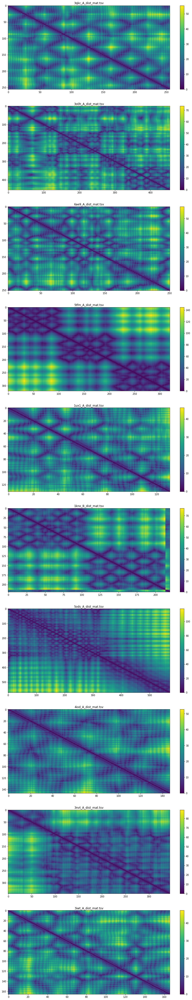

In [36]:
# plotting mapps
import os
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

ROOT_DIR = '/mnt/Archive/Data_Sets/MesoThermo'

#input_file_fasta = os.path.join(ROOT_DIR,'FASTA/dist_meso.fasta')
input_dir_dist  = os.path.join(ROOT_DIR, 'Dist_Mat/Thermophile')
#input_dir_dist  = os.path.join(ROOT_DIR, 'Dist_Mat/Thermophile')
#for seq in SeqIO.parse(input_file_fasta,'fasta'):
#    pass

list_dist_files = os.listdir(input_dir_dist)
list_df = []
for seq in list_dist_files[:10]: 
    list_df.append(pd.read_csv(os.path.join(input_dir_dist,seq), sep = '\t'))

fig, axs  = plt.subplots(10,1)#sharex = True, gridspec_kw = {'height_ratios': [1,8]})
fig.set_figheight(75)
fig.set_figwidth(15)
for i in range(10):
    im =axs[i].imshow(np.array(list_df[i].values[:,1:], dtype=np.float32), aspect="auto")
    axs[i].figure.colorbar(im, ax=axs[i])
    axs[i].set_title(list_dist_files[i])
    
plt.show()




In [30]:
input_dir_dist  = os.path.join(ROOT_DIR, 'Dist_Mat/Thermophile')
for i in os.listdir(input_dir_dist):
    if len(list_df[3].index)==0:
        os.remove(os.path.join(input_dir_dist,i))

In [24]:
print(len(os.listdir(input_dir_dist)))

0
